<a href="https://colab.research.google.com/github/Imran012x/Transfer-Models/blob/main/HILSHA.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

#Co-Lab -->> Drive

In [1]:
from google.colab import drive
drive.mount('/content/drive')



# from google.colab import files
# # Upload a file
# uploaded = files.upload()
# # Get the file name
# file_name = list(uploaded.keys())[0]
# print(f"Uploaded file: {file_name}")



# import zipfile
# import os
# # with zipfile.ZipFile('/content/drive/MyDrive/Hilsha/data_fish_224_11k.zip', 'r') as zip_ref:
# #     zip_ref.extractall('')
# with zipfile.ZipFile('/content/drive/MyDrive/Hilsha/data_fish_org_8407.zip', 'r') as zip_ref:
#     zip_ref.extractall('')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


#Data Preprocessing

In [2]:
import os
import torch
import numpy as np
from PIL import Image
from tqdm import tqdm
import random
import gc
from concurrent.futures import ThreadPoolExecutor, as_completed
import threading
import zipfile

# Check GPU availability
print("GPU Available:", torch.cuda.is_available())
print("GPU Name:", torch.cuda.get_device_name(0) if torch.cuda.is_available() else "No GPU")

# Define fish classes and dataset paths
fish_classes = ['ilish', 'chandana', 'sardin', 'sardinella', 'punctatus']
zipfile.ZipFile('/content/drive/MyDrive/Hilsha/data_fish_org_8407.zip').extractall('/content/.hidden_fish')
data_dir = '/content/.hidden_fish'

image_limits = {
    'ilish': 3000,
    'chandana': 1185,
    'sardin': 2899,
    'sardinella': 370,
    'punctatus': 953
}

# Settings
total_images = sum(image_limits.values())
batch_size = 100
num_threads = 4

# Output paths
output_dir = '/content/drive/MyDrive/Hilsha'
os.makedirs(output_dir, exist_ok=True)
labels_file = os.path.join(output_dir, 'Y_labels.npy')
xdata_file = os.path.join(output_dir, 'X_data.npy')

save_lock = threading.Lock()  # for thread-safe writes

# Function to gather image paths
def get_image_paths(class_name, max_images):
    path = os.path.join(data_dir, class_name)
    files = sorted(os.listdir(path))
    random.shuffle(files)
    return [os.path.join(path, f) for f in files[:max_images]]

# Load and preprocess batch
def load_and_preprocess_batch(image_paths, start_idx, batch_size, class_idx):
    end_idx = min(start_idx + batch_size, len(image_paths))
    batch_paths = image_paths[start_idx:end_idx]
    batch_images = []

    for img_path in batch_paths:
        img = Image.open(img_path).resize((224, 224)).convert('RGB')
        img_tensor = torch.tensor(np.array(img), dtype=torch.uint8).permute(2, 0, 1)  # C x H x W
        batch_images.append(img_tensor)

    batch_tensor = torch.stack(batch_images)  # B x C x H x W
    batch_labels = np.full((len(batch_images),), class_idx, dtype=np.int32)
    return batch_tensor, batch_labels

# Process one batch and return tensors & labels (no file saving)
def process_batch(image_paths, start_idx, batch_size, class_idx):
    return load_and_preprocess_batch(image_paths, start_idx, batch_size, class_idx)

def preprocess_and_save_all(overwrite=True):
    if os.path.exists(labels_file) and os.path.exists(xdata_file) and not overwrite:
        print("Preprocessed data already exists. Set overwrite=True to reprocess.")
        return

    all_images = []
    all_labels = []
    processed_count = 0

    for idx, class_name in enumerate(fish_classes):
        print(f"\nProcessing class: {class_name}")
        image_paths = get_image_paths(class_name, image_limits[class_name])
        total_batches = (len(image_paths) + batch_size - 1) // batch_size

        with ThreadPoolExecutor(max_workers=num_threads) as executor:
            futures = []
            for start in range(0, len(image_paths), batch_size):
                futures.append(executor.submit(process_batch, image_paths, start, batch_size, idx))

            for future in tqdm(as_completed(futures), total=total_batches, desc=class_name):
                batch_tensor, batch_labels = future.result()
                with save_lock:
                    all_images.append(batch_tensor)
                    all_labels.append(batch_labels)
                    processed_count += batch_tensor.size(0)
                    print(f"Processed batch with {batch_tensor.size(0)} images, total processed: {processed_count}/{total_images}")
                gc.collect()

    # Combine all tensors and labels
    X = torch.cat(all_images, dim=0).numpy()
    Y = np.concatenate(all_labels, axis=0)

    # Save final arrays
    np.save(xdata_file, X, allow_pickle=False)
    np.save(labels_file, Y, allow_pickle=False)

    print(f"\n✅ Done! Saved {processed_count} images in {xdata_file}")
    print(f"X_data shape: {X.shape}, Y_labels shape: {Y.shape}")

    if processed_count != total_images:
        raise ValueError(f"Expected {total_images} images, but processed {processed_count}")

# Run preprocessing and save directly to X_data.npy and Y_labels.npy
preprocess_and_save_all(overwrite=True)


GPU Available: True
GPU Name: NVIDIA L4

Processing class: ilish


ilish:   3%|▎         | 1/30 [00:46<22:39, 46.88s/it]

Processed batch with 100 images, total processed: 100/8407
Processed batch with 100 images, total processed: 200/8407


ilish:  13%|█▎        | 4/30 [00:47<03:30,  8.10s/it]

Processed batch with 100 images, total processed: 300/8407
Processed batch with 100 images, total processed: 400/8407


ilish:  17%|█▋        | 5/30 [01:30<08:14, 19.80s/it]

Processed batch with 100 images, total processed: 500/8407


ilish:  20%|██        | 6/30 [01:31<05:29, 13.71s/it]

Processed batch with 100 images, total processed: 600/8407


ilish:  23%|██▎       | 7/30 [01:32<03:39,  9.55s/it]

Processed batch with 100 images, total processed: 700/8407
Processed batch with 100 images, total processed: 800/8407


ilish:  30%|███       | 9/30 [02:14<06:08, 17.55s/it]

Processed batch with 100 images, total processed: 900/8407


ilish:  33%|███▎      | 10/30 [02:16<04:12, 12.64s/it]

Processed batch with 100 images, total processed: 1000/8407


ilish:  37%|███▋      | 11/30 [02:16<02:49,  8.95s/it]

Processed batch with 100 images, total processed: 1100/8407
Processed batch with 100 images, total processed: 1200/8407


ilish:  43%|████▎     | 13/30 [03:01<04:19, 15.24s/it]

Processed batch with 100 images, total processed: 1300/8407


ilish:  47%|████▋     | 14/30 [03:03<03:12, 12.04s/it]

Processed batch with 100 images, total processed: 1400/8407
Processed batch with 100 images, total processed: 1500/8407


ilish:  53%|█████▎    | 16/30 [03:04<01:32,  6.57s/it]

Processed batch with 100 images, total processed: 1600/8407


ilish:  57%|█████▋    | 17/30 [03:49<03:44, 17.26s/it]

Processed batch with 100 images, total processed: 1700/8407


ilish:  60%|██████    | 18/30 [03:50<02:34, 12.86s/it]

Processed batch with 100 images, total processed: 1800/8407


ilish:  63%|██████▎   | 19/30 [03:51<01:41,  9.27s/it]

Processed batch with 100 images, total processed: 1900/8407


ilish:  67%|██████▋   | 20/30 [03:52<01:08,  6.83s/it]

Processed batch with 100 images, total processed: 2000/8407


ilish:  70%|███████   | 21/30 [04:35<02:38, 17.65s/it]

Processed batch with 100 images, total processed: 2100/8407


ilish:  73%|███████▎  | 22/30 [04:36<01:41, 12.69s/it]

Processed batch with 100 images, total processed: 2200/8407


ilish:  77%|███████▋  | 23/30 [04:37<01:03,  9.10s/it]

Processed batch with 100 images, total processed: 2300/8407


ilish:  80%|████████  | 24/30 [04:39<00:41,  6.94s/it]

Processed batch with 100 images, total processed: 2400/8407


ilish:  83%|████████▎ | 25/30 [05:23<01:29, 17.96s/it]

Processed batch with 100 images, total processed: 2500/8407


ilish:  87%|████████▋ | 26/30 [05:24<00:52, 13.06s/it]

Processed batch with 100 images, total processed: 2600/8407


ilish:  90%|█████████ | 27/30 [05:26<00:28,  9.55s/it]

Processed batch with 100 images, total processed: 2700/8407


ilish:  93%|█████████▎| 28/30 [05:27<00:14,  7.15s/it]

Processed batch with 100 images, total processed: 2800/8407


ilish:  97%|█████████▋| 29/30 [05:55<00:13, 13.49s/it]

Processed batch with 100 images, total processed: 2900/8407


ilish: 100%|██████████| 30/30 [05:56<00:00, 11.90s/it]


Processed batch with 100 images, total processed: 3000/8407

Processing class: chandana


chandana:   8%|▊         | 1/12 [00:31<05:41, 31.01s/it]

Processed batch with 100 images, total processed: 3100/8407


chandana:  17%|█▋        | 2/12 [00:34<02:27, 14.79s/it]

Processed batch with 100 images, total processed: 3200/8407


chandana:  25%|██▌       | 3/12 [00:35<01:16,  8.46s/it]

Processed batch with 100 images, total processed: 3300/8407


chandana:  33%|███▎      | 4/12 [00:37<00:46,  5.86s/it]

Processed batch with 100 images, total processed: 3400/8407


chandana:  42%|████▏     | 5/12 [01:04<01:34, 13.51s/it]

Processed batch with 100 images, total processed: 3500/8407


chandana:  50%|█████     | 6/12 [01:10<01:06, 11.17s/it]

Processed batch with 100 images, total processed: 3600/8407


chandana:  58%|█████▊    | 7/12 [01:12<00:39,  7.87s/it]

Processed batch with 100 images, total processed: 3700/8407


chandana:  67%|██████▋   | 8/12 [01:12<00:22,  5.67s/it]

Processed batch with 100 images, total processed: 3800/8407


chandana:  75%|███████▌  | 9/12 [01:37<00:34, 11.41s/it]

Processed batch with 100 images, total processed: 3900/8407


chandana:  83%|████████▎ | 10/12 [01:39<00:17,  8.78s/it]

Processed batch with 85 images, total processed: 3985/8407


chandana:  92%|█████████▏| 11/12 [01:44<00:07,  7.65s/it]

Processed batch with 100 images, total processed: 4085/8407


chandana: 100%|██████████| 12/12 [01:45<00:00,  8.80s/it]


Processed batch with 100 images, total processed: 4185/8407

Processing class: sardin


sardin:   3%|▎         | 1/29 [00:30<14:05, 30.18s/it]

Processed batch with 100 images, total processed: 4285/8407


sardin:   7%|▋         | 2/29 [00:33<06:26, 14.30s/it]

Processed batch with 100 images, total processed: 4385/8407


sardin:  10%|█         | 3/29 [00:35<03:43,  8.61s/it]

Processed batch with 100 images, total processed: 4485/8407


sardin:  14%|█▍        | 4/29 [00:35<02:17,  5.50s/it]

Processed batch with 100 images, total processed: 4585/8407


sardin:  17%|█▋        | 5/29 [01:02<05:18, 13.25s/it]

Processed batch with 100 images, total processed: 4685/8407


sardin:  21%|██        | 6/29 [01:08<04:05, 10.67s/it]

Processed batch with 100 images, total processed: 4785/8407


sardin:  24%|██▍       | 7/29 [01:10<02:54,  7.92s/it]

Processed batch with 100 images, total processed: 4885/8407


sardin:  28%|██▊       | 8/29 [01:11<01:59,  5.68s/it]

Processed batch with 100 images, total processed: 4985/8407


sardin:  31%|███       | 9/29 [01:41<04:23, 13.18s/it]

Processed batch with 100 images, total processed: 5085/8407


sardin:  34%|███▍      | 10/29 [01:46<03:23, 10.70s/it]

Processed batch with 100 images, total processed: 5185/8407


sardin:  38%|███▊      | 11/29 [01:47<02:18,  7.70s/it]

Processed batch with 100 images, total processed: 5285/8407


sardin:  41%|████▏     | 12/29 [01:52<01:57,  6.94s/it]

Processed batch with 100 images, total processed: 5385/8407


sardin:  45%|████▍     | 13/29 [02:18<03:24, 12.76s/it]

Processed batch with 100 images, total processed: 5485/8407


sardin:  48%|████▊     | 14/29 [02:25<02:43, 10.90s/it]

Processed batch with 100 images, total processed: 5585/8407


sardin:  52%|█████▏    | 15/29 [02:26<01:52,  8.05s/it]

Processed batch with 100 images, total processed: 5685/8407


sardin:  55%|█████▌    | 16/29 [02:31<01:29,  6.90s/it]

Processed batch with 100 images, total processed: 5785/8407
Processed batch with 100 images, total processed: 5885/8407


sardin:  62%|██████▏   | 18/29 [03:03<01:57, 10.67s/it]

Processed batch with 100 images, total processed: 5985/8407


sardin:  66%|██████▌   | 19/29 [03:07<01:27,  8.80s/it]

Processed batch with 100 images, total processed: 6085/8407


sardin:  69%|██████▉   | 20/29 [03:09<00:59,  6.57s/it]

Processed batch with 100 images, total processed: 6185/8407


sardin:  72%|███████▏  | 21/29 [03:39<01:48, 13.52s/it]

Processed batch with 100 images, total processed: 6285/8407


sardin:  76%|███████▌  | 22/29 [03:42<01:14, 10.65s/it]

Processed batch with 100 images, total processed: 6385/8407


sardin:  83%|████████▎ | 24/29 [03:48<00:31,  6.31s/it]

Processed batch with 100 images, total processed: 6485/8407
Processed batch with 100 images, total processed: 6585/8407


sardin:  86%|████████▌ | 25/29 [04:18<00:54, 13.52s/it]

Processed batch with 100 images, total processed: 6685/8407


sardin:  90%|████████▉ | 26/29 [04:23<00:33, 11.10s/it]

Processed batch with 100 images, total processed: 6785/8407


sardin:  93%|█████████▎| 27/29 [04:25<00:16,  8.30s/it]

Processed batch with 100 images, total processed: 6885/8407


sardin:  97%|█████████▋| 28/29 [04:25<00:05,  5.90s/it]

Processed batch with 100 images, total processed: 6985/8407


sardin: 100%|██████████| 29/29 [04:44<00:00,  9.81s/it]


Processed batch with 99 images, total processed: 7084/8407

Processing class: sardinella


sardinella:  25%|██▌       | 1/4 [00:30<01:31, 30.55s/it]

Processed batch with 70 images, total processed: 7154/8407


sardinella: 100%|██████████| 4/4 [00:42<00:00, 10.52s/it]


Processed batch with 100 images, total processed: 7254/8407
Processed batch with 100 images, total processed: 7354/8407
Processed batch with 100 images, total processed: 7454/8407

Processing class: punctatus


punctatus:  10%|█         | 1/10 [00:34<05:09, 34.37s/it]

Processed batch with 100 images, total processed: 7554/8407
Processed batch with 100 images, total processed: 7654/8407


punctatus:  30%|███       | 3/10 [00:35<00:58,  8.37s/it]

Processed batch with 100 images, total processed: 7754/8407
Processed batch with 100 images, total processed: 7854/8407


punctatus:  50%|█████     | 5/10 [01:11<01:19, 15.99s/it]

Processed batch with 100 images, total processed: 7954/8407


punctatus:  60%|██████    | 6/10 [01:12<00:43, 10.82s/it]

Processed batch with 100 images, total processed: 8054/8407


punctatus:  70%|███████   | 7/10 [01:12<00:22,  7.46s/it]

Processed batch with 100 images, total processed: 8154/8407


punctatus:  80%|████████  | 8/10 [01:13<00:10,  5.26s/it]

Processed batch with 100 images, total processed: 8254/8407


punctatus:  90%|█████████ | 9/10 [01:25<00:07,  7.50s/it]

Processed batch with 53 images, total processed: 8307/8407


punctatus: 100%|██████████| 10/10 [01:35<00:00,  9.55s/it]

Processed batch with 100 images, total processed: 8407/8407



✅ Done! Saved 8407 images in /content/drive/MyDrive/Hilsha/X_data.npy
X_data shape: (8407, 3, 224, 224), Y_labels shape: (8407,)


####DATA LOADING....

In [2]:
import os
import numpy as np
import torch

# Your data path
output_dir = '/content/drive/MyDrive/Hilsha'
data_file = os.path.join(output_dir, 'X_data.npy')
labels_file = os.path.join(output_dir, 'Y_labels.npy')

# Readable size format
def sizeof_fmt(num, suffix='B'):
    for unit in ['', 'K', 'M', 'G', 'T']:
        if abs(num) < 1024.0:
            return f"{num:3.2f} {unit}{suffix}"
        num /= 1024.0
    return f"{num:.2f} T{suffix}"

# Main loader
def load_preprocessed_data(as_torch=True, normalize=True, to_device=None):
    # Check file existence
    for path in [data_file, labels_file]:
        if not os.path.exists(path):
            raise FileNotFoundError(f"Missing: {path}")

    # Print file sizes
    print(f"📁 X_data.npy: {sizeof_fmt(os.path.getsize(data_file))}")
    print(f"📁 Y_labels.npy: {sizeof_fmt(os.path.getsize(labels_file))}")

    # Load with mmap
    X = np.load(data_file, mmap_mode='r')
    Y = np.load(labels_file, mmap_mode='r')

    print(f"✅ X shape: {X.shape}, dtype: {X.dtype}")
    print(f"✅ Y shape: {Y.shape}, dtype: {Y.dtype}")

    # Sanity check
    if len(X) != len(Y):
        raise ValueError("Mismatch between number of samples in X and Y")

    # Convert to torch
    if as_torch:
        X = torch.from_numpy(X)
        Y = torch.from_numpy(Y)

        if normalize and X.dtype == torch.uint8:
            X = X.float() / 255.0

        if to_device:
            X = X.to(to_device)
            Y = Y.to(to_device)

        print(f"🧠 Torch tensors ready on {to_device or 'CPU'}")

    return X, Y

# 🔁 Example call
X, Y = load_preprocessed_data(
    as_torch=True,
    normalize=True,
    to_device='cuda' if torch.cuda.is_available() else 'cpu'
)

📁 X_data.npy: 1.18 GB
📁 Y_labels.npy: 32.96 KB
✅ X shape: (8407, 3, 224, 224), dtype: uint8
✅ Y shape: (8407,), dtype: int32


<ipython-input-2-1313628792>:42: UserWarning: The given NumPy array is not writable, and PyTorch does not support non-writable tensors. This means writing to this tensor will result in undefined behavior. You may want to copy the array to protect its data or make it writable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at /pytorch/torch/csrc/utils/tensor_numpy.cpp:203.)
  X = torch.from_numpy(X)


🧠 Torch tensors ready on cuda


#Data Visualization

<ipython-input-3-2606033325>:47: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=[class_names[i] for i in unique], y=counts, palette='viridis')


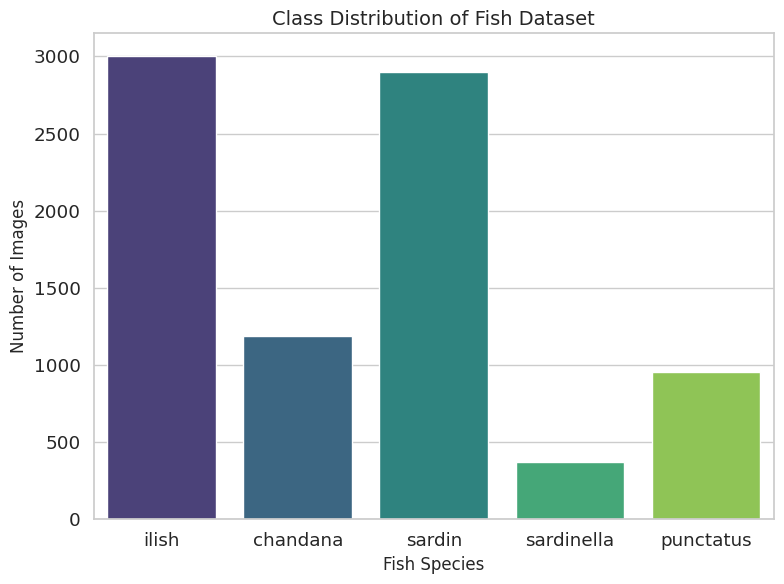

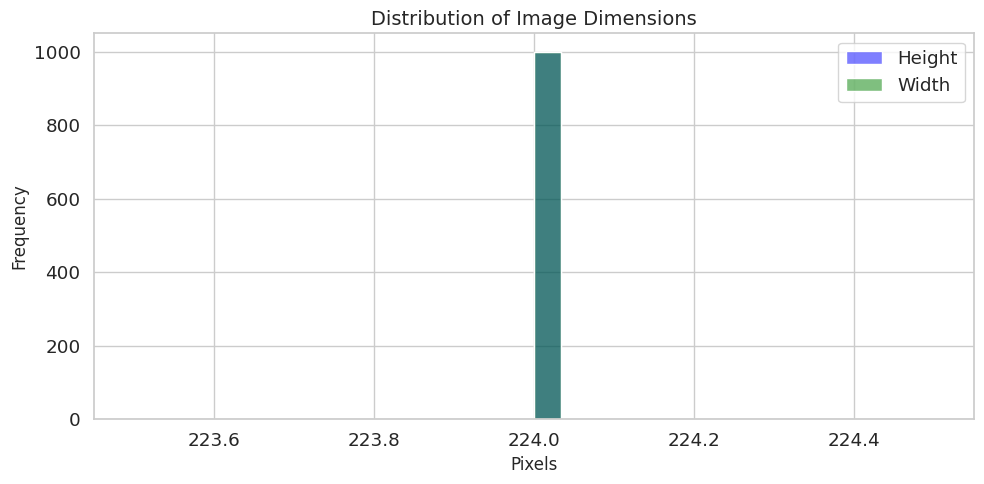

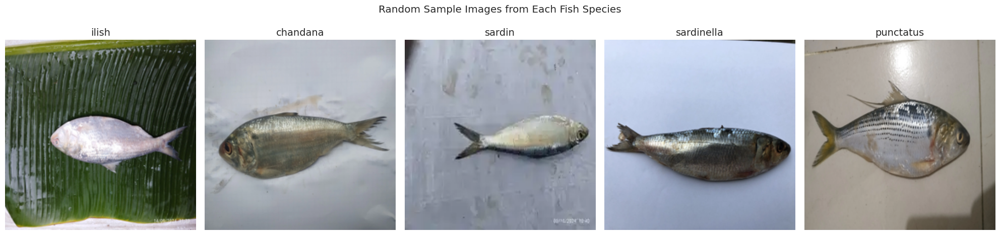

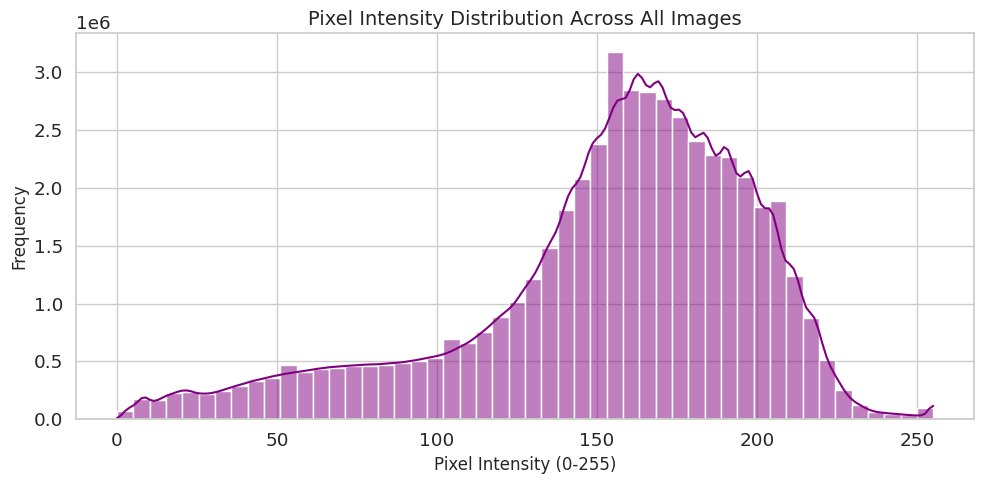

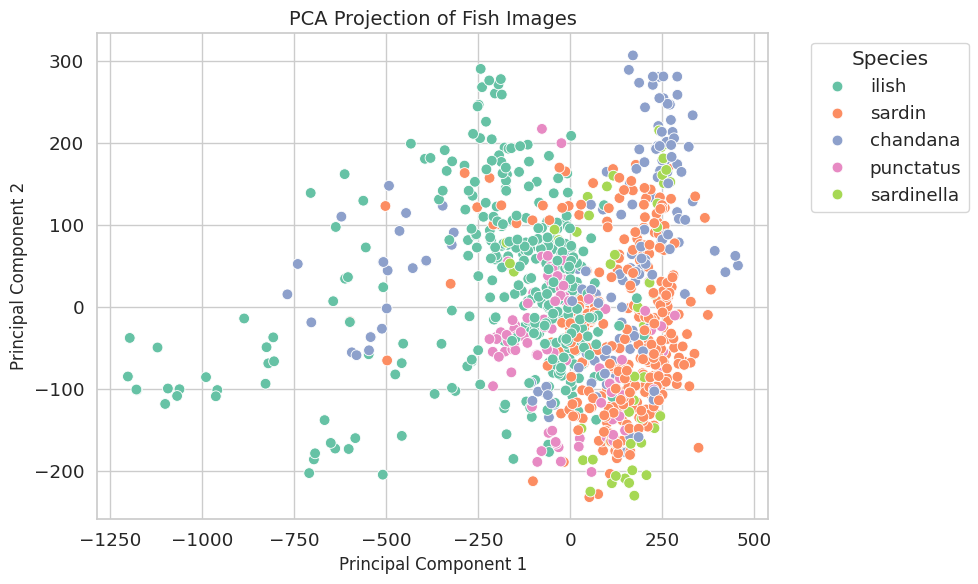

/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


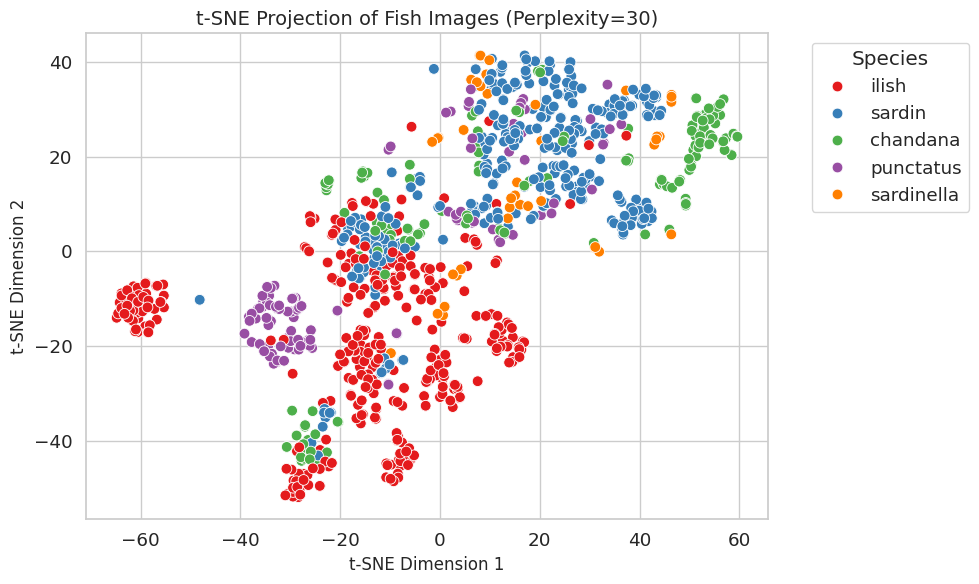

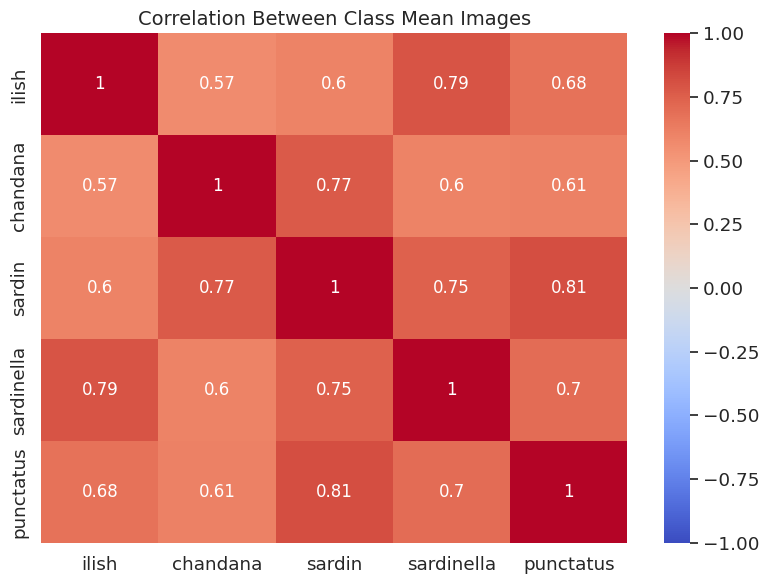

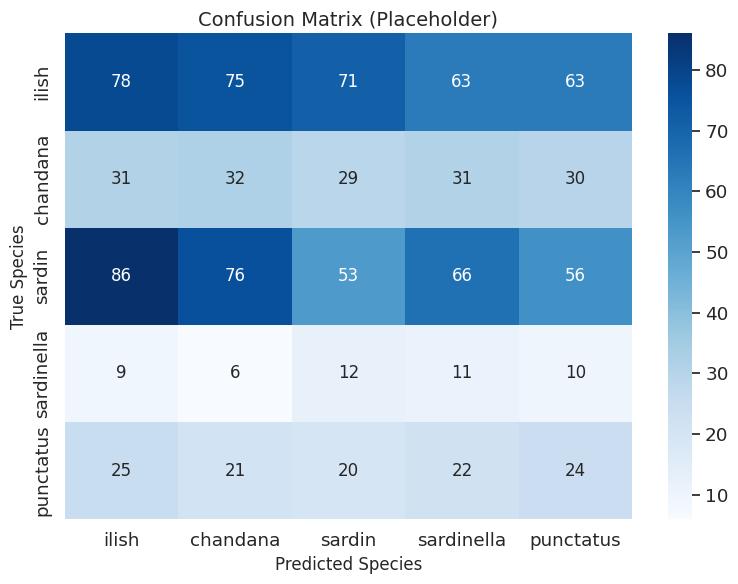

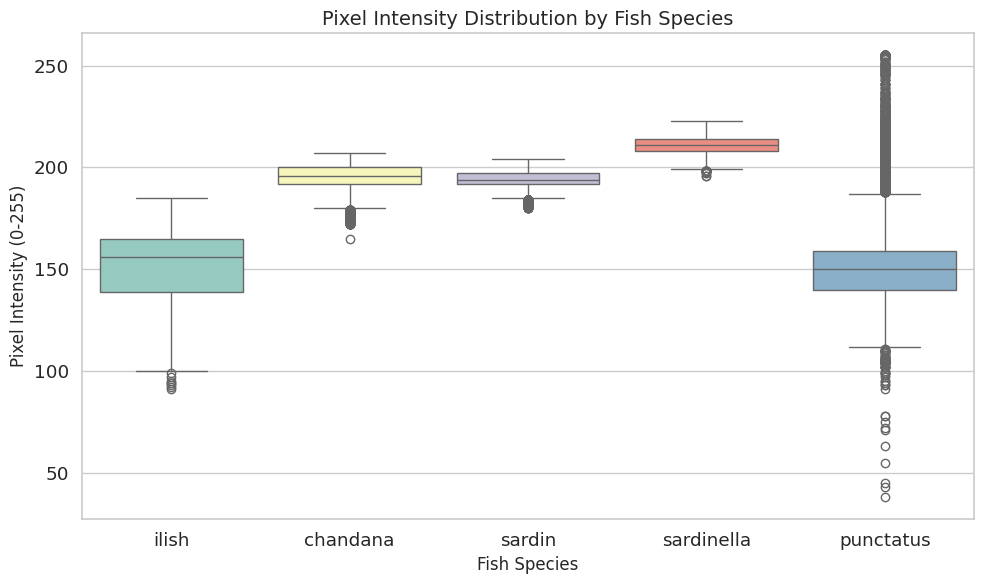

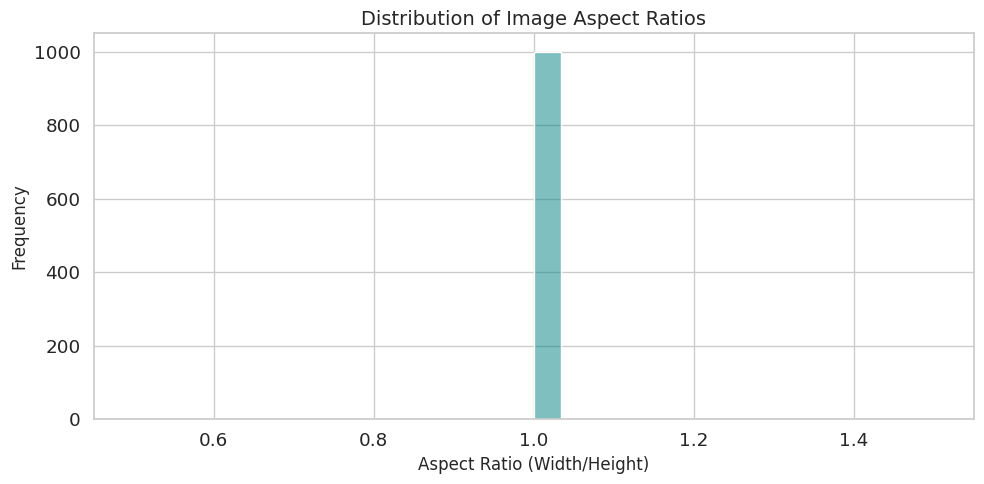

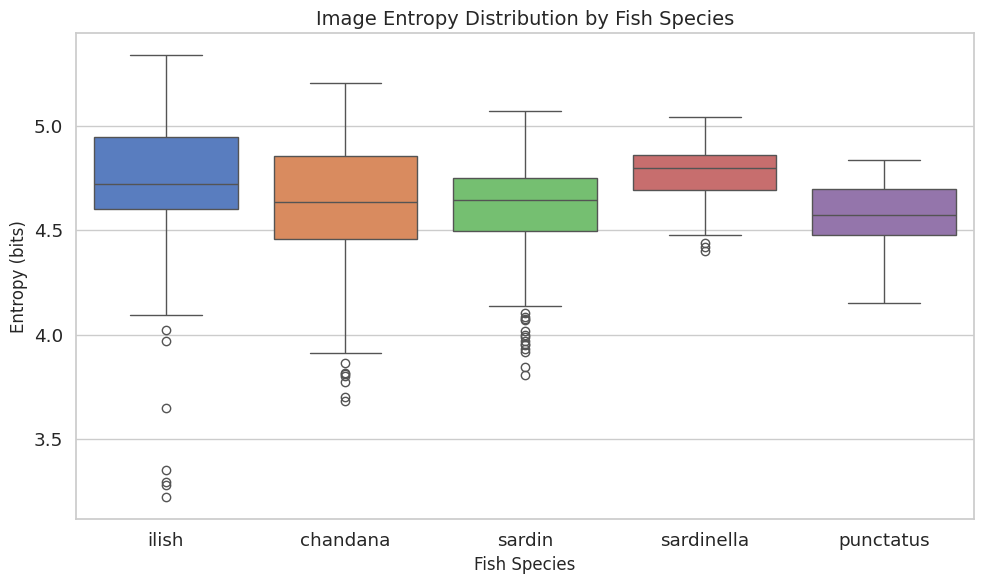

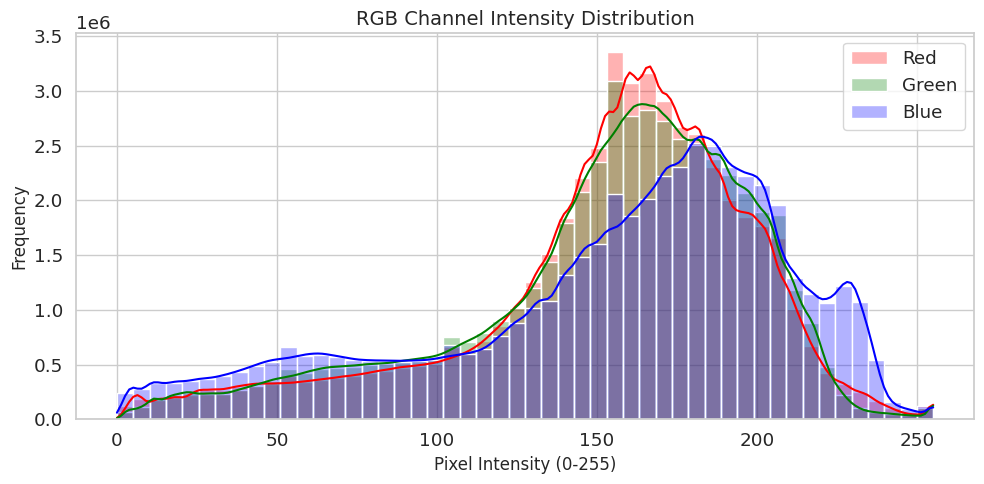

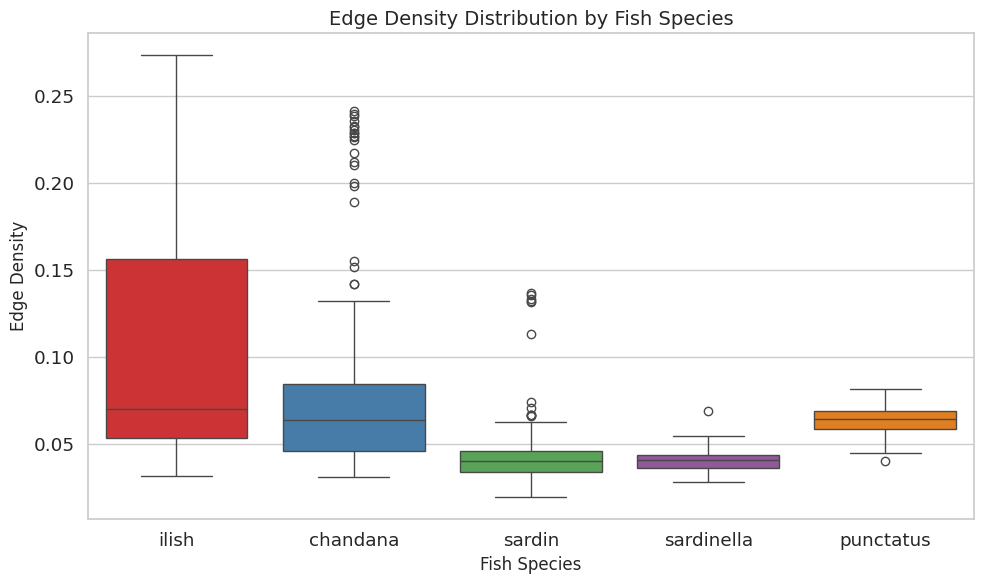

<ipython-input-3-2606033325>:241: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=list(range(1, len(explained_variance) + 1))[:10], y=explained_variance[:10], palette='viridis')


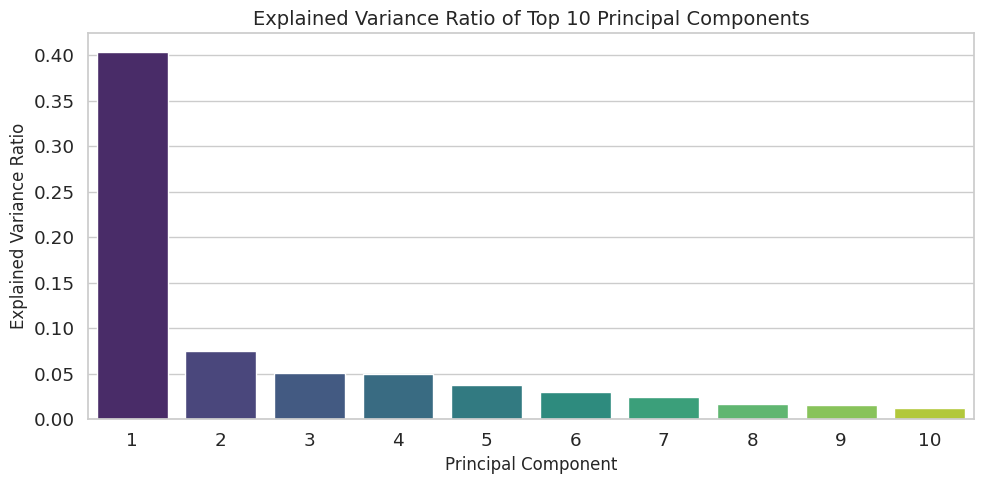

/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/sklearn/manifold/_t_sne.py:1164: FutureWarning: 'n_iter' was renamed to 'max_iter' in version 1.5 and will be removed in 1.7.
  warnings.warn(


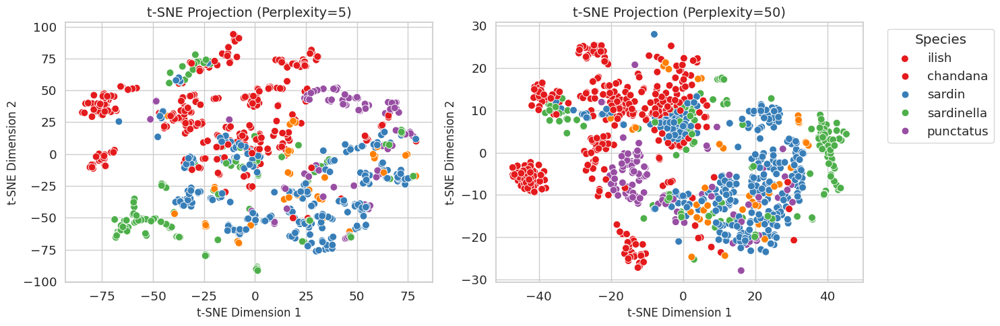

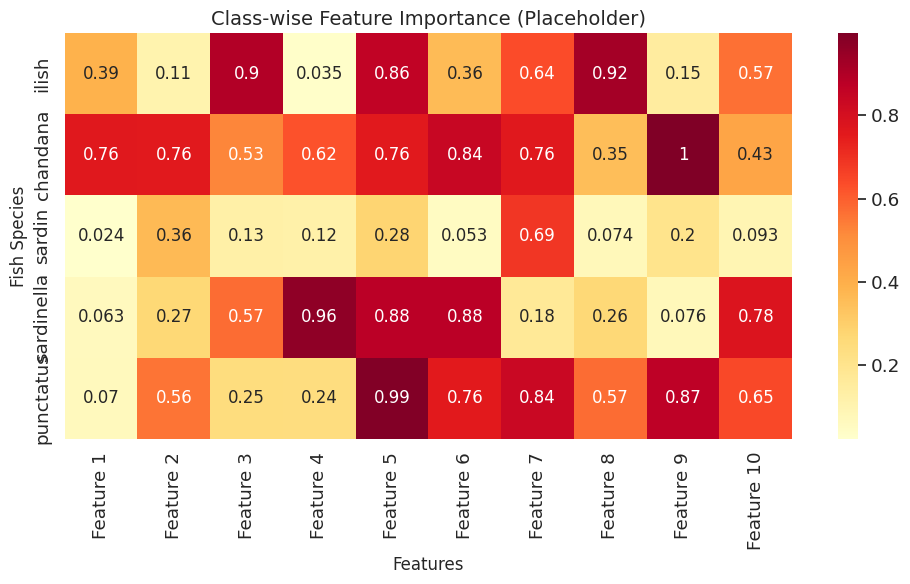

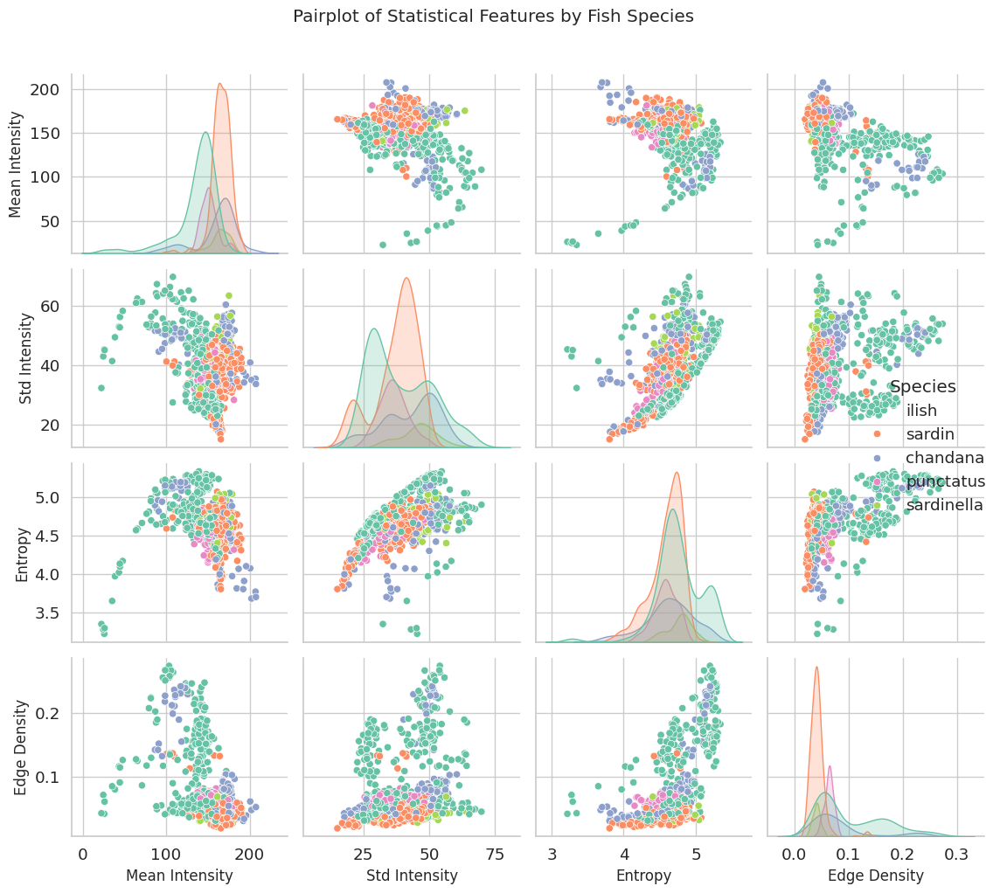

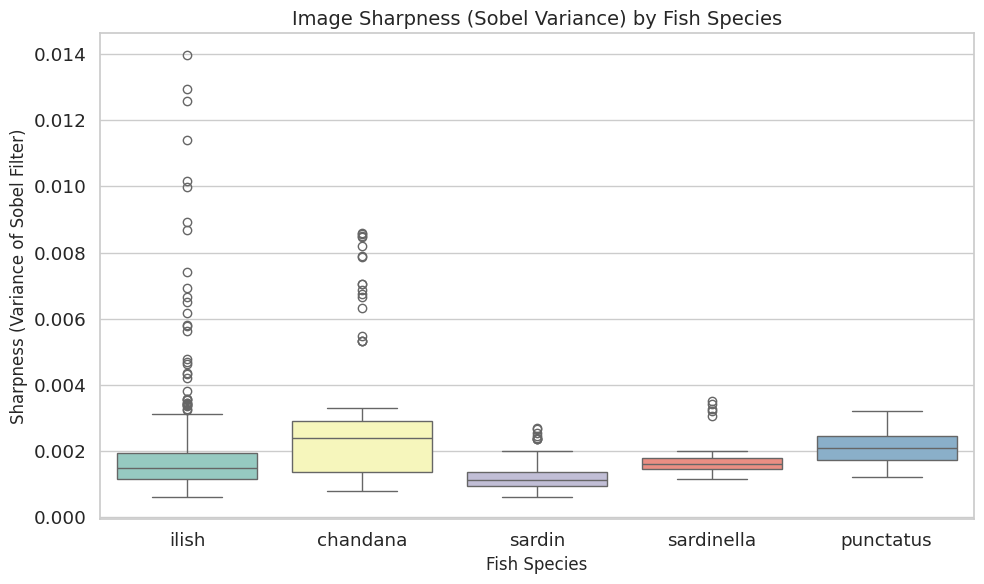


✅ Extended visualization suite generated for Q1-level journal publication.


In [3]:
import os
import numpy as np
import torch
import matplotlib.pyplot as plt
import seaborn as sns
import random
import cv2
import pandas as pd
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import confusion_matrix
from scipy.stats import entropy
from skimage.feature import canny
from skimage.filters import sobel

# Set random seed for reproducibility
np.random.seed(42)
random.seed(42)

# Load data
X = np.load('/content/drive/MyDrive/Hilsha/X_data.npy', mmap_mode='r')
Y = np.load('/content/drive/MyDrive/Hilsha/Y_labels.npy', mmap_mode='r')

# Convert torch tensors if needed and ensure correct format
if isinstance(X, torch.Tensor):
    X = X.cpu().numpy()
if isinstance(Y, torch.Tensor):
    Y = Y.cpu().numpy().astype(int)

# Check if X is in channels-first format (C, H, W) and transpose to (H, W, C)
if X.shape[1] <= 3 and X.shape[2] > 3 and X.shape[3] > 3:  # Likely (N, C, H, W)
    X = X.transpose(0, 2, 3, 1)  # Convert to (N, H, W, C)

class_names = ['ilish', 'chandana', 'sardin', 'sardinella', 'punctatus']

# Set seaborn style for publication-quality plots
sns.set(style="whitegrid", font_scale=1.2)
plt.rcParams.update({'font.size': 12, 'axes.titlesize': 14, 'axes.labelsize': 12})

# Sample indices for computational efficiency
sample_indices = random.sample(range(len(X)), min(1000, len(X)))

# 🔍 1. Class Distribution
unique, counts = np.unique(Y, return_counts=True)
plt.figure(figsize=(8, 6))
sns.barplot(x=[class_names[i] for i in unique], y=counts, palette='viridis')
plt.title('Class Distribution of Fish Dataset')
plt.ylabel('Number of Images')
plt.xlabel('Fish Species')
plt.tight_layout()
plt.show()

# 🔍 2. Image Size Distribution
heights, widths = [], []
for i in sample_indices:
    img = X[i]
    heights.append(img.shape[0])
    widths.append(img.shape[1])

plt.figure(figsize=(10, 5))
sns.histplot(heights, color='blue', label='Height', kde=True, bins=30)
sns.histplot(widths, color='green', label='Width', kde=True, bins=30)
plt.title('Distribution of Image Dimensions')
plt.xlabel('Pixels')
plt.ylabel('Frequency')
plt.legend()
plt.tight_layout()
plt.show()

# 🔍 3. Random Samples
fig, axs = plt.subplots(1, 5, figsize=(20, 5))
for i, class_id in enumerate(np.unique(Y)):
    idx = np.where(Y == class_id)[0]
    rand_idx = random.choice(idx)
    img = X[rand_idx]
    if img.shape[-1] == 3:  # Ensure RGB format (H, W, 3)
        img = img.astype(np.uint8)
    else:
        raise ValueError(f"Image at index {rand_idx} has unexpected shape {img.shape}")
    axs[i].imshow(img)
    axs[i].axis('off')
    axs[i].set_title(class_names[class_id])
plt.suptitle('Random Sample Images from Each Fish Species')
plt.tight_layout()
plt.show()

# 🔍 4. Pixel Intensity Distribution
pixels = []
for i in sample_indices:
    gray = cv2.cvtColor(X[i].astype(np.uint8), cv2.COLOR_RGB2GRAY)
    pixels.extend(gray.flatten())

plt.figure(figsize=(10, 5))
sns.histplot(pixels, bins=50, kde=True, color='purple')
plt.title('Pixel Intensity Distribution Across All Images')
plt.xlabel('Pixel Intensity (0-255)')
plt.ylabel('Frequency')
plt.tight_layout()
plt.show()

# 🔍 5. PCA Projection
X_flat = X[sample_indices].reshape(len(sample_indices), -1)
X_scaled = StandardScaler().fit_transform(X_flat)
Y_sample = Y[sample_indices]

pca = PCA(n_components=2)
pca_result = pca.fit_transform(X_scaled)

plt.figure(figsize=(10, 6))
sns.scatterplot(x=pca_result[:, 0], y=pca_result[:, 1], hue=[class_names[i] for i in Y_sample], palette='Set2', s=60)
plt.title('PCA Projection of Fish Images')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.legend(title='Species', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

# 🔍 6. t-SNE Projection
tsne = TSNE(n_components=2, perplexity=30, learning_rate=200, n_iter=1000, random_state=42)
tsne_result = tsne.fit_transform(X_scaled)

plt.figure(figsize=(10, 6))
sns.scatterplot(x=tsne_result[:, 0], y=tsne_result[:, 1], hue=[class_names[i] for i in Y_sample], palette='Set1', s=60)
plt.title('t-SNE Projection of Fish Images (Perplexity=30)')
plt.xlabel('t-SNE Dimension 1')
plt.ylabel('t-SNE Dimension 2')
plt.legend(title='Species', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

# 🔍 7. Correlation Heatmap
mean_vectors = []
for class_id in range(len(class_names)):
    idx = np.where(Y == class_id)[0]
    sample = X[idx[:100]].reshape(100, -1).mean(axis=0)
    mean_vectors.append(sample)

corr = np.corrcoef(mean_vectors)
plt.figure(figsize=(8, 6))
sns.heatmap(corr, xticklabels=class_names, yticklabels=class_names, annot=True, cmap='coolwarm', vmin=-1, vmax=1)
plt.title('Correlation Between Class Mean Images')
plt.tight_layout()
plt.show()

# 🔍 8. Placeholder Confusion Matrix
true = Y_sample
pred = np.random.choice(np.unique(Y), size=len(Y_sample))  # Placeholder predictions
cm = confusion_matrix(true, pred)

plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_names, yticklabels=class_names)
plt.title('Confusion Matrix (Placeholder)')
plt.xlabel('Predicted Species')
plt.ylabel('True Species')
plt.tight_layout()
plt.show()

# 🔍 9. Boxplot of Pixel Intensity per Class
pixel_intensities = {class_name: [] for class_name in class_names}
for i in sample_indices:
    gray = cv2.cvtColor(X[i].astype(np.uint8), cv2.COLOR_RGB2GRAY)
    pixel_intensities[class_names[Y[i]]].extend(gray.flatten())

plt.figure(figsize=(10, 6))
sns.boxplot(data=[pixel_intensities[class_name][:10000] for class_name in class_names], palette='Set3')  # Sample for speed
plt.xticks(ticks=range(len(class_names)), labels=class_names)
plt.title('Pixel Intensity Distribution by Fish Species')
plt.xlabel('Fish Species')
plt.ylabel('Pixel Intensity (0-255)')
plt.tight_layout()
plt.show()

# 🔍 10. Aspect Ratio Distribution
aspect_ratios = [widths[i] / heights[i] for i in range(len(heights))]
plt.figure(figsize=(10, 5))
sns.histplot(aspect_ratios, kde=True, color='teal', bins=30)
plt.title('Distribution of Image Aspect Ratios')
plt.xlabel('Aspect Ratio (Width/Height)')
plt.ylabel('Frequency')
plt.tight_layout()
plt.show()

# 🔍 11. Class-wise Image Entropy
entropies = {class_name: [] for class_name in class_names}
for i in sample_indices:
    gray = cv2.cvtColor(X[i].astype(np.uint8), cv2.COLOR_RGB2GRAY)
    hist, _ = np.histogram(gray, bins=256, range=(0, 256), density=True)
    entropies[class_names[Y[i]]].append(entropy(hist))

plt.figure(figsize=(10, 6))
sns.boxplot(data=[entropies[class_name] for class_name in class_names], palette='muted')
plt.xticks(ticks=range(len(class_names)), labels=class_names)
plt.title('Image Entropy Distribution by Fish Species')
plt.xlabel('Fish Species')
plt.ylabel('Entropy (bits)')
plt.tight_layout()
plt.show()

# 🔍 12. Color Channel Distribution
r_pixels, g_pixels, b_pixels = [], [], []
for i in sample_indices:
    img = X[i].astype(np.uint8)
    r_pixels.extend(img[:, :, 0].flatten())
    g_pixels.extend(img[:, :, 1].flatten())
    b_pixels.extend(img[:, :, 2].flatten())

plt.figure(figsize=(10, 5))
sns.histplot(r_pixels, color='red', label='Red', kde=True, bins=50, alpha=0.3)
sns.histplot(g_pixels, color='green', label='Green', kde=True, bins=50, alpha=0.3)
sns.histplot(b_pixels, color='blue', label='Blue', kde=True, bins=50, alpha=0.3)
plt.title('RGB Channel Intensity Distribution')
plt.xlabel('Pixel Intensity (0-255)')
plt.ylabel('Frequency')
plt.legend()
plt.tight_layout()
plt.show()

# 🔍 13. Edge Density Analysis
edge_densities = {class_name: [] for class_name in class_names}
for i in sample_indices:
    gray = cv2.cvtColor(X[i].astype(np.uint8), cv2.COLOR_RGB2GRAY)
    edges = canny(gray / 255.0, sigma=1.0)
    edge_density = np.mean(edges)
    edge_densities[class_names[Y[i]]].append(edge_density)

plt.figure(figsize=(10, 6))
sns.boxplot(data=[edge_densities[class_name] for class_name in class_names], palette='Set1')
plt.xticks(ticks=range(len(class_names)), labels=class_names)
plt.title('Edge Density Distribution by Fish Species')
plt.xlabel('Fish Species')
plt.ylabel('Edge Density')
plt.tight_layout()
plt.show()

# 🔍 14. PCA Explained Variance Ratio
pca_full = PCA().fit(X_scaled)
explained_variance = pca_full.explained_variance_ratio_

plt.figure(figsize=(10, 5))
sns.barplot(x=list(range(1, len(explained_variance) + 1))[:10], y=explained_variance[:10], palette='viridis')
plt.title('Explained Variance Ratio of Top 10 Principal Components')
plt.xlabel('Principal Component')
plt.ylabel('Explained Variance Ratio')
plt.tight_layout()
plt.show()

# 🔍 15. t-SNE with Different Perplexities
perplexities = [5, 50]
fig, axs = plt.subplots(1, 2, figsize=(15, 5))
for i, perp in enumerate(perplexities):
    tsne = TSNE(n_components=2, perplexity=perp, learning_rate=200, n_iter=1000, random_state=42)
    tsne_result = tsne.fit_transform(X_scaled)
    sns.scatterplot(x=tsne_result[:, 0], y=tsne_result[:, 1], hue=[class_names[i] for i in Y_sample], palette='Set1', s=60, ax=axs[i])
    axs[i].set_title(f't-SNE Projection (Perplexity={perp})')
    axs[i].set_xlabel('t-SNE Dimension 1')
    axs[i].set_ylabel('t-SNE Dimension 2')
    axs[i].legend_.remove()
plt.legend(title='Species', labels=class_names, bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

# 🔍 16. Class-wise Feature Importance (Placeholder)
feature_importance = np.random.rand(len(class_names), 10)  # Replace with actual model-based importance
plt.figure(figsize=(10, 6))
sns.heatmap(feature_importance, xticklabels=[f'Feature {i+1}' for i in range(10)], yticklabels=class_names, annot=True, cmap='YlOrRd')
plt.title('Class-wise Feature Importance (Placeholder)')
plt.xlabel('Features')
plt.ylabel('Fish Species')
plt.tight_layout()
plt.show()

# 🔍 17. Pairplot of Statistical Features
stats_features = []
for i in sample_indices:
    gray = cv2.cvtColor(X[i].astype(np.uint8), cv2.COLOR_RGB2GRAY)
    stats = [
        np.mean(gray),  # Mean intensity
        np.std(gray),   # Standard deviation
        entropy(np.histogram(gray, bins=256, range=(0, 256), density=True)[0]),  # Entropy
        np.mean(canny(gray / 255.0, sigma=1.0))  # Edge density
    ]
    stats_features.append(stats)

stats_df = pd.DataFrame(stats_features, columns=['Mean Intensity', 'Std Intensity', 'Entropy', 'Edge Density'])
stats_df['Species'] = [class_names[Y[i]] for i in sample_indices]

sns.pairplot(stats_df, hue='Species', palette='Set2', diag_kind='kde')
plt.suptitle('Pairplot of Statistical Features by Fish Species', y=1.02)
plt.tight_layout()
plt.show()

# 🔍 18. Image Sharpness Analysis
sharpness = {class_name: [] for class_name in class_names}
for i in sample_indices:
    gray = cv2.cvtColor(X[i].astype(np.uint8), cv2.COLOR_RGB2GRAY)
    sobel_img = sobel(gray / 255.0)
    sharpness[class_names[Y[i]]].append(np.var(sobel_img))

plt.figure(figsize=(10, 6))
sns.boxplot(data=[sharpness[class_name] for class_name in class_names], palette='Set3')
plt.xticks(ticks=range(len(class_names)), labels=class_names)
plt.title('Image Sharpness (Sobel Variance) by Fish Species')
plt.xlabel('Fish Species')
plt.ylabel('Sharpness (Variance of Sobel Filter)')
plt.tight_layout()
plt.show()

print("\n✅ Visualization Completed")

#Optuna-Hyper parameter Training

<ipython-input-11-2606033325>:47: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x=[class_names[i] for i in unique], y=counts, palette='viridis')


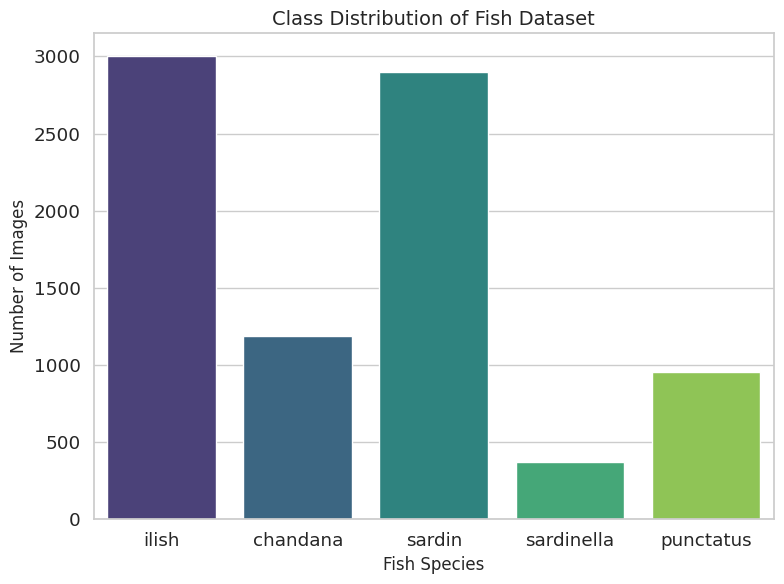

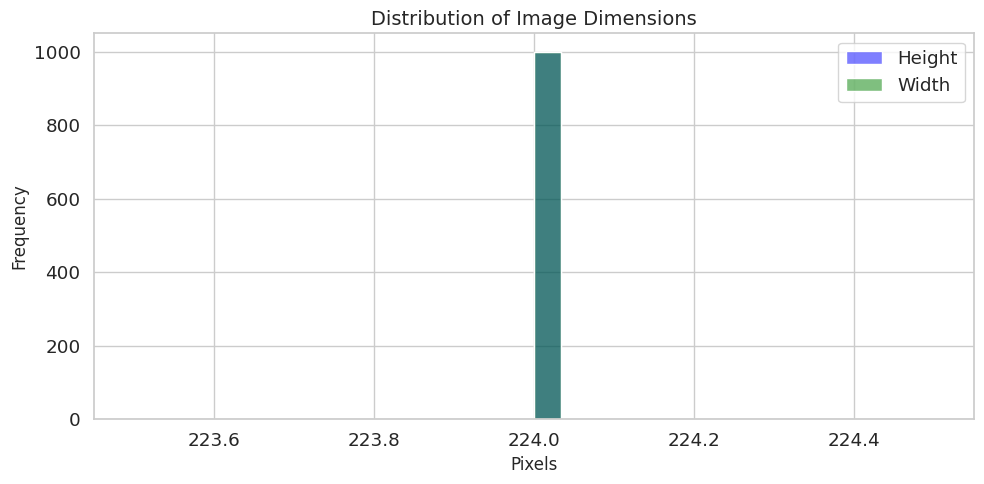

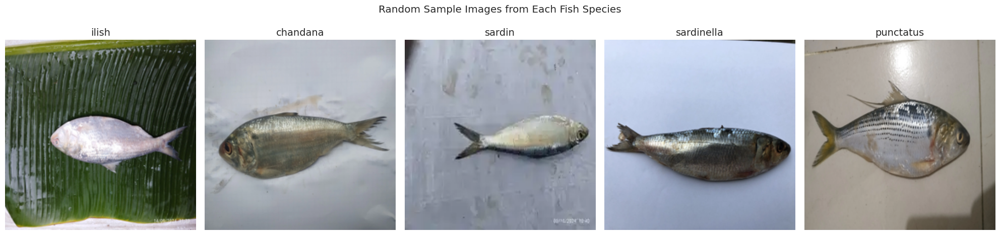

In [ ]:
!pip install optuna
import optuna
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, Flatten, Conv2D, MaxPooling2D, GlobalAveragePooling2D
from tensorflow.keras.optimizers import RMSprop
from sklearn.metrics import roc_curve, auc, precision_recall_curve, confusion_matrix, accuracy_score, f1_score
import seaborn as sns

# Define model creation function
def create_model(learning_rate, num_filters, kernel_size):
    input_shape = (224, 224, 3)
    base_model = ResNet50(weights='imagenet', include_top=False, input_shape=input_shape)

    x = base_model.output
    x = Conv2D(num_filters, (kernel_size, kernel_size), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2))(x)
    x = Conv2D(num_filters * 2, (kernel_size, kernel_size), activation='relu', padding='same')(x)
    x = MaxPooling2D((2, 2))(x)
    x = GlobalAveragePooling2D()(x)
    x = Dense(256, activation='relu')(x)
    output = Dense(4, activation='softmax')(x)

    model = Model(inputs=base_model.input, outputs=output)

    for layer in base_model.layers:
        layer.trainable = False

    model.compile(optimizer=RMSprop(learning_rate=learning_rate),
                  loss='sparse_categorical_crossentropy',
                  metrics=['accuracy'])
    return model

# Define Optuna objective function
def objective(trial):
    learning_rate = trial.suggest_loguniform('learning_rate', 1e-5, 1e-1)
    num_filters = trial.suggest_int('num_filters', 16, 128)
    kernel_size = trial.suggest_categorical('kernel_size', [3, 7])

    model = create_model(learning_rate, num_filters, kernel_size)
    model.fit(X_train_scaled, Y_train, epochs=8, validation_data=(X_test_scaled, Y_test), verbose=0)
    score = model.evaluate(X_test_scaled, Y_test, verbose=0)
    return score[1]

# Run Optuna study
study = optuna.create_study(direction='maximize')
study.optimize(objective, n_trials=30)

# Get best parameters
best_params = study.best_params
print("Best hyperparameters: ", best_params)

# Train final model with best parameters
model = create_model(best_params['learning_rate'], best_params['num_filters'], best_params['kernel_size'])
history = model.fit(X_train_scaled, Y_train,
                    validation_split=0.2,
                    epochs=10, batch_size=32, verbose=1)

# Evaluate model
val_loss, val_accuracy = model.evaluate(X_test_scaled, Y_test, verbose=0)
print(f"Validation Accuracy: {val_accuracy:.4f}")


#Unsupervised Learning

In [ ]:
import numpy as np
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader, TensorDataset
import umap
import hdbscan
from sklearn.cluster import KMeans, SpectralClustering
from sklearn.metrics import adjusted_rand_score, normalized_mutual_info_score, silhouette_score
import matplotlib.pyplot as plt
import seaborn as sns
from tqdm import tqdm
import zipfile
import warnings
warnings.filterwarnings('ignore')

# Fish dataset configuration
fish_classes = ['ilish', 'chandana', 'sardin', 'sardinella', 'punctatus']
zipfile.ZipFile('/content/drive/MyDrive/Hilsha/data_fish_org_8407.zip').extractall('/content/.hidden_fish')
data_dir = '/content/.hidden_fish'
image_limits = {
    'ilish': 3000,
    'chandana': 1185,
    'sardin': 2899,
    'sardinella': 370,
    'punctatus': 953
}

print(f"Fish Species Clustering Pipeline")
print(f"Dataset: {len(fish_classes)} fish species")
print(f"Total images: {sum(image_limits.values())}")
print(f"Species distribution: {image_limits}")

# Load your preprocessed data
X, Y = load_preprocessed_data(
    as_torch=True,
    normalize=True,
    to_device='cuda' if torch.cuda.is_available() else 'cpu'
)

device = X.device
n_classes = len(fish_classes)
print(f"\nData loaded successfully!")
print(f"Images shape: {X.shape}")
print(f"Labels shape: {Y.shape}")
print(f"Unique species: {len(torch.unique(Y))}")
print(f"Device: {device}")

# Fish-specific autoencoder architecture
class FishAutoencoder(nn.Module):
    def __init__(self, input_channels=3, latent_dim=256):
        super(FishAutoencoder, self).__init__()

        # Encoder - designed for fish texture and shape features
        self.encoder = nn.Sequential(
            # First block - capture basic edges and textures
            nn.Conv2d(input_channels, 64, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Dropout2d(0.1),

            # Second block - capture fish patterns
            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.Dropout2d(0.1),

            # Third block - capture shape features
            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Dropout2d(0.1),

            # Fourth block - high-level features
            nn.Conv2d(256, 512, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            nn.Dropout2d(0.1),
        )

        # Adaptive pooling to handle different input sizes
        self.adaptive_pool = nn.AdaptiveAvgPool2d((4, 4))

        # Latent space
        self.fc_encoder = nn.Sequential(
            nn.Linear(512 * 4 * 4, 1024),
            nn.ReLU(inplace=True),
            nn.Dropout(0.2),
            nn.Linear(1024, latent_dim)
        )

        self.fc_decoder = nn.Sequential(
            nn.Linear(latent_dim, 1024),
            nn.ReLU(inplace=True),
            nn.Dropout(0.2),
            nn.Linear(1024, 512 * 4 * 4)
        )

        # Decoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),

            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),

            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),

            nn.ConvTranspose2d(64, input_channels, kernel_size=4, stride=2, padding=1),
            nn.Sigmoid()
        )

    def encode(self, x):
        x = self.encoder(x)
        x = self.adaptive_pool(x)
        x = x.view(x.size(0), -1)
        return self.fc_encoder(x)

    def decode(self, z):
        x = self.fc_decoder(z)
        x = x.view(x.size(0), 512, 4, 4)
        return self.decoder(x)

    def forward(self, x):
        z = self.encode(x)
        return self.decode(z), z

# Fish-specific VAE
class FishVAE(nn.Module):
    def __init__(self, input_channels=3, latent_dim=256):
        super(FishVAE, self).__init__()

        # Same encoder as autoencoder
        self.encoder = nn.Sequential(
            nn.Conv2d(input_channels, 64, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),
            nn.Dropout2d(0.1),

            nn.Conv2d(64, 128, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),
            nn.Dropout2d(0.1),

            nn.Conv2d(128, 256, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),
            nn.Dropout2d(0.1),

            nn.Conv2d(256, 512, kernel_size=3, stride=2, padding=1),
            nn.BatchNorm2d(512),
            nn.ReLU(inplace=True),
            nn.Dropout2d(0.1),
        )

        self.adaptive_pool = nn.AdaptiveAvgPool2d((4, 4))

        # Latent space parameters
        self.fc_mu = nn.Sequential(
            nn.Linear(512 * 4 * 4, 1024),
            nn.ReLU(inplace=True),
            nn.Linear(1024, latent_dim)
        )

        self.fc_logvar = nn.Sequential(
            nn.Linear(512 * 4 * 4, 1024),
            nn.ReLU(inplace=True),
            nn.Linear(1024, latent_dim)
        )

        self.fc_decoder = nn.Sequential(
            nn.Linear(latent_dim, 1024),
            nn.ReLU(inplace=True),
            nn.Linear(1024, 512 * 4 * 4)
        )

        # Same decoder as autoencoder
        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(512, 256, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(256),
            nn.ReLU(inplace=True),

            nn.ConvTranspose2d(256, 128, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(128),
            nn.ReLU(inplace=True),

            nn.ConvTranspose2d(128, 64, kernel_size=4, stride=2, padding=1),
            nn.BatchNorm2d(64),
            nn.ReLU(inplace=True),

            nn.ConvTranspose2d(64, input_channels, kernel_size=4, stride=2, padding=1),
            nn.Sigmoid()
        )

    def encode(self, x):
        x = self.encoder(x)
        x = self.adaptive_pool(x)
        x = x.view(x.size(0), -1)
        mu = self.fc_mu(x)
        logvar = self.fc_logvar(x)
        return mu, logvar

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def decode(self, z):
        x = self.fc_decoder(z)
        x = x.view(x.size(0), 512, 4, 4)
        return self.decoder(x)

    def forward(self, x):
        mu, logvar = self.encode(x)
        z = self.reparameterize(mu, logvar)
        return self.decode(z), mu, logvar, z

def train_fish_autoencoder(X, epochs=80, batch_size=32, latent_dim=256):
    """Train autoencoder optimized for fish images"""

    # Handle different input formats
    if X.shape[-1] == 3:  # [N, H, W, C] -> [N, C, H, W]
        X = X.permute(0, 3, 1, 2)

    dataset = TensorDataset(X)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2)

    # Initialize model with fish-specific architecture
    model = FishAutoencoder(input_channels=X.shape[1], latent_dim=latent_dim).to(device)
    optimizer = optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.01)
    scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=10, factor=0.5)
    criterion = nn.MSELoss()

    print(f"\nTraining Fish Autoencoder for {len(fish_classes)} species")
    print(f"Model parameters: {sum(p.numel() for p in model.parameters()):,}")
    print(f"Batch size: {batch_size}, Epochs: {epochs}")

    losses = []
    model.train()

    for epoch in tqdm(range(epochs), desc="Training Fish Autoencoder"):
        epoch_loss = 0
        for batch_idx, (data,) in enumerate(dataloader):
            data = data.to(device)

            optimizer.zero_grad()
            reconstructed, latent = model(data)
            loss = criterion(reconstructed, data)
            loss.backward()

            # Gradient clipping for stability
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)

            optimizer.step()
            epoch_loss += loss.item()

        avg_loss = epoch_loss / len(dataloader)
        losses.append(avg_loss)
        scheduler.step(avg_loss)

        if (epoch + 1) % 20 == 0:
            print(f"Epoch [{epoch+1}/{epochs}], Loss: {avg_loss:.6f}, LR: {optimizer.param_groups[0]['lr']:.6f}")

    return model, losses

def train_fish_vae(X, epochs=80, batch_size=32, latent_dim=256):
    """Train VAE optimized for fish images"""

    if X.shape[-1] == 3:
        X = X.permute(0, 3, 1, 2)

    dataset = TensorDataset(X)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=2)

    model = FishVAE(input_channels=X.shape[1], latent_dim=latent_dim).to(device)
    optimizer = optim.AdamW(model.parameters(), lr=0.001, weight_decay=0.01)

    print(f"\nTraining Fish VAE for {len(fish_classes)} species")

    def vae_loss(recon_x, x, mu, logvar, beta=1.0):
        BCE = F.binary_cross_entropy(recon_x, x, reduction='sum')
        KLD = -0.5 * torch.sum(1 + logvar - mu.pow(2) - logvar.exp())
        return BCE + beta * KLD

    losses = []
    model.train()

    for epoch in tqdm(range(epochs), desc="Training Fish VAE"):
        epoch_loss = 0
        for batch_idx, (data,) in enumerate(dataloader):
            data = data.to(device)

            optimizer.zero_grad()
            recon_batch, mu, logvar, z = model(data)
            loss = vae_loss(recon_batch, data, mu, logvar)
            loss.backward()

            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()

            epoch_loss += loss.item()

        avg_loss = epoch_loss / len(dataloader)
        losses.append(avg_loss)

        if (epoch + 1) % 20 == 0:
            print(f"Epoch [{epoch+1}/{epochs}], Loss: {avg_loss:.6f}")

    return model, losses

def extract_features_from_model(model, X, batch_size=64):
    """Extract features using trained model"""
    model.eval()
    features_list = []

    if X.shape[-1] == 3:
        X = X.permute(0, 3, 1, 2)

    dataset = TensorDataset(X)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False, num_workers=2)

    print("Extracting learned features...")
    with torch.no_grad():
        for (data,) in tqdm(dataloader, desc="Feature extraction"):
            data = data.to(device)
            if hasattr(model, 'encode'):
                if isinstance(model, FishVAE):
                    mu, logvar = model.encode(data)
                    features_list.append(mu.cpu())
                else:
                    features = model.encode(data)
                    features_list.append(features.cpu())

    return torch.cat(features_list, dim=0).numpy()

def fish_clustering_evaluation(features, method_name, Y_true):
    """Comprehensive clustering evaluation for fish species"""

    Y_np = Y_true.cpu().numpy() if torch.is_tensor(Y_true) else Y_true
    n_clusters = len(fish_classes)

    print(f"\nClustering Evaluation: {method_name}")
    print(f"Feature dimensions: {features.shape}")
    print(f"Target clusters: {n_clusters} fish species")

    results = {}

    # 1. UMAP + HDBSCAN (Good for irregular clusters)
    print("Testing UMAP + HDBSCAN...")
    reducer = umap.UMAP(
        n_neighbors=min(30, len(features)//10),
        min_dist=0.0,
        n_components=min(50, features.shape[1]),
        random_state=42,
        metric='cosine'
    )
    features_umap = reducer.fit_transform(features)

    clusterer = hdbscan.HDBSCAN(
        min_cluster_size=max(10, len(features)//100),
        min_samples=5,
        cluster_selection_epsilon=0.1
    )
    labels_hdbscan = clusterer.fit_predict(features_umap)

    # Handle noise points
    labels_clean = labels_hdbscan.copy()
    if (labels_hdbscan == -1).sum() > 0:
        labels_clean[labels_hdbscan == -1] = labels_clean.max() + 1

    ari_hdbscan = adjusted_rand_score(Y_np, labels_clean)
    nmi_hdbscan = normalized_mutual_info_score(Y_np, labels_clean)

    results['UMAP+HDBSCAN'] = {
        'labels': labels_clean,
        'ari': ari_hdbscan,
        'nmi': nmi_hdbscan,
        'n_clusters': len(np.unique(labels_clean)),
        'features_2d': features_umap[:, :2]
    }

    # 2. K-means (Good baseline)
    print("Testing K-Means...")
    kmeans = KMeans(n_clusters=n_clusters, random_state=42, n_init=20)
    labels_kmeans = kmeans.fit_predict(features)

    ari_kmeans = adjusted_rand_score(Y_np, labels_kmeans)
    nmi_kmeans = normalized_mutual_info_score(Y_np, labels_kmeans)
    sil_kmeans = silhouette_score(features, labels_kmeans)

    results['K-Means'] = {
        'labels': labels_kmeans,
        'ari': ari_kmeans,
        'nmi': nmi_kmeans,
        'silhouette': sil_kmeans
    }

    # 3. Spectral Clustering (Good for complex shapes)
    print("Testing Spectral Clustering...")
    spectral = SpectralClustering(
        n_clusters=n_clusters,
        random_state=42,
        affinity='rbf',
        gamma=1.0
    )
    labels_spectral = spectral.fit_predict(features)

    ari_spectral = adjusted_rand_score(Y_np, labels_spectral)
    nmi_spectral = normalized_mutual_info_score(Y_np, labels_spectral)

    results['Spectral'] = {
        'labels': labels_spectral,
        'ari': ari_spectral,
        'nmi': nmi_spectral
    }

    # Print results
    print(f"\nResults for {method_name}:")
    for method, scores in results.items():
        print(f"  {method:15s} - ARI: {scores['ari']:.4f}, NMI: {scores['nmi']:.4f}")

    # Find best method
    best_method = max(results.keys(), key=lambda k: results[k]['ari'])
    print(f"  Best method: {best_method} (ARI: {results[best_method]['ari']:.4f})")

    return results

def visualize_fish_clustering(features_2d, results, Y_true, method_name):
    """Create fish-specific clustering visualization"""

    Y_np = Y_true.cpu().numpy() if torch.is_tensor(Y_true) else Y_true

    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    fig.suptitle(f'Fish Species Clustering Results - {method_name}', fontsize=16, fontweight='bold')

    # Color palette for fish species
    colors = ['#1f77b4', '#ff7f0e', '#2ca02c', '#d62728', '#9467bd']

    # True labels
    scatter = axes[0,0].scatter(features_2d[:,0], features_2d[:,1],
                               c=Y_np, cmap='Set1', s=25, alpha=0.7, edgecolors='black', linewidth=0.5)
    axes[0,0].set_title('True Fish Species Labels', fontweight='bold')
    axes[0,0].set_xlabel('UMAP Dimension 1')
    axes[0,0].set_ylabel('UMAP Dimension 2')
    cbar = plt.colorbar(scatter, ax=axes[0,0])
    cbar.set_ticks(range(len(fish_classes)))
    cbar.set_ticklabels(fish_classes)

    # Top 3 clustering methods
    methods = sorted(results.keys(), key=lambda k: results[k]['ari'], reverse=True)
    positions = [(0,1), (1,0), (1,1)]

    for i, method in enumerate(methods[:3]):
        if i < len(positions):
            row, col = positions[i]
            labels = results[method]['labels']
            scatter = axes[row,col].scatter(features_2d[:,0], features_2d[:,1],
                                          c=labels, cmap='tab10', s=25, alpha=0.7,
                                          edgecolors='black', linewidth=0.5)
            axes[row,col].set_title(f'{method} - ARI: {results[method]["ari"]:.3f}', fontweight='bold')
            axes[row,col].set_xlabel('UMAP Dimension 1')
            axes[row,col].set_ylabel('UMAP Dimension 2')
            plt.colorbar(scatter, ax=axes[row,col])

    plt.tight_layout()
    plt.show()

# Main execution pipeline
print(f"\nStarting Fish Species Clustering Pipeline")
print(f"Training models for {n_classes} fish species: {', '.join(fish_classes)}")

# Train Fish Autoencoder
print(f"\nPhase 1: Training Fish Autoencoder")
autoencoder, ae_losses = train_fish_autoencoder(X, epochs=60, latent_dim=256)
ae_features = extract_features_from_model(autoencoder, X)
ae_results = fish_clustering_evaluation(ae_features, "Fish Autoencoder", Y)

# Train Fish VAE
print(f"\nPhase 2: Training Fish VAE")
vae, vae_losses = train_fish_vae(X, epochs=60, latent_dim=256)
vae_features = extract_features_from_model(vae, X)
vae_results = fish_clustering_evaluation(vae_features, "Fish VAE", Y)

# Create visualizations
print(f"\nPhase 3: Creating Visualizations")

# Get UMAP features for visualization
if 'UMAP+HDBSCAN' in ae_results:
    ae_umap_2d = ae_results['UMAP+HDBSCAN']['features_2d']
else:
    reducer = umap.UMAP(n_components=2, random_state=42)
    ae_umap_2d = reducer.fit_transform(ae_features)

if 'UMAP+HDBSCAN' in vae_results:
    vae_umap_2d = vae_results['UMAP+HDBSCAN']['features_2d']
else:
    reducer = umap.UMAP(n_components=2, random_state=42)
    vae_umap_2d = reducer.fit_transform(vae_features)

visualize_fish_clustering(ae_umap_2d, ae_results, Y, "Fish Autoencoder")
visualize_fish_clustering(vae_umap_2d, vae_results, Y, "Fish VAE")

# Training progress visualization
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(14, 5))

ax1.plot(ae_losses, color='blue', linewidth=2)
ax1.set_title('Fish Autoencoder Training Loss', fontweight='bold')
ax1.set_xlabel('Epoch')
ax1.set_ylabel('Loss')
ax1.grid(True, alpha=0.3)

ax2.plot(vae_losses, color='red', linewidth=2)
ax2.set_title('Fish VAE Training Loss', fontweight='bold')
ax2.set_xlabel('Epoch')
ax2.set_ylabel('Loss')
ax2.grid(True, alpha=0.3)

plt.tight_layout()
plt.show()

# Final comprehensive results
print(f"\nFinal Results Summary for Fish Species Clustering")
print(f"Dataset: {sum(image_limits.values())} images, {len(fish_classes)} species")

all_results = [
    ("Fish Autoencoder", ae_results),
    ("Fish VAE", vae_results)
]

best_overall_ari = 0
best_overall_method = ""

for model_name, model_results in all_results:
    print(f"\n{model_name} Results:")
    for method, scores in model_results.items():
        ari_score = scores['ari']
        nmi_score = scores['nmi']
        print(f"  {method:15s} - ARI: {ari_score:.4f}, NMI: {nmi_score:.4f}")

        if ari_score > best_overall_ari:
            best_overall_ari = ari_score
            best_overall_method = f"{model_name} + {method}"

print(f"\nBest Overall Performance: {best_overall_method}")
print(f"Best ARI Score: {best_overall_ari:.4f}")

if best_overall_ari > 0.5:
    print("Excellent clustering performance! The model successfully learned to distinguish fish species.")
elif best_overall_ari > 0.3:
    print("Good clustering performance. The model shows promising results for fish species classification.")
else:
    print("Moderate clustering performance. Consider training longer or adjusting hyperparameters.")

print(f"\nSpecies being clustered: {', '.join(fish_classes)}")
print(f"Pipeline completed successfully!")

#Reinforcement Learning

#Supervised

#Ensemble Learning

#1st - Simple Averaging Ensemble

1 GPUs detected.
Class distribution after SMOTE: Counter({np.int64(3): 2800, np.int64(0): 2800, np.int64(1): 2800, np.int64(4): 2800, np.int64(2): 2800})
Training Fold 1/2


/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Epoch 1/2
875/875 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step - accuracy: 0.6916 - loss: 0.8140

875/875 ━━━━━━━━━━━━━━━━━━━━ 159s 166ms/step - accuracy: 0.6917 - loss: 0.8138 - val_accuracy: 0.8780 - val_loss: 0.3326 - learning_rate: 5.0000e-04
Epoch 2/2
875/875 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step - accuracy: 0.8492 - loss: 0.4140

875/875 ━━━━━━━━━━━━━━━━━━━━ 140s 161ms/step - accuracy: 0.8493 - loss: 0.4140 - val_accuracy: 0.9163 - val_loss: 0.2407 - learning_rate: 5.0000e-04
Epoch 1/2
875/875 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step - accuracy: 0.7349 - loss: 0.7493

875/875 ━━━━━━━━━━━━━━━━━━━━ 175s 171ms/step - accuracy: 0.7350 - loss: 0.7490 - val_accuracy: 0.9353 - val_loss: 0.1839 - learning_rate: 5.0000e-04
Epoch 2/2
875/875 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step - accuracy: 0.8842 - loss: 0.3216

875/875 ━━━━━━━━━━━━━━━━━━━━ 142s 163ms/step - accuracy: 0.8842 - loss: 0.3216 - val_accuracy: 0.9460 - val_loss: 0.1567 - learning_rate: 5.0000e-04
Training Fold 2/2
Epoch 1/2
875/875 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step - accuracy: 0.7137 - loss: 0.7828

875/875 ━━━━━━━━━━━━━━━━━━━━ 163s 169ms/step - accuracy: 0.7138 - loss: 0.7826 - val_accuracy: 0.8866 - val_loss: 0.3173 - learning_rate: 5.0000e-04
Epoch 2/2
875/875 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step - accuracy: 0.8506 - loss: 0.4219

875/875 ━━━━━━━━━━━━━━━━━━━━ 142s 162ms/step - accuracy: 0.8506 - loss: 0.4219 - val_accuracy: 0.9067 - val_loss: 0.2697 - learning_rate: 5.0000e-04
Epoch 1/2
875/875 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step - accuracy: 0.7408 - loss: 0.6903

875/875 ━━━━━━━━━━━━━━━━━━━━ 173s 169ms/step - accuracy: 0.7409 - loss: 0.6901 - val_accuracy: 0.9359 - val_loss: 0.1871 - learning_rate: 5.0000e-04
Epoch 2/2
875/875 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step - accuracy: 0.8905 - loss: 0.3248

875/875 ━━━━━━━━━━━━━━━━━━━━ 140s 161ms/step - accuracy: 0.8905 - loss: 0.3248 - val_accuracy: 0.9491 - val_loss: 0.1485 - learning_rate: 5.0000e-04
Training Complete with Simple Averaging Ensemble.

Fold-by-Fold Visualizations:

Evaluating Fold 1:
275/275 ━━━━━━━━━━━━━━━━━━━━ 6s 6ms/step
275/275 ━━━━━━━━━━━━━━━━━━━━ 9s 6ms/step


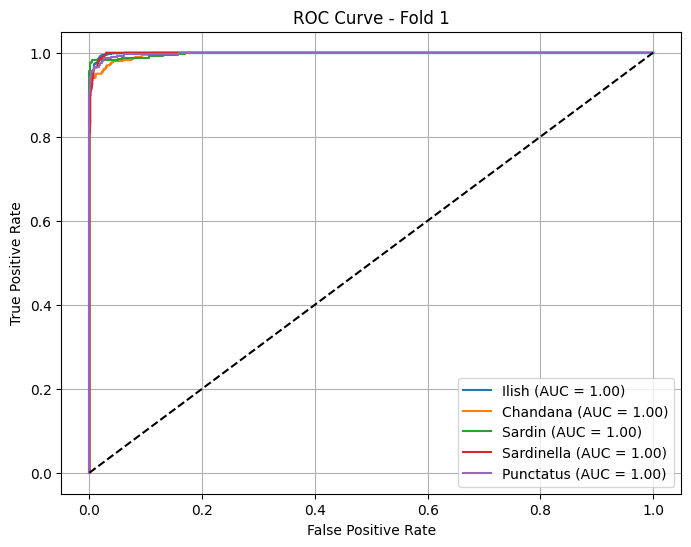

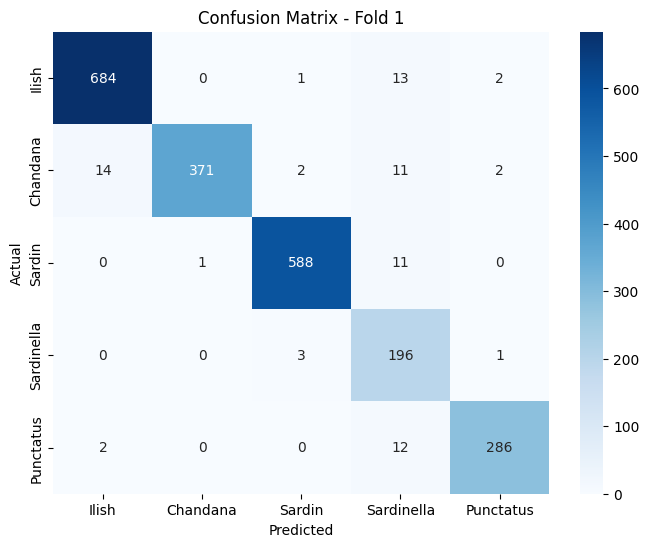

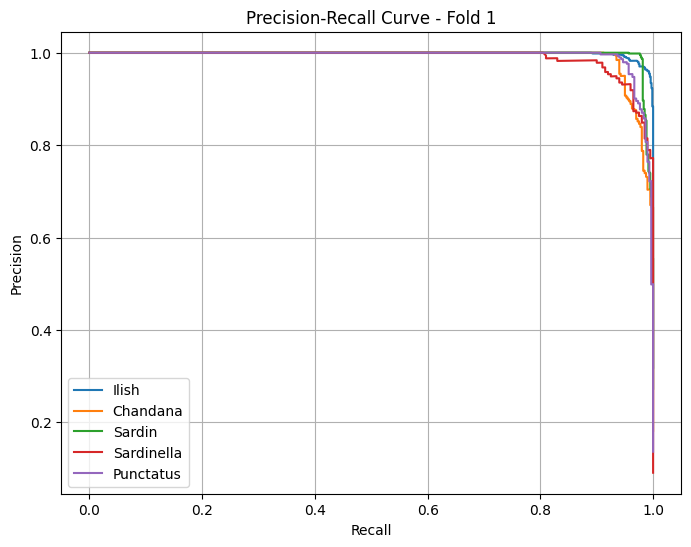

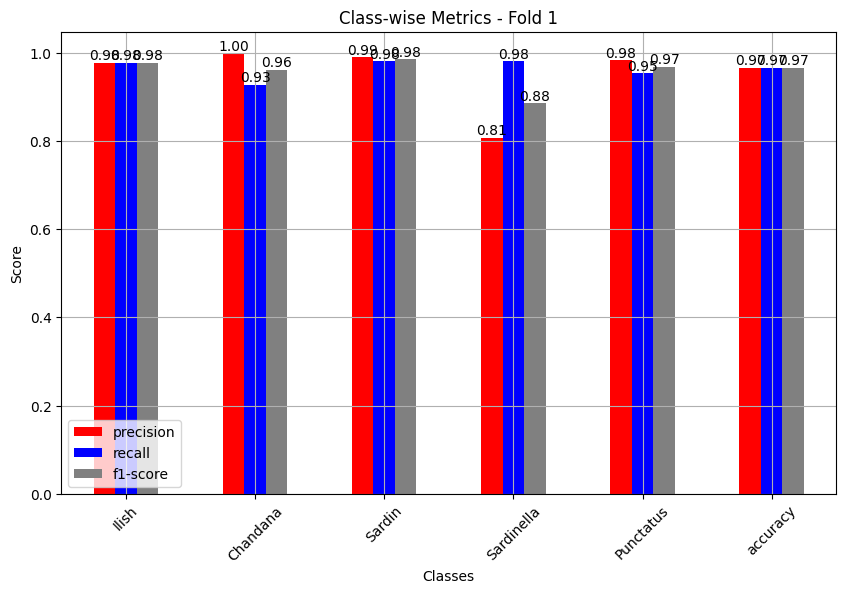

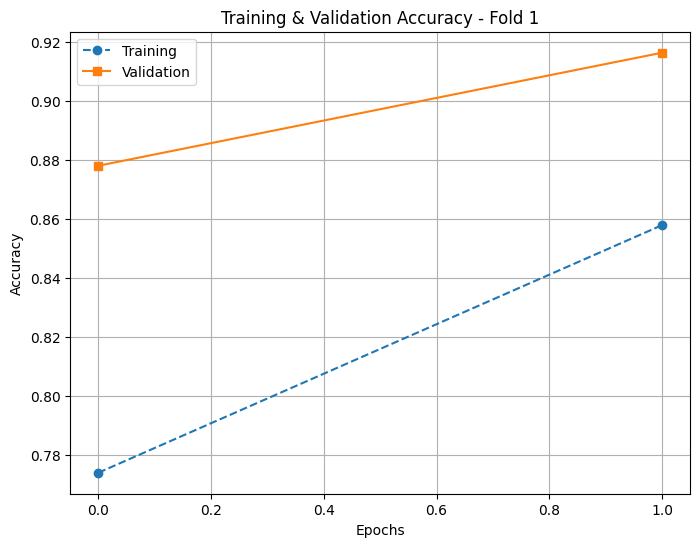

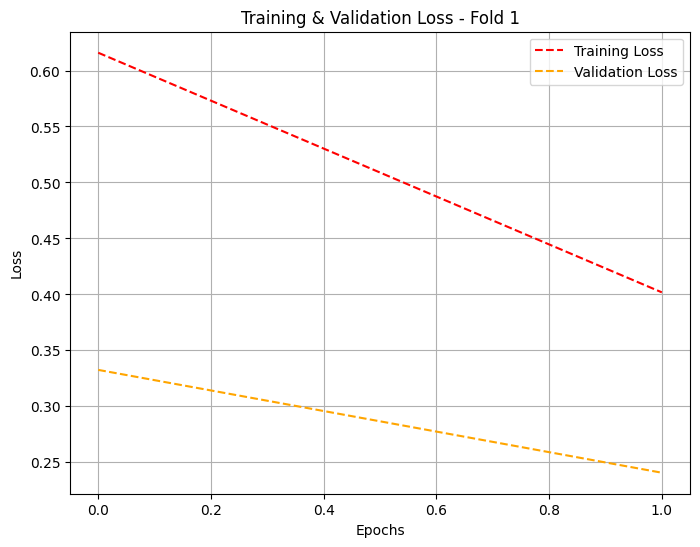

Classification Report - Fold 1:
              precision    recall  f1-score   support

       Ilish       0.98      0.98      0.98       700
    Chandana       1.00      0.93      0.96       400
      Sardin       0.99      0.98      0.98       600
  Sardinella       0.81      0.98      0.88       200
   Punctatus       0.98      0.95      0.97       300

    accuracy                           0.97      2200
   macro avg       0.95      0.96      0.96      2200
weighted avg       0.97      0.97      0.97      2200


Evaluating Fold 2:
275/275 ━━━━━━━━━━━━━━━━━━━━ 7s 11ms/step
275/275 ━━━━━━━━━━━━━━━━━━━━ 8s 6ms/step


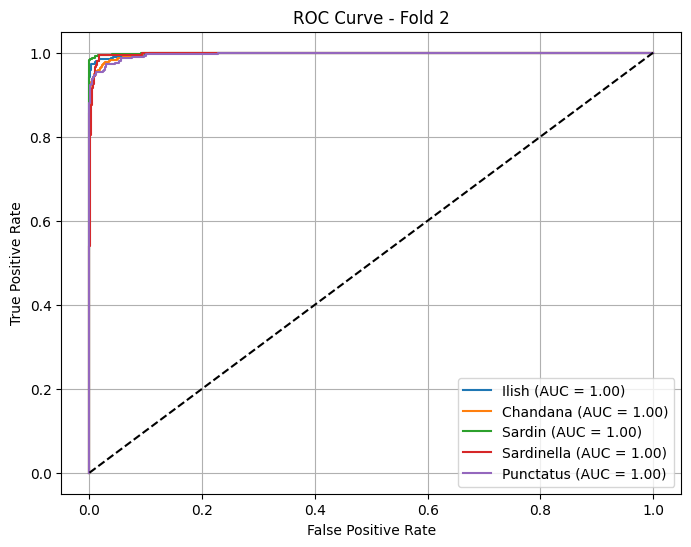

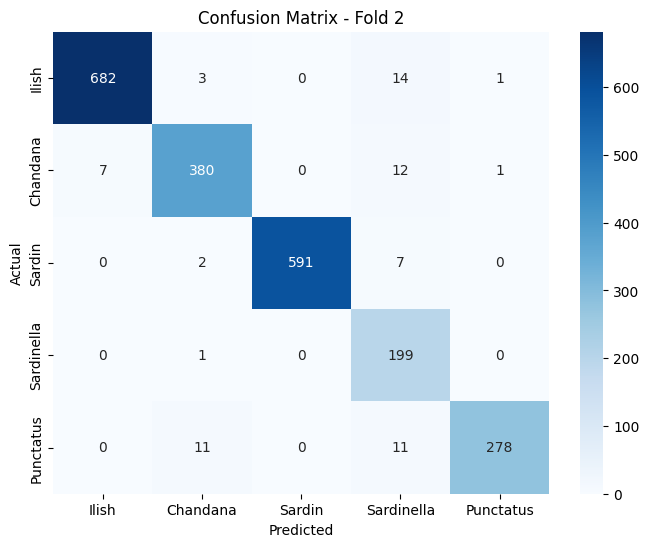

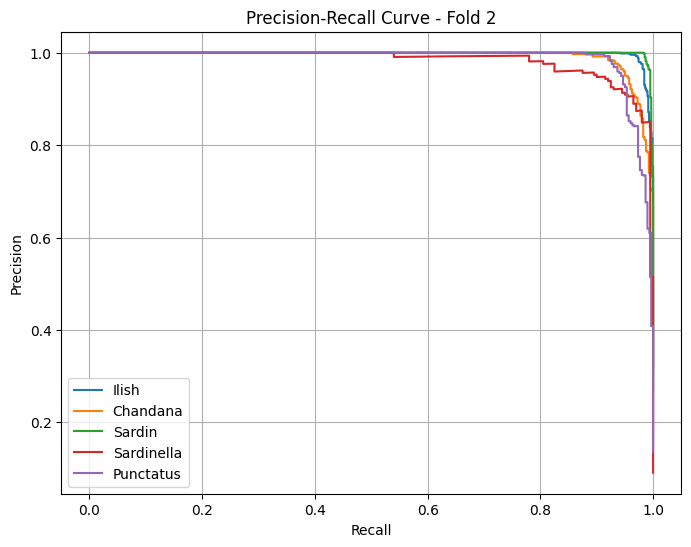

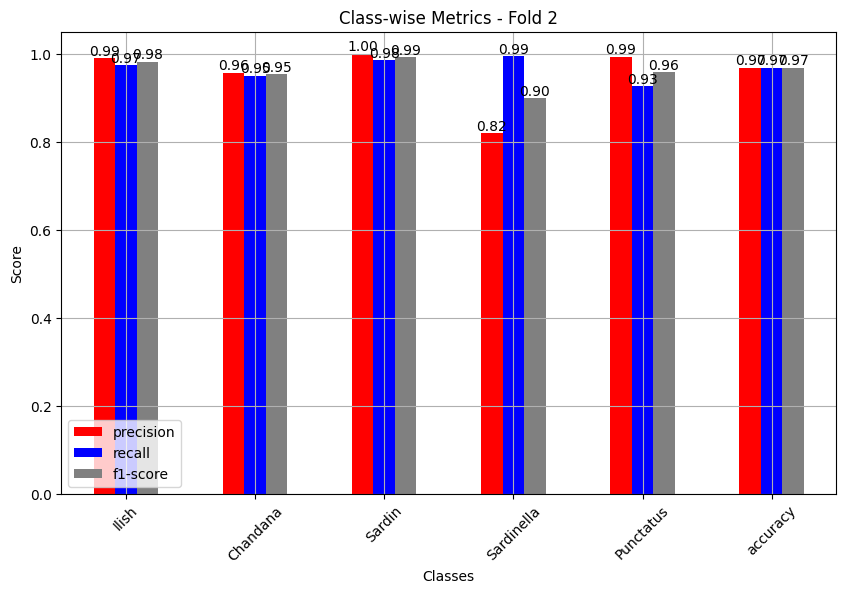

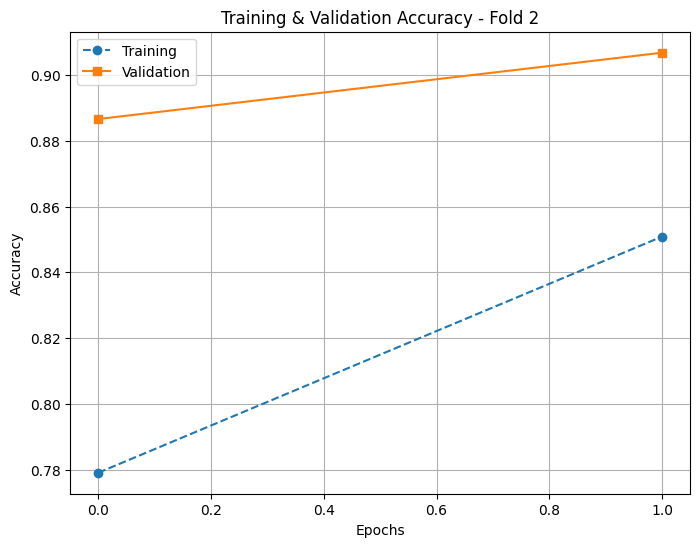

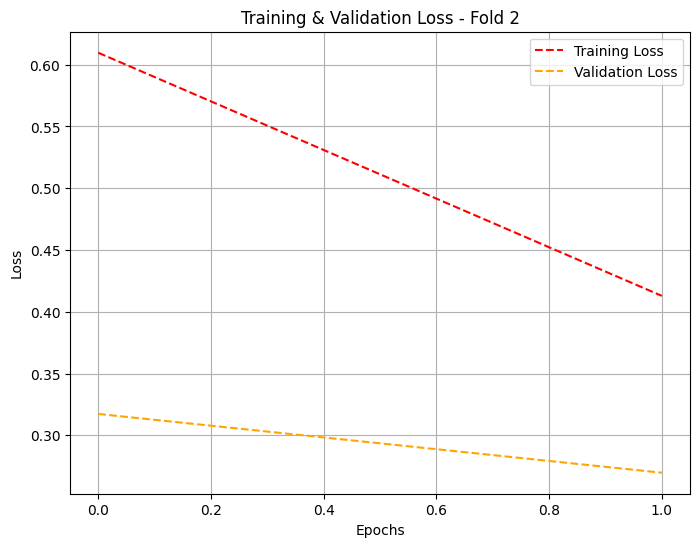

Classification Report - Fold 2:
              precision    recall  f1-score   support

       Ilish       0.99      0.97      0.98       700
    Chandana       0.96      0.95      0.95       400
      Sardin       1.00      0.98      0.99       600
  Sardinella       0.82      0.99      0.90       200
   Punctatus       0.99      0.93      0.96       300

    accuracy                           0.97      2200
   macro avg       0.95      0.97      0.96      2200
weighted avg       0.97      0.97      0.97      2200


Combined Results for All Folds:


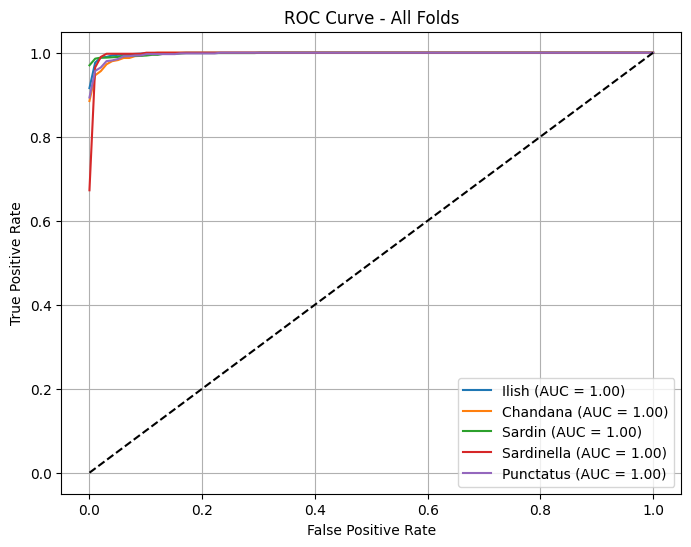

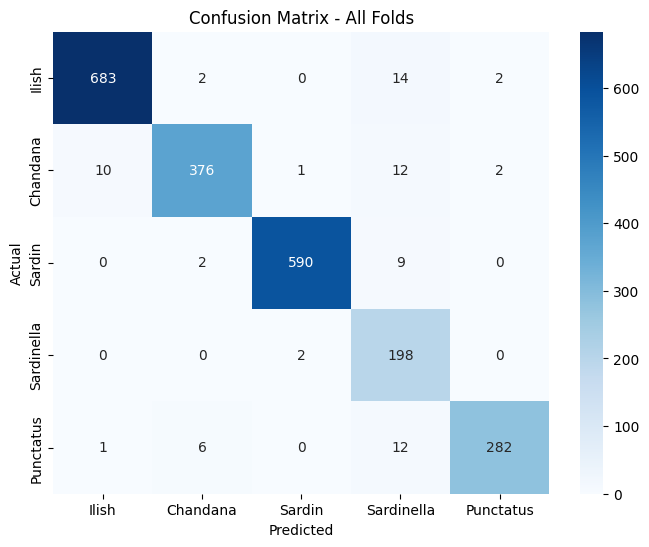

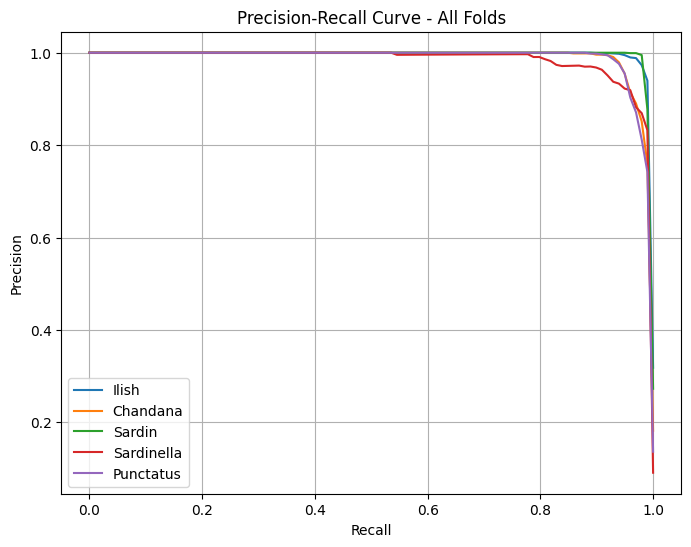

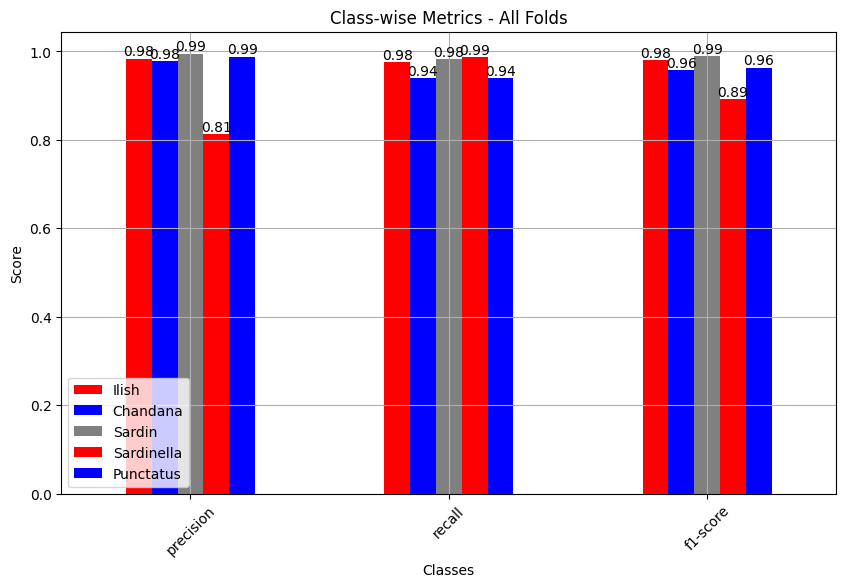

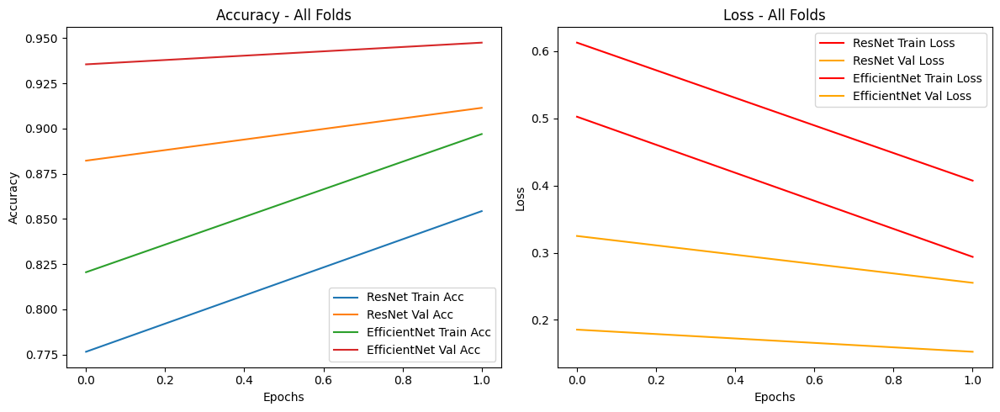


Final Combined Report (Simple Averaging Ensemble):
              precision    recall  f1-score   support

       Ilish       0.98      0.98      0.98       700
    Chandana       0.99      0.94      0.96       400
      Sardin       1.00      0.98      0.99       600
  Sardinella       0.82      0.99      0.90       200
   Punctatus       0.99      0.96      0.97       300

    accuracy                           0.97      2200
   macro avg       0.96      0.97      0.96      2200
weighted avg       0.97      0.97      0.97      2200

Final Accuracy: 0.9700, F1-Score: 0.9708


In [ ]:
# Install required packages
!pip install imbalanced-learn

import numpy as np
import tensorflow as tf
from tensorflow.keras.applications import ResNet50, EfficientNetB0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, LeakyReLU, BatchNormalization
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.metrics import roc_curve, auc, confusion_matrix, precision_recall_curve, classification_report, accuracy_score, f1_score
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import gc

# Enable mixed precision
tf.keras.mixed_precision.set_global_policy('mixed_float16')

# Configure GPU memory growth
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    for gpu in gpus:
        tf.config.experimental.set_memory_growth(gpu, True)
    print(f"{len(gpus)} GPUs detected.")
else:
    print("No GPU detected. Running on CPU.")

# Parameters
input_shape = (224, 224, 3)
num_classes = 5
batch_size = 8
epochs = 2
k_folds = 2
class_labels = ['Ilish', 'Chandana', 'Sardin', 'Sardinella', 'Punctatus']

# Assuming X and Y are loaded
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=42)

# Normalize in batches
# def normalize_in_batches(data, batch_size=1000):
#     data = data.astype('float32')  # Convert to float32
#     for i in range(0, len(data), batch_size):
#         data[i:min(i + batch_size, len(data))] /= 255.0
#     return data

# X_train_scaled = normalize_in_batches(X_train)
# X_test_scaled = normalize_in_batches(X_test)


# Apply SMOTE
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_train_resampled, Y_train_resampled = smote.fit_resample(X_train.reshape(X_train.shape[0], -1), Y_train)
X_train_resampled = X_train_resampled.reshape(-1, 224, 224, 3)
print("Class distribution after SMOTE:", Counter(Y_train_resampled))

# Image Augmentation
datagen = ImageDataGenerator(rotation_range=20, width_shift_range=0.2, height_shift_range=0.2, shear_range=0.2,
                             zoom_range=0.2, horizontal_flip=True, fill_mode="nearest")

def batch_generator(X, Y, batch_size=8):
    size = X.shape[0]
    while True:
        indices = np.random.permutation(size)
        for start in range(0, size, batch_size):
            batch_idx = indices[start:min(start + batch_size, size)]
            X_batch, Y_batch = X[batch_idx], Y[batch_idx]
            augmented_images = next(datagen.flow(X_batch, shuffle=False, batch_size=batch_size))
            yield augmented_images, to_categorical(Y_batch, num_classes)

# Base Model Definition
def create_base_model(input_shape=(224, 224, 3), model_type='ResNet'):
    base = ResNet50(weights='imagenet', include_top=False, input_shape=input_shape) if model_type == 'ResNet' else EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape)
    for layer in base.layers[:-5]:
        layer.trainable = False
    for layer in base.layers[-5:]:
        layer.trainable = True

    x = GlobalAveragePooling2D()(base.output)
    x = Dense(128)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.1)(x)
    x = Dropout(0.3)(x)
    output = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=base.input, outputs=output)
    model.compile(optimizer=Adam(learning_rate=0.0005), loss='categorical_crossentropy', metrics=['accuracy'])
    return model

# Simple Averaging Ensemble
def get_simple_ensemble_predictions(resnet_probs, efficientnet_probs):
    # Average the probabilities from both models
    ensemble_probs = (resnet_probs + efficientnet_probs) / 2
    ensemble_preds = np.argmax(ensemble_probs, axis=1)
    return ensemble_probs, ensemble_preds

# K-Fold Training
def train_with_kfold(X_train, Y_train, X_test, Y_test, k=2, batch_size=8, epochs=2):
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
    histories = {'ResNet': [], 'EfficientNet': []}
    trained_resnet_models, trained_efficientnet_models = [], []

    with tf.device('/GPU:0'):
        for fold_no, (train_idx, val_idx) in enumerate(skf.split(X_train, Y_train), 1):
            print(f"Training Fold {fold_no}/{k}")
            X_train_fold, X_val_fold = X_train[train_idx], X_train[val_idx]
            Y_train_fold, Y_val_fold = Y_train[train_idx], Y_train[val_idx]

            resnet_model = create_base_model(model_type='ResNet')
            efficientnet_model = create_base_model(model_type='EfficientNet')

            train_gen = batch_generator(X_train_fold, Y_train_fold, batch_size)
            val_gen = batch_generator(X_val_fold, Y_val_fold, batch_size)

            callbacks = [
                ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2),
                ModelCheckpoint(f'best_model_{fold_no}.h5', save_best_only=True, monitor='val_accuracy', mode='max'),
                EarlyStopping(monitor='val_accuracy', patience=3, restore_best_weights=True)
            ]

            resnet_history = resnet_model.fit(train_gen, validation_data=val_gen, epochs=epochs,
                                              steps_per_epoch=len(X_train_fold)//batch_size,
                                              validation_steps=len(X_val_fold)//batch_size, callbacks=callbacks, verbose=1)
            efficientnet_history = efficientnet_model.fit(train_gen, validation_data=val_gen, epochs=epochs,
                                                          steps_per_epoch=len(X_train_fold)//batch_size,
                                                          validation_steps=len(X_val_fold)//batch_size, callbacks=callbacks, verbose=1)

            histories['ResNet'].append(resnet_history)
            histories['EfficientNet'].append(efficientnet_history)
            trained_resnet_models.append(resnet_model)
            trained_efficientnet_models.append(efficientnet_model)

            tf.keras.backend.clear_session()
            gc.collect()

    return histories, trained_resnet_models, trained_efficientnet_models

# Evaluation and Plotting
def evaluate_and_plot(history_dict, X_test, Y_test, resnet_models, efficientnet_models):
    ensemble_probs_list, ensemble_preds_list = [], []

    with tf.device('/GPU:0'):
        # Fold-wise Visualization
        print("\nFold-by-Fold Visualizations:")
        for fold_no, (resnet_model, efficientnet_model, resnet_history) in enumerate(zip(resnet_models, efficientnet_models, history_dict['ResNet']), 1):
            print(f"\nEvaluating Fold {fold_no}:")
            resnet_probs = resnet_model.predict(X_test, batch_size=8)
            efficientnet_probs = efficientnet_model.predict(X_test, batch_size=8)
            ensemble_probs, ensemble_preds = get_simple_ensemble_predictions(resnet_probs, efficientnet_probs)
            ensemble_probs_list.append(ensemble_probs)
            ensemble_preds_list.append(ensemble_preds)

            # Fold-wise Plots
            def plot_roc_fold(Y_test, probs, fold_no):
                plt.figure(figsize=(8, 6))
                for i, cls in enumerate(class_labels):
                    fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                    roc_auc = auc(fpr, tpr)
                    plt.plot(fpr, tpr, label=f'{cls} (AUC = {roc_auc:.2f})')
                plt.plot([0, 1], [0, 1], 'k--')
                plt.title(f'ROC Curve - Fold {fold_no}')
                plt.xlabel('False Positive Rate')
                plt.ylabel('True Positive Rate')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_confusion_fold(Y_test, preds, fold_no):
                cm = confusion_matrix(Y_test, preds)
                plt.figure(figsize=(8, 6))
                sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
                plt.title(f'Confusion Matrix - Fold {fold_no}')
                plt.xlabel('Predicted')
                plt.ylabel('Actual')
                plt.show()

            def plot_pr_fold(Y_test, probs, fold_no):
                plt.figure(figsize=(8, 6))
                for i, cls in enumerate(class_labels):
                    precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                    plt.plot(recall, precision, label=cls)
                plt.title(f'Precision-Recall Curve - Fold {fold_no}')
                plt.xlabel('Recall')
                plt.ylabel('Precision')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_metrics_fold(Y_test, preds, fold_no):
                report = classification_report(Y_test, preds, target_names=class_labels, output_dict=True)
                df = pd.DataFrame(report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]
                df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
                for p in plt.gca().patches:
                    plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
                plt.title(f'Class-wise Metrics - Fold {fold_no}')
                plt.xlabel('Classes')
                plt.ylabel('Score')
                plt.xticks(rotation=45)
                plt.legend()
                plt.grid()
                plt.show()

            def plot_acc_fold(history, fold_no):
                plt.figure(figsize=(8, 6))
                plt.plot(history.history['accuracy'], label='Training', linestyle='dashed', marker='o')
                plt.plot(history.history['val_accuracy'], label='Validation', marker='s')
                plt.title(f'Training & Validation Accuracy - Fold {fold_no}')
                plt.xlabel('Epochs')
                plt.ylabel('Accuracy')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_loss_fold(history, fold_no):
                plt.figure(figsize=(8, 6))
                plt.plot(history.history['loss'], label='Training Loss', linestyle='dashed', color='red')
                plt.plot(history.history['val_loss'], label='Validation Loss', linestyle='dashed', color='orange')
                plt.title(f'Training & Validation Loss - Fold {fold_no}')
                plt.xlabel('Epochs')
                plt.ylabel('Loss')
                plt.legend()
                plt.grid()
                plt.show()

            def print_report_fold(Y_test, preds, fold_no):
                report = classification_report(Y_test, preds, target_names=class_labels)
                print(f"Classification Report - Fold {fold_no}:\n{report}")

            # Execute Fold-wise Plots
            plot_roc_fold(Y_test, ensemble_probs, fold_no)
            plot_confusion_fold(Y_test, ensemble_preds, fold_no)
            plot_pr_fold(Y_test, ensemble_probs, fold_no)
            plot_metrics_fold(Y_test, ensemble_preds, fold_no)
            plot_acc_fold(resnet_history, fold_no)
            plot_loss_fold(resnet_history, fold_no)
            print_report_fold(Y_test, ensemble_preds, fold_no)

            tf.keras.backend.clear_session()
            gc.collect()

        # Combined Visualizations
        print("\nCombined Results for All Folds:")
        def plot_roc_combined(Y_test, probs_list):
            plt.figure(figsize=(8, 6))
            mean_fpr = np.linspace(0, 1, 100)
            for i, cls in enumerate(class_labels):
                tprs, aucs = [], []
                for probs in probs_list:
                    fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                    tprs.append(np.interp(mean_fpr, fpr, tpr))
                    aucs.append(auc(fpr, tpr))
                mean_tpr = np.mean(tprs, axis=0)
                mean_auc = auc(mean_fpr, mean_tpr)
                plt.plot(mean_fpr, mean_tpr, label=f'{cls} (AUC = {mean_auc:.2f})')
            plt.plot([0, 1], [0, 1], 'k--')
            plt.title('ROC Curve - All Folds')
            plt.xlabel('False Positive Rate')
            plt.ylabel('True Positive Rate')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_confusion_combined(Y_test, preds_list):
            mean_cm = np.mean([confusion_matrix(Y_test, preds) for preds in preds_list], axis=0)
            plt.figure(figsize=(8, 6))
            sns.heatmap(mean_cm, annot=True, fmt='.0f', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
            plt.title('Confusion Matrix - All Folds')
            plt.xlabel('Predicted')
            plt.ylabel('Actual')
            plt.show()

        def plot_pr_combined(Y_test, probs_list):
            plt.figure(figsize=(8, 6))
            mean_recall = np.linspace(0, 1, 100)
            for i, cls in enumerate(class_labels):
                precisions = []
                for probs in probs_list:
                    precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                    precisions.append(np.interp(mean_recall[::-1], recall[::-1], precision[::-1])[::-1])
                mean_precision = np.mean(precisions, axis=0)
                plt.plot(mean_recall, mean_precision, label=cls)
            plt.title('Precision-Recall Curve - All Folds')
            plt.xlabel('Recall')
            plt.ylabel('Precision')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_metrics_combined(Y_test, preds_list):
            reports = [classification_report(Y_test, preds, target_names=class_labels, output_dict=True) for preds in preds_list]
            mean_report = {metric: {cls: np.mean([r[cls][metric] for r in reports]) for cls in class_labels}
                           for metric in ['precision', 'recall', 'f1-score']}
            df = pd.DataFrame(mean_report).T
            df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
            for p in plt.gca().patches:
                plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
            plt.title('Class-wise Metrics - All Folds')
            plt.xlabel('Classes')
            plt.ylabel('Score')
            plt.xticks(rotation=45)
            plt.legend()
            plt.grid()
            plt.show()

        def plot_acc_loss_combined(history_dict):
            plt.figure(figsize=(12, 5))
            for model, histories in history_dict.items():
                mean_acc = np.mean([h.history['accuracy'] for h in histories], axis=0)
                mean_val_acc = np.mean([h.history['val_accuracy'] for h in histories], axis=0)
                mean_loss = np.mean([h.history['loss'] for h in histories], axis=0)
                mean_val_loss = np.mean([h.history['val_loss'] for h in histories], axis=0)
                plt.subplot(1, 2, 1)
                plt.plot(mean_acc, label=f'{model} Train Acc')
                plt.plot(mean_val_acc, label=f'{model} Val Acc')
                plt.title('Accuracy - All Folds')
                plt.xlabel('Epochs')
                plt.ylabel('Accuracy')
                plt.legend()
                plt.grid()
                plt.subplot(1, 2, 2)
                plt.plot(mean_loss, label=f'{model} Train Loss', color='red')
                plt.plot(mean_val_loss, label=f'{model} Val Loss', color='orange')
                plt.title('Loss - All Folds')
                plt.xlabel('Epochs')
                plt.ylabel('Loss')
                plt.legend()
                plt.grid()
            plt.tight_layout()
            plt.show()

        def print_final_report(Y_test, probs_list):
            mean_probs = np.mean(probs_list, axis=0)
            final_preds = np.argmax(mean_probs, axis=1)
            report = classification_report(Y_test, final_preds, target_names=class_labels)
            acc = accuracy_score(Y_test, final_preds)
            f1 = f1_score(Y_test, final_preds, average='weighted')
            print(f"\nFinal Combined Report (Simple Averaging Ensemble):\n{report}")
            print(f"Final Accuracy: {acc:.4f}, F1-Score: {f1:.4f}")

        # Execute Combined Plots
        plot_roc_combined(Y_test, ensemble_probs_list)
        plot_confusion_combined(Y_test, ensemble_preds_list)
        plot_pr_combined(Y_test, ensemble_probs_list)
        plot_metrics_combined(Y_test, ensemble_preds_list)
        plot_acc_loss_combined(history_dict)
        print_final_report(Y_test, ensemble_probs_list)

# Train and Evaluate
history_dict, resnet_models, efficientnet_models = train_with_kfold(X_train_resampled, Y_train_resampled, X_test, Y_test)
print("Training Complete with Simple Averaging Ensemble.")
evaluate_and_plot(history_dict, X_test, Y_test, resnet_models, efficientnet_models)


#2nd -Learnable Weighted Ensemble

# Understanding the `create_ensemble_model`

1. **Input**: A 224x224x3 image.
2. **Base Models**: ResNet50 and EfficientNetB0 analyze the image and produce feature maps.
3. **Pooling**: Feature maps are reduced to vectors (2048 for ResNet50, 1280 for EfficientNetB0).
4. **Projection**: Both vectors are adjusted to a common size (1280).
5. **Weighted Combination**: A trainable `alpha` blends the two outputs (e.g., 50% ResNet50 + 50% EfficientNetB0).
6. **Final Layers**: The combined result is processed to predict one of 5 classes.



1 GPUs detected.
Class distribution after SMOTE: Counter({np.int64(3): 2800, np.int64(0): 2800, np.int64(1): 2800, np.int64(4): 2800, np.int64(2): 2800})
Training Fold 1/5
Epoch 1/10
1400/1400 ━━━━━━━━━━━━━━━━━━━━ 194s 112ms/step - accuracy: 0.7363 - loss: 0.7733 - val_accuracy: 0.9371 - val_loss: 0.1888 - learning_rate: 0.0010
Epoch 2/10
1400/1400 ━━━━━━━━━━━━━━━━━━━━ 146s 104ms/step - accuracy: 0.9184 - loss: 0.2579 - val_accuracy: 0.9454 - val_loss: 0.1796 - learning_rate: 0.0010
Epoch 3/10
1400/1400 ━━━━━━━━━━━━━━━━━━━━ 141s 101ms/step - accuracy: 0.9348 - loss: 0.2058 - val_accuracy: 0.9446 - val_loss: 0.1722 - learning_rate: 0.0010
Epoch 4/10
1400/1400 ━━━━━━━━━━━━━━━━━━━━ 141s 101ms/step - accuracy: 0.9440 - loss: 0.1789 - val_accuracy: 0.9546 - val_loss: 0.1405 - learning_rate: 0.0010
Epoch 5/10
1400/1400 ━━━━━━━━━━━━━━━━━━━━ 141s 101ms/step - accuracy: 0.9567 - loss: 0.1313 - val_accuracy: 0.9582 - val_loss: 0.1281 - learning_rate: 0.0010
Epoch 6/10
1400/1400 ━━━━━━━━━━━━━━━━━

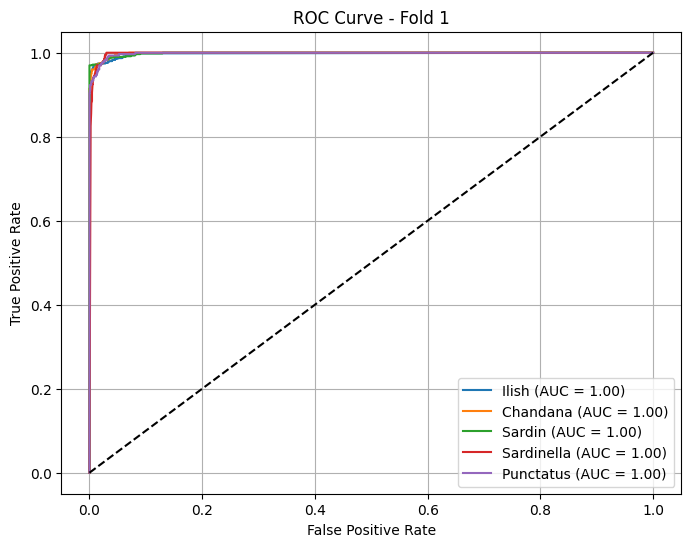

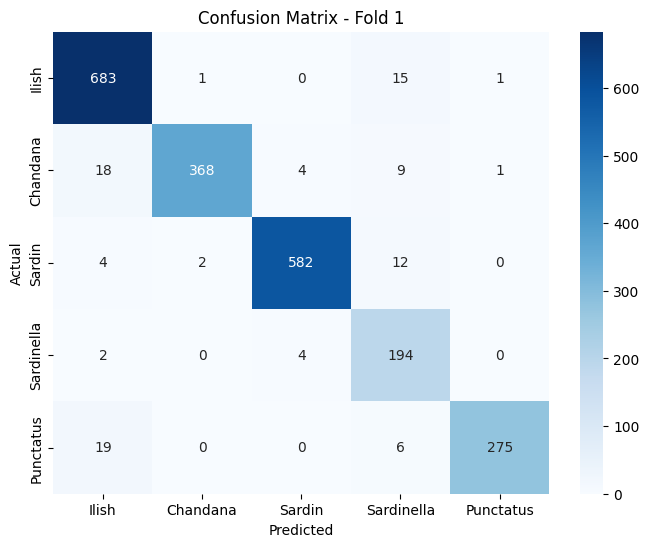

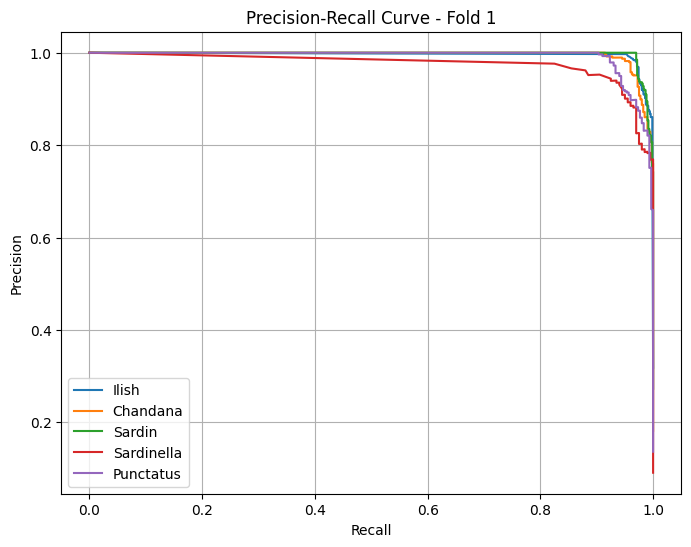

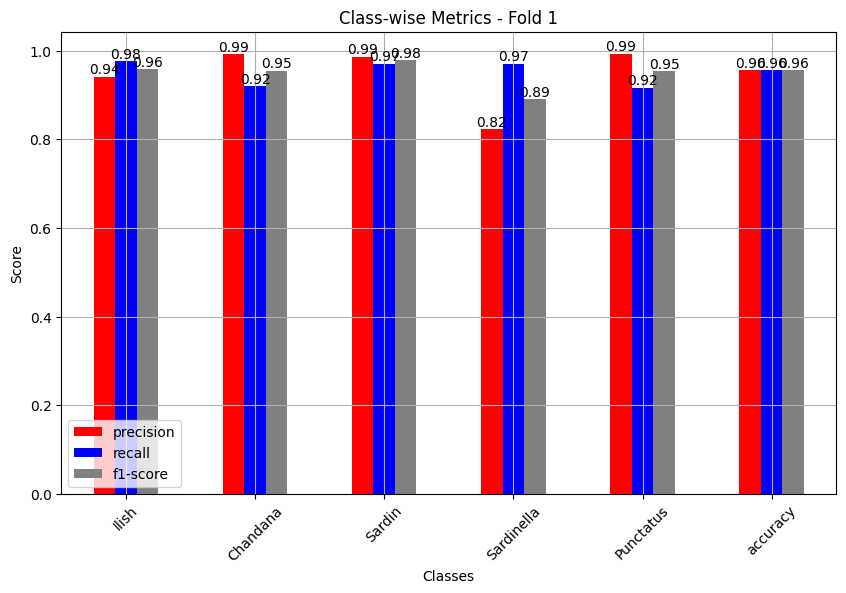

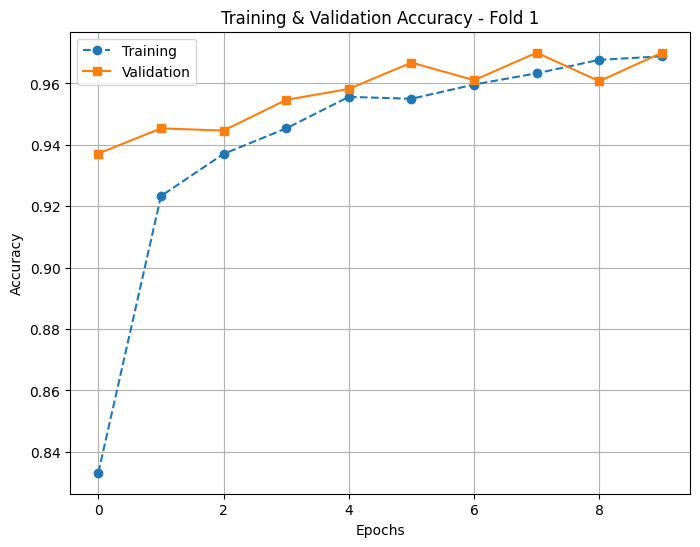

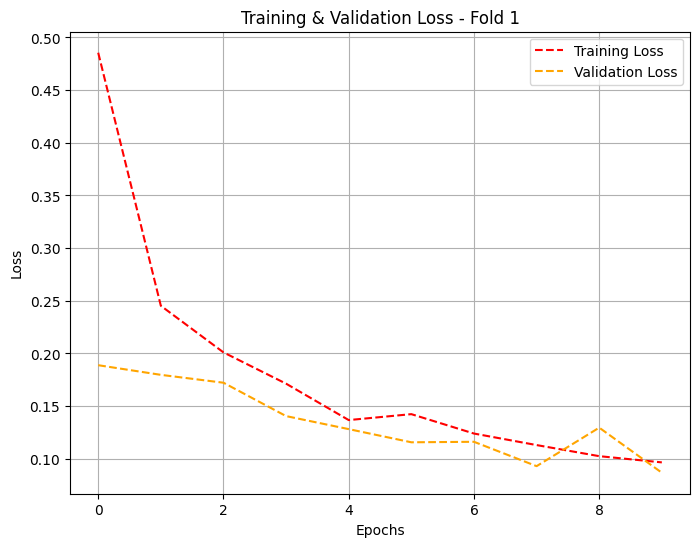

Classification Report - Fold 1:
              precision    recall  f1-score   support

       Ilish       0.94      0.98      0.96       700
    Chandana       0.99      0.92      0.95       400
      Sardin       0.99      0.97      0.98       600
  Sardinella       0.82      0.97      0.89       200
   Punctatus       0.99      0.92      0.95       300

    accuracy                           0.96      2200
   macro avg       0.95      0.95      0.95      2200
weighted avg       0.96      0.96      0.96      2200


Evaluating Fold 2:
275/275 ━━━━━━━━━━━━━━━━━━━━ 15s 16ms/step


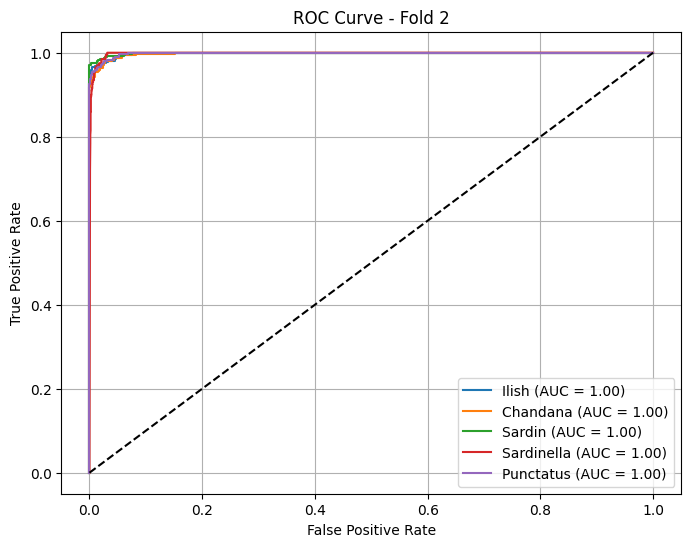

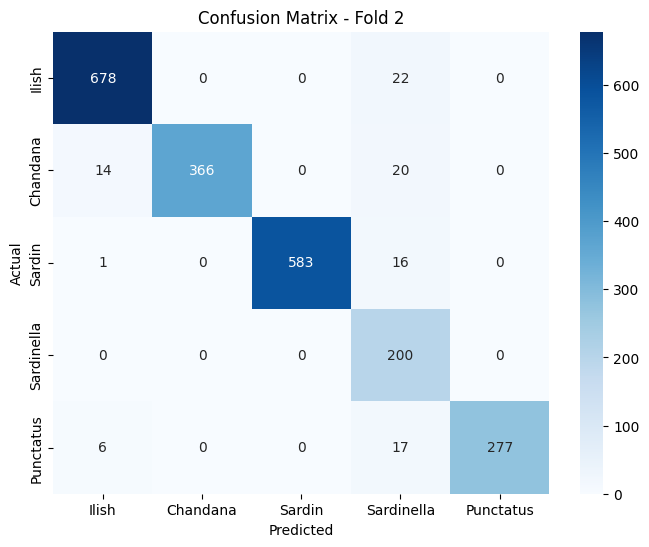

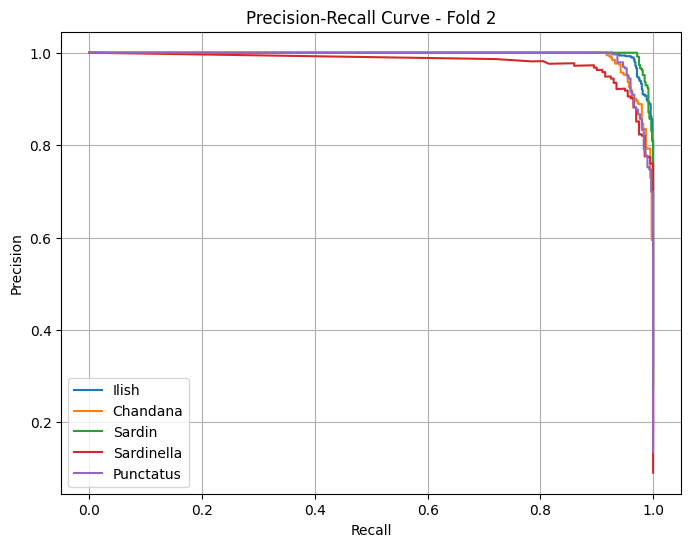

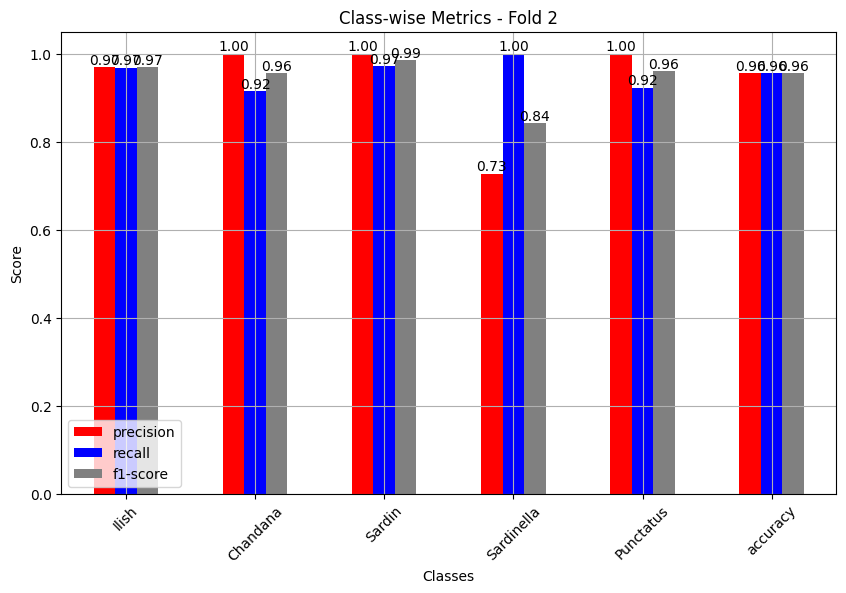

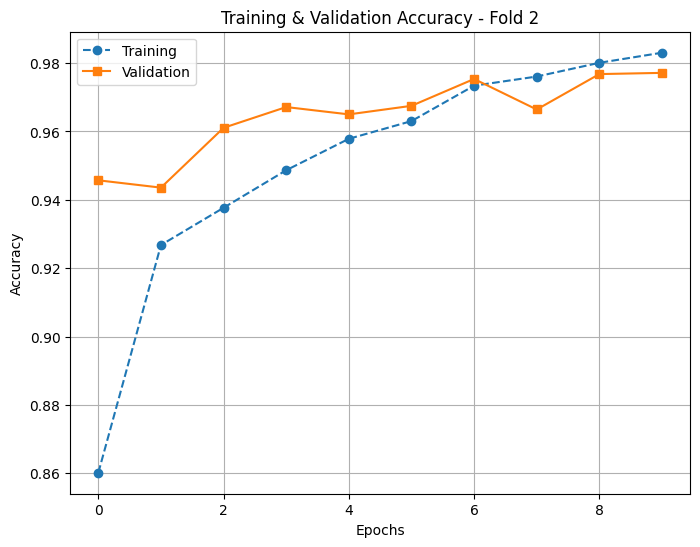

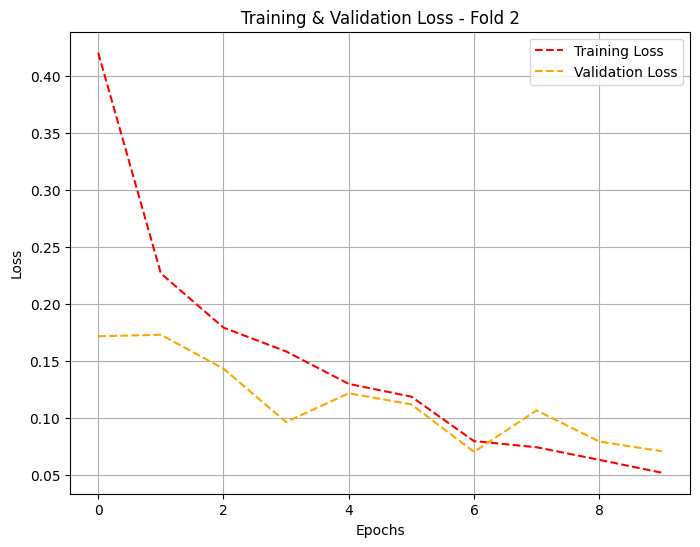

Classification Report - Fold 2:
              precision    recall  f1-score   support

       Ilish       0.97      0.97      0.97       700
    Chandana       1.00      0.92      0.96       400
      Sardin       1.00      0.97      0.99       600
  Sardinella       0.73      1.00      0.84       200
   Punctatus       1.00      0.92      0.96       300

    accuracy                           0.96      2200
   macro avg       0.94      0.96      0.94      2200
weighted avg       0.97      0.96      0.96      2200


Evaluating Fold 3:
275/275 ━━━━━━━━━━━━━━━━━━━━ 15s 16ms/step


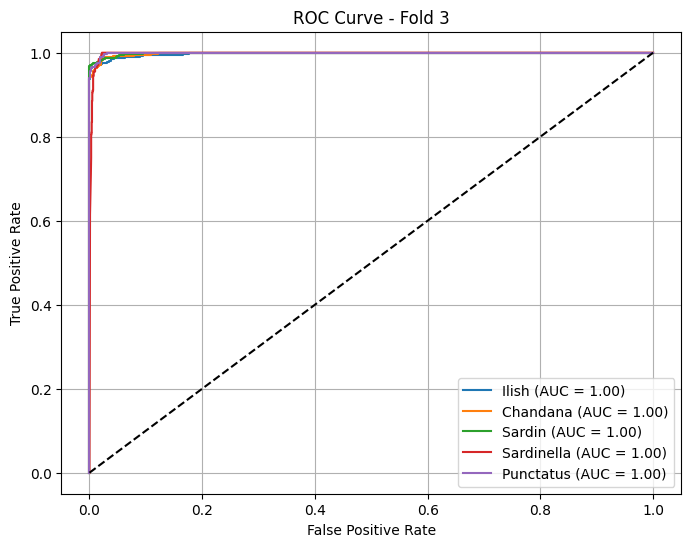

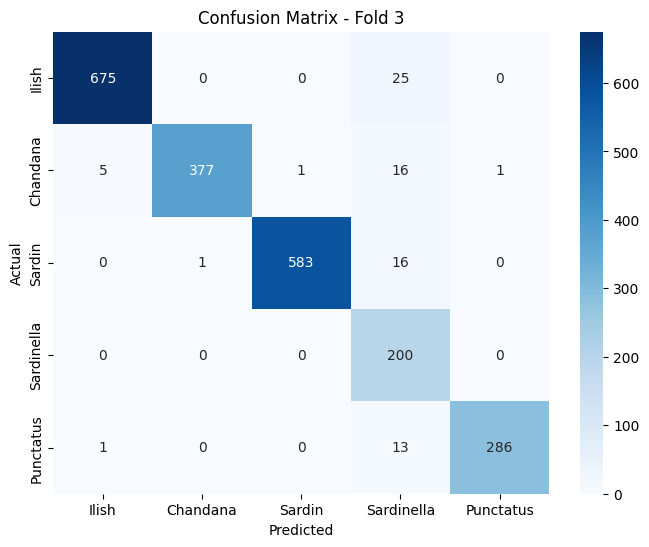

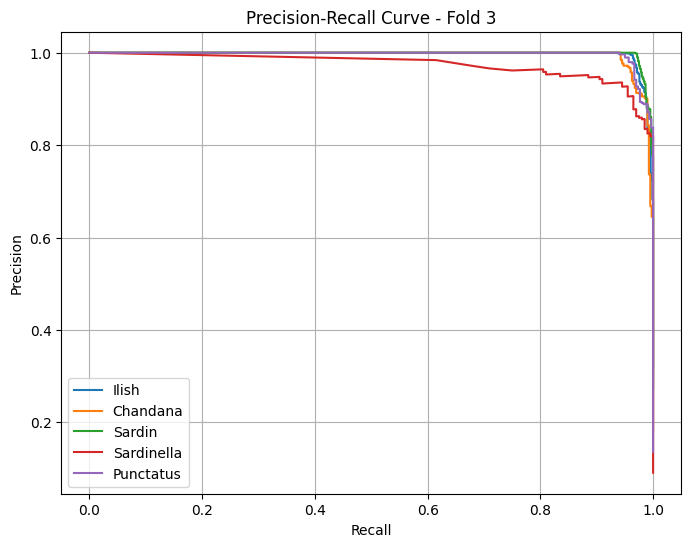

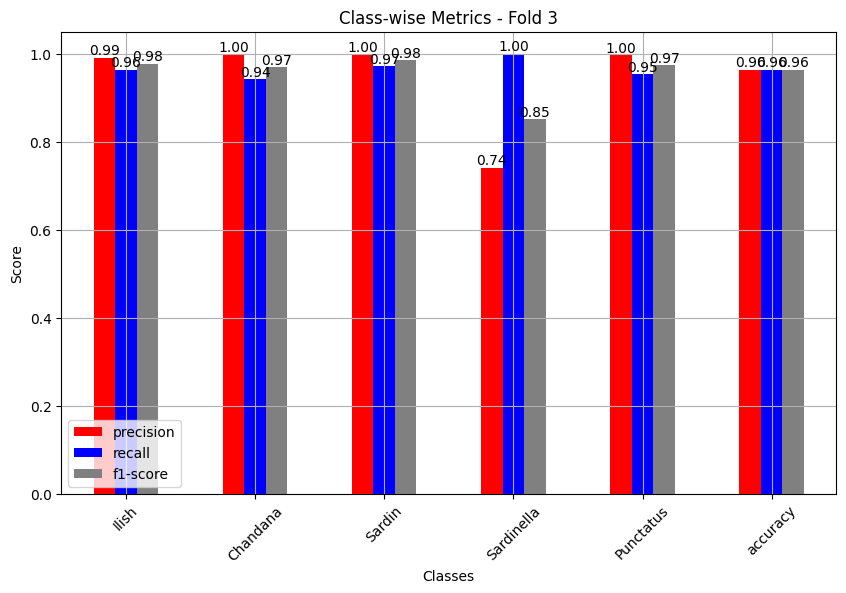

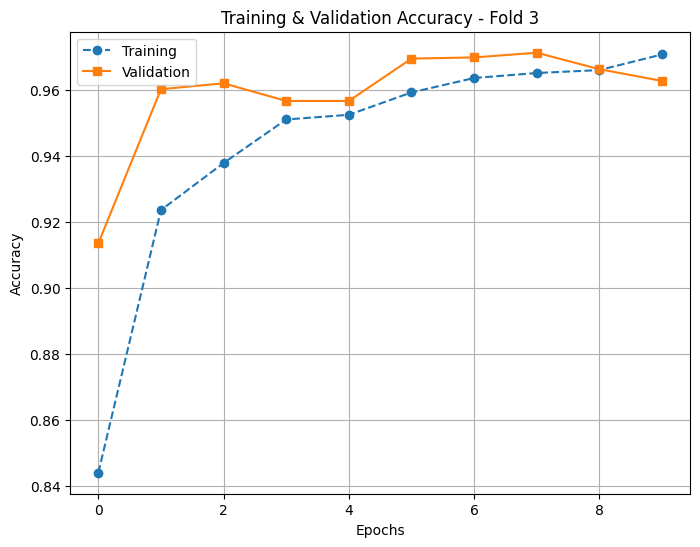

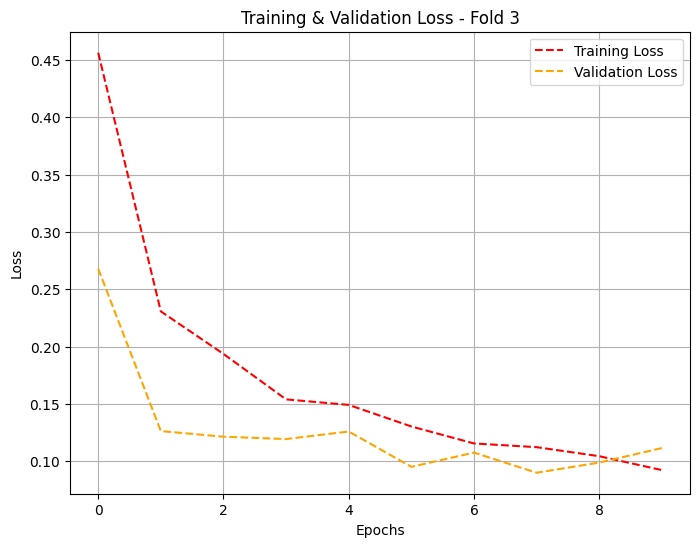

Classification Report - Fold 3:
              precision    recall  f1-score   support

       Ilish       0.99      0.96      0.98       700
    Chandana       1.00      0.94      0.97       400
      Sardin       1.00      0.97      0.98       600
  Sardinella       0.74      1.00      0.85       200
   Punctatus       1.00      0.95      0.97       300

    accuracy                           0.96      2200
   macro avg       0.94      0.97      0.95      2200
weighted avg       0.97      0.96      0.97      2200


Evaluating Fold 4:
275/275 ━━━━━━━━━━━━━━━━━━━━ 15s 16ms/step


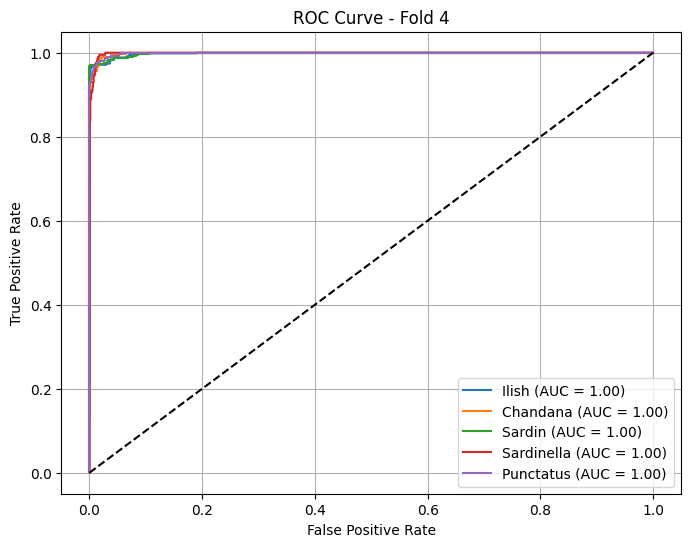

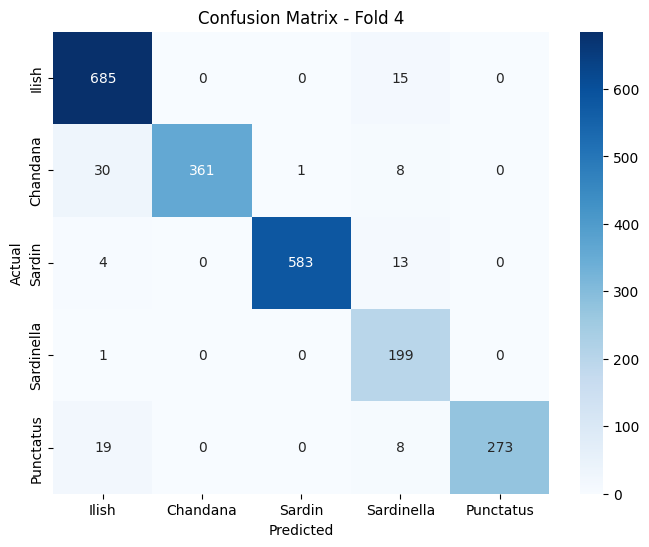

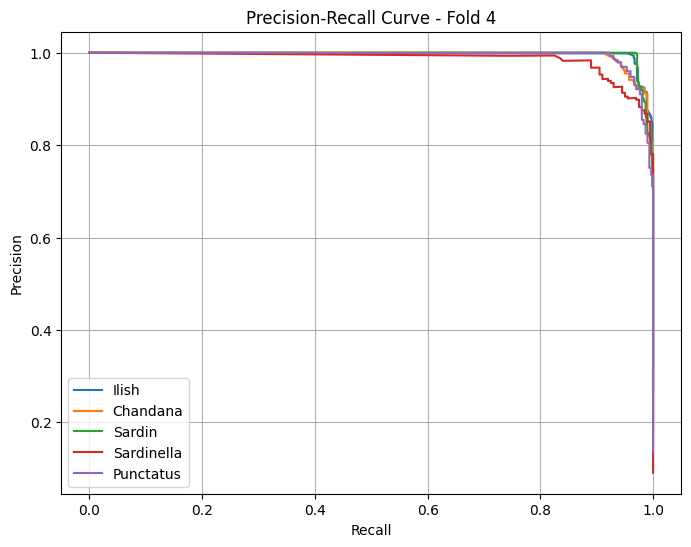

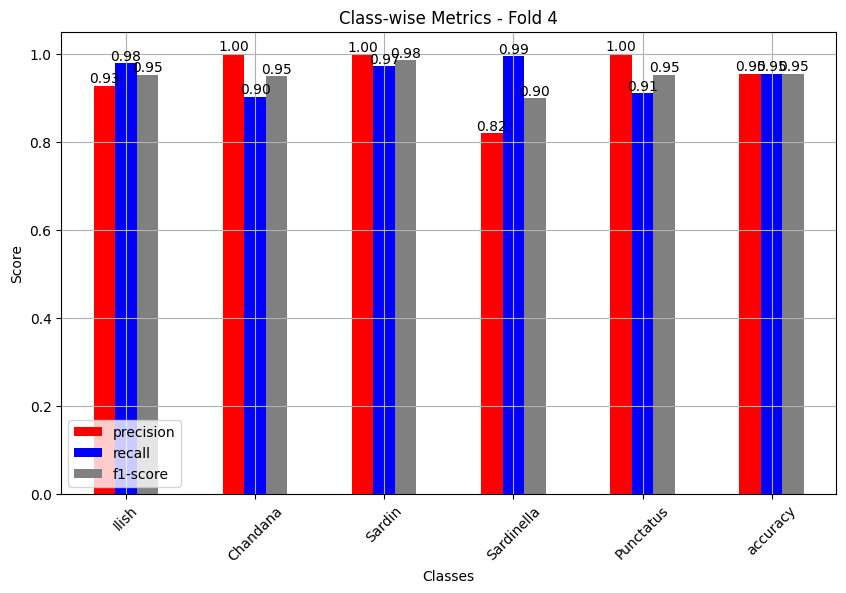

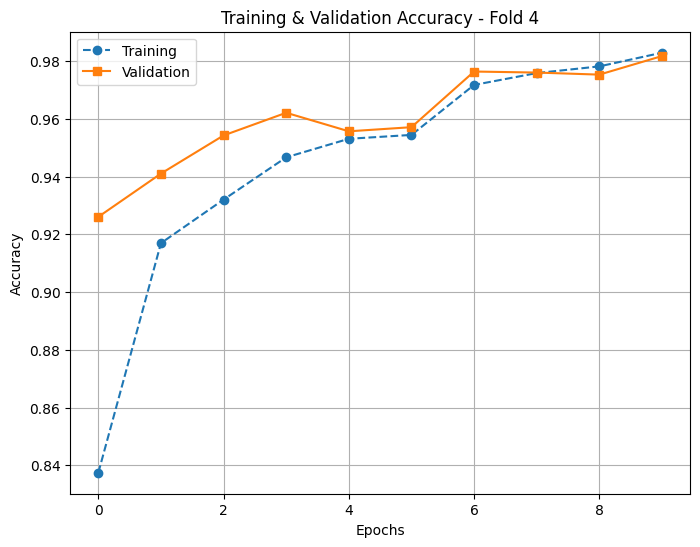

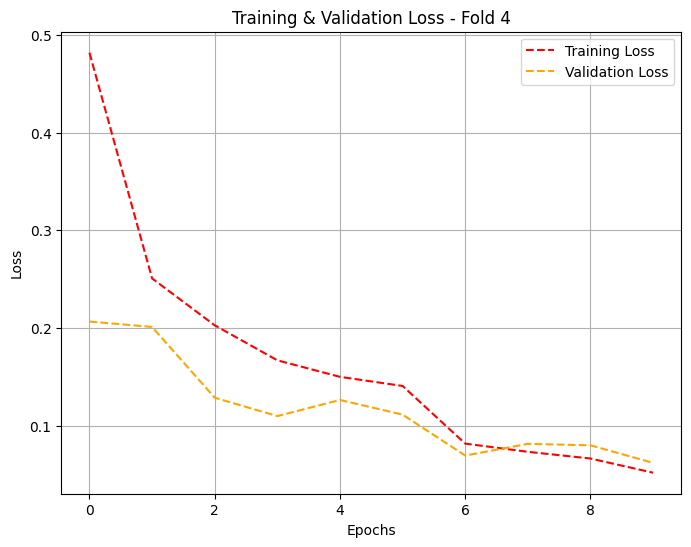

Classification Report - Fold 4:
              precision    recall  f1-score   support

       Ilish       0.93      0.98      0.95       700
    Chandana       1.00      0.90      0.95       400
      Sardin       1.00      0.97      0.98       600
  Sardinella       0.82      0.99      0.90       200
   Punctatus       1.00      0.91      0.95       300

    accuracy                           0.95      2200
   macro avg       0.95      0.95      0.95      2200
weighted avg       0.96      0.95      0.96      2200


Evaluating Fold 5:
275/275 ━━━━━━━━━━━━━━━━━━━━ 15s 16ms/step


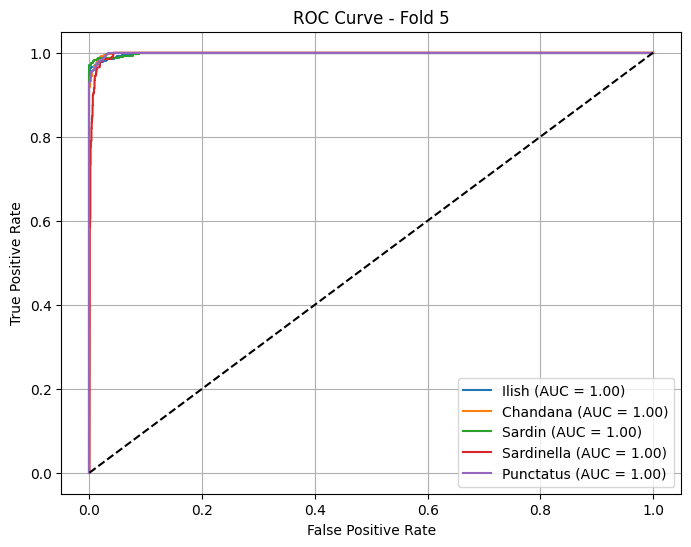

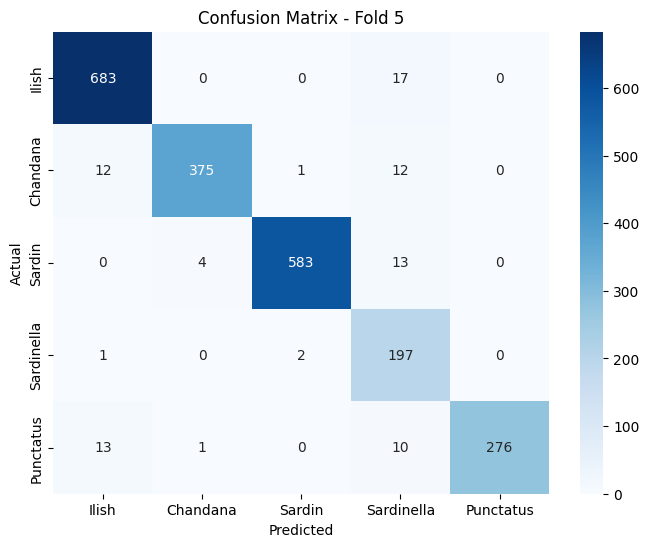

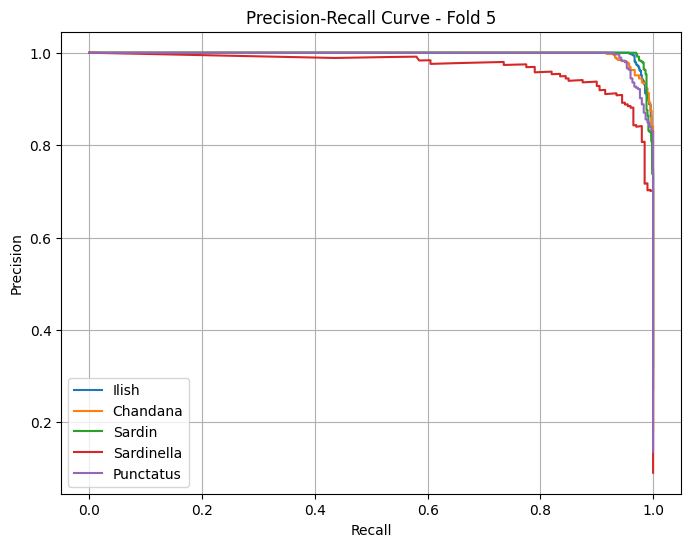

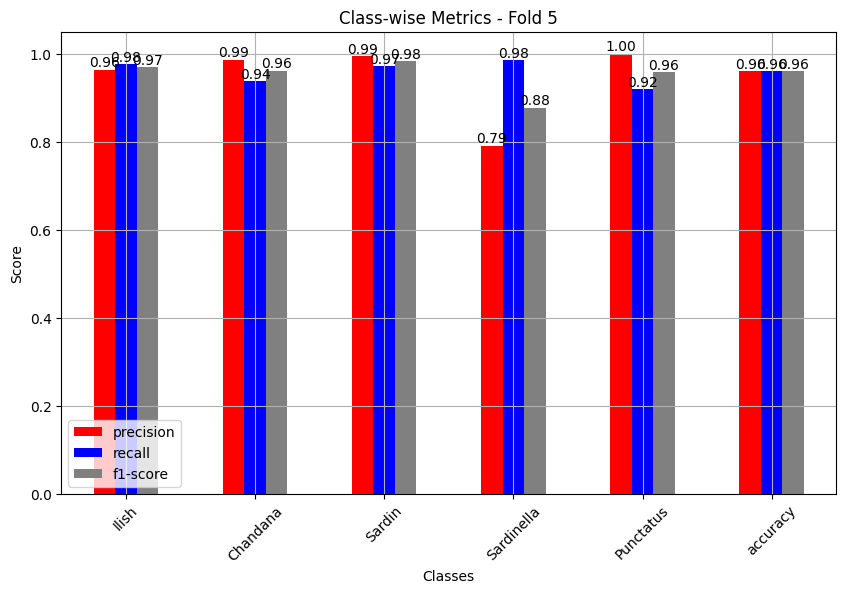

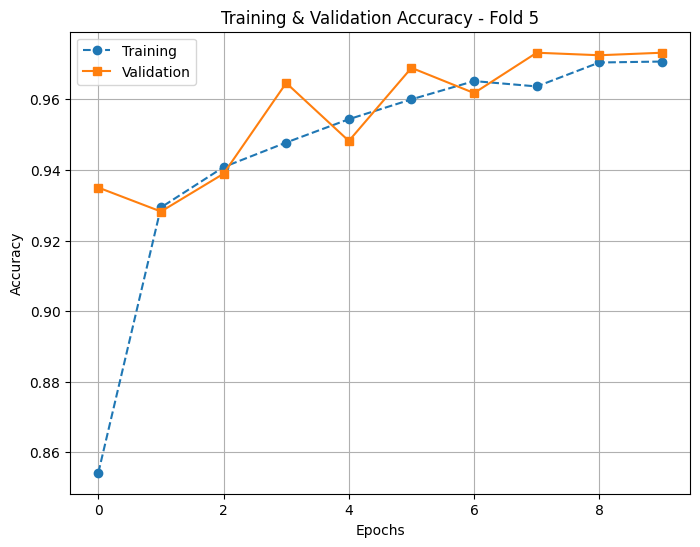

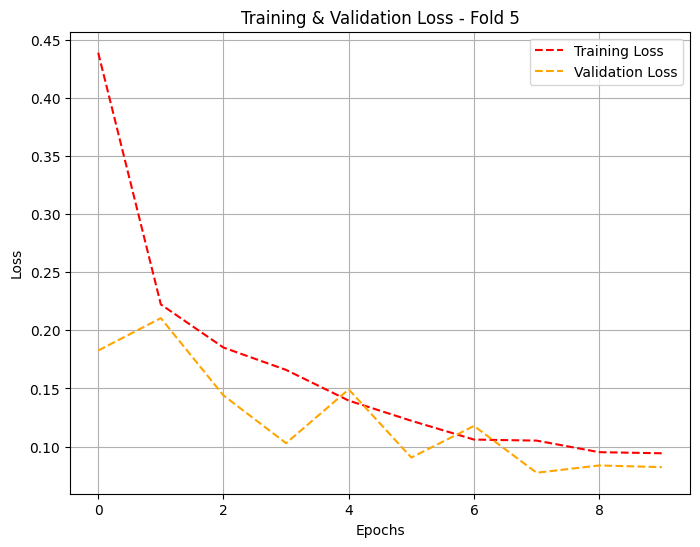

Classification Report - Fold 5:
              precision    recall  f1-score   support

       Ilish       0.96      0.98      0.97       700
    Chandana       0.99      0.94      0.96       400
      Sardin       0.99      0.97      0.98       600
  Sardinella       0.79      0.98      0.88       200
   Punctatus       1.00      0.92      0.96       300

    accuracy                           0.96      2200
   macro avg       0.95      0.96      0.95      2200
weighted avg       0.97      0.96      0.96      2200


Combined Results for All Folds:


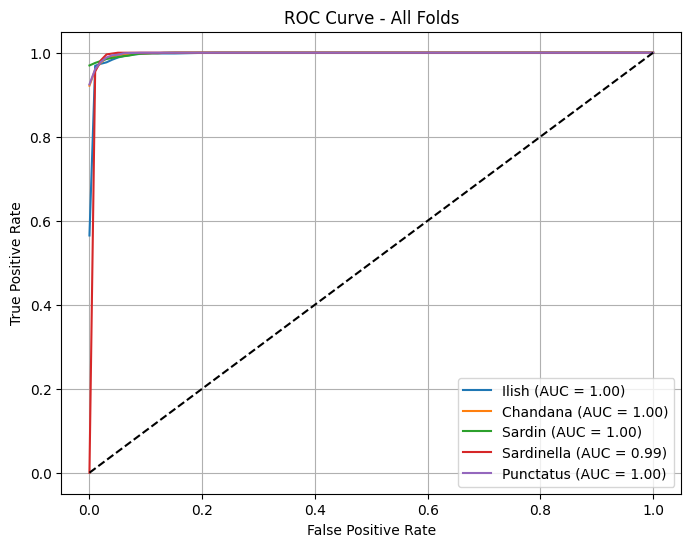

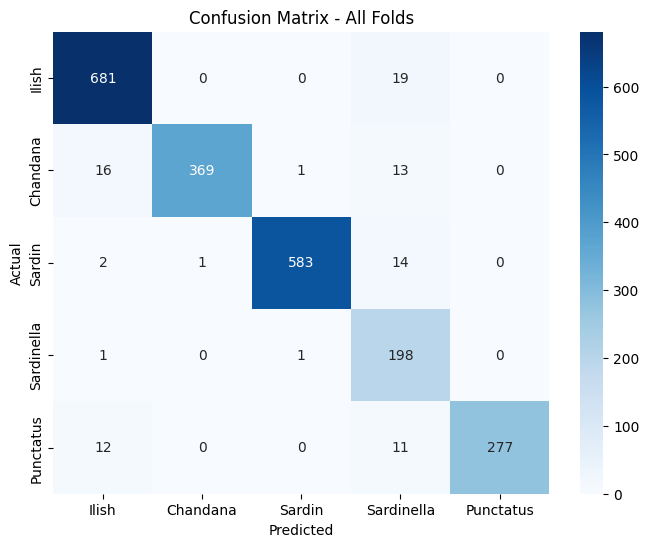

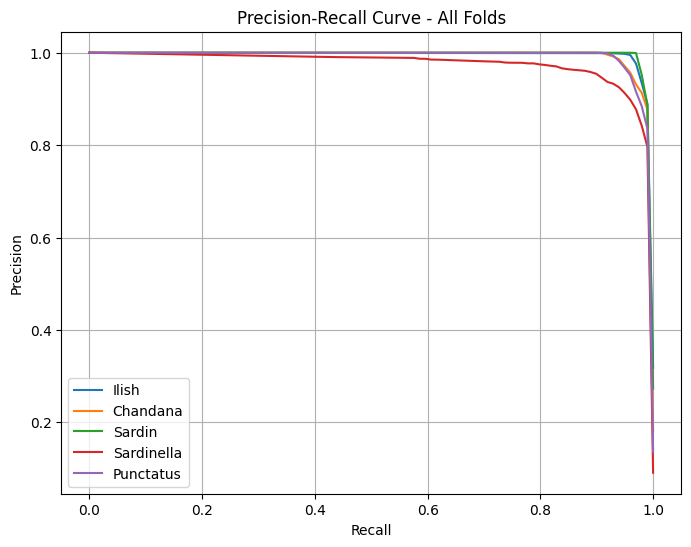

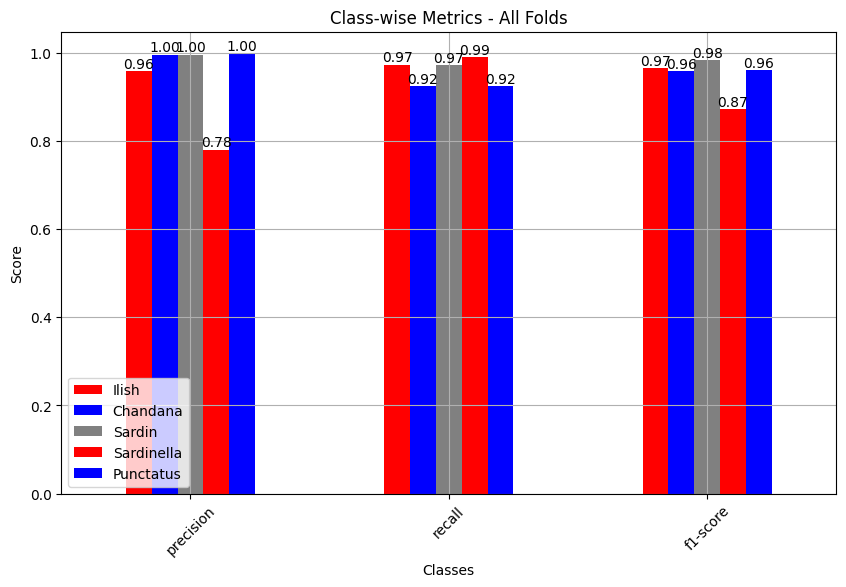

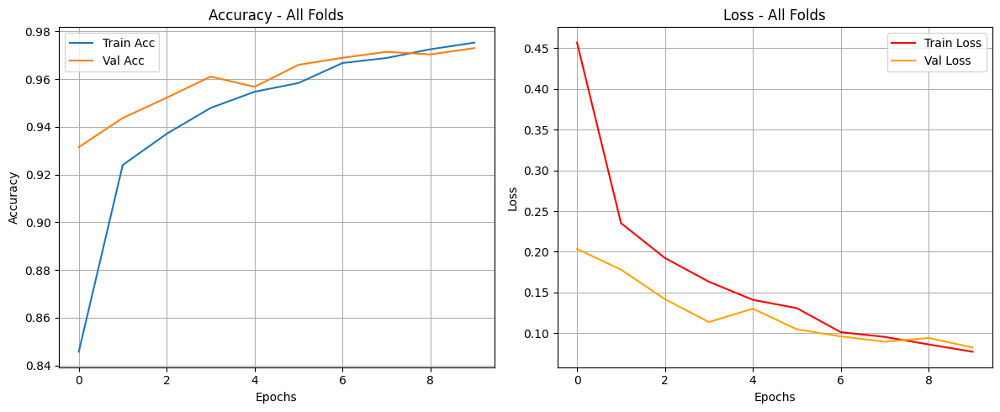


Final Combined Report (Learnable Weighted Ensemble):
              precision    recall  f1-score   support

       Ilish       0.95      0.97      0.96       700
    Chandana       1.00      0.93      0.96       400
      Sardin       1.00      0.97      0.99       600
  Sardinella       0.77      0.99      0.87       200
   Punctatus       1.00      0.92      0.96       300

    accuracy                           0.96      2200
   macro avg       0.94      0.96      0.95      2200
weighted avg       0.96      0.96      0.96      2200

Final Accuracy: 0.9577, F1-Score: 0.9591


In [ ]:
# Install required packages
!pip install imbalanced-learn

import numpy as np
import tensorflow as tf
from tensorflow.keras.applications import ResNet50, EfficientNetB0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, Input, Lambda
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.metrics import roc_curve, auc, confusion_matrix, precision_recall_curve, classification_report, accuracy_score, f1_score
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import gc
from collections import Counter

# Enable mixed precision
tf.keras.mixed_precision.set_global_policy('mixed_float16')

# Configure GPU memory growth
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    for gpu in gpus:
        tf.config.experimental.set_memory_growth(gpu, True)
    print(f"{len(gpus)} GPUs detected.")
else:
    print("No GPU detected. Running on CPU.")

# Parameters
input_shape = (224, 224, 3)
num_classes = 5
batch_size = 8
epochs = 10
k_folds = 5
class_labels = ['Ilish', 'Chandana', 'Sardin', 'Sardinella', 'Punctatus']

# Assuming X and Y are loaded
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=42)

# Normalize in batches (commented out)
# def normalize_in_batches(data, batch_size=1000):
#     data = data.astype('float32')
#     for i in range(0, len(data), batch_size):
#         data[i:min(i + batch_size, len(data))] /= 255.0
#     return data

# X_train_scaled = normalize_in_batches(X_train)
# X_test_scaled = normalize_in_batches(X_test)
X_train_scaled = X_train  # Use raw data as-is
X_test_scaled = X_test    # Use raw data as-is

# Apply SMOTE
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_train_resampled, Y_train_resampled = smote.fit_resample(X_train_scaled.reshape(X_train_scaled.shape[0], -1), Y_train)
X_train_resampled = X_train_resampled.reshape(-1, 224, 224, 3)
print("Class distribution after SMOTE:", Counter(Y_train_resampled))

# Image Augmentation
datagen = ImageDataGenerator(rotation_range=20, width_shift_range=0.2, height_shift_range=0.2, shear_range=0.2,
                             zoom_range=0.2, horizontal_flip=True, fill_mode="nearest")

def batch_generator(X, Y, batch_size=8):
    size = X.shape[0]
    while True:
        indices = np.random.permutation(size)
        for start in range(0, size, batch_size):
            batch_idx = indices[start:min(start + batch_size, size)]
            X_batch, Y_batch = X[batch_idx], Y[batch_idx]
            augmented_images = next(datagen.flow(X_batch, shuffle=False, batch_size=batch_size))
            yield augmented_images, Y_batch  # Sparse labels for sparse_categorical_crossentropy

# Define Base Models
def create_base_model(input_shape=(224, 224, 3), model_type='ResNet'):
    base = ResNet50(weights='imagenet', include_top=False, input_shape=input_shape) if model_type == 'ResNet' else EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape)
    for layer in base.layers[:-5]:
        layer.trainable = False
    for layer in base.layers[-5:]:
        layer.trainable = True
    return base

# Define Ensemble Model with Fixed Shape and Type Correction
def create_ensemble_model(input_shape=(224, 224, 3), num_classes=5):
    # Create base models
    model1 = create_base_model(input_shape, model_type='ResNet')
    model2 = create_base_model(input_shape, model_type='EfficientNet')

    # Rename layers to avoid name clashes
    for layer in model1.layers:
        layer._name = f"resnet_{layer.name}"
    for layer in model2.layers:
        layer._name = f"efficientnet_{layer.name}"

    input_layer = Input(shape=input_shape)
    output1 = model1(input_layer)
    output2 = model2(input_layer)

    output1 = GlobalAveragePooling2D()(output1)  # Shape: (None, 2048) for ResNet50
    output2 = GlobalAveragePooling2D()(output2)  # Shape: (None, 1280) for EfficientNetB0

    # Project both outputs to a common dimension (e.g., 1280)
    output1 = Dense(1280, activation='relu')(output1)  # Outputs float32 by default
    output2 = Dense(1280, activation='relu')(output2)  # Outputs float32 by default

    # # Cast outputs to float16 to match alpha and mixed precision policy
    # output1 = tf.cast(output1, tf.float16)
    # output2 = tf.cast(output2, tf.float16)

    # Cast outputs to float16 using Lambda layer to match alpha and mixed precision policy
    output1 = Lambda(lambda x: tf.cast(x, tf.float16))(output1)
    output2 = Lambda(lambda x: tf.cast(x, tf.float16))(output2)

    # alpha = tf.Variable(0.5, trainable=True, dtype=tf.float16, name="alpha")
    # ensemble_output = Lambda(lambda x: alpha * x[0] + (1 - alpha) * x[1],
    #                          output_shape=(1280,))([output1, output2])

    alpha = tf.Variable(0.5, trainable=True, dtype=tf.float16, name="alpha")
    ensemble_output = Lambda(lambda x: alpha * tf.cast(x[0], tf.float16) + (1 - alpha) * tf.cast(x[1], tf.float16),
                         output_shape=(1280,))([output1, output2])

    x = Dense(128, activation='relu')(ensemble_output)
    x = Dropout(0.5)(x)
    final_output = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=input_layer, outputs=final_output)
    model.compile(optimizer=Adam(learning_rate=0.001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

# K-Fold Training
def train_with_kfold(X_train, Y_train, X_test, Y_test, k=5, batch_size=8, epochs=10):
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
    histories = []
    trained_models = []

    with tf.device('/GPU:0'):
        for fold_no, (train_idx, val_idx) in enumerate(skf.split(X_train, Y_train), 1):
            print(f"Training Fold {fold_no}/{k}")
            X_train_fold, X_val_fold = X_train[train_idx], X_train[val_idx]
            Y_train_fold, Y_val_fold = Y_train[train_idx], Y_train[val_idx]

            ensemble_model = create_ensemble_model(input_shape, num_classes)

            train_gen = batch_generator(X_train_fold, Y_train_fold, batch_size)
            val_gen = batch_generator(X_val_fold, Y_val_fold, batch_size)

            callbacks = [
                ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2),
                ModelCheckpoint(f'best_ensemble_model_{fold_no}.weights.h5', save_best_only=True,
                                monitor='val_accuracy', mode='max', save_weights_only=True),
                EarlyStopping(monitor='val_accuracy', patience=3, restore_best_weights=True)
            ]

            history = ensemble_model.fit(train_gen, validation_data=val_gen, epochs=epochs,
                                         steps_per_epoch=len(X_train_fold)//batch_size,
                                         validation_steps=len(X_val_fold)//batch_size, callbacks=callbacks, verbose=1)

            histories.append(history)
            trained_models.append(ensemble_model)

            tf.keras.backend.clear_session()
            gc.collect()

    return histories, trained_models

# Evaluation and Plotting
def evaluate_and_plot(histories, X_test, Y_test, trained_models):
    ensemble_probs_list, ensemble_preds_list = [], []

    with tf.device('/GPU:0'):
        # Fold-wise Visualization
        print("\nFold-by-Fold Visualizations:")
        for fold_no, (model, history) in enumerate(zip(trained_models, histories), 1):
            print(f"\nEvaluating Fold {fold_no}:")
            probs = model.predict(X_test, batch_size=8)
            preds = np.argmax(probs, axis=1)
            ensemble_probs_list.append(probs)
            ensemble_preds_list.append(preds)

            # Fold-wise Plots
            def plot_roc_fold(Y_test, probs, fold_no):
                plt.figure(figsize=(8, 6))
                for i, cls in enumerate(class_labels):
                    fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                    roc_auc = auc(fpr, tpr)
                    plt.plot(fpr, tpr, label=f'{cls} (AUC = {roc_auc:.2f})')
                plt.plot([0, 1], [0, 1], 'k--')
                plt.title(f'ROC Curve - Fold {fold_no}')
                plt.xlabel('False Positive Rate')
                plt.ylabel('True Positive Rate')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_confusion_fold(Y_test, preds, fold_no):
                cm = confusion_matrix(Y_test, preds)
                plt.figure(figsize=(8, 6))
                sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
                plt.title(f'Confusion Matrix - Fold {fold_no}')
                plt.xlabel('Predicted')
                plt.ylabel('Actual')
                plt.show()

            def plot_pr_fold(Y_test, probs, fold_no):
                plt.figure(figsize=(8, 6))
                for i, cls in enumerate(class_labels):
                    precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                    plt.plot(recall, precision, label=cls)
                plt.title(f'Precision-Recall Curve - Fold {fold_no}')
                plt.xlabel('Recall')
                plt.ylabel('Precision')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_metrics_fold(Y_test, preds, fold_no):
                report = classification_report(Y_test, preds, target_names=class_labels, output_dict=True)
                df = pd.DataFrame(report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]
                df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
                for p in plt.gca().patches:
                    plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
                plt.title(f'Class-wise Metrics - Fold {fold_no}')
                plt.xlabel('Classes')
                plt.ylabel('Score')
                plt.xticks(rotation=45)
                plt.legend()
                plt.grid()
                plt.show()

            def plot_acc_fold(history, fold_no):
                plt.figure(figsize=(8, 6))
                plt.plot(history.history['accuracy'], label='Training', linestyle='dashed', marker='o')
                plt.plot(history.history['val_accuracy'], label='Validation', marker='s')
                plt.title(f'Training & Validation Accuracy - Fold {fold_no}')
                plt.xlabel('Epochs')
                plt.ylabel('Accuracy')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_loss_fold(history, fold_no):
                plt.figure(figsize=(8, 6))
                plt.plot(history.history['loss'], label='Training Loss', linestyle='dashed', color='red')
                plt.plot(history.history['val_loss'], label='Validation Loss', linestyle='dashed', color='orange')
                plt.title(f'Training & Validation Loss - Fold {fold_no}')
                plt.xlabel('Epochs')
                plt.ylabel('Loss')
                plt.legend()
                plt.grid()
                plt.show()

            def print_report_fold(Y_test, preds, fold_no):
                report = classification_report(Y_test, preds, target_names=class_labels)
                print(f"Classification Report - Fold {fold_no}:\n{report}")

            # Execute Fold-wise Plots
            plot_roc_fold(Y_test, probs, fold_no)
            plot_confusion_fold(Y_test, preds, fold_no)
            plot_pr_fold(Y_test, probs, fold_no)
            plot_metrics_fold(Y_test, preds, fold_no)
            plot_acc_fold(history, fold_no)
            plot_loss_fold(history, fold_no)
            print_report_fold(Y_test, preds, fold_no)

            tf.keras.backend.clear_session()
            gc.collect()

        # Combined Visualizations
        print("\nCombined Results for All Folds:")
        def plot_roc_combined(Y_test, probs_list):
            plt.figure(figsize=(8, 6))
            mean_fpr = np.linspace(0, 1, 100)
            for i, cls in enumerate(class_labels):
                tprs, aucs = [], []
                for probs in probs_list:
                    fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                    tprs.append(np.interp(mean_fpr, fpr, tpr))
                    aucs.append(auc(fpr, tpr))
                mean_tpr = np.mean(tprs, axis=0)
                mean_auc = auc(mean_fpr, mean_tpr)
                plt.plot(mean_fpr, mean_tpr, label=f'{cls} (AUC = {mean_auc:.2f})')
            plt.plot([0, 1], [0, 1], 'k--')
            plt.title('ROC Curve - All Folds')
            plt.xlabel('False Positive Rate')
            plt.ylabel('True Positive Rate')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_confusion_combined(Y_test, preds_list):
            mean_cm = np.mean([confusion_matrix(Y_test, preds) for preds in preds_list], axis=0)
            plt.figure(figsize=(8, 6))
            sns.heatmap(mean_cm, annot=True, fmt='.0f', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
            plt.title('Confusion Matrix - All Folds')
            plt.xlabel('Predicted')
            plt.ylabel('Actual')
            plt.show()

        def plot_pr_combined(Y_test, probs_list):
            plt.figure(figsize=(8, 6))
            mean_recall = np.linspace(0, 1, 100)
            for i, cls in enumerate(class_labels):
                precisions = []
                for probs in probs_list:
                    precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                    precisions.append(np.interp(mean_recall[::-1], recall[::-1], precision[::-1])[::-1])
                mean_precision = np.mean(precisions, axis=0)
                plt.plot(mean_recall, mean_precision, label=cls)
            plt.title('Precision-Recall Curve - All Folds')
            plt.xlabel('Recall')
            plt.ylabel('Precision')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_metrics_combined(Y_test, preds_list):
            reports = [classification_report(Y_test, preds, target_names=class_labels, output_dict=True) for preds in preds_list]
            mean_report = {metric: {cls: np.mean([r[cls][metric] for r in reports]) for cls in class_labels}
                           for metric in ['precision', 'recall', 'f1-score']}
            df = pd.DataFrame(mean_report).T
            df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
            for p in plt.gca().patches:
                plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
            plt.title('Class-wise Metrics - All Folds')
            plt.xlabel('Classes')
            plt.ylabel('Score')
            plt.xticks(rotation=45)
            plt.legend()
            plt.grid()
            plt.show()

        def plot_acc_loss_combined(histories):
            plt.figure(figsize=(12, 5))
            mean_acc = np.mean([h.history['accuracy'] for h in histories], axis=0)
            mean_val_acc = np.mean([h.history['val_accuracy'] for h in histories], axis=0)
            mean_loss = np.mean([h.history['loss'] for h in histories], axis=0)
            mean_val_loss = np.mean([h.history['val_loss'] for h in histories], axis=0)
            plt.subplot(1, 2, 1)
            plt.plot(mean_acc, label='Train Acc')
            plt.plot(mean_val_acc, label='Val Acc')
            plt.title('Accuracy - All Folds')
            plt.xlabel('Epochs')
            plt.ylabel('Accuracy')
            plt.legend()
            plt.grid()
            plt.subplot(1, 2, 2)
            plt.plot(mean_loss, label='Train Loss', color='red')
            plt.plot(mean_val_loss, label='Val Loss', color='orange')
            plt.title('Loss - All Folds')
            plt.xlabel('Epochs')
            plt.ylabel('Loss')
            plt.legend()
            plt.grid()
            plt.tight_layout()
            plt.show()

        def print_final_report(Y_test, probs_list):
            mean_probs = np.mean(probs_list, axis=0)
            final_preds = np.argmax(mean_probs, axis=1)
            report = classification_report(Y_test, final_preds, target_names=class_labels)
            acc = accuracy_score(Y_test, final_preds)
            f1 = f1_score(Y_test, final_preds, average='weighted')
            print(f"\nFinal Combined Report (Learnable Weighted Ensemble):\n{report}")
            print(f"Final Accuracy: {acc:.4f}, F1-Score: {f1:.4f}")

        # Execute Combined Plots
        plot_roc_combined(Y_test, ensemble_probs_list)
        plot_confusion_combined(Y_test, ensemble_preds_list)
        plot_pr_combined(Y_test, ensemble_probs_list)
        plot_metrics_combined(Y_test, ensemble_preds_list)
        plot_acc_loss_combined(histories)
        print_final_report(Y_test, ensemble_probs_list)

# Train and Evaluate
histories, trained_models = train_with_kfold(X_train_resampled, Y_train_resampled, X_test_scaled, Y_test)
print("Training Complete with Learnable Weighted Ensemble.")
evaluate_and_plot(histories, X_test_scaled, Y_test, trained_models)

1 GPUs detected.
Class distribution after SMOTE: Counter({np.int32(1): 2400, np.int32(0): 2400, np.int32(3): 2400, np.int32(2): 2400, np.int32(4): 2400})
Training Fold 1/5
94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step
16705208/16705208 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step
Epoch 1/6
300/300 ━━━━━━━━━━━━━━━━━━━━ 177s 447ms/step - accuracy: 0.7980 - loss: 0.5742 - val_accuracy: 0.9496 - val_loss: 0.1592 - learning_rate: 0.0010
Epoch 2/6
300/300 ━━━━━━━━━━━━━━━━━━━━ 118s 396ms/step - accuracy: 0.9683 - loss: 0.1135 - val_accuracy: 0.9654 - val_loss: 0.1176 - learning_rate: 0.0010
Epoch 3/6
300/300 ━━━━━━━━━━━━━━━━━━━━ 118s 394ms/step - accuracy: 0.9774 - loss: 0.0718 - val_accuracy: 0.9883 - val_loss: 0.0364 - learning_rate: 0.0010
Epoch 4/6
300/300 ━━━━━━━━━━━━━━━━━━━━ 114s 383ms/step - accuracy: 0.9823 - loss: 0.0603 - val_accuracy: 0.9858 - val_loss: 0.0447 - learning_rate: 0.0010
Epoch 5/6
300/300 ━━━━━━━━━━━━━━━━━━━━ 114s 383ms/step - accuracy: 0.9852 - loss: 0.0472 - val_accuracy: 0

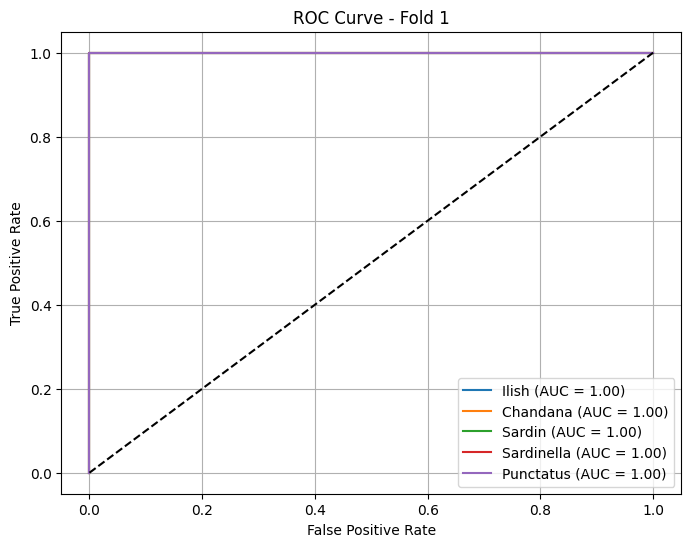

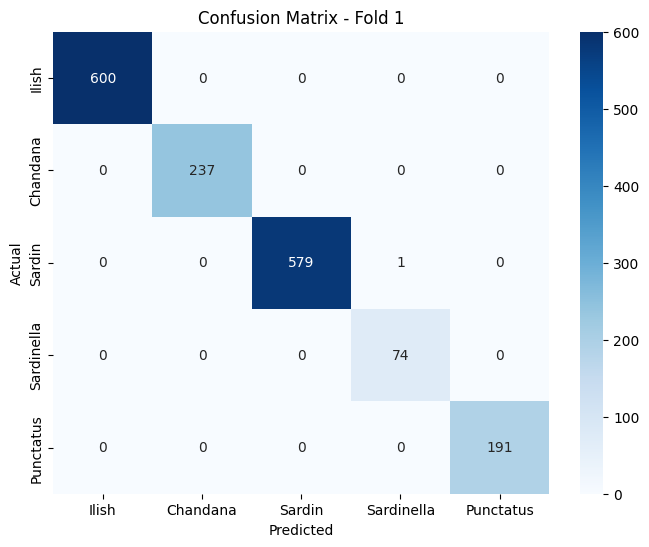

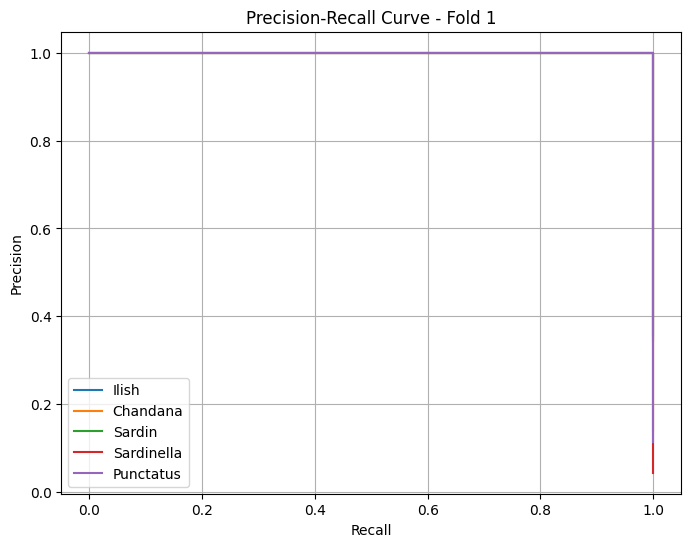

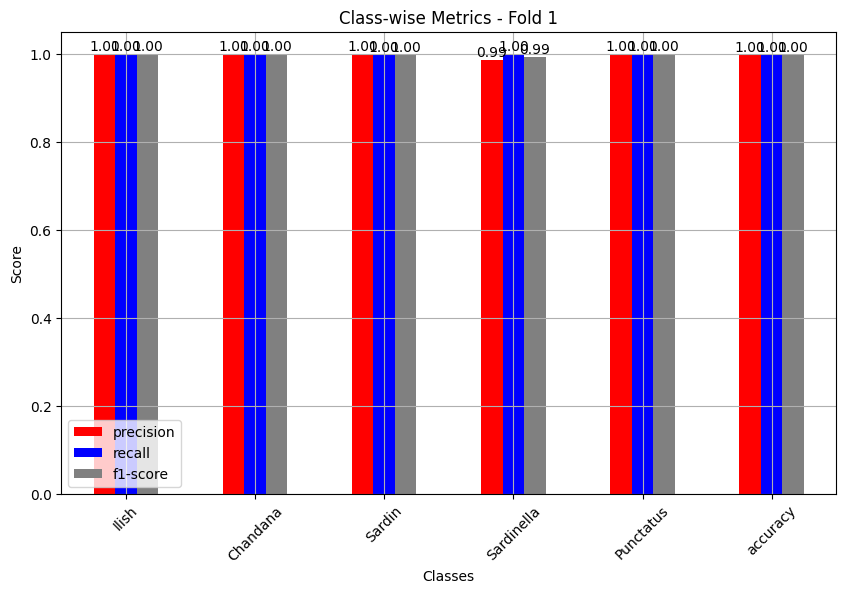

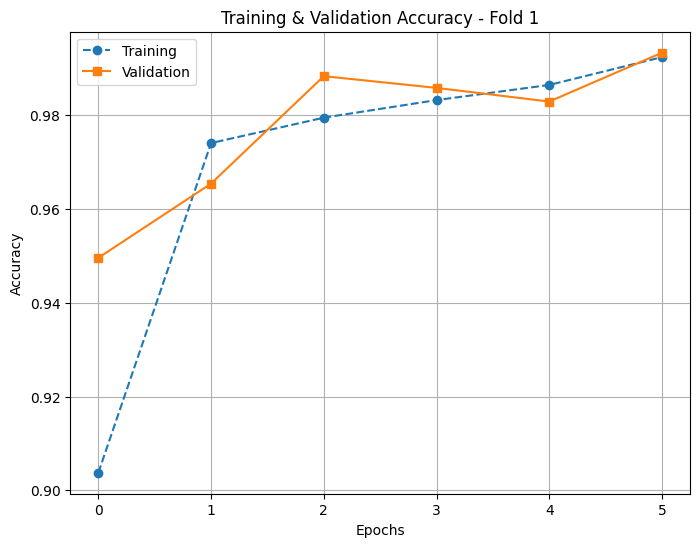

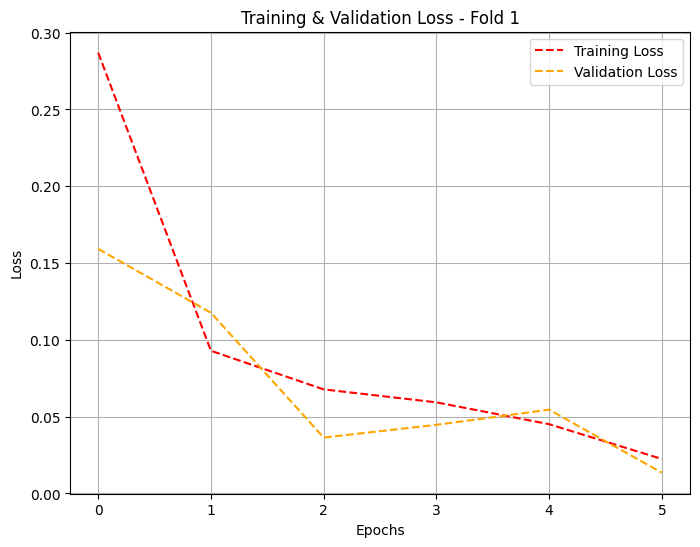

Classification Report - Fold 1:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      1.00      1.00       237
      Sardin       1.00      1.00      1.00       580
  Sardinella       0.99      1.00      0.99        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       1.00      1.00      1.00      1682
weighted avg       1.00      1.00      1.00      1682


Evaluating Fold 2:
211/211 ━━━━━━━━━━━━━━━━━━━━ 33s 86ms/step


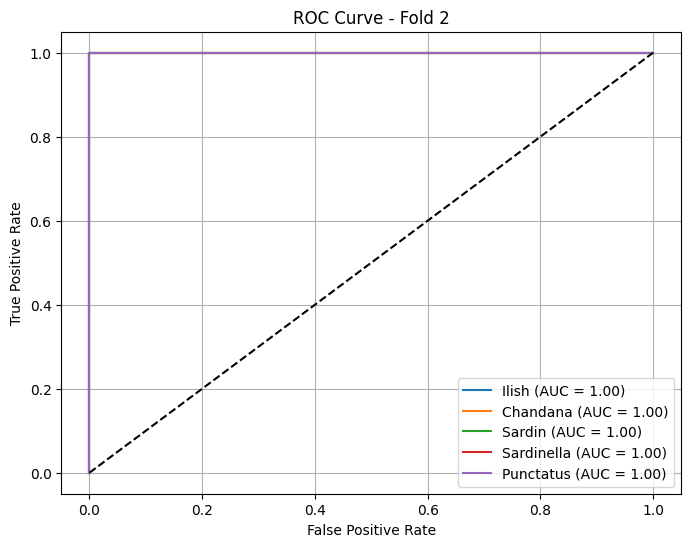

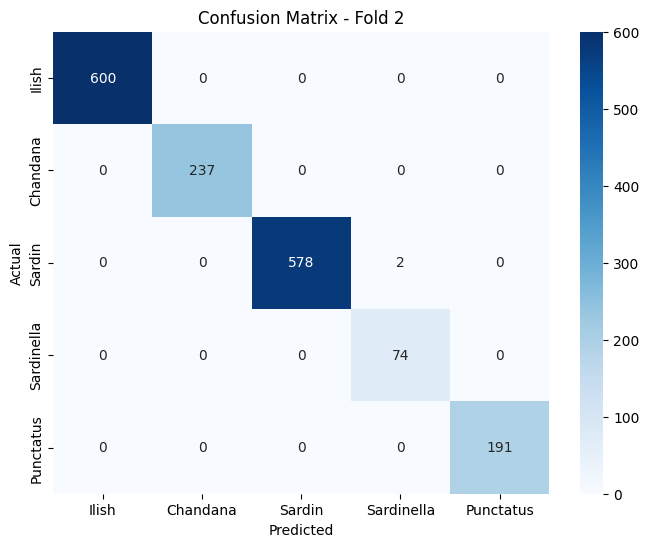

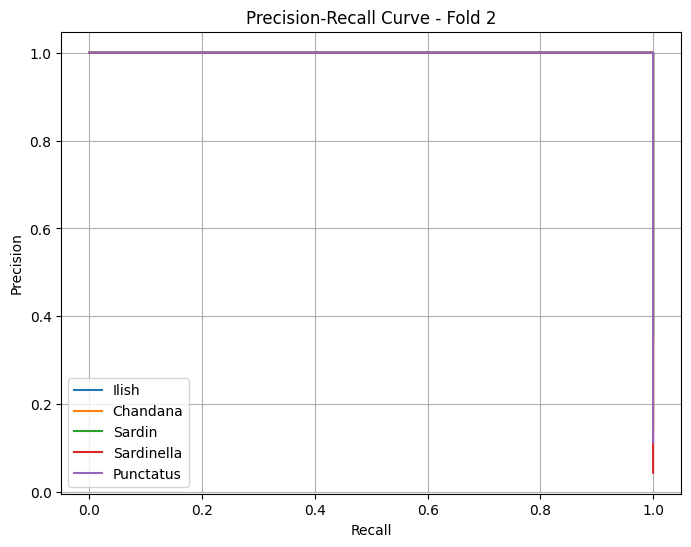

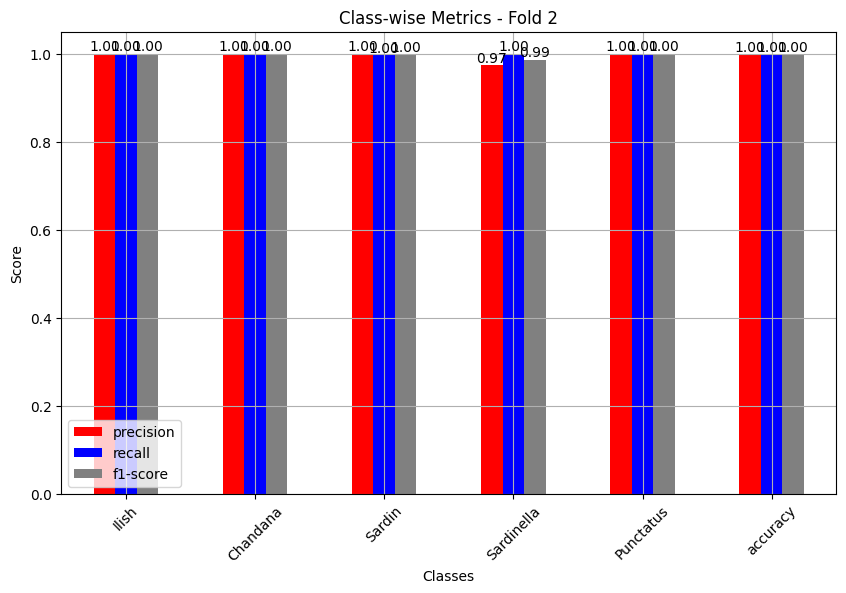

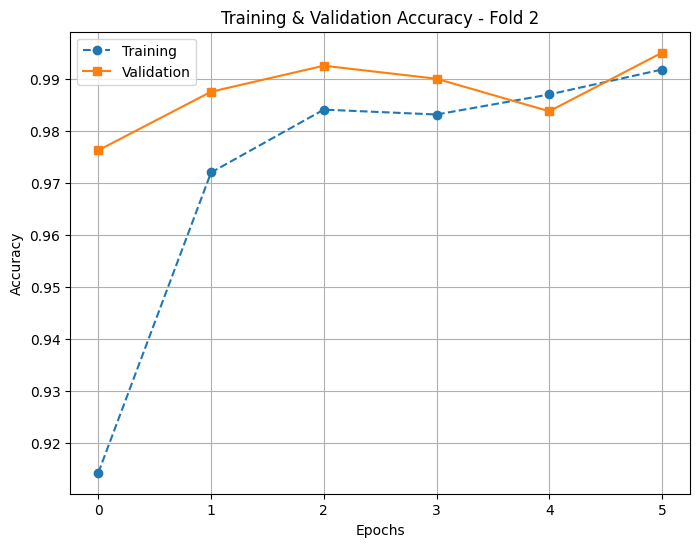

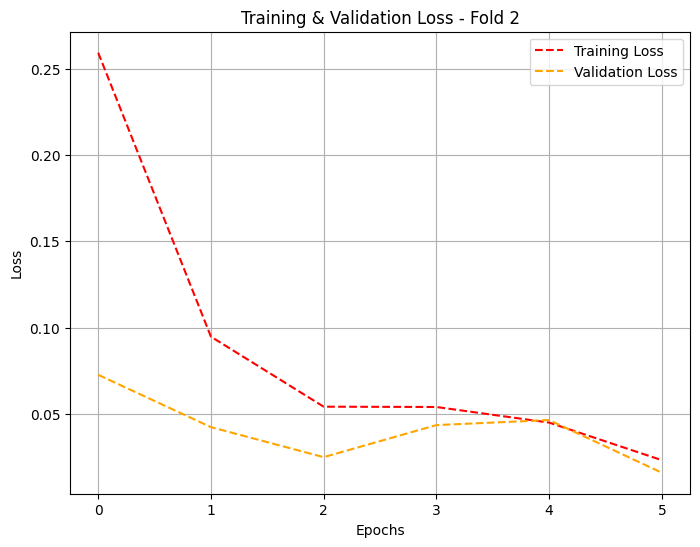

Classification Report - Fold 2:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      1.00      1.00       237
      Sardin       1.00      1.00      1.00       580
  Sardinella       0.97      1.00      0.99        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       0.99      1.00      1.00      1682
weighted avg       1.00      1.00      1.00      1682


Evaluating Fold 3:
211/211 ━━━━━━━━━━━━━━━━━━━━ 24s 65ms/step


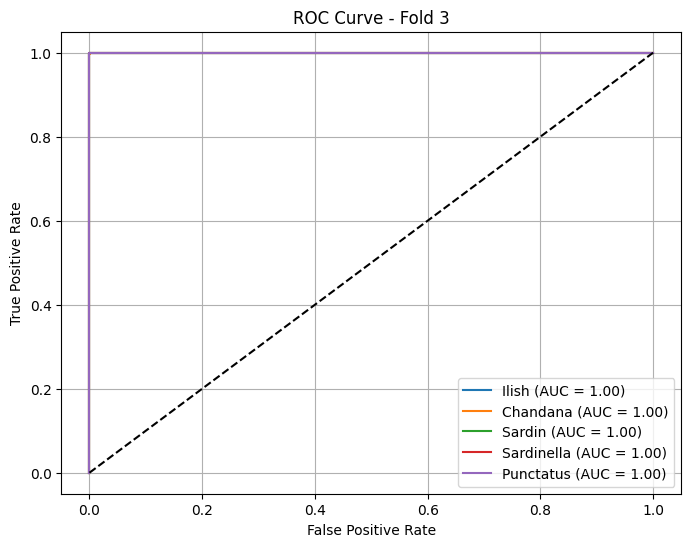

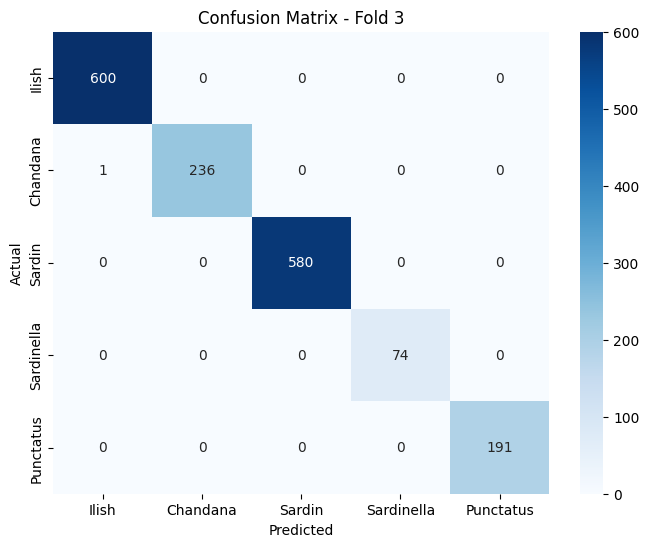

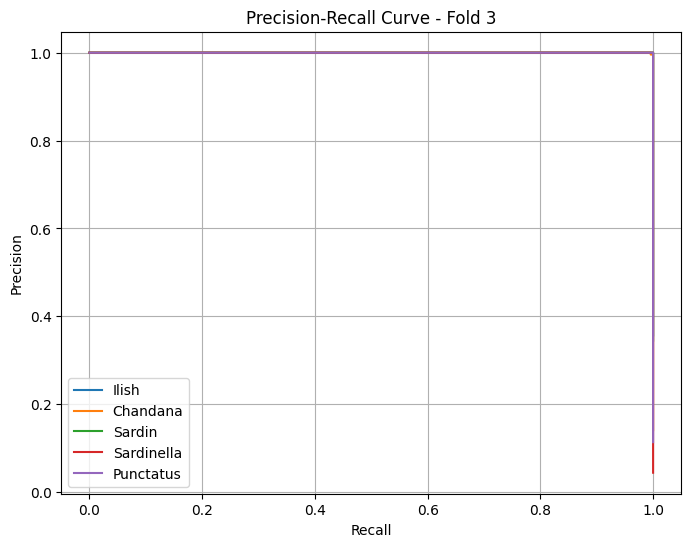

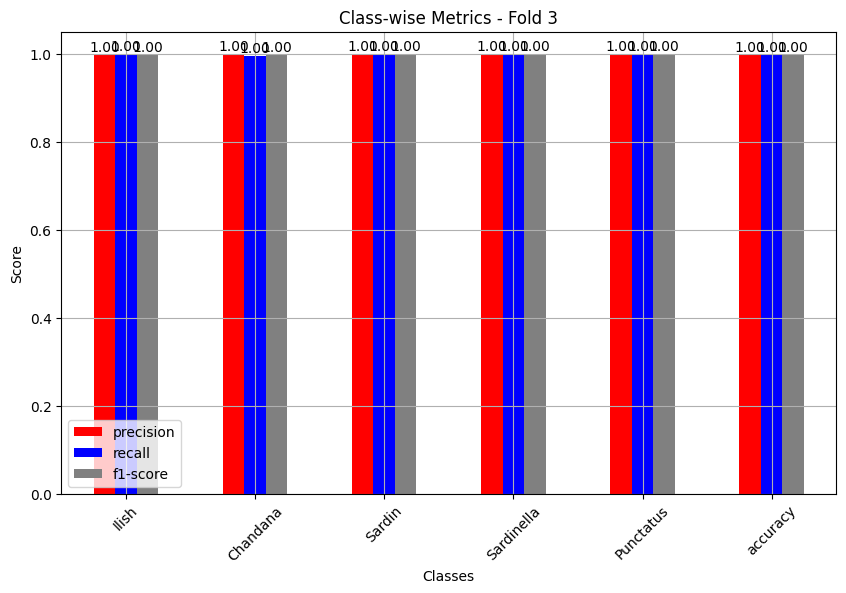

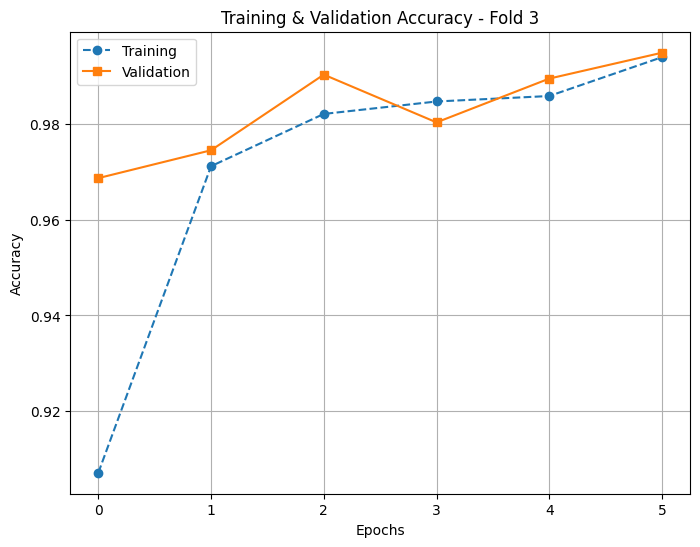

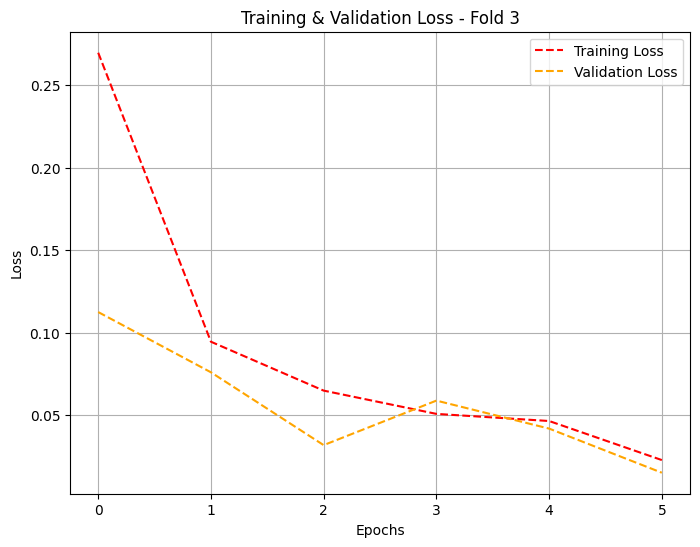

Classification Report - Fold 3:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      1.00      1.00       237
      Sardin       1.00      1.00      1.00       580
  Sardinella       1.00      1.00      1.00        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       1.00      1.00      1.00      1682
weighted avg       1.00      1.00      1.00      1682


Evaluating Fold 4:
211/211 ━━━━━━━━━━━━━━━━━━━━ 24s 64ms/step


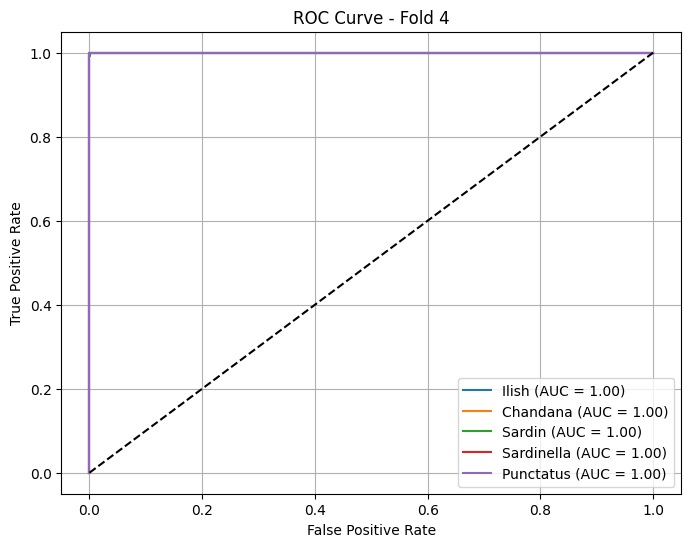

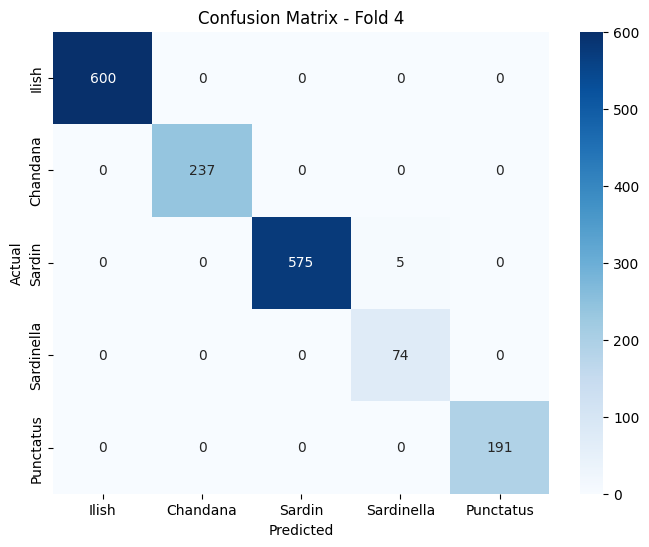

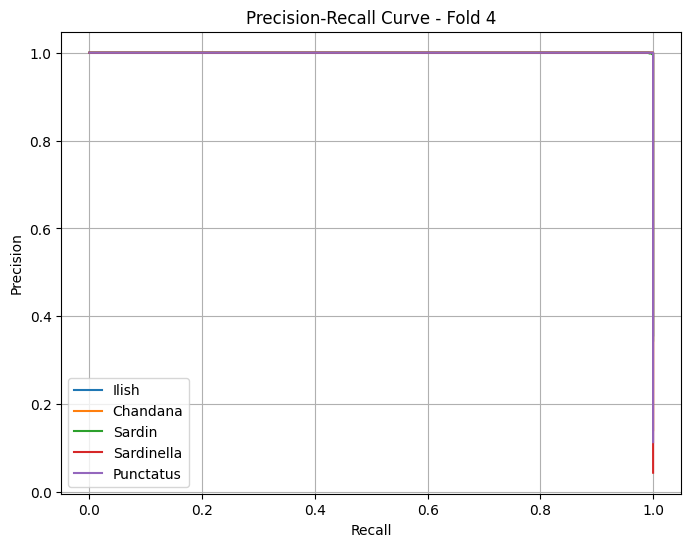

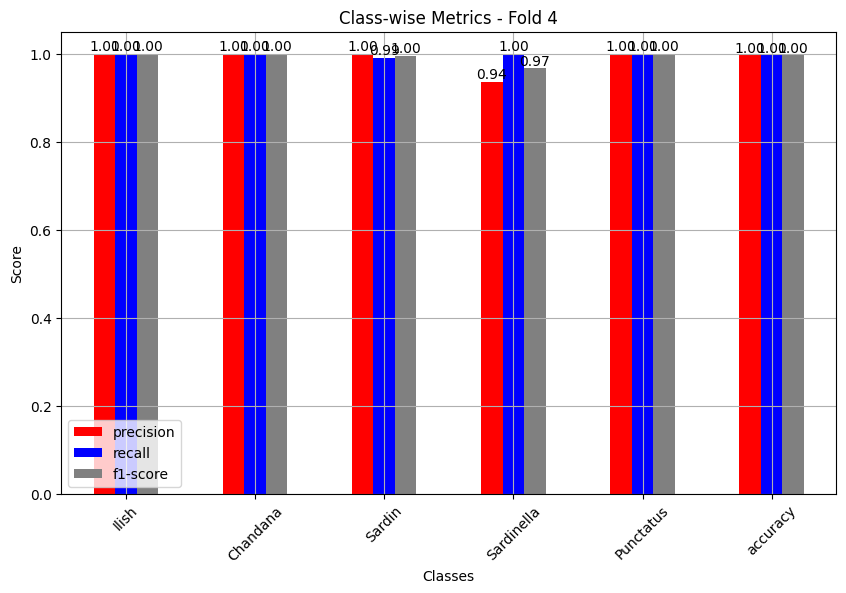

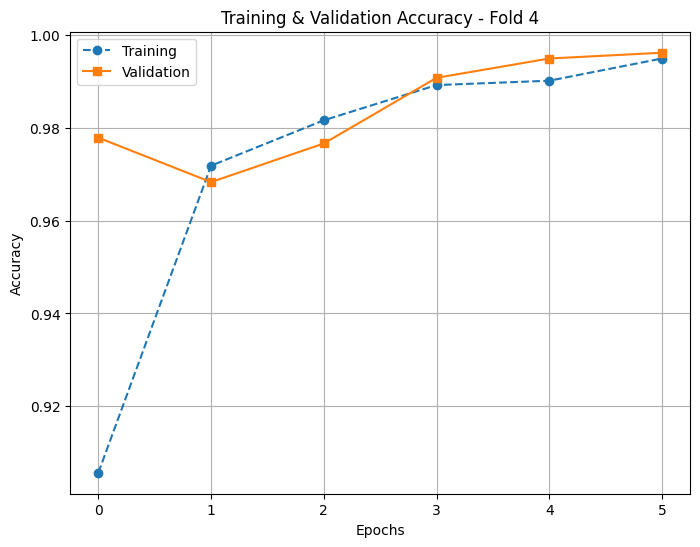

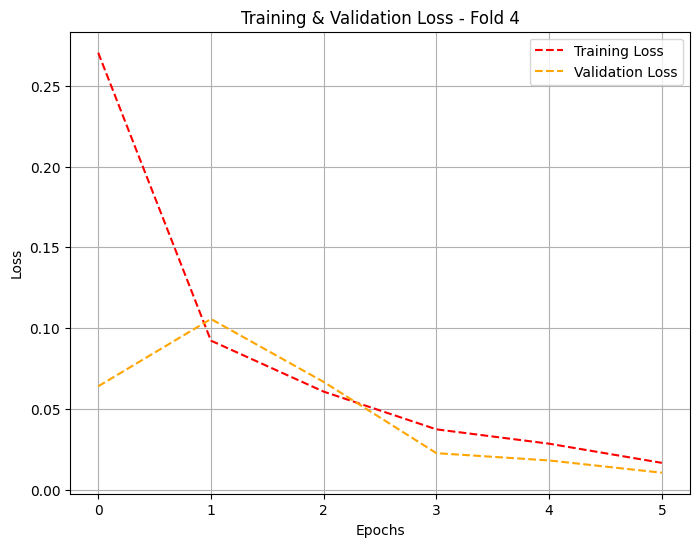

Classification Report - Fold 4:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      1.00      1.00       237
      Sardin       1.00      0.99      1.00       580
  Sardinella       0.94      1.00      0.97        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       0.99      1.00      0.99      1682
weighted avg       1.00      1.00      1.00      1682


Evaluating Fold 5:
211/211 ━━━━━━━━━━━━━━━━━━━━ 24s 65ms/step


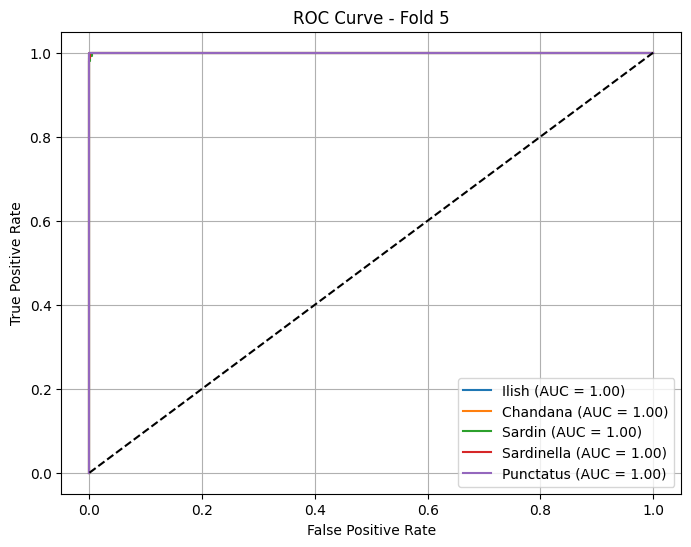

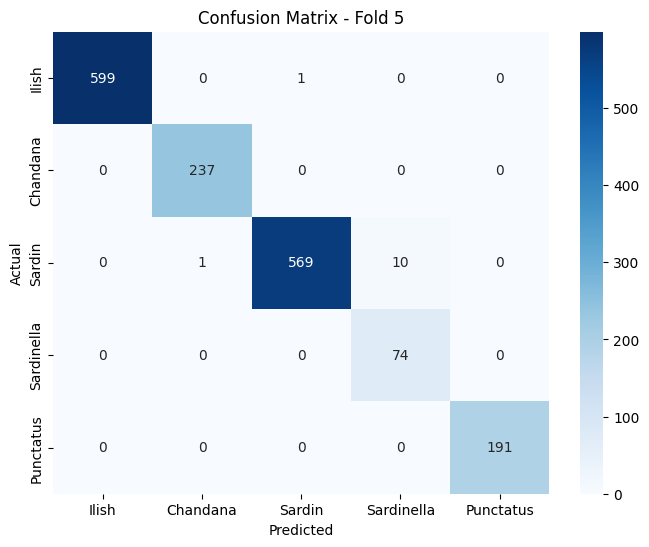

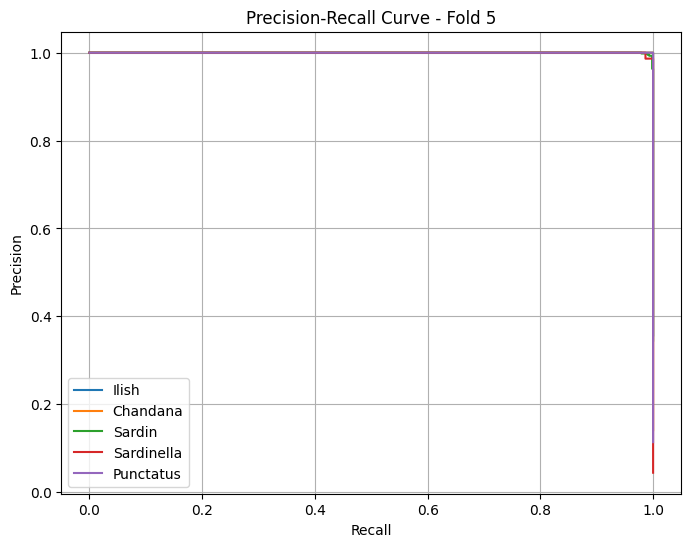

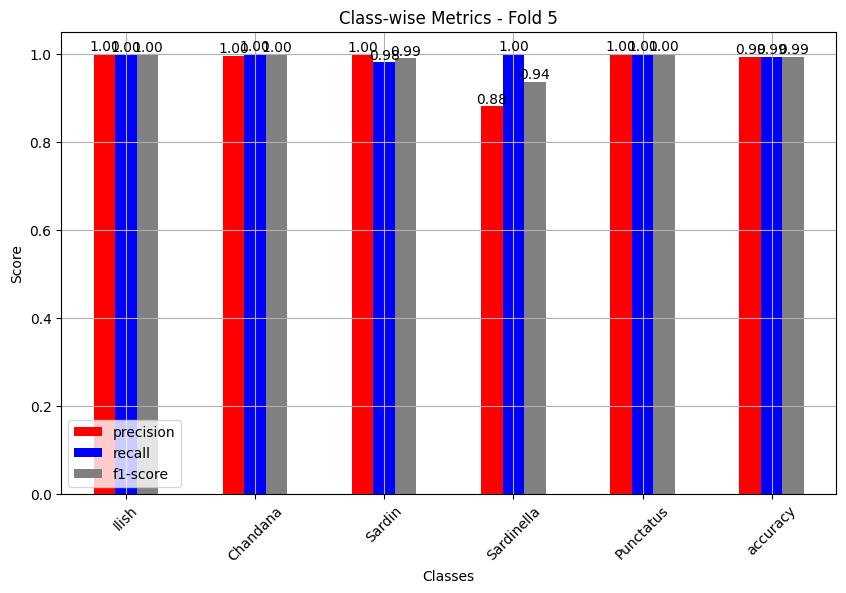

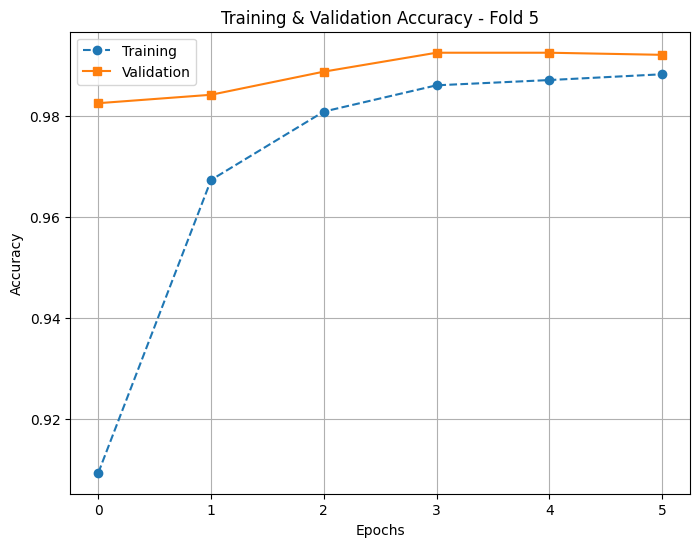

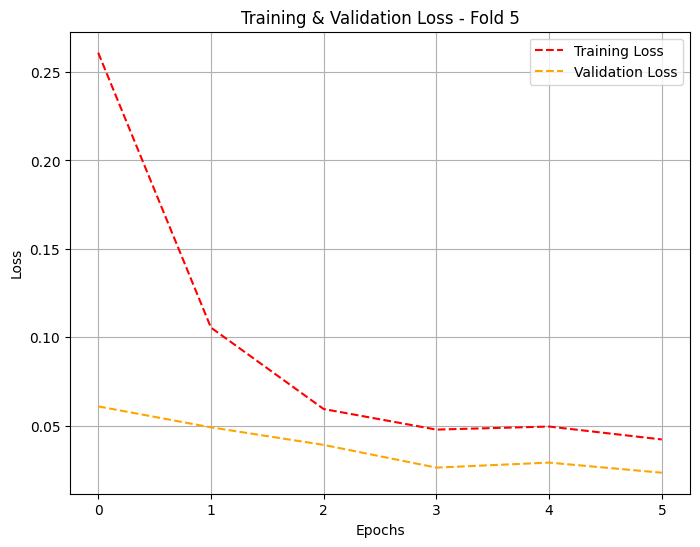

Classification Report - Fold 5:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      1.00      1.00       237
      Sardin       1.00      0.98      0.99       580
  Sardinella       0.88      1.00      0.94        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           0.99      1682
   macro avg       0.97      1.00      0.98      1682
weighted avg       0.99      0.99      0.99      1682


Combined Results for All Folds:


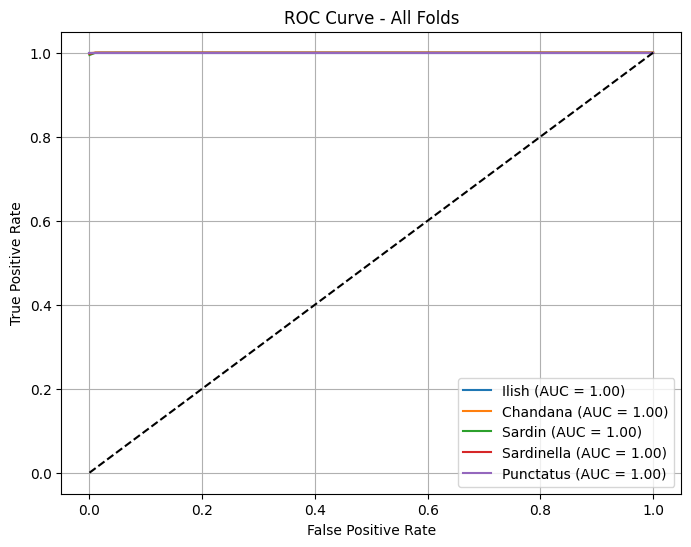

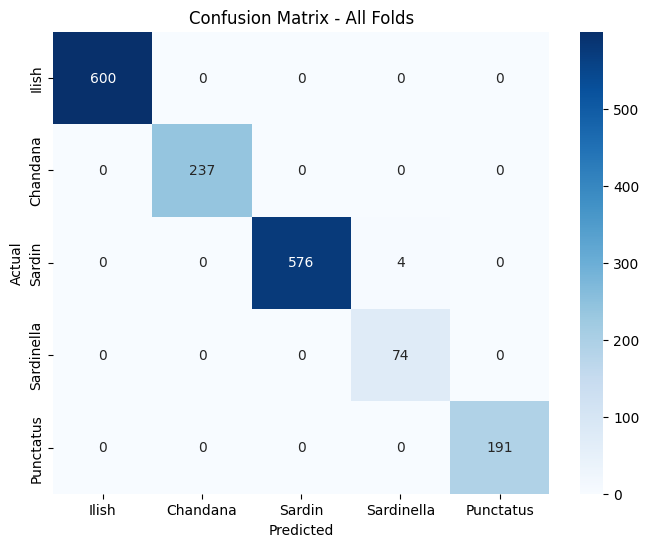

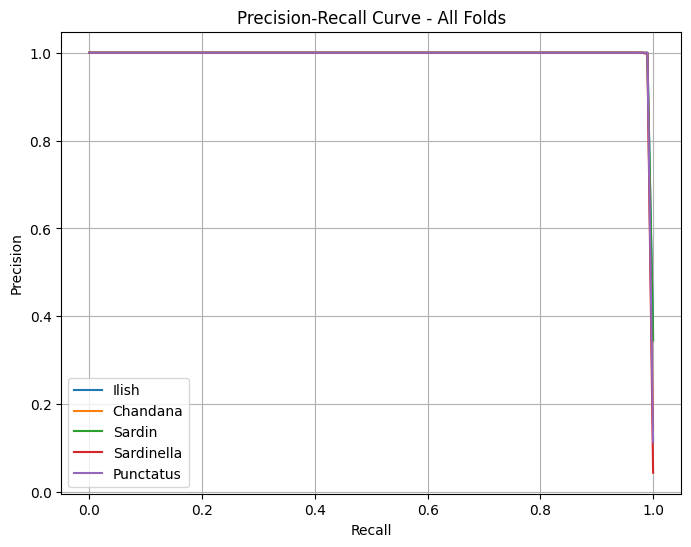

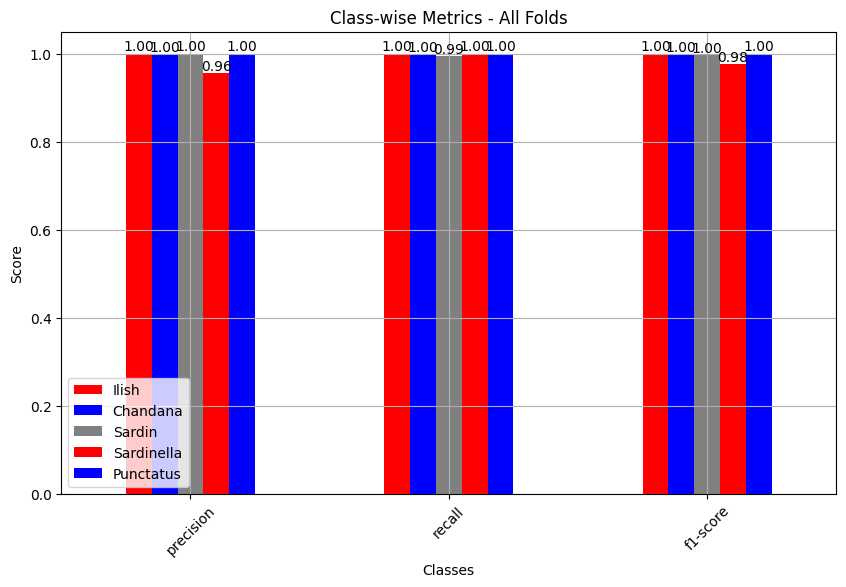

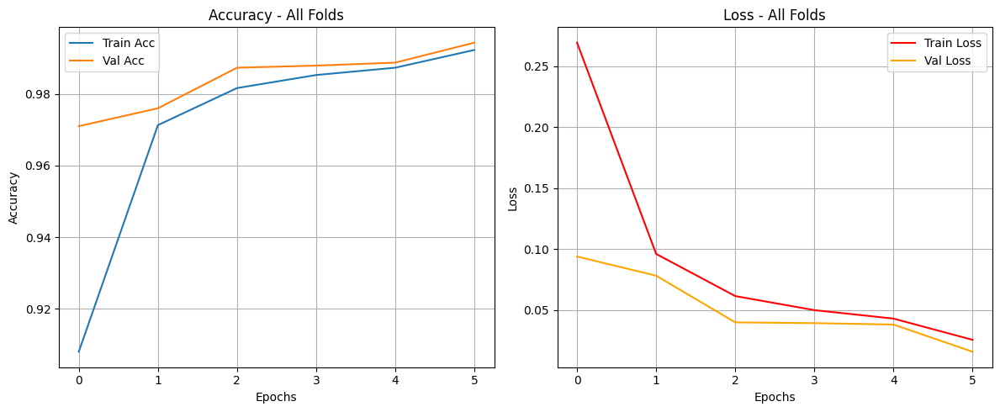


Final Combined Report (Learnable Weighted Ensemble):
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      1.00      1.00       237
      Sardin       1.00      1.00      1.00       580
  Sardinella       0.99      1.00      0.99        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       1.00      1.00      1.00      1682
weighted avg       1.00      1.00      1.00      1682

Final Accuracy: 0.9994, F1-Score: 0.9994


In [ ]:
# Install required packages
!pip install imbalanced-learn

import numpy as np
import tensorflow as tf
from tensorflow.keras.applications import ResNet50, EfficientNetB0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, Input, Lambda
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.metrics import roc_curve, auc, confusion_matrix, precision_recall_curve, classification_report, accuracy_score, f1_score
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import gc
from collections import Counter

# Enable mixed precision
tf.keras.mixed_precision.set_global_policy('mixed_float16')

# Configure GPU memory growth
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    for gpu in gpus:
        tf.config.experimental.set_memory_growth(gpu, True)
    print(f"{len(gpus)} GPUs detected.")
else:
    print("No GPU detected. Running on CPU.")

# Parameters
input_shape = (224, 224, 3)
num_classes = 5
batch_size = 8
epochs = 6
k_folds = 5
class_labels = ['Ilish', 'Chandana', 'Sardin', 'Sardinella', 'Punctatus']

# Assuming X and Y are loaded
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=42)

# Normalize in batches (commented out)
# def normalize_in_batches(data, batch_size=1000):
#     data = data.astype('float32')
#     for i in range(0, len(data), batch_size):
#         data[i:min(i + batch_size, len(data))] /= 255.0
#     return data

# X_train_scaled = normalize_in_batches(X_train)
# X_test_scaled = normalize_in_batches(X_test)
X_train_scaled = X_train  # Use raw data as-is
X_test_scaled = X_test    # Use raw data as-is

# Apply SMOTE
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_train_resampled, Y_train_resampled = smote.fit_resample(X_train_scaled.reshape(X_train_scaled.shape[0], -1), Y_train)
X_train_resampled = X_train_resampled.reshape(-1, 224, 224, 3)
print("Class distribution after SMOTE:", Counter(Y_train_resampled))

# Image Augmentation
datagen = ImageDataGenerator(rotation_range=20, width_shift_range=0.2, height_shift_range=0.2, shear_range=0.2,
                             zoom_range=0.2, horizontal_flip=True, fill_mode="nearest")

def batch_generator(X, Y, batch_size=32):
    size = X.shape[0]
    while True:
        indices = np.random.permutation(size)
        for start in range(0, size, batch_size):
            batch_idx = indices[start:min(start + batch_size, size)]
            X_batch, Y_batch = X[batch_idx], Y[batch_idx]
            augmented_images = next(datagen.flow(X_batch, shuffle=False, batch_size=batch_size))
            yield augmented_images, Y_batch  # Sparse labels for sparse_categorical_crossentropy

# Define Base Models
def create_base_model(input_shape=(224, 224, 3), model_type='ResNet'):
    base = ResNet50(weights='imagenet', include_top=False, input_shape=input_shape) if model_type == 'ResNet' else EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape)
    for layer in base.layers[:-5]:
        layer.trainable = False
    for layer in base.layers[-5:]:
        layer.trainable = True
    return base

# Define Ensemble Model with Fixed Shape and Type Correction
def create_ensemble_model(input_shape=(224, 224, 3), num_classes=5):
    # Create base models
    model1 = create_base_model(input_shape, model_type='ResNet')
    model2 = create_base_model(input_shape, model_type='EfficientNet')

    # Rename layers to avoid name clashes
    for layer in model1.layers:
        layer._name = f"resnet_{layer.name}"
    for layer in model2.layers:
        layer._name = f"efficientnet_{layer.name}"

    input_layer = Input(shape=input_shape)
    output1 = model1(input_layer)
    output2 = model2(input_layer)

    output1 = GlobalAveragePooling2D()(output1)  # Shape: (None, 2048) for ResNet50
    output2 = GlobalAveragePooling2D()(output2)  # Shape: (None, 1280) for EfficientNetB0

    # Project both outputs to a common dimension (e.g., 1280)
    output1 = Dense(1280, activation='relu')(output1)  # Outputs float32 by default
    output2 = Dense(1280, activation='relu')(output2)  # Outputs float32 by default

    # # Cast outputs to float16 to match alpha and mixed precision policy
    # output1 = tf.cast(output1, tf.float16)
    # output2 = tf.cast(output2, tf.float16)

    # Cast outputs to float16 using Lambda layer to match alpha and mixed precision policy
    output1 = Lambda(lambda x: tf.cast(x, tf.float16))(output1)
    output2 = Lambda(lambda x: tf.cast(x, tf.float16))(output2)

    # alpha = tf.Variable(0.5, trainable=True, dtype=tf.float16, name="alpha")
    # ensemble_output = Lambda(lambda x: alpha * x[0] + (1 - alpha) * x[1],
    #                          output_shape=(1280,))([output1, output2])

    alpha = tf.Variable(0.5, trainable=True, dtype=tf.float16, name="alpha")
    ensemble_output = Lambda(lambda x: alpha * tf.cast(x[0], tf.float16) + (1 - alpha) * tf.cast(x[1], tf.float16),
                         output_shape=(1280,))([output1, output2])

    x = Dense(128, activation='relu')(ensemble_output)
    x = Dropout(0.5)(x)
    final_output = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=input_layer, outputs=final_output)
    model.compile(optimizer=Adam(learning_rate=0.001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

# K-Fold Training
def train_with_kfold(X_train, Y_train, X_test, Y_test, k=5, batch_size=32, epochs=6):
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
    histories = []
    trained_models = []

    with tf.device('/GPU:0'):
        for fold_no, (train_idx, val_idx) in enumerate(skf.split(X_train, Y_train), 1):
            print(f"Training Fold {fold_no}/{k}")
            X_train_fold, X_val_fold = X_train[train_idx], X_train[val_idx]
            Y_train_fold, Y_val_fold = Y_train[train_idx], Y_train[val_idx]

            ensemble_model = create_ensemble_model(input_shape, num_classes)

            train_gen = batch_generator(X_train_fold, Y_train_fold, batch_size)
            val_gen = batch_generator(X_val_fold, Y_val_fold, batch_size)

            callbacks = [
                ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2),
                ModelCheckpoint(f'best_ensemble_model_{fold_no}.weights.h5', save_best_only=True,
                                monitor='val_accuracy', mode='max', save_weights_only=True),
                EarlyStopping(monitor='val_accuracy', patience=3, restore_best_weights=True)
            ]

            history = ensemble_model.fit(train_gen, validation_data=val_gen, epochs=epochs,
                                         steps_per_epoch=len(X_train_fold)//batch_size,
                                         validation_steps=len(X_val_fold)//batch_size, callbacks=callbacks, verbose=1)

            histories.append(history)
            trained_models.append(ensemble_model)

            tf.keras.backend.clear_session()
            gc.collect()

    return histories, trained_models

# Evaluation and Plotting
def evaluate_and_plot(histories, X_test, Y_test, trained_models):
    ensemble_probs_list, ensemble_preds_list = [], []

    with tf.device('/GPU:0'):
        # Fold-wise Visualization
        print("\nFold-by-Fold Visualizations:")
        for fold_no, (model, history) in enumerate(zip(trained_models, histories), 1):
            print(f"\nEvaluating Fold {fold_no}:")
            probs = model.predict(X_test, batch_size=8)
            preds = np.argmax(probs, axis=1)
            ensemble_probs_list.append(probs)
            ensemble_preds_list.append(preds)

            # Fold-wise Plots
            def plot_roc_fold(Y_test, probs, fold_no):
                plt.figure(figsize=(8, 6))
                for i, cls in enumerate(class_labels):
                    fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                    roc_auc = auc(fpr, tpr)
                    plt.plot(fpr, tpr, label=f'{cls} (AUC = {roc_auc:.2f})')
                plt.plot([0, 1], [0, 1], 'k--')
                plt.title(f'ROC Curve - Fold {fold_no}')
                plt.xlabel('False Positive Rate')
                plt.ylabel('True Positive Rate')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_confusion_fold(Y_test, preds, fold_no):
                cm = confusion_matrix(Y_test, preds)
                plt.figure(figsize=(8, 6))
                sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
                plt.title(f'Confusion Matrix - Fold {fold_no}')
                plt.xlabel('Predicted')
                plt.ylabel('Actual')
                plt.show()

            def plot_pr_fold(Y_test, probs, fold_no):
                plt.figure(figsize=(8, 6))
                for i, cls in enumerate(class_labels):
                    precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                    plt.plot(recall, precision, label=cls)
                plt.title(f'Precision-Recall Curve - Fold {fold_no}')
                plt.xlabel('Recall')
                plt.ylabel('Precision')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_metrics_fold(Y_test, preds, fold_no):
                report = classification_report(Y_test, preds, target_names=class_labels, output_dict=True)
                df = pd.DataFrame(report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]
                df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
                for p in plt.gca().patches:
                    plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
                plt.title(f'Class-wise Metrics - Fold {fold_no}')
                plt.xlabel('Classes')
                plt.ylabel('Score')
                plt.xticks(rotation=45)
                plt.legend()
                plt.grid()
                plt.show()

            def plot_acc_fold(history, fold_no):
                plt.figure(figsize=(8, 6))
                plt.plot(history.history['accuracy'], label='Training', linestyle='dashed', marker='o')
                plt.plot(history.history['val_accuracy'], label='Validation', marker='s')
                plt.title(f'Training & Validation Accuracy - Fold {fold_no}')
                plt.xlabel('Epochs')
                plt.ylabel('Accuracy')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_loss_fold(history, fold_no):
                plt.figure(figsize=(8, 6))
                plt.plot(history.history['loss'], label='Training Loss', linestyle='dashed', color='red')
                plt.plot(history.history['val_loss'], label='Validation Loss', linestyle='dashed', color='orange')
                plt.title(f'Training & Validation Loss - Fold {fold_no}')
                plt.xlabel('Epochs')
                plt.ylabel('Loss')
                plt.legend()
                plt.grid()
                plt.show()

            def print_report_fold(Y_test, preds, fold_no):
                report = classification_report(Y_test, preds, target_names=class_labels)
                print(f"Classification Report - Fold {fold_no}:\n{report}")

            # Execute Fold-wise Plots
            plot_roc_fold(Y_test, probs, fold_no)
            plot_confusion_fold(Y_test, preds, fold_no)
            plot_pr_fold(Y_test, probs, fold_no)
            plot_metrics_fold(Y_test, preds, fold_no)
            plot_acc_fold(history, fold_no)
            plot_loss_fold(history, fold_no)
            print_report_fold(Y_test, preds, fold_no)

            tf.keras.backend.clear_session()
            gc.collect()

        # Combined Visualizations
        print("\nCombined Results for All Folds:")
        def plot_roc_combined(Y_test, probs_list):
            plt.figure(figsize=(8, 6))
            mean_fpr = np.linspace(0, 1, 100)
            for i, cls in enumerate(class_labels):
                tprs, aucs = [], []
                for probs in probs_list:
                    fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                    tprs.append(np.interp(mean_fpr, fpr, tpr))
                    aucs.append(auc(fpr, tpr))
                mean_tpr = np.mean(tprs, axis=0)
                mean_auc = auc(mean_fpr, mean_tpr)
                plt.plot(mean_fpr, mean_tpr, label=f'{cls} (AUC = {mean_auc:.2f})')
            plt.plot([0, 1], [0, 1], 'k--')
            plt.title('ROC Curve - All Folds')
            plt.xlabel('False Positive Rate')
            plt.ylabel('True Positive Rate')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_confusion_combined(Y_test, preds_list):
            mean_cm = np.mean([confusion_matrix(Y_test, preds) for preds in preds_list], axis=0)
            plt.figure(figsize=(8, 6))
            sns.heatmap(mean_cm, annot=True, fmt='.0f', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
            plt.title('Confusion Matrix - All Folds')
            plt.xlabel('Predicted')
            plt.ylabel('Actual')
            plt.show()

        def plot_pr_combined(Y_test, probs_list):
            plt.figure(figsize=(8, 6))
            mean_recall = np.linspace(0, 1, 100)
            for i, cls in enumerate(class_labels):
                precisions = []
                for probs in probs_list:
                    precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                    precisions.append(np.interp(mean_recall[::-1], recall[::-1], precision[::-1])[::-1])
                mean_precision = np.mean(precisions, axis=0)
                plt.plot(mean_recall, mean_precision, label=cls)
            plt.title('Precision-Recall Curve - All Folds')
            plt.xlabel('Recall')
            plt.ylabel('Precision')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_metrics_combined(Y_test, preds_list):
            reports = [classification_report(Y_test, preds, target_names=class_labels, output_dict=True) for preds in preds_list]
            mean_report = {metric: {cls: np.mean([r[cls][metric] for r in reports]) for cls in class_labels}
                           for metric in ['precision', 'recall', 'f1-score']}
            df = pd.DataFrame(mean_report).T
            df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
            for p in plt.gca().patches:
                plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
            plt.title('Class-wise Metrics - All Folds')
            plt.xlabel('Classes')
            plt.ylabel('Score')
            plt.xticks(rotation=45)
            plt.legend()
            plt.grid()
            plt.show()

        def plot_acc_loss_combined(histories):
            plt.figure(figsize=(12, 5))
            mean_acc = np.mean([h.history['accuracy'] for h in histories], axis=0)
            mean_val_acc = np.mean([h.history['val_accuracy'] for h in histories], axis=0)
            mean_loss = np.mean([h.history['loss'] for h in histories], axis=0)
            mean_val_loss = np.mean([h.history['val_loss'] for h in histories], axis=0)
            plt.subplot(1, 2, 1)
            plt.plot(mean_acc, label='Train Acc')
            plt.plot(mean_val_acc, label='Val Acc')
            plt.title('Accuracy - All Folds')
            plt.xlabel('Epochs')
            plt.ylabel('Accuracy')
            plt.legend()
            plt.grid()
            plt.subplot(1, 2, 2)
            plt.plot(mean_loss, label='Train Loss', color='red')
            plt.plot(mean_val_loss, label='Val Loss', color='orange')
            plt.title('Loss - All Folds')
            plt.xlabel('Epochs')
            plt.ylabel('Loss')
            plt.legend()
            plt.grid()
            plt.tight_layout()
            plt.show()

        def print_final_report(Y_test, probs_list):
            mean_probs = np.mean(probs_list, axis=0)
            final_preds = np.argmax(mean_probs, axis=1)
            report = classification_report(Y_test, final_preds, target_names=class_labels)
            acc = accuracy_score(Y_test, final_preds)
            f1 = f1_score(Y_test, final_preds, average='weighted')
            print(f"\nFinal Combined Report (Learnable Weighted Ensemble):\n{report}")
            print(f"Final Accuracy: {acc:.4f}, F1-Score: {f1:.4f}")

        # Execute Combined Plots
        plot_roc_combined(Y_test, ensemble_probs_list)
        plot_confusion_combined(Y_test, ensemble_preds_list)
        plot_pr_combined(Y_test, ensemble_probs_list)
        plot_metrics_combined(Y_test, ensemble_preds_list)
        plot_acc_loss_combined(histories)
        print_final_report(Y_test, ensemble_probs_list)

# Train and Evaluate
histories, trained_models = train_with_kfold(X_train_resampled, Y_train_resampled, X_test_scaled, Y_test)
print("Training Complete with Learnable Weighted Ensemble.")
evaluate_and_plot(histories, X_test_scaled, Y_test, trained_models)

1 GPUs detected.
Class distribution after SMOTE: Counter({np.int32(1): 2400, np.int32(0): 2400, np.int32(3): 2400, np.int32(2): 2400, np.int32(4): 2400})
Training Fold 1/5
Epoch 1/4
300/300 ━━━━━━━━━━━━━━━━━━━━ 168s 439ms/step - accuracy: 0.8032 - loss: 0.5507 - val_accuracy: 0.9575 - val_loss: 0.1253 - learning_rate: 0.0010
Epoch 2/4
300/300 ━━━━━━━━━━━━━━━━━━━━ 119s 397ms/step - accuracy: 0.9560 - loss: 0.1372 - val_accuracy: 0.9825 - val_loss: 0.0622 - learning_rate: 0.0010
Epoch 3/4
300/300 ━━━━━━━━━━━━━━━━━━━━ 116s 389ms/step - accuracy: 0.9809 - loss: 0.0603 - val_accuracy: 0.9746 - val_loss: 0.0733 - learning_rate: 0.0010
Epoch 4/4
300/300 ━━━━━━━━━━━━━━━━━━━━ 116s 387ms/step - accuracy: 0.9829 - loss: 0.0577 - val_accuracy: 0.9900 - val_loss: 0.0312 - learning_rate: 0.0010
Training Fold 2/5
Epoch 1/4
300/300 ━━━━━━━━━━━━━━━━━━━━ 163s 434ms/step - accuracy: 0.8267 - loss: 0.4667 - val_accuracy: 0.9737 - val_loss: 0.0858 - learning_rate: 0.0010
Epoch 2/4
300/300 ━━━━━━━━━━━━━━━━━

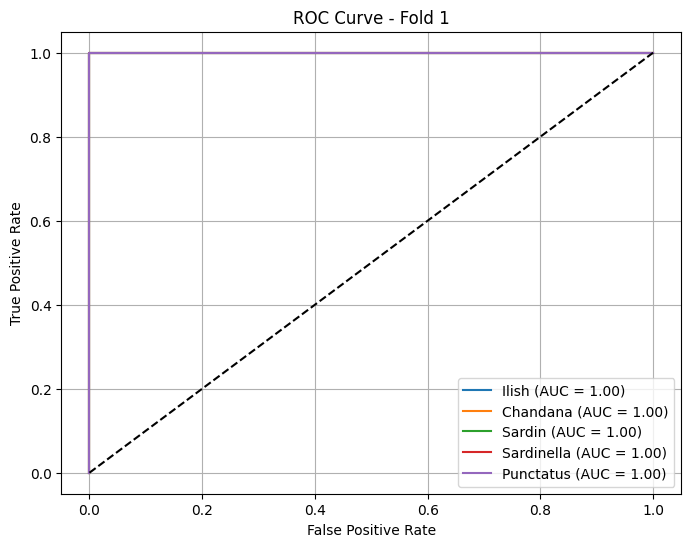

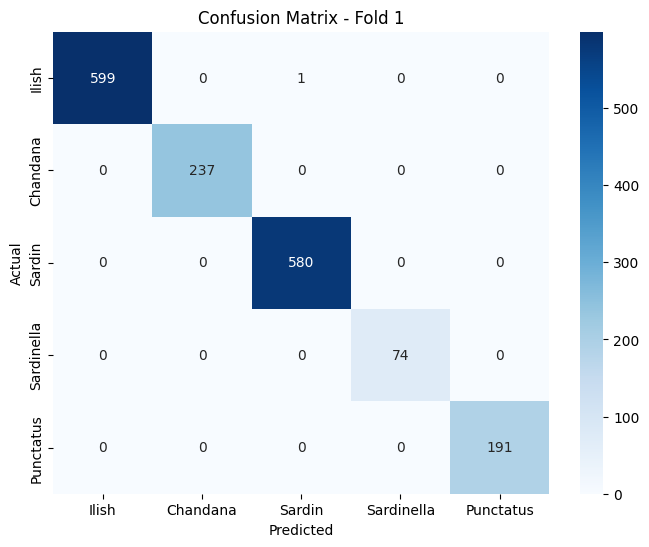

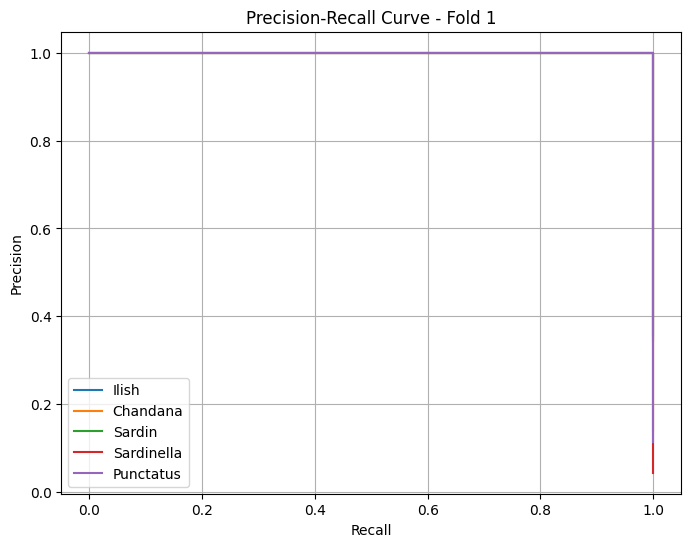

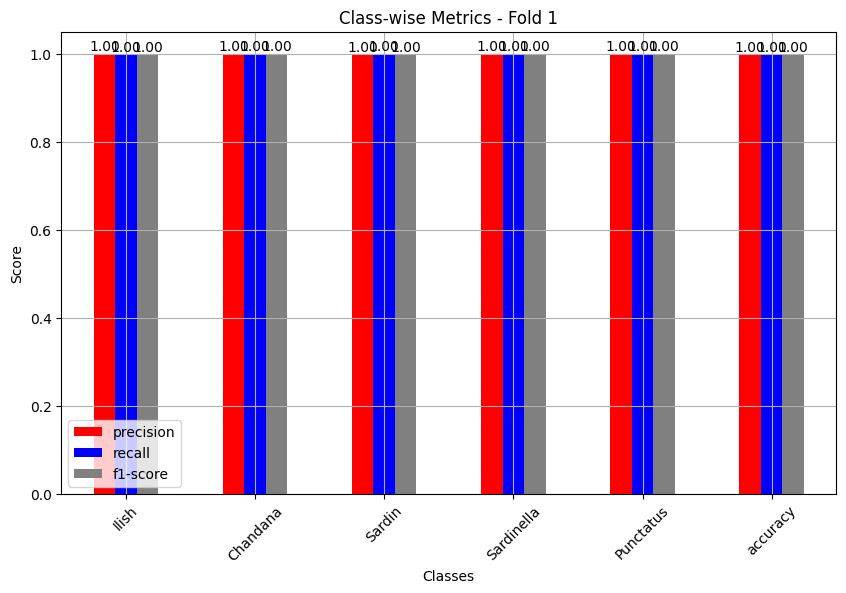

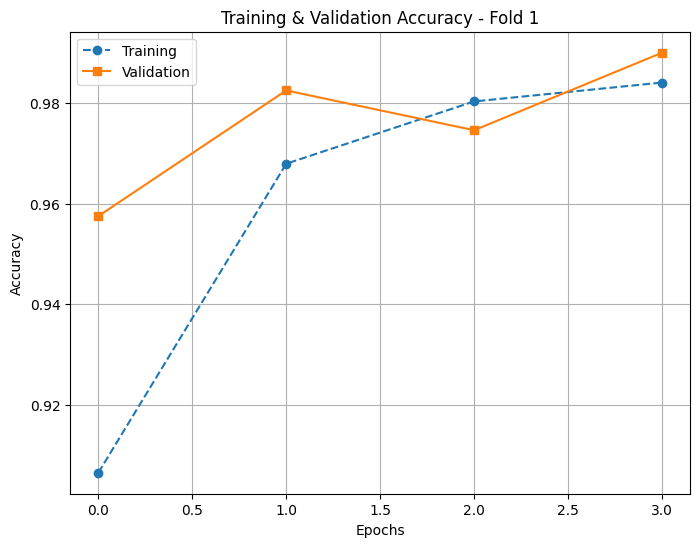

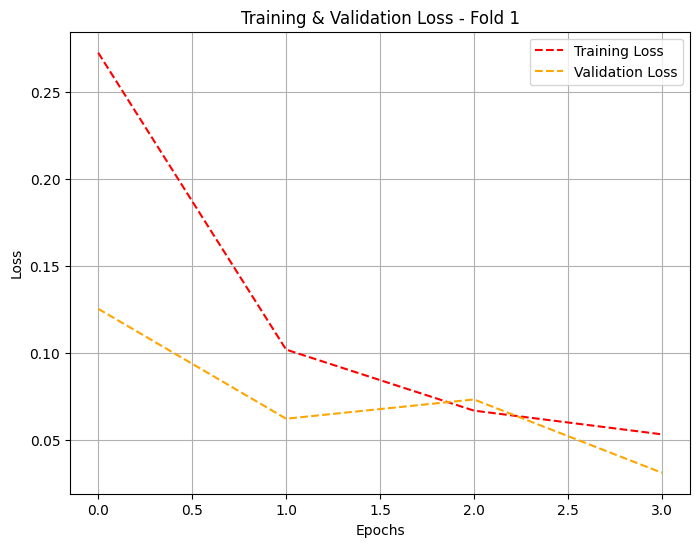

Classification Report - Fold 1:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      1.00      1.00       237
      Sardin       1.00      1.00      1.00       580
  Sardinella       1.00      1.00      1.00        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       1.00      1.00      1.00      1682
weighted avg       1.00      1.00      1.00      1682


Evaluating Fold 2:
211/211 ━━━━━━━━━━━━━━━━━━━━ 24s 63ms/step


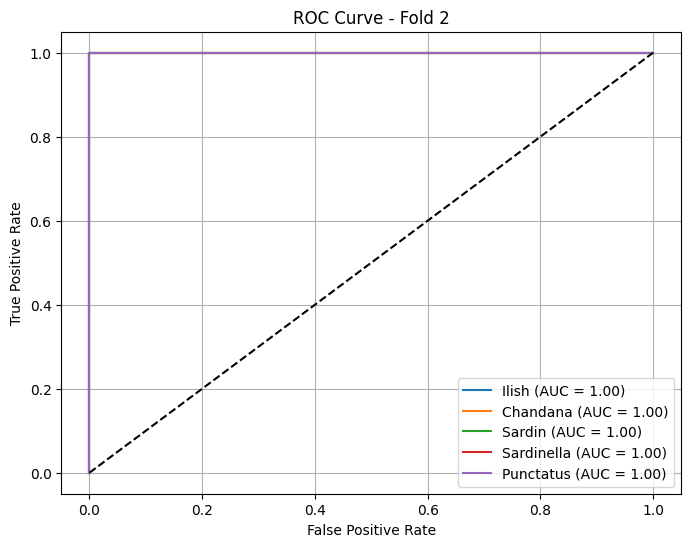

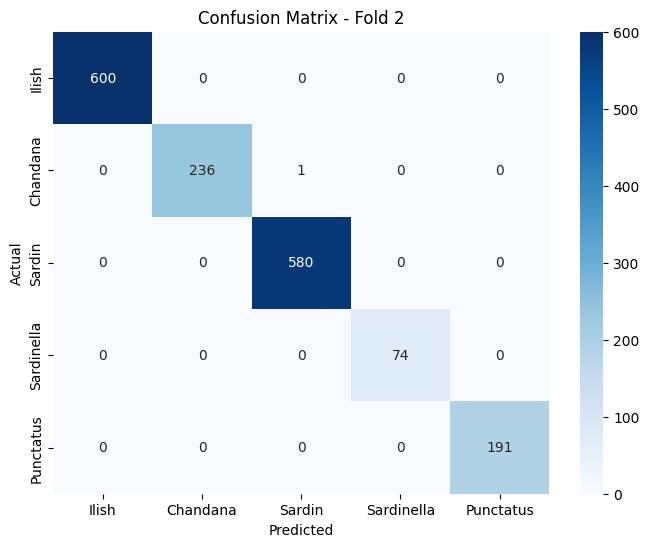

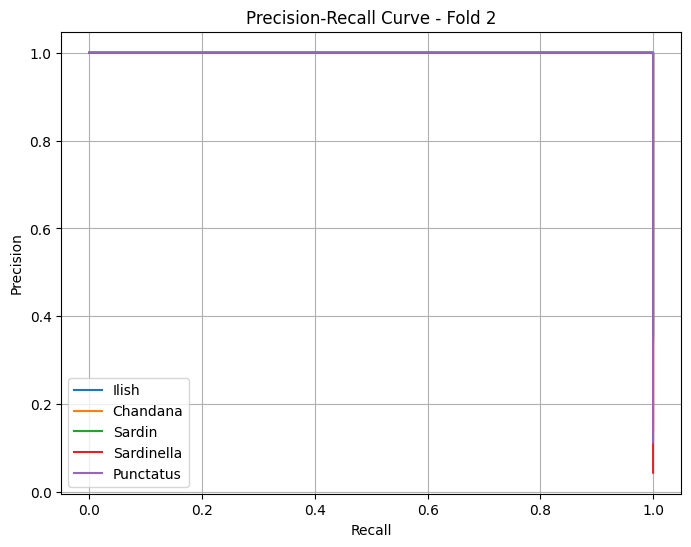

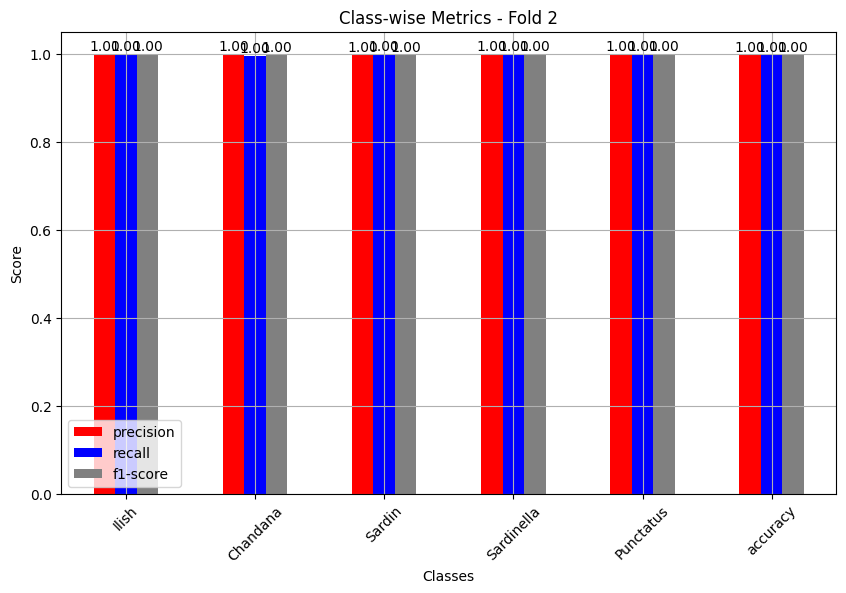

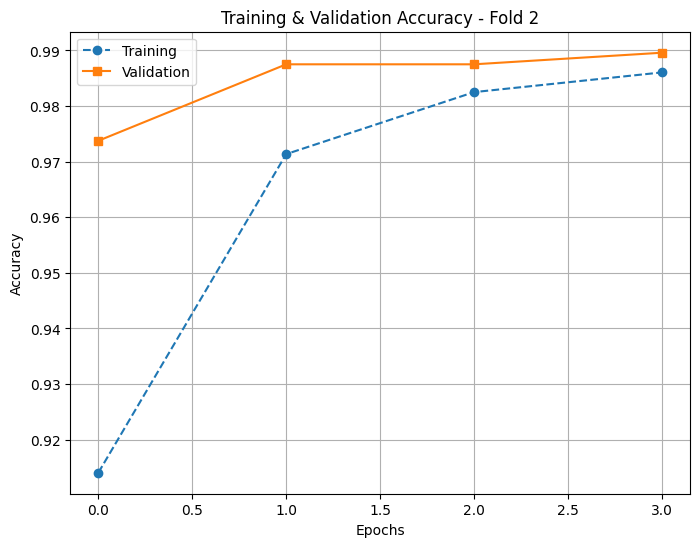

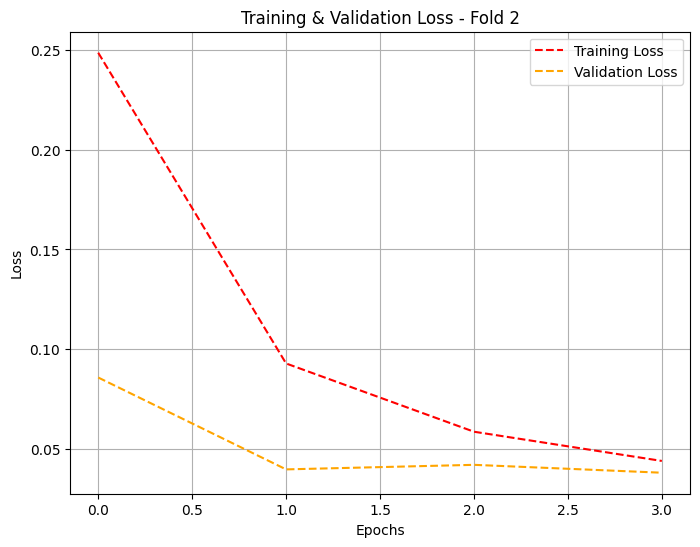

Classification Report - Fold 2:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      1.00      1.00       237
      Sardin       1.00      1.00      1.00       580
  Sardinella       1.00      1.00      1.00        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       1.00      1.00      1.00      1682
weighted avg       1.00      1.00      1.00      1682


Evaluating Fold 3:
211/211 ━━━━━━━━━━━━━━━━━━━━ 24s 68ms/step


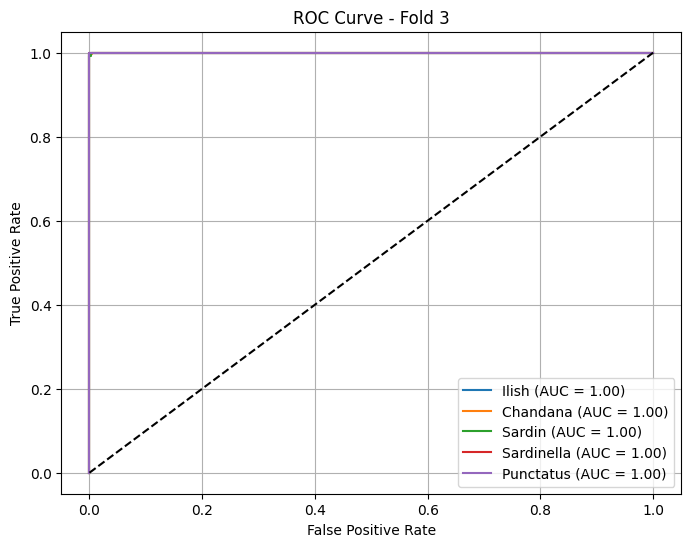

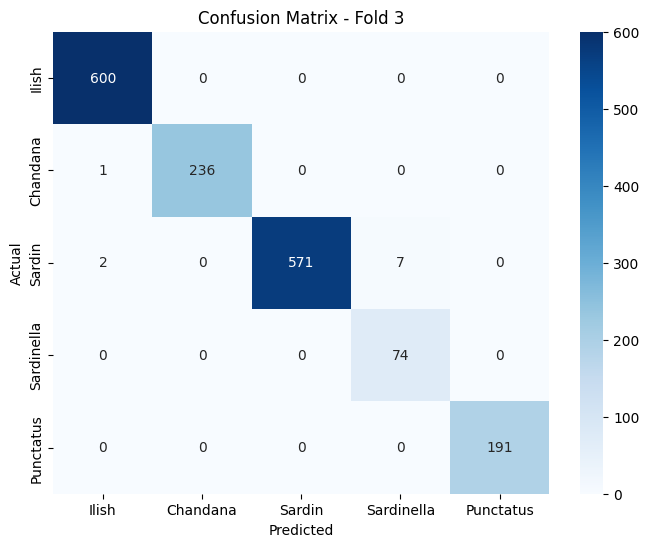

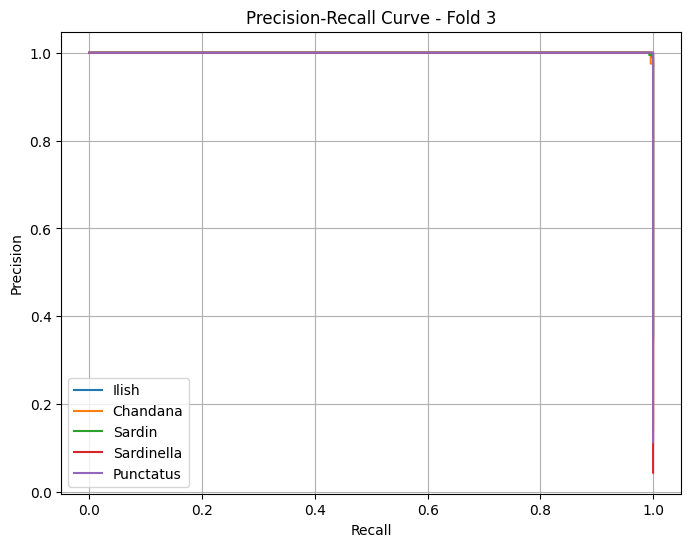

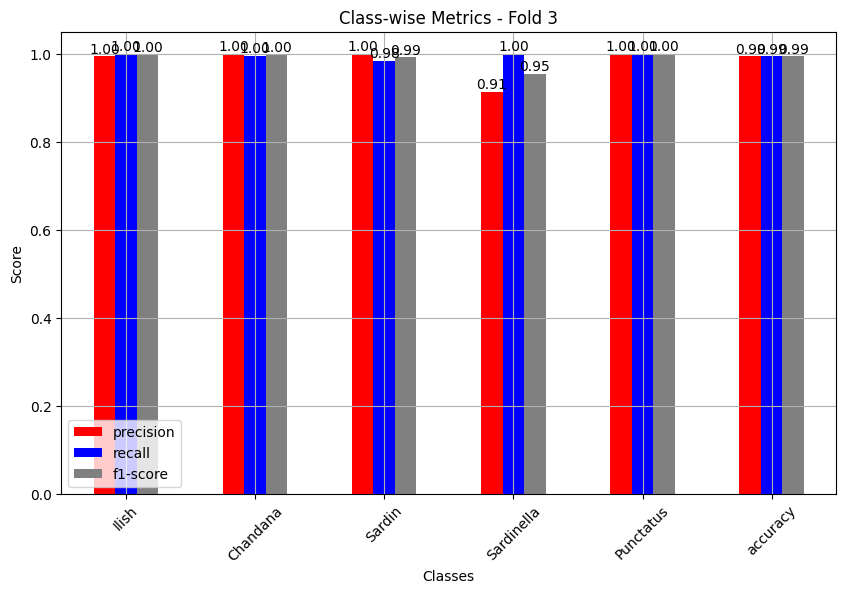

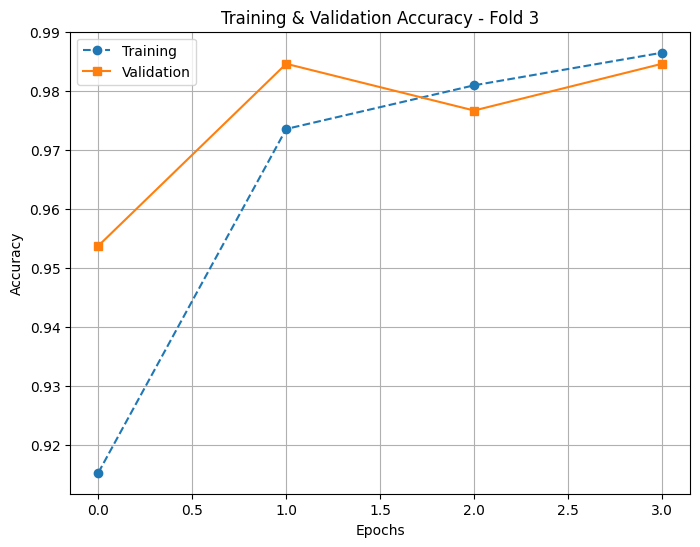

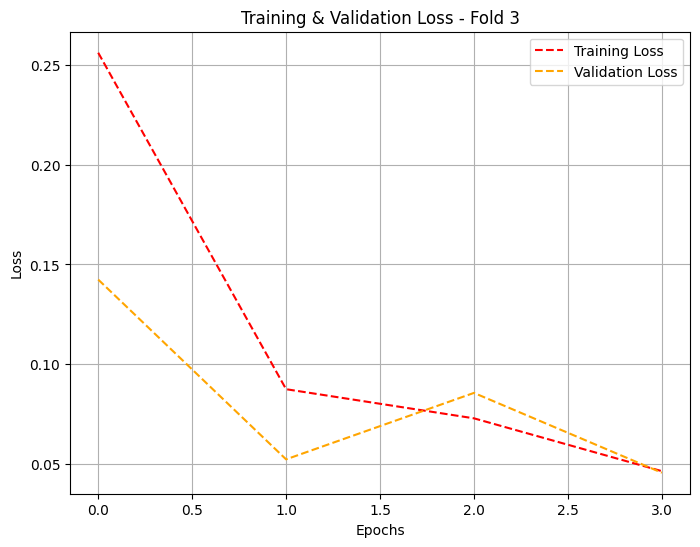

Classification Report - Fold 3:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      1.00      1.00       237
      Sardin       1.00      0.98      0.99       580
  Sardinella       0.91      1.00      0.95        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           0.99      1682
   macro avg       0.98      1.00      0.99      1682
weighted avg       0.99      0.99      0.99      1682


Evaluating Fold 4:
211/211 ━━━━━━━━━━━━━━━━━━━━ 24s 66ms/step


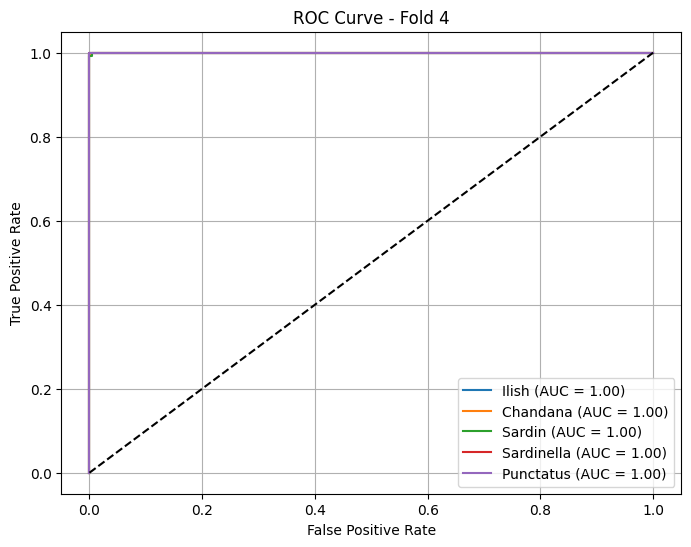

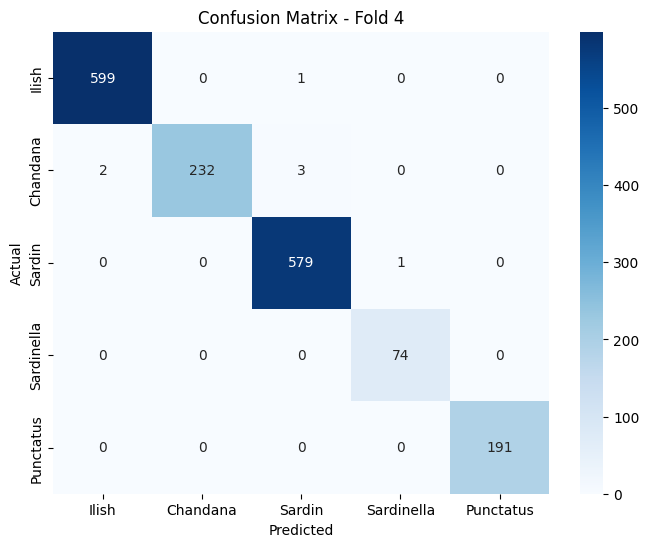

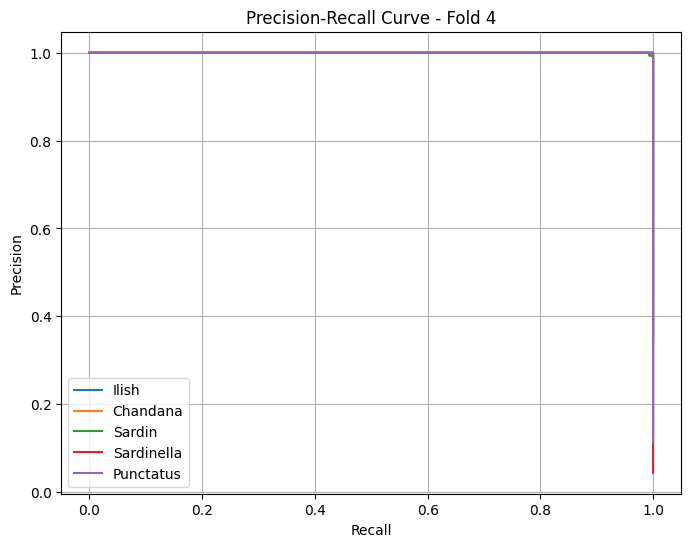

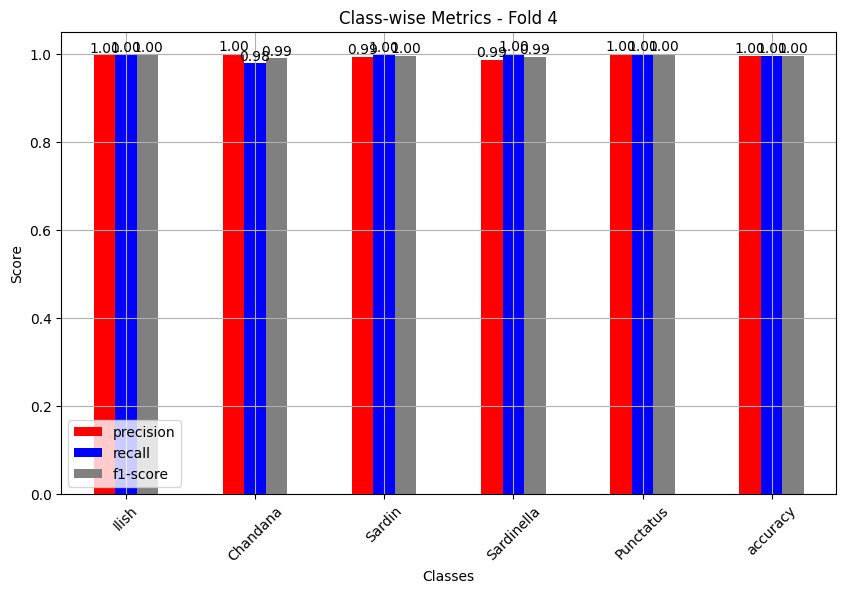

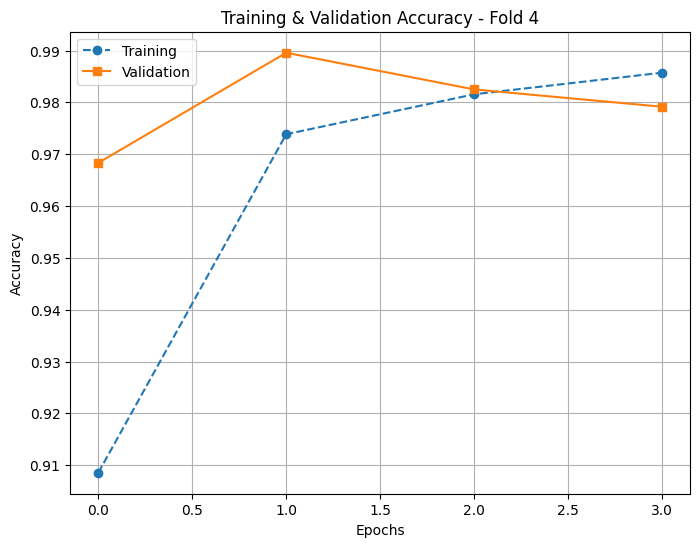

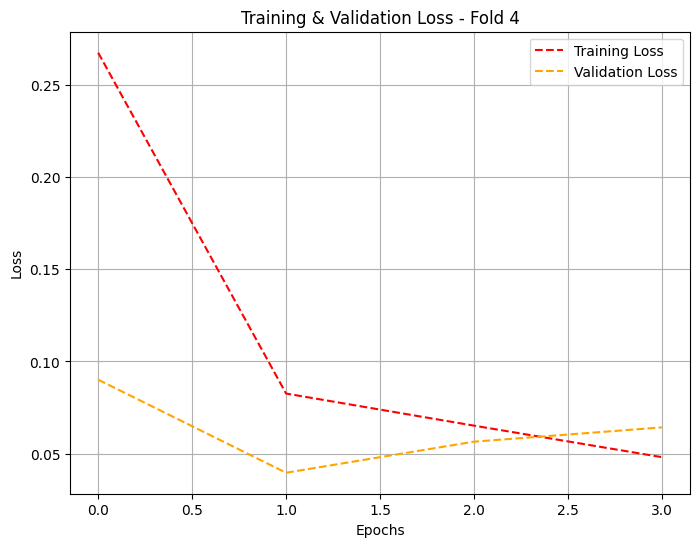

Classification Report - Fold 4:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      0.98      0.99       237
      Sardin       0.99      1.00      1.00       580
  Sardinella       0.99      1.00      0.99        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       1.00      1.00      1.00      1682
weighted avg       1.00      1.00      1.00      1682


Evaluating Fold 5:
211/211 ━━━━━━━━━━━━━━━━━━━━ 24s 64ms/step


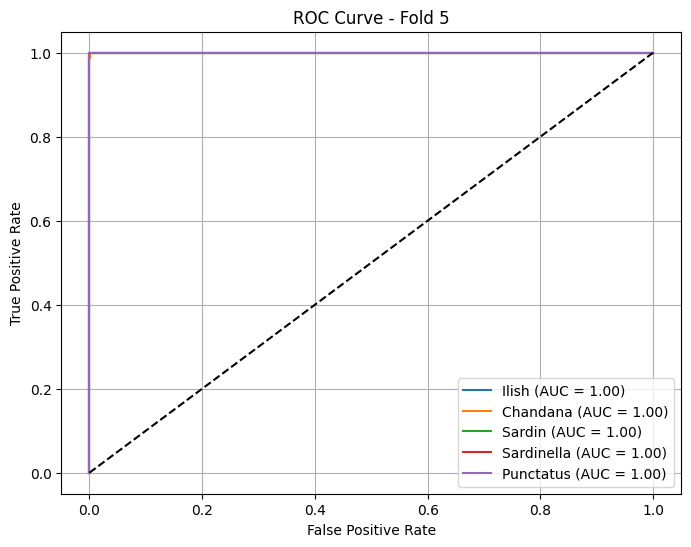

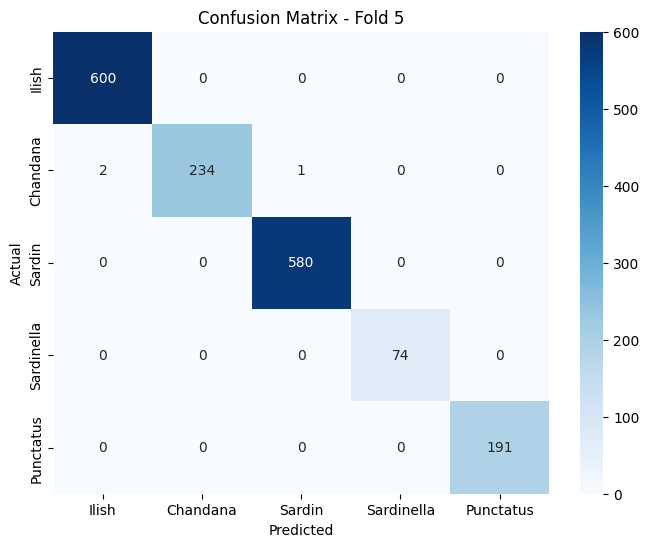

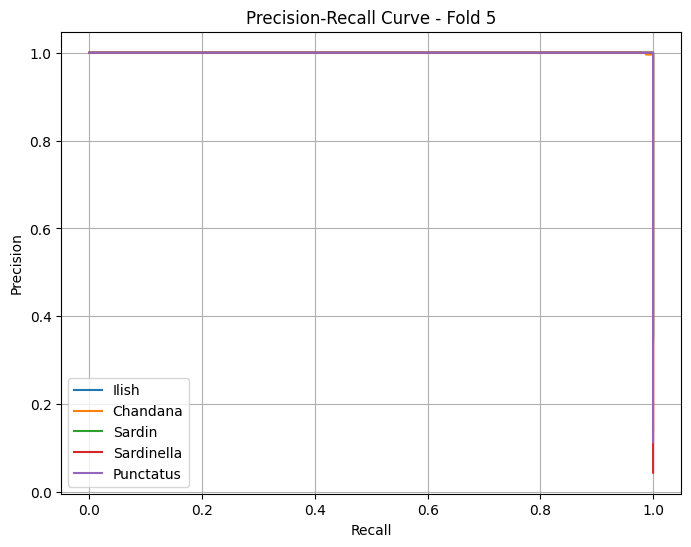

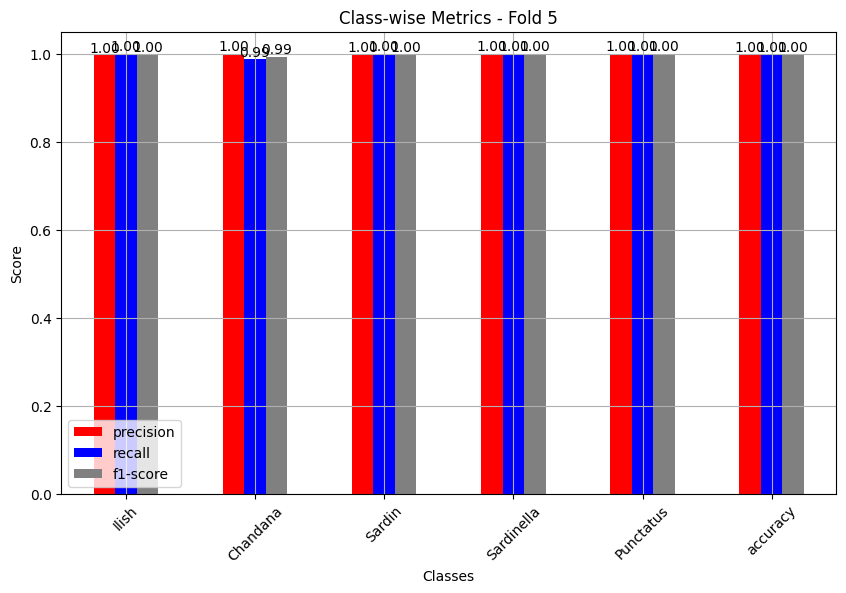

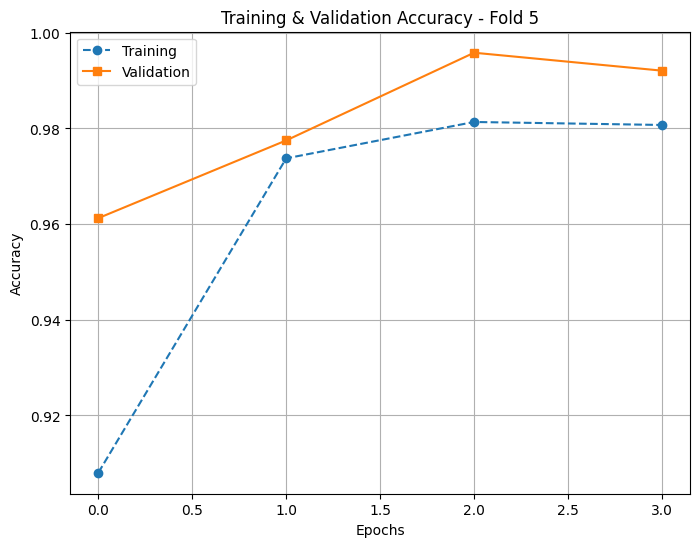

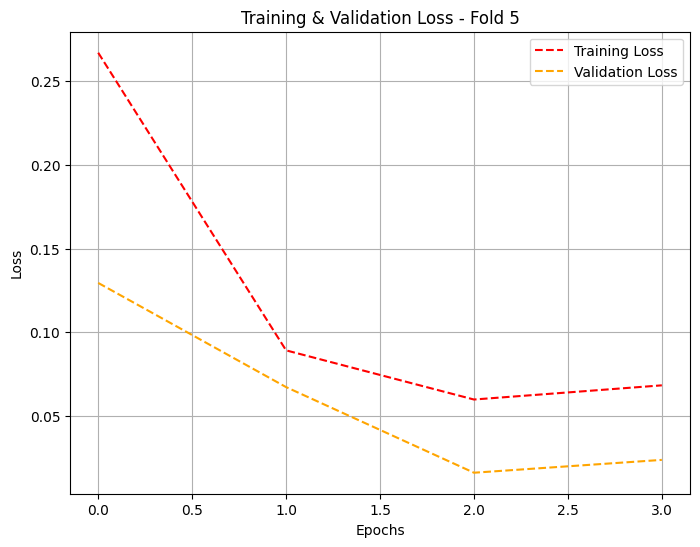

Classification Report - Fold 5:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      0.99      0.99       237
      Sardin       1.00      1.00      1.00       580
  Sardinella       1.00      1.00      1.00        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       1.00      1.00      1.00      1682
weighted avg       1.00      1.00      1.00      1682


Combined Results for All Folds:


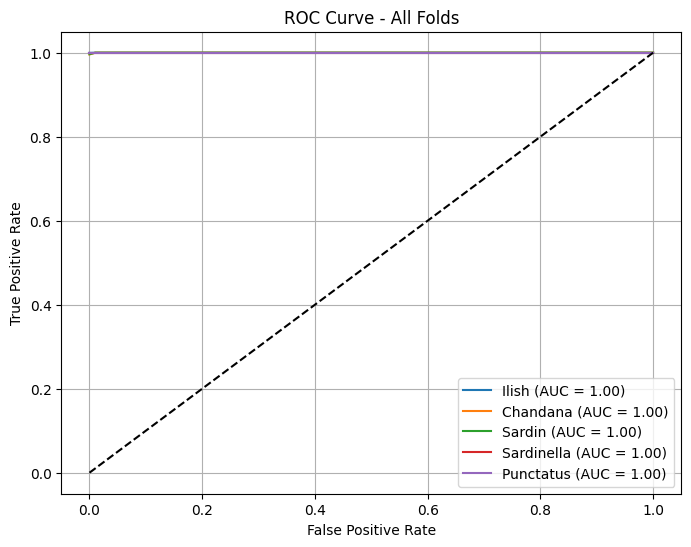

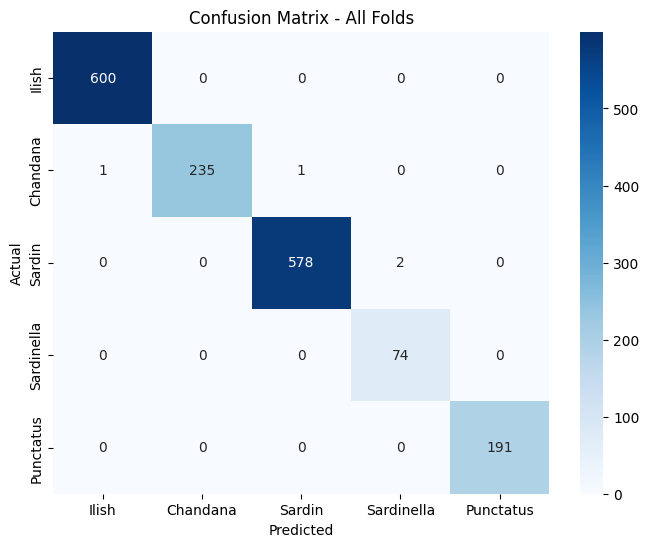

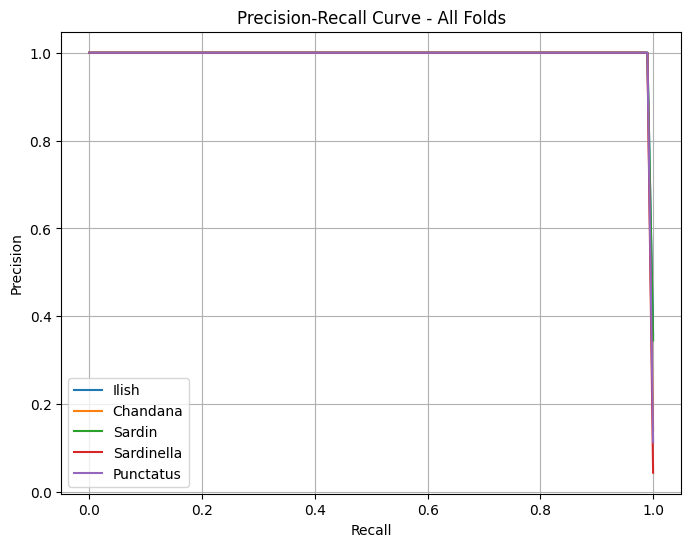

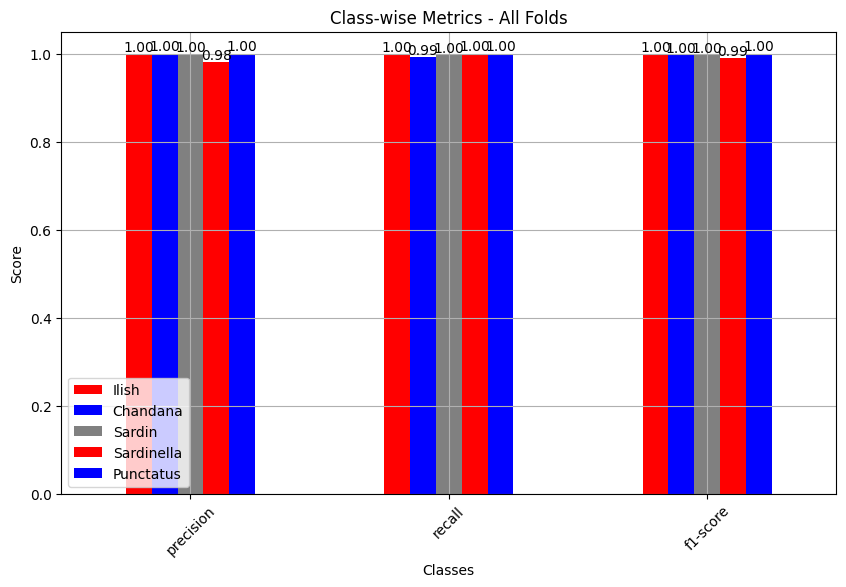

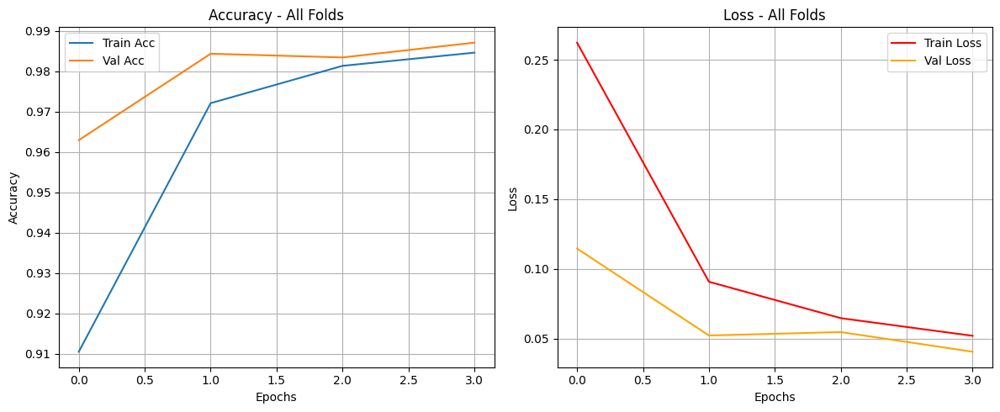


Final Combined Report (Learnable Weighted Ensemble):
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      1.00      1.00       237
      Sardin       1.00      1.00      1.00       580
  Sardinella       1.00      1.00      1.00        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       1.00      1.00      1.00      1682
weighted avg       1.00      1.00      1.00      1682

Final Accuracy: 0.9994, F1-Score: 0.9994


In [ ]:
# Install required packages
!pip install imbalanced-learn

import numpy as np
import tensorflow as tf
from tensorflow.keras.applications import ResNet50, EfficientNetB0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, Input, Lambda
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.metrics import roc_curve, auc, confusion_matrix, precision_recall_curve, classification_report, accuracy_score, f1_score
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import gc
from collections import Counter

# Enable mixed precision
tf.keras.mixed_precision.set_global_policy('mixed_float16')

# Configure GPU memory growth
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    for gpu in gpus:
        tf.config.experimental.set_memory_growth(gpu, True)
    print(f"{len(gpus)} GPUs detected.")
else:
    print("No GPU detected. Running on CPU.")

# Parameters
input_shape = (224, 224, 3)
num_classes = 5
batch_size = 8
epochs = 4
k_folds = 5
class_labels = ['Ilish', 'Chandana', 'Sardin', 'Sardinella', 'Punctatus']

# Assuming X and Y are loaded
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=42)

# Normalize in batches (commented out)
# def normalize_in_batches(data, batch_size=1000):
#     data = data.astype('float32')
#     for i in range(0, len(data), batch_size):
#         data[i:min(i + batch_size, len(data))] /= 255.0
#     return data

# X_train_scaled = normalize_in_batches(X_train)
# X_test_scaled = normalize_in_batches(X_test)
X_train_scaled = X_train  # Use raw data as-is
X_test_scaled = X_test    # Use raw data as-is

# Apply SMOTE
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_train_resampled, Y_train_resampled = smote.fit_resample(X_train_scaled.reshape(X_train_scaled.shape[0], -1), Y_train)
X_train_resampled = X_train_resampled.reshape(-1, 224, 224, 3)
print("Class distribution after SMOTE:", Counter(Y_train_resampled))

# Image Augmentation
datagen = ImageDataGenerator(rotation_range=20, width_shift_range=0.2, height_shift_range=0.2, shear_range=0.2,
                             zoom_range=0.2, horizontal_flip=True, fill_mode="nearest")

def batch_generator(X, Y, batch_size=32):
    size = X.shape[0]
    while True:
        indices = np.random.permutation(size)
        for start in range(0, size, batch_size):
            batch_idx = indices[start:min(start + batch_size, size)]
            X_batch, Y_batch = X[batch_idx], Y[batch_idx]
            augmented_images = next(datagen.flow(X_batch, shuffle=False, batch_size=batch_size))
            yield augmented_images, Y_batch  # Sparse labels for sparse_categorical_crossentropy

# Define Base Models
def create_base_model(input_shape=(224, 224, 3), model_type='ResNet'):
    base = ResNet50(weights='imagenet', include_top=False, input_shape=input_shape) if model_type == 'ResNet' else EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape)
    for layer in base.layers[:-5]:
        layer.trainable = False
    for layer in base.layers[-5:]:
        layer.trainable = True
    return base

# Define Ensemble Model with Fixed Shape and Type Correction
def create_ensemble_model(input_shape=(224, 224, 3), num_classes=5):
    # Create base models
    model1 = create_base_model(input_shape, model_type='ResNet')
    model2 = create_base_model(input_shape, model_type='EfficientNet')

    # Rename layers to avoid name clashes
    for layer in model1.layers:
        layer._name = f"resnet_{layer.name}"
    for layer in model2.layers:
        layer._name = f"efficientnet_{layer.name}"

    input_layer = Input(shape=input_shape)
    output1 = model1(input_layer)
    output2 = model2(input_layer)

    output1 = GlobalAveragePooling2D()(output1)  # Shape: (None, 2048) for ResNet50
    output2 = GlobalAveragePooling2D()(output2)  # Shape: (None, 1280) for EfficientNetB0

    # Project both outputs to a common dimension (e.g., 1280)
    output1 = Dense(1280, activation='relu')(output1)  # Outputs float32 by default
    output2 = Dense(1280, activation='relu')(output2)  # Outputs float32 by default

    # # Cast outputs to float16 to match alpha and mixed precision policy
    # output1 = tf.cast(output1, tf.float16)
    # output2 = tf.cast(output2, tf.float16)

    # Cast outputs to float16 using Lambda layer to match alpha and mixed precision policy
    output1 = Lambda(lambda x: tf.cast(x, tf.float16))(output1)
    output2 = Lambda(lambda x: tf.cast(x, tf.float16))(output2)

    # alpha = tf.Variable(0.5, trainable=True, dtype=tf.float16, name="alpha")
    # ensemble_output = Lambda(lambda x: alpha * x[0] + (1 - alpha) * x[1],
    #                          output_shape=(1280,))([output1, output2])

    alpha = tf.Variable(0.5, trainable=True, dtype=tf.float16, name="alpha")
    ensemble_output = Lambda(lambda x: alpha * tf.cast(x[0], tf.float16) + (1 - alpha) * tf.cast(x[1], tf.float16),
                         output_shape=(1280,))([output1, output2])

    x = Dense(128, activation='relu')(ensemble_output)
    x = Dropout(0.5)(x)
    final_output = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=input_layer, outputs=final_output)
    model.compile(optimizer=Adam(learning_rate=0.001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

# K-Fold Training
def train_with_kfold(X_train, Y_train, X_test, Y_test, k=5, batch_size=32, epochs=4):
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
    histories = []
    trained_models = []

    with tf.device('/GPU:0'):
        for fold_no, (train_idx, val_idx) in enumerate(skf.split(X_train, Y_train), 1):
            print(f"Training Fold {fold_no}/{k}")
            X_train_fold, X_val_fold = X_train[train_idx], X_train[val_idx]
            Y_train_fold, Y_val_fold = Y_train[train_idx], Y_train[val_idx]

            ensemble_model = create_ensemble_model(input_shape, num_classes)

            train_gen = batch_generator(X_train_fold, Y_train_fold, batch_size)
            val_gen = batch_generator(X_val_fold, Y_val_fold, batch_size)

            callbacks = [
                ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2),
                ModelCheckpoint(f'best_ensemble_model_{fold_no}.weights.h5', save_best_only=True,
                                monitor='val_accuracy', mode='max', save_weights_only=True),
                EarlyStopping(monitor='val_accuracy', patience=3, restore_best_weights=True)
            ]

            history = ensemble_model.fit(train_gen, validation_data=val_gen, epochs=epochs,
                                         steps_per_epoch=len(X_train_fold)//batch_size,
                                         validation_steps=len(X_val_fold)//batch_size, callbacks=callbacks, verbose=1)

            histories.append(history)
            trained_models.append(ensemble_model)

            tf.keras.backend.clear_session()
            gc.collect()

    return histories, trained_models

# Evaluation and Plotting
def evaluate_and_plot(histories, X_test, Y_test, trained_models):
    ensemble_probs_list, ensemble_preds_list = [], []

    with tf.device('/GPU:0'):
        # Fold-wise Visualization
        print("\nFold-by-Fold Visualizations:")
        for fold_no, (model, history) in enumerate(zip(trained_models, histories), 1):
            print(f"\nEvaluating Fold {fold_no}:")
            probs = model.predict(X_test, batch_size=8)
            preds = np.argmax(probs, axis=1)
            ensemble_probs_list.append(probs)
            ensemble_preds_list.append(preds)

            # Fold-wise Plots
            def plot_roc_fold(Y_test, probs, fold_no):
                plt.figure(figsize=(8, 6))
                for i, cls in enumerate(class_labels):
                    fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                    roc_auc = auc(fpr, tpr)
                    plt.plot(fpr, tpr, label=f'{cls} (AUC = {roc_auc:.2f})')
                plt.plot([0, 1], [0, 1], 'k--')
                plt.title(f'ROC Curve - Fold {fold_no}')
                plt.xlabel('False Positive Rate')
                plt.ylabel('True Positive Rate')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_confusion_fold(Y_test, preds, fold_no):
                cm = confusion_matrix(Y_test, preds)
                plt.figure(figsize=(8, 6))
                sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
                plt.title(f'Confusion Matrix - Fold {fold_no}')
                plt.xlabel('Predicted')
                plt.ylabel('Actual')
                plt.show()

            def plot_pr_fold(Y_test, probs, fold_no):
                plt.figure(figsize=(8, 6))
                for i, cls in enumerate(class_labels):
                    precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                    plt.plot(recall, precision, label=cls)
                plt.title(f'Precision-Recall Curve - Fold {fold_no}')
                plt.xlabel('Recall')
                plt.ylabel('Precision')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_metrics_fold(Y_test, preds, fold_no):
                report = classification_report(Y_test, preds, target_names=class_labels, output_dict=True)
                df = pd.DataFrame(report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]
                df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
                for p in plt.gca().patches:
                    plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
                plt.title(f'Class-wise Metrics - Fold {fold_no}')
                plt.xlabel('Classes')
                plt.ylabel('Score')
                plt.xticks(rotation=45)
                plt.legend()
                plt.grid()
                plt.show()

            def plot_acc_fold(history, fold_no):
                plt.figure(figsize=(8, 6))
                plt.plot(history.history['accuracy'], label='Training', linestyle='dashed', marker='o')
                plt.plot(history.history['val_accuracy'], label='Validation', marker='s')
                plt.title(f'Training & Validation Accuracy - Fold {fold_no}')
                plt.xlabel('Epochs')
                plt.ylabel('Accuracy')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_loss_fold(history, fold_no):
                plt.figure(figsize=(8, 6))
                plt.plot(history.history['loss'], label='Training Loss', linestyle='dashed', color='red')
                plt.plot(history.history['val_loss'], label='Validation Loss', linestyle='dashed', color='orange')
                plt.title(f'Training & Validation Loss - Fold {fold_no}')
                plt.xlabel('Epochs')
                plt.ylabel('Loss')
                plt.legend()
                plt.grid()
                plt.show()

            def print_report_fold(Y_test, preds, fold_no):
                report = classification_report(Y_test, preds, target_names=class_labels)
                print(f"Classification Report - Fold {fold_no}:\n{report}")

            # Execute Fold-wise Plots
            plot_roc_fold(Y_test, probs, fold_no)
            plot_confusion_fold(Y_test, preds, fold_no)
            plot_pr_fold(Y_test, probs, fold_no)
            plot_metrics_fold(Y_test, preds, fold_no)
            plot_acc_fold(history, fold_no)
            plot_loss_fold(history, fold_no)
            print_report_fold(Y_test, preds, fold_no)

            tf.keras.backend.clear_session()
            gc.collect()

        # Combined Visualizations
        print("\nCombined Results for All Folds:")
        def plot_roc_combined(Y_test, probs_list):
            plt.figure(figsize=(8, 6))
            mean_fpr = np.linspace(0, 1, 100)
            for i, cls in enumerate(class_labels):
                tprs, aucs = [], []
                for probs in probs_list:
                    fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                    tprs.append(np.interp(mean_fpr, fpr, tpr))
                    aucs.append(auc(fpr, tpr))
                mean_tpr = np.mean(tprs, axis=0)
                mean_auc = auc(mean_fpr, mean_tpr)
                plt.plot(mean_fpr, mean_tpr, label=f'{cls} (AUC = {mean_auc:.2f})')
            plt.plot([0, 1], [0, 1], 'k--')
            plt.title('ROC Curve - All Folds')
            plt.xlabel('False Positive Rate')
            plt.ylabel('True Positive Rate')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_confusion_combined(Y_test, preds_list):
            mean_cm = np.mean([confusion_matrix(Y_test, preds) for preds in preds_list], axis=0)
            plt.figure(figsize=(8, 6))
            sns.heatmap(mean_cm, annot=True, fmt='.0f', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
            plt.title('Confusion Matrix - All Folds')
            plt.xlabel('Predicted')
            plt.ylabel('Actual')
            plt.show()

        def plot_pr_combined(Y_test, probs_list):
            plt.figure(figsize=(8, 6))
            mean_recall = np.linspace(0, 1, 100)
            for i, cls in enumerate(class_labels):
                precisions = []
                for probs in probs_list:
                    precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                    precisions.append(np.interp(mean_recall[::-1], recall[::-1], precision[::-1])[::-1])
                mean_precision = np.mean(precisions, axis=0)
                plt.plot(mean_recall, mean_precision, label=cls)
            plt.title('Precision-Recall Curve - All Folds')
            plt.xlabel('Recall')
            plt.ylabel('Precision')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_metrics_combined(Y_test, preds_list):
            reports = [classification_report(Y_test, preds, target_names=class_labels, output_dict=True) for preds in preds_list]
            mean_report = {metric: {cls: np.mean([r[cls][metric] for r in reports]) for cls in class_labels}
                           for metric in ['precision', 'recall', 'f1-score']}
            df = pd.DataFrame(mean_report).T
            df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
            for p in plt.gca().patches:
                plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
            plt.title('Class-wise Metrics - All Folds')
            plt.xlabel('Classes')
            plt.ylabel('Score')
            plt.xticks(rotation=45)
            plt.legend()
            plt.grid()
            plt.show()

        def plot_acc_loss_combined(histories):
            plt.figure(figsize=(12, 5))
            mean_acc = np.mean([h.history['accuracy'] for h in histories], axis=0)
            mean_val_acc = np.mean([h.history['val_accuracy'] for h in histories], axis=0)
            mean_loss = np.mean([h.history['loss'] for h in histories], axis=0)
            mean_val_loss = np.mean([h.history['val_loss'] for h in histories], axis=0)
            plt.subplot(1, 2, 1)
            plt.plot(mean_acc, label='Train Acc')
            plt.plot(mean_val_acc, label='Val Acc')
            plt.title('Accuracy - All Folds')
            plt.xlabel('Epochs')
            plt.ylabel('Accuracy')
            plt.legend()
            plt.grid()
            plt.subplot(1, 2, 2)
            plt.plot(mean_loss, label='Train Loss', color='red')
            plt.plot(mean_val_loss, label='Val Loss', color='orange')
            plt.title('Loss - All Folds')
            plt.xlabel('Epochs')
            plt.ylabel('Loss')
            plt.legend()
            plt.grid()
            plt.tight_layout()
            plt.show()

        def print_final_report(Y_test, probs_list):
            mean_probs = np.mean(probs_list, axis=0)
            final_preds = np.argmax(mean_probs, axis=1)
            report = classification_report(Y_test, final_preds, target_names=class_labels)
            acc = accuracy_score(Y_test, final_preds)
            f1 = f1_score(Y_test, final_preds, average='weighted')
            print(f"\nFinal Combined Report (Learnable Weighted Ensemble):\n{report}")
            print(f"Final Accuracy: {acc:.4f}, F1-Score: {f1:.4f}")

        # Execute Combined Plots
        plot_roc_combined(Y_test, ensemble_probs_list)
        plot_confusion_combined(Y_test, ensemble_preds_list)
        plot_pr_combined(Y_test, ensemble_probs_list)
        plot_metrics_combined(Y_test, ensemble_preds_list)
        plot_acc_loss_combined(histories)
        print_final_report(Y_test, ensemble_probs_list)

# Train and Evaluate
histories, trained_models = train_with_kfold(X_train_resampled, Y_train_resampled, X_test_scaled, Y_test)
print("Training Complete with Learnable Weighted Ensemble.")
evaluate_and_plot(histories, X_test_scaled, Y_test, trained_models)

1 GPUs detected.
Class distribution after SMOTE: Counter({np.int32(1): 2400, np.int32(0): 2400, np.int32(3): 2400, np.int32(2): 2400, np.int32(4): 2400})
Training Fold 1/5
Epoch 1/2
300/300 ━━━━━━━━━━━━━━━━━━━━ 169s 441ms/step - accuracy: 0.8097 - loss: 0.5344 - val_accuracy: 0.9767 - val_loss: 0.0670 - learning_rate: 0.0010
Epoch 2/2
300/300 ━━━━━━━━━━━━━━━━━━━━ 118s 394ms/step - accuracy: 0.9668 - loss: 0.1001 - val_accuracy: 0.9737 - val_loss: 0.0838 - learning_rate: 0.0010
Training Fold 2/5
Epoch 1/2
300/300 ━━━━━━━━━━━━━━━━━━━━ 163s 434ms/step - accuracy: 0.8095 - loss: 0.5103 - val_accuracy: 0.9817 - val_loss: 0.0645 - learning_rate: 0.0010
Epoch 2/2
300/300 ━━━━━━━━━━━━━━━━━━━━ 119s 398ms/step - accuracy: 0.9680 - loss: 0.1142 - val_accuracy: 0.9821 - val_loss: 0.0647 - learning_rate: 0.0010
Training Fold 3/5
Epoch 1/2
300/300 ━━━━━━━━━━━━━━━━━━━━ 164s 434ms/step - accuracy: 0.8251 - loss: 0.4999 - val_accuracy: 0.9588 - val_loss: 0.1750 - learning_rate: 0.0010
Epoch 2/2
300/300

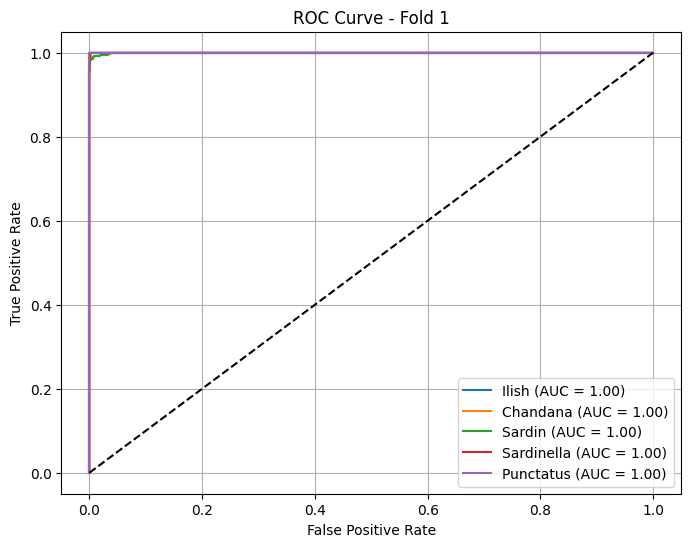

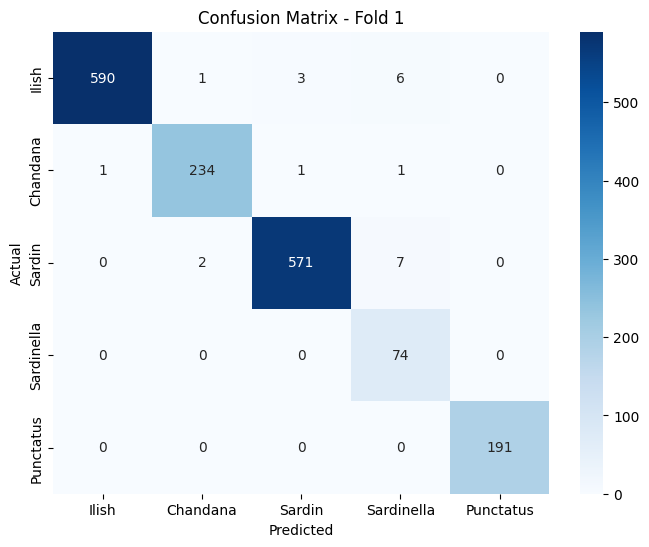

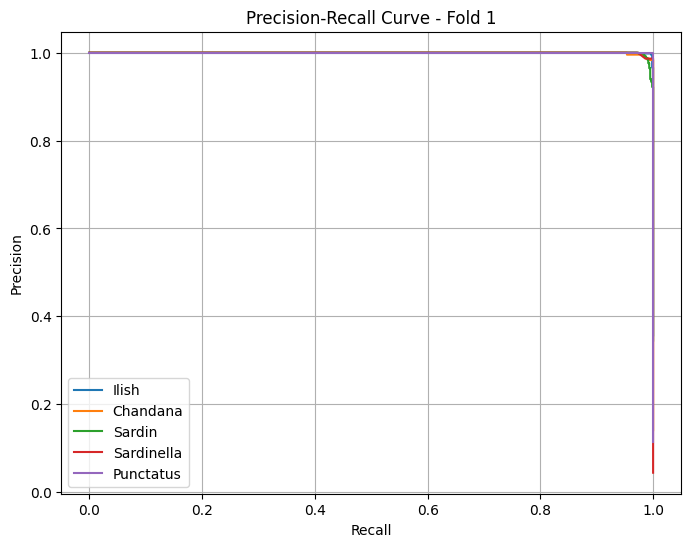

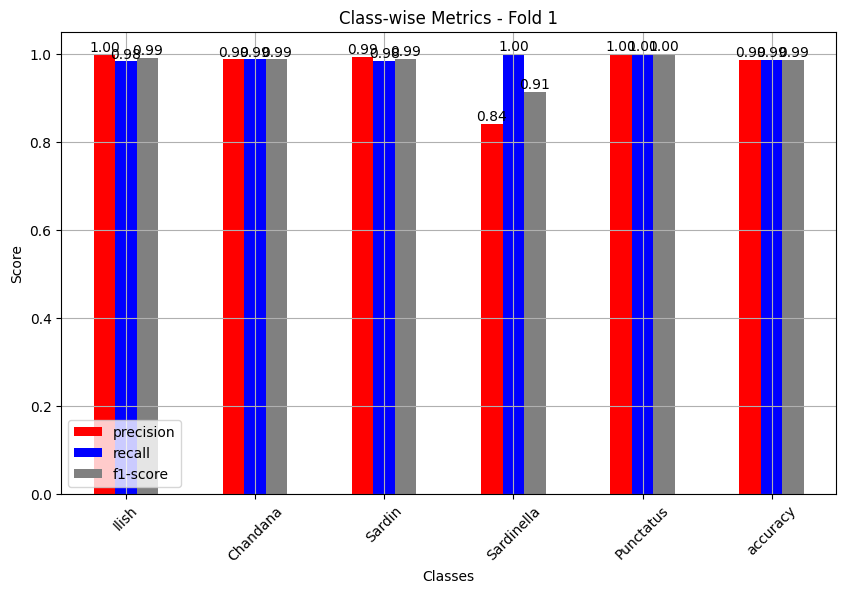

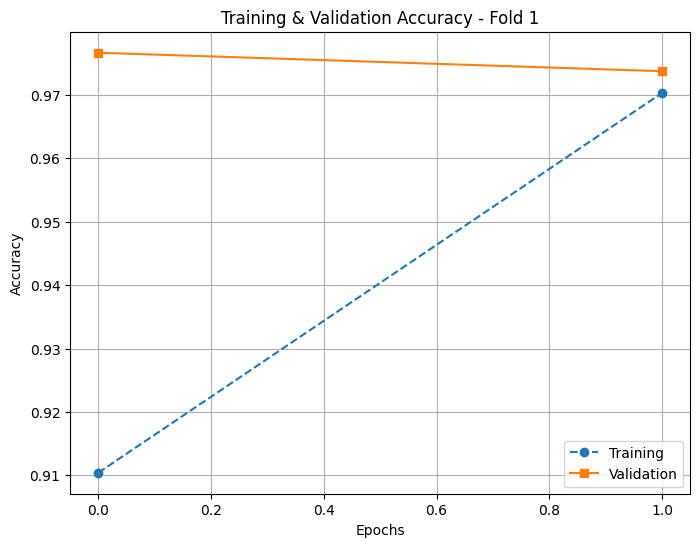

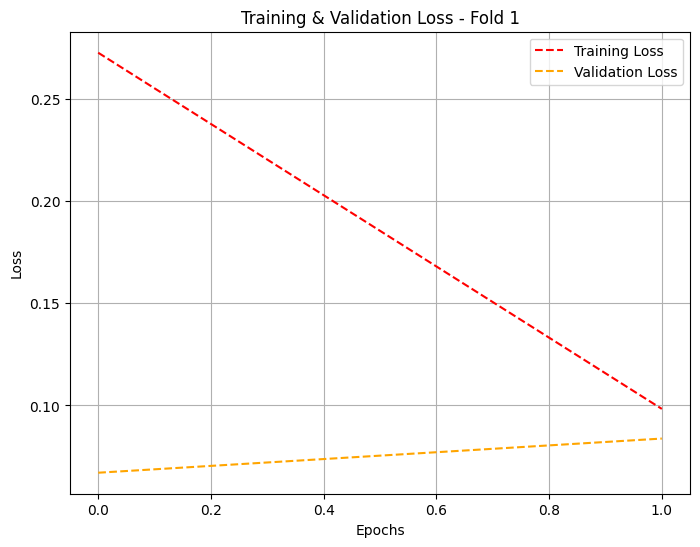

Classification Report - Fold 1:
              precision    recall  f1-score   support

       Ilish       1.00      0.98      0.99       600
    Chandana       0.99      0.99      0.99       237
      Sardin       0.99      0.98      0.99       580
  Sardinella       0.84      1.00      0.91        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           0.99      1682
   macro avg       0.96      0.99      0.98      1682
weighted avg       0.99      0.99      0.99      1682


Evaluating Fold 2:
211/211 ━━━━━━━━━━━━━━━━━━━━ 23s 61ms/step


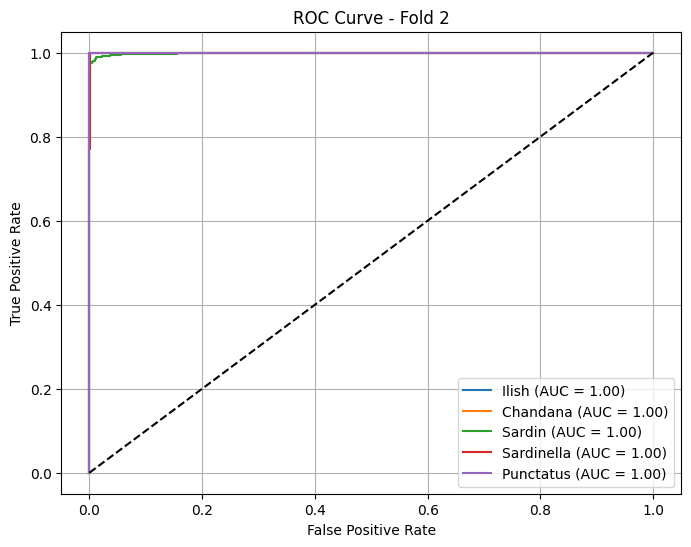

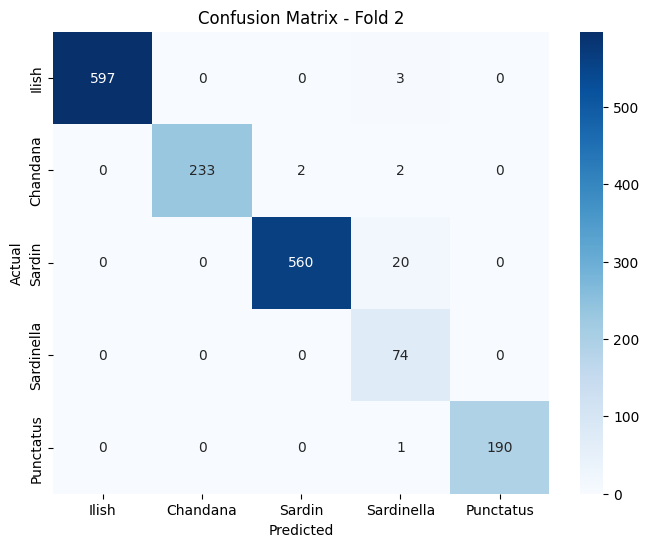

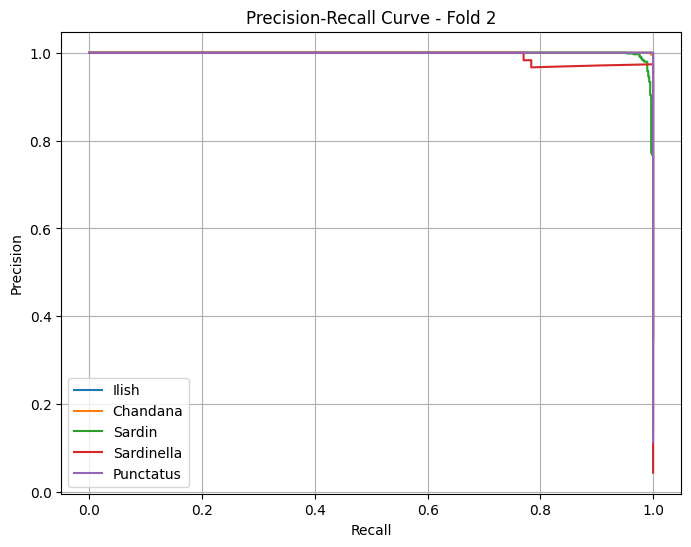

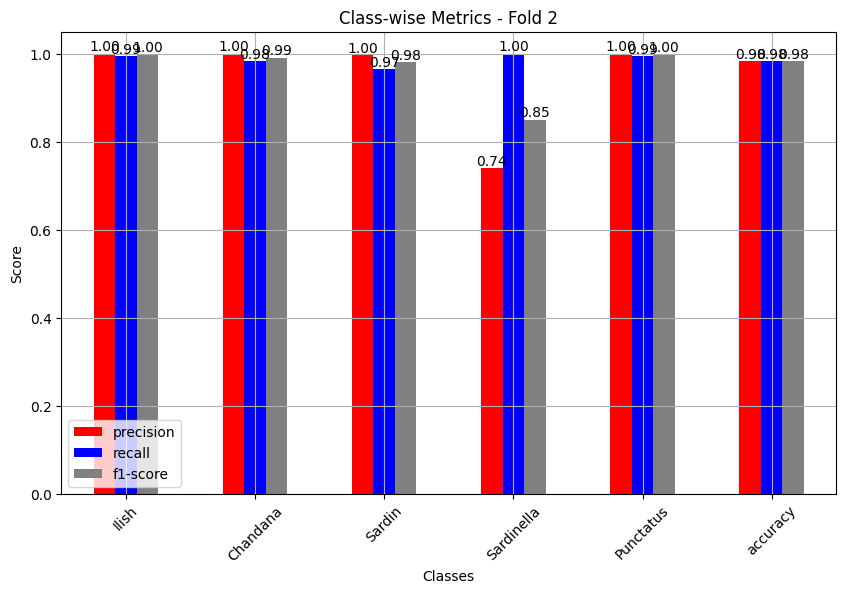

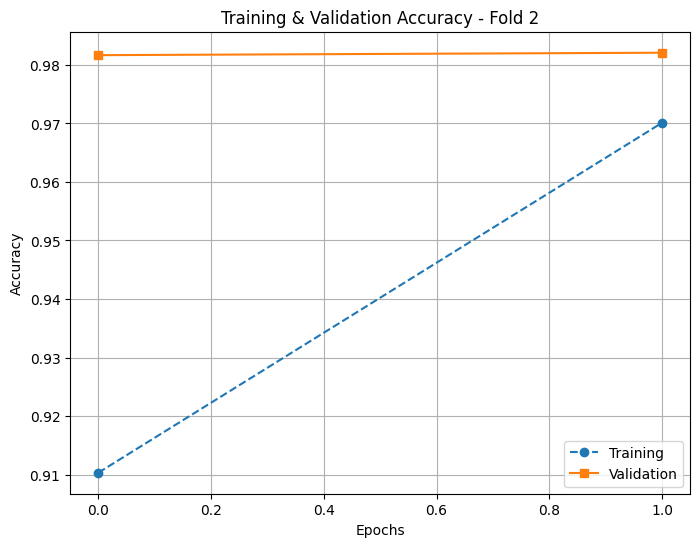

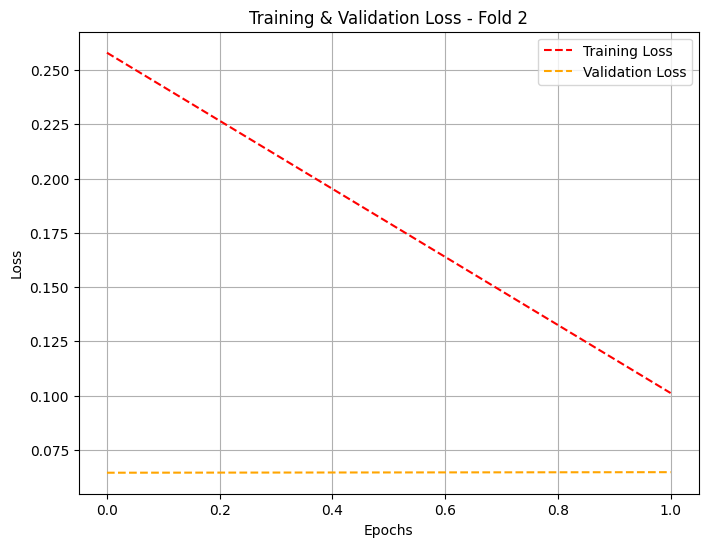

Classification Report - Fold 2:
              precision    recall  f1-score   support

       Ilish       1.00      0.99      1.00       600
    Chandana       1.00      0.98      0.99       237
      Sardin       1.00      0.97      0.98       580
  Sardinella       0.74      1.00      0.85        74
   Punctatus       1.00      0.99      1.00       191

    accuracy                           0.98      1682
   macro avg       0.95      0.99      0.96      1682
weighted avg       0.99      0.98      0.98      1682


Evaluating Fold 3:
211/211 ━━━━━━━━━━━━━━━━━━━━ 23s 65ms/step


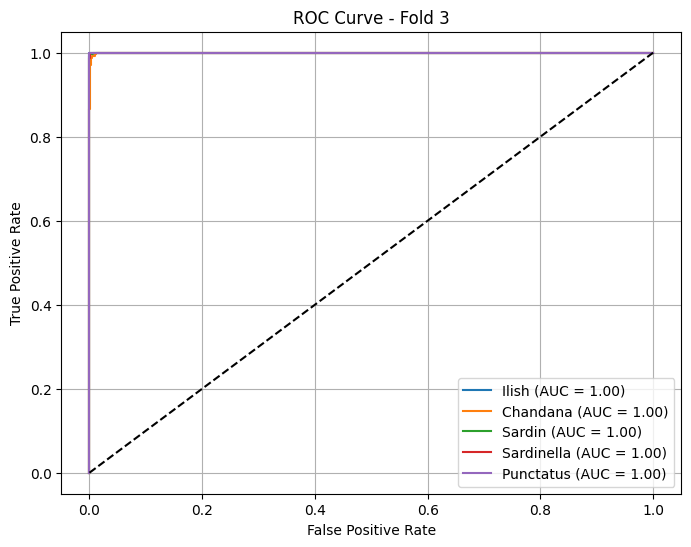

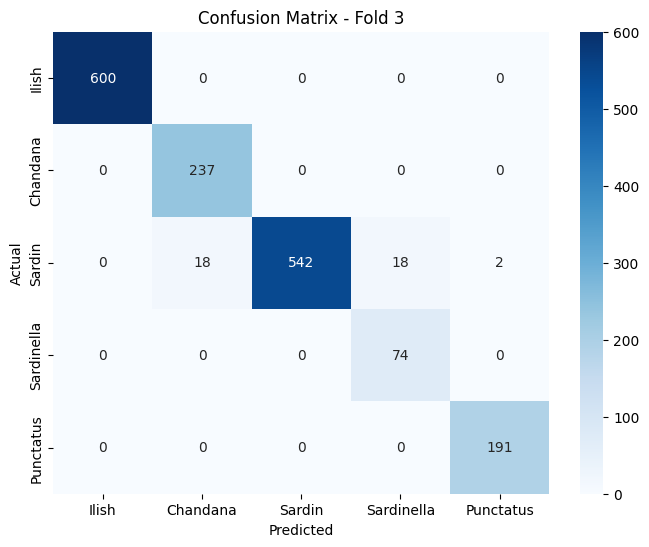

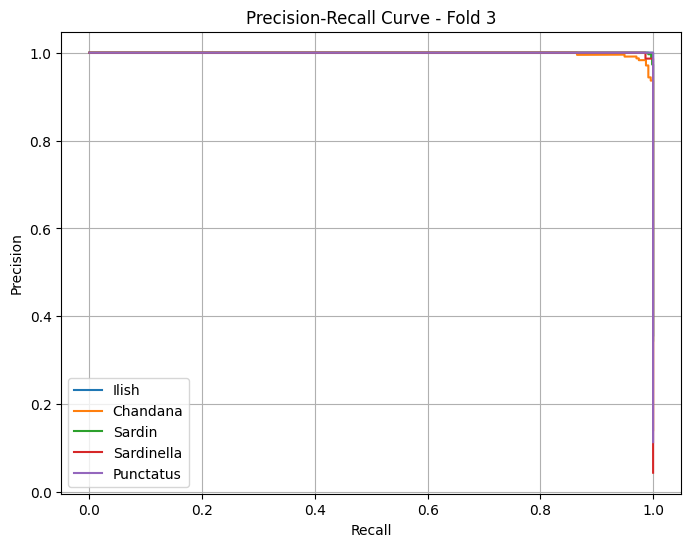

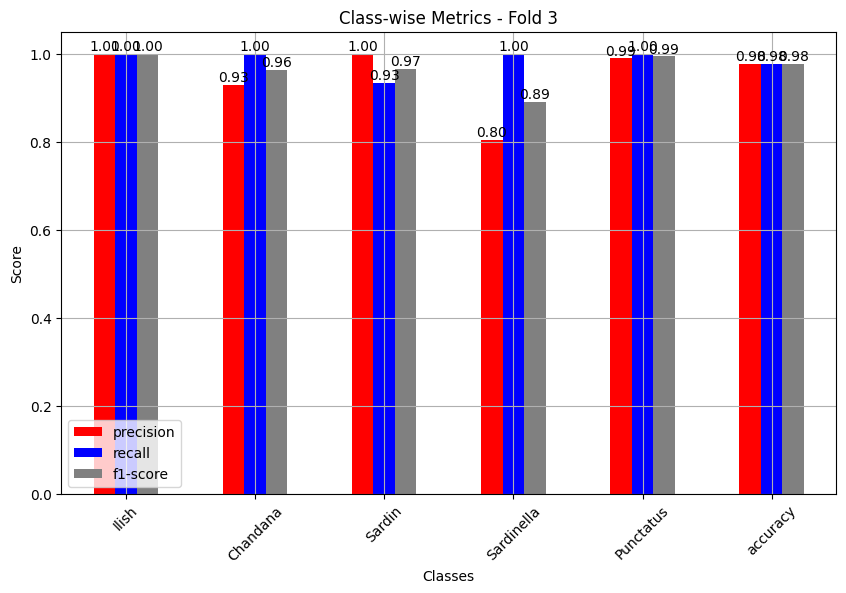

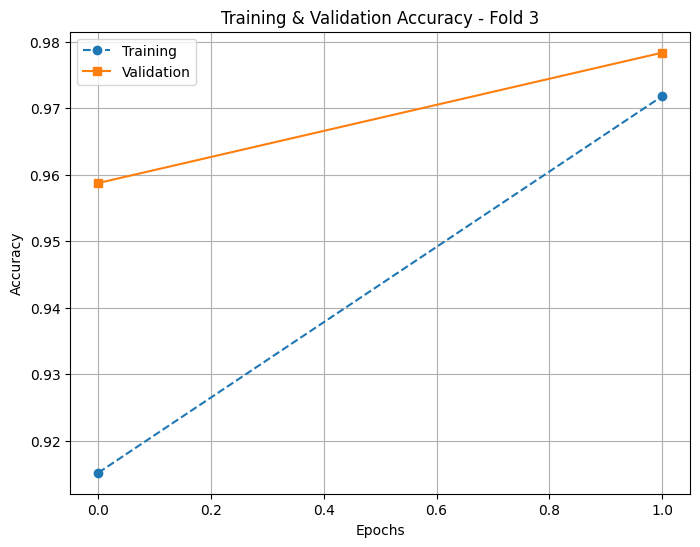

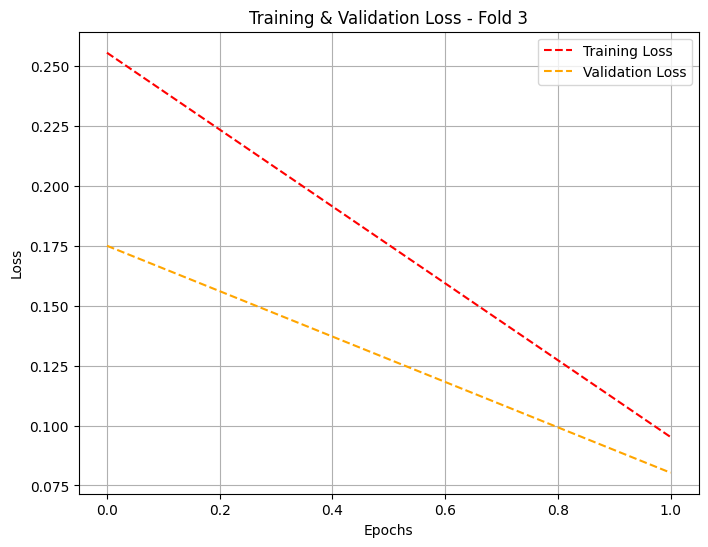

Classification Report - Fold 3:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       0.93      1.00      0.96       237
      Sardin       1.00      0.93      0.97       580
  Sardinella       0.80      1.00      0.89        74
   Punctatus       0.99      1.00      0.99       191

    accuracy                           0.98      1682
   macro avg       0.94      0.99      0.96      1682
weighted avg       0.98      0.98      0.98      1682


Evaluating Fold 4:
211/211 ━━━━━━━━━━━━━━━━━━━━ 23s 66ms/step


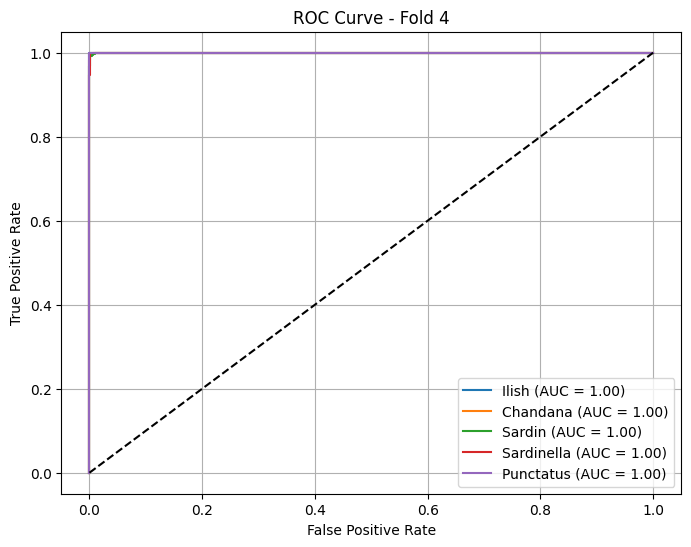

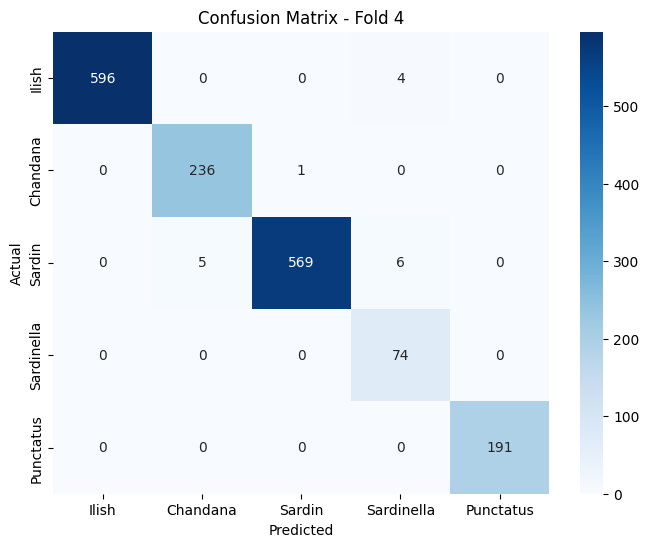

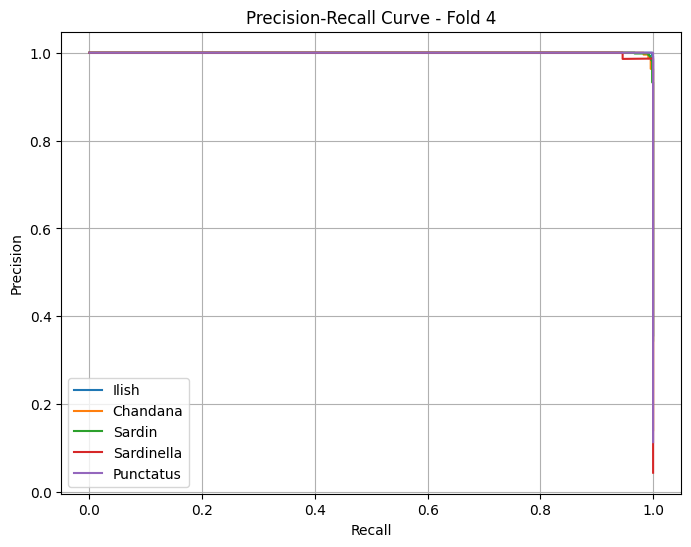

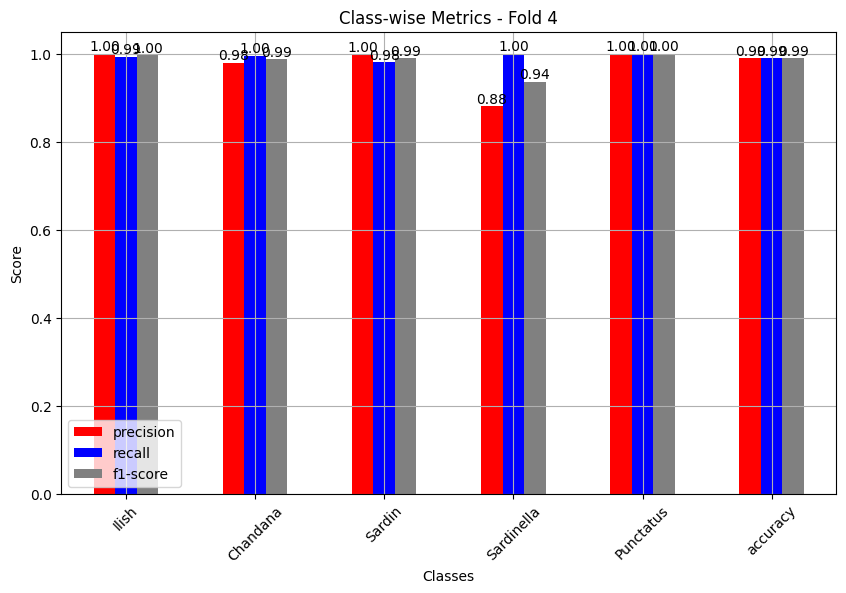

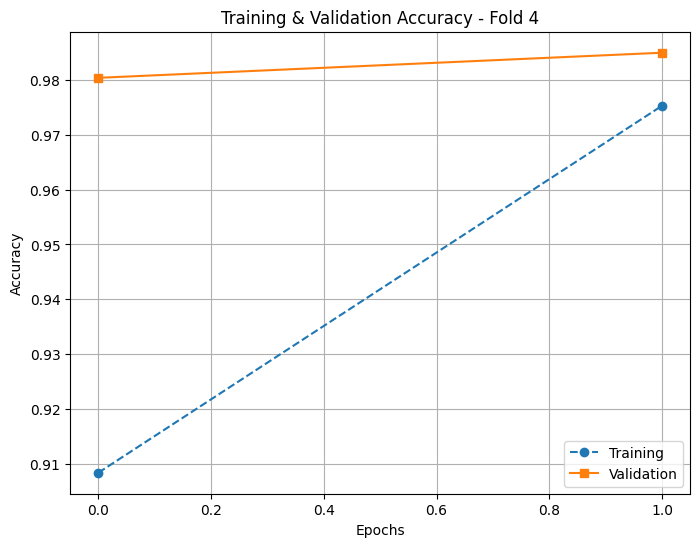

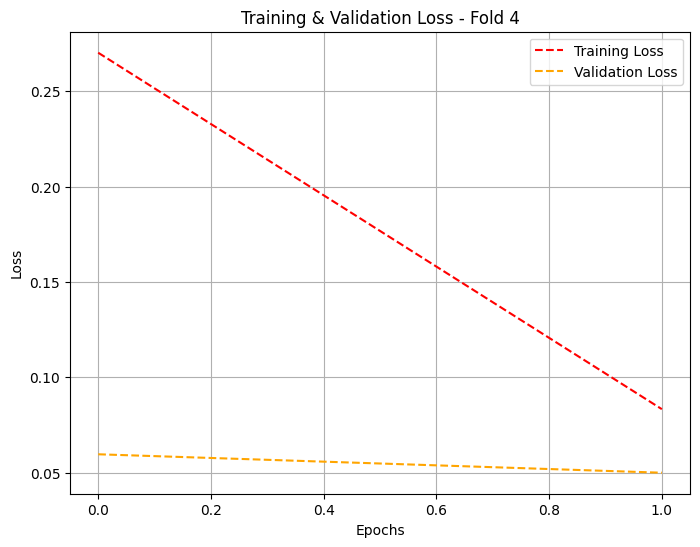

Classification Report - Fold 4:
              precision    recall  f1-score   support

       Ilish       1.00      0.99      1.00       600
    Chandana       0.98      1.00      0.99       237
      Sardin       1.00      0.98      0.99       580
  Sardinella       0.88      1.00      0.94        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           0.99      1682
   macro avg       0.97      0.99      0.98      1682
weighted avg       0.99      0.99      0.99      1682


Evaluating Fold 5:
211/211 ━━━━━━━━━━━━━━━━━━━━ 23s 60ms/step


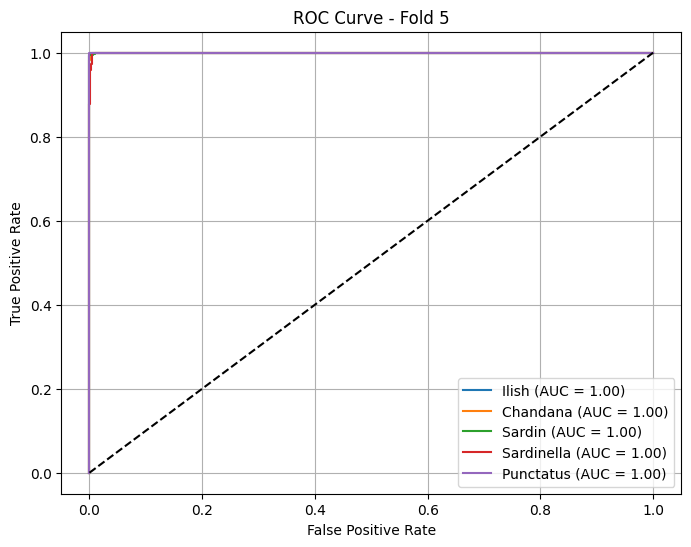

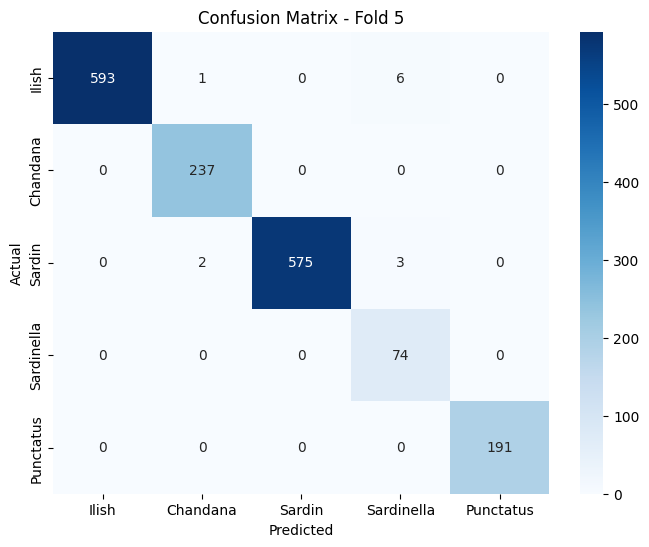

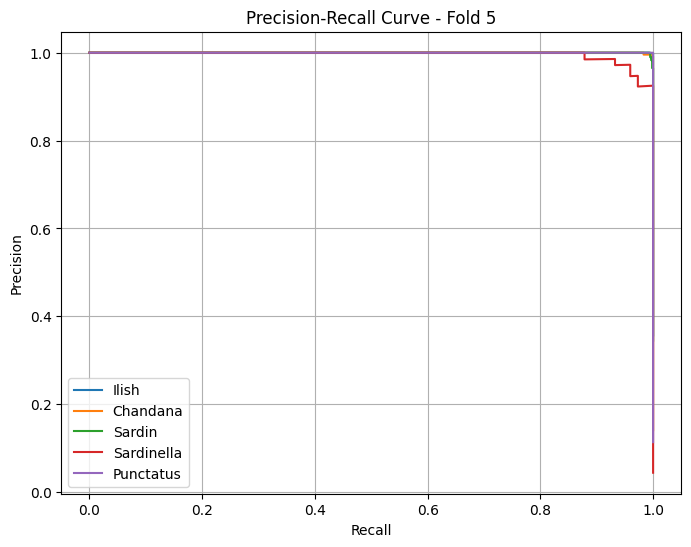

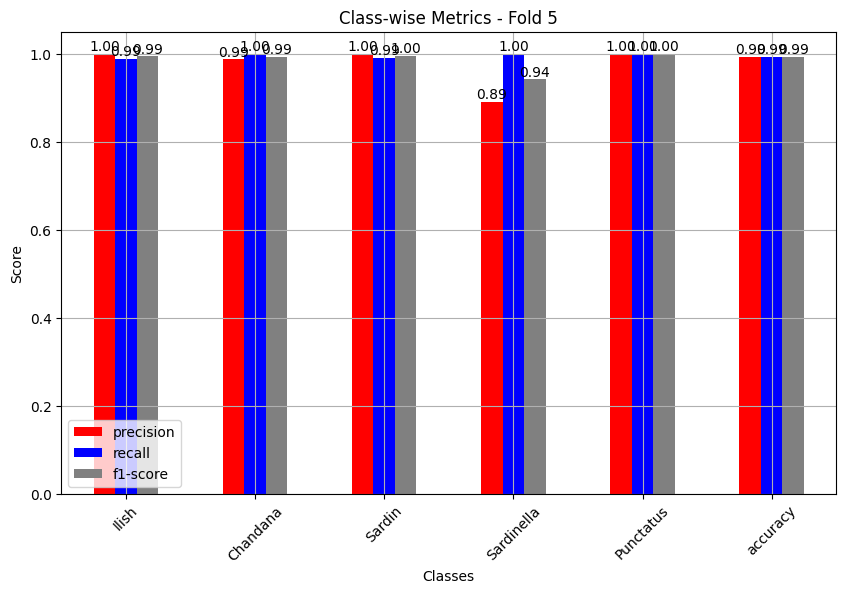

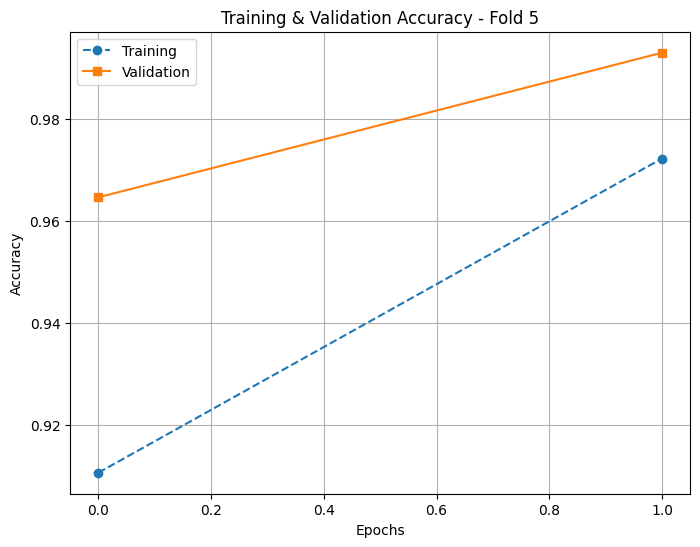

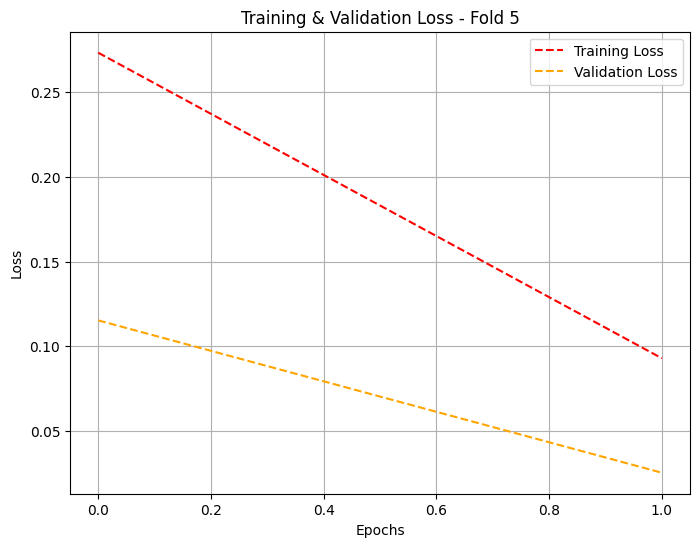

Classification Report - Fold 5:
              precision    recall  f1-score   support

       Ilish       1.00      0.99      0.99       600
    Chandana       0.99      1.00      0.99       237
      Sardin       1.00      0.99      1.00       580
  Sardinella       0.89      1.00      0.94        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           0.99      1682
   macro avg       0.98      1.00      0.99      1682
weighted avg       0.99      0.99      0.99      1682


Combined Results for All Folds:


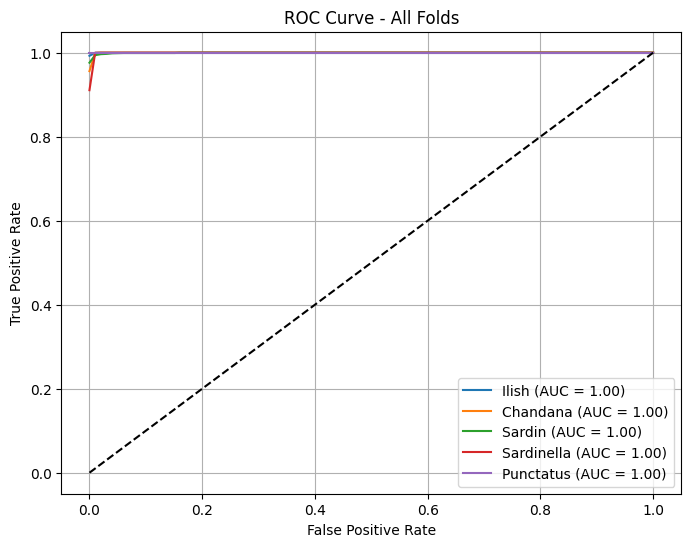

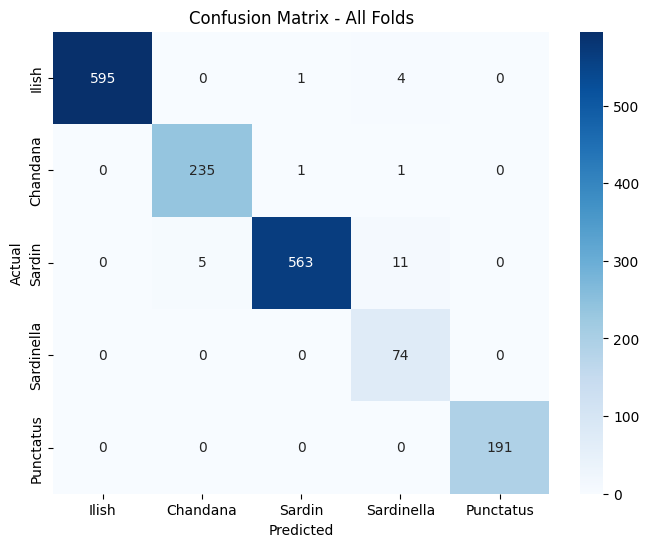

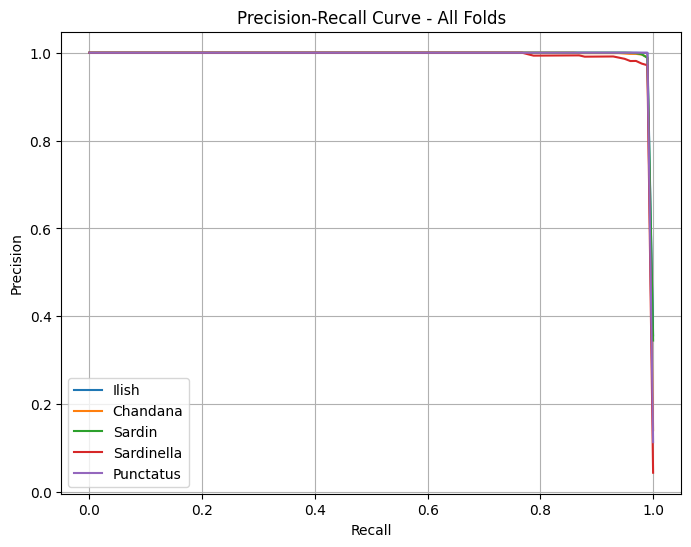

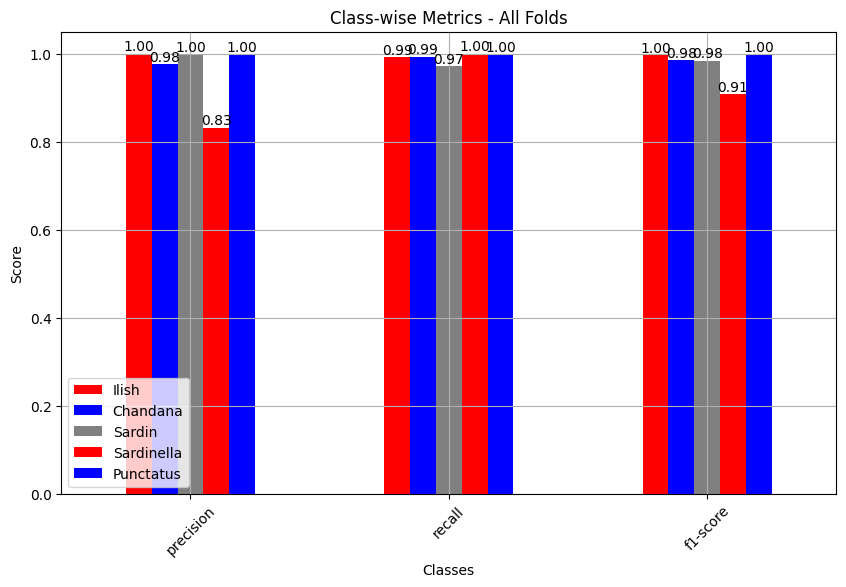

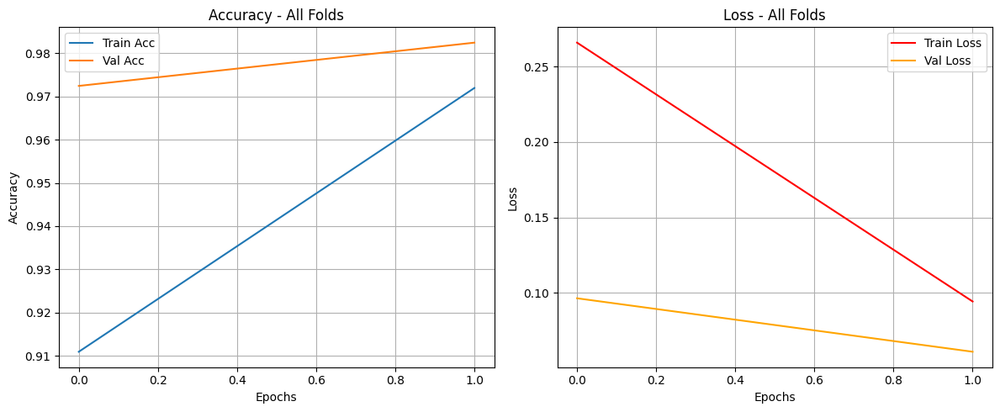


Final Combined Report (Learnable Weighted Ensemble):
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      1.00      1.00       237
      Sardin       1.00      0.99      0.99       580
  Sardinella       0.91      1.00      0.95        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       0.98      1.00      0.99      1682
weighted avg       1.00      1.00      1.00      1682

Final Accuracy: 0.9958, F1-Score: 0.9959


In [ ]:
# Install required packages
!pip install imbalanced-learn

import numpy as np
import tensorflow as tf
from tensorflow.keras.applications import ResNet50, EfficientNetB0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, Input, Lambda
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.metrics import roc_curve, auc, confusion_matrix, precision_recall_curve, classification_report, accuracy_score, f1_score
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import gc
from collections import Counter

# Enable mixed precision
tf.keras.mixed_precision.set_global_policy('mixed_float16')

# Configure GPU memory growth
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    for gpu in gpus:
        tf.config.experimental.set_memory_growth(gpu, True)
    print(f"{len(gpus)} GPUs detected.")
else:
    print("No GPU detected. Running on CPU.")

# Parameters
input_shape = (224, 224, 3)
num_classes = 5
batch_size = 8
epochs = 2
k_folds = 5
class_labels = ['Ilish', 'Chandana', 'Sardin', 'Sardinella', 'Punctatus']

# Assuming X and Y are loaded
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=42)

# Normalize in batches (commented out)
# def normalize_in_batches(data, batch_size=1000):
#     data = data.astype('float32')
#     for i in range(0, len(data), batch_size):
#         data[i:min(i + batch_size, len(data))] /= 255.0
#     return data

# X_train_scaled = normalize_in_batches(X_train)
# X_test_scaled = normalize_in_batches(X_test)
X_train_scaled = X_train  # Use raw data as-is
X_test_scaled = X_test    # Use raw data as-is

# Apply SMOTE
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_train_resampled, Y_train_resampled = smote.fit_resample(X_train_scaled.reshape(X_train_scaled.shape[0], -1), Y_train)
X_train_resampled = X_train_resampled.reshape(-1, 224, 224, 3)
print("Class distribution after SMOTE:", Counter(Y_train_resampled))

# Image Augmentation
datagen = ImageDataGenerator(rotation_range=20, width_shift_range=0.2, height_shift_range=0.2, shear_range=0.2,
                             zoom_range=0.2, horizontal_flip=True, fill_mode="nearest")

def batch_generator(X, Y, batch_size=32):
    size = X.shape[0]
    while True:
        indices = np.random.permutation(size)
        for start in range(0, size, batch_size):
            batch_idx = indices[start:min(start + batch_size, size)]
            X_batch, Y_batch = X[batch_idx], Y[batch_idx]
            augmented_images = next(datagen.flow(X_batch, shuffle=False, batch_size=batch_size))
            yield augmented_images, Y_batch  # Sparse labels for sparse_categorical_crossentropy

# Define Base Models
def create_base_model(input_shape=(224, 224, 3), model_type='ResNet'):
    base = ResNet50(weights='imagenet', include_top=False, input_shape=input_shape) if model_type == 'ResNet' else EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape)
    for layer in base.layers[:-5]:
        layer.trainable = False
    for layer in base.layers[-5:]:
        layer.trainable = True
    return base

# Define Ensemble Model with Fixed Shape and Type Correction
def create_ensemble_model(input_shape=(224, 224, 3), num_classes=5):
    # Create base models
    model1 = create_base_model(input_shape, model_type='ResNet')
    model2 = create_base_model(input_shape, model_type='EfficientNet')

    # Rename layers to avoid name clashes
    for layer in model1.layers:
        layer._name = f"resnet_{layer.name}"
    for layer in model2.layers:
        layer._name = f"efficientnet_{layer.name}"

    input_layer = Input(shape=input_shape)
    output1 = model1(input_layer)
    output2 = model2(input_layer)

    output1 = GlobalAveragePooling2D()(output1)  # Shape: (None, 2048) for ResNet50
    output2 = GlobalAveragePooling2D()(output2)  # Shape: (None, 1280) for EfficientNetB0

    # Project both outputs to a common dimension (e.g., 1280)
    output1 = Dense(1280, activation='relu')(output1)  # Outputs float32 by default
    output2 = Dense(1280, activation='relu')(output2)  # Outputs float32 by default

    # # Cast outputs to float16 to match alpha and mixed precision policy
    # output1 = tf.cast(output1, tf.float16)
    # output2 = tf.cast(output2, tf.float16)

    # Cast outputs to float16 using Lambda layer to match alpha and mixed precision policy
    output1 = Lambda(lambda x: tf.cast(x, tf.float16))(output1)
    output2 = Lambda(lambda x: tf.cast(x, tf.float16))(output2)

    # alpha = tf.Variable(0.5, trainable=True, dtype=tf.float16, name="alpha")
    # ensemble_output = Lambda(lambda x: alpha * x[0] + (1 - alpha) * x[1],
    #                          output_shape=(1280,))([output1, output2])

    alpha = tf.Variable(0.5, trainable=True, dtype=tf.float16, name="alpha")
    ensemble_output = Lambda(lambda x: alpha * tf.cast(x[0], tf.float16) + (1 - alpha) * tf.cast(x[1], tf.float16),
                         output_shape=(1280,))([output1, output2])

    x = Dense(128, activation='relu')(ensemble_output)
    x = Dropout(0.5)(x)
    final_output = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=input_layer, outputs=final_output)
    model.compile(optimizer=Adam(learning_rate=0.001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

# K-Fold Training
def train_with_kfold(X_train, Y_train, X_test, Y_test, k=5, batch_size=32, epochs=2):
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
    histories = []
    trained_models = []

    with tf.device('/GPU:0'):
        for fold_no, (train_idx, val_idx) in enumerate(skf.split(X_train, Y_train), 1):
            print(f"Training Fold {fold_no}/{k}")
            X_train_fold, X_val_fold = X_train[train_idx], X_train[val_idx]
            Y_train_fold, Y_val_fold = Y_train[train_idx], Y_train[val_idx]

            ensemble_model = create_ensemble_model(input_shape, num_classes)

            train_gen = batch_generator(X_train_fold, Y_train_fold, batch_size)
            val_gen = batch_generator(X_val_fold, Y_val_fold, batch_size)

            callbacks = [
                ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2),
                ModelCheckpoint(f'best_ensemble_model_{fold_no}.weights.h5', save_best_only=True,
                                monitor='val_accuracy', mode='max', save_weights_only=True),
                EarlyStopping(monitor='val_accuracy', patience=3, restore_best_weights=True)
            ]

            history = ensemble_model.fit(train_gen, validation_data=val_gen, epochs=epochs,
                                         steps_per_epoch=len(X_train_fold)//batch_size,
                                         validation_steps=len(X_val_fold)//batch_size, callbacks=callbacks, verbose=1)

            histories.append(history)
            trained_models.append(ensemble_model)

            tf.keras.backend.clear_session()
            gc.collect()

    return histories, trained_models

# Evaluation and Plotting
def evaluate_and_plot(histories, X_test, Y_test, trained_models):
    ensemble_probs_list, ensemble_preds_list = [], []

    with tf.device('/GPU:0'):
        # Fold-wise Visualization
        print("\nFold-by-Fold Visualizations:")
        for fold_no, (model, history) in enumerate(zip(trained_models, histories), 1):
            print(f"\nEvaluating Fold {fold_no}:")
            probs = model.predict(X_test, batch_size=8)
            preds = np.argmax(probs, axis=1)
            ensemble_probs_list.append(probs)
            ensemble_preds_list.append(preds)

            # Fold-wise Plots
            def plot_roc_fold(Y_test, probs, fold_no):
                plt.figure(figsize=(8, 6))
                for i, cls in enumerate(class_labels):
                    fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                    roc_auc = auc(fpr, tpr)
                    plt.plot(fpr, tpr, label=f'{cls} (AUC = {roc_auc:.2f})')
                plt.plot([0, 1], [0, 1], 'k--')
                plt.title(f'ROC Curve - Fold {fold_no}')
                plt.xlabel('False Positive Rate')
                plt.ylabel('True Positive Rate')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_confusion_fold(Y_test, preds, fold_no):
                cm = confusion_matrix(Y_test, preds)
                plt.figure(figsize=(8, 6))
                sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
                plt.title(f'Confusion Matrix - Fold {fold_no}')
                plt.xlabel('Predicted')
                plt.ylabel('Actual')
                plt.show()

            def plot_pr_fold(Y_test, probs, fold_no):
                plt.figure(figsize=(8, 6))
                for i, cls in enumerate(class_labels):
                    precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                    plt.plot(recall, precision, label=cls)
                plt.title(f'Precision-Recall Curve - Fold {fold_no}')
                plt.xlabel('Recall')
                plt.ylabel('Precision')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_metrics_fold(Y_test, preds, fold_no):
                report = classification_report(Y_test, preds, target_names=class_labels, output_dict=True)
                df = pd.DataFrame(report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]
                df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
                for p in plt.gca().patches:
                    plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
                plt.title(f'Class-wise Metrics - Fold {fold_no}')
                plt.xlabel('Classes')
                plt.ylabel('Score')
                plt.xticks(rotation=45)
                plt.legend()
                plt.grid()
                plt.show()

            def plot_acc_fold(history, fold_no):
                plt.figure(figsize=(8, 6))
                plt.plot(history.history['accuracy'], label='Training', linestyle='dashed', marker='o')
                plt.plot(history.history['val_accuracy'], label='Validation', marker='s')
                plt.title(f'Training & Validation Accuracy - Fold {fold_no}')
                plt.xlabel('Epochs')
                plt.ylabel('Accuracy')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_loss_fold(history, fold_no):
                plt.figure(figsize=(8, 6))
                plt.plot(history.history['loss'], label='Training Loss', linestyle='dashed', color='red')
                plt.plot(history.history['val_loss'], label='Validation Loss', linestyle='dashed', color='orange')
                plt.title(f'Training & Validation Loss - Fold {fold_no}')
                plt.xlabel('Epochs')
                plt.ylabel('Loss')
                plt.legend()
                plt.grid()
                plt.show()

            def print_report_fold(Y_test, preds, fold_no):
                report = classification_report(Y_test, preds, target_names=class_labels)
                print(f"Classification Report - Fold {fold_no}:\n{report}")

            # Execute Fold-wise Plots
            plot_roc_fold(Y_test, probs, fold_no)
            plot_confusion_fold(Y_test, preds, fold_no)
            plot_pr_fold(Y_test, probs, fold_no)
            plot_metrics_fold(Y_test, preds, fold_no)
            plot_acc_fold(history, fold_no)
            plot_loss_fold(history, fold_no)
            print_report_fold(Y_test, preds, fold_no)

            tf.keras.backend.clear_session()
            gc.collect()

        # Combined Visualizations
        print("\nCombined Results for All Folds:")
        def plot_roc_combined(Y_test, probs_list):
            plt.figure(figsize=(8, 6))
            mean_fpr = np.linspace(0, 1, 100)
            for i, cls in enumerate(class_labels):
                tprs, aucs = [], []
                for probs in probs_list:
                    fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                    tprs.append(np.interp(mean_fpr, fpr, tpr))
                    aucs.append(auc(fpr, tpr))
                mean_tpr = np.mean(tprs, axis=0)
                mean_auc = auc(mean_fpr, mean_tpr)
                plt.plot(mean_fpr, mean_tpr, label=f'{cls} (AUC = {mean_auc:.2f})')
            plt.plot([0, 1], [0, 1], 'k--')
            plt.title('ROC Curve - All Folds')
            plt.xlabel('False Positive Rate')
            plt.ylabel('True Positive Rate')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_confusion_combined(Y_test, preds_list):
            mean_cm = np.mean([confusion_matrix(Y_test, preds) for preds in preds_list], axis=0)
            plt.figure(figsize=(8, 6))
            sns.heatmap(mean_cm, annot=True, fmt='.0f', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
            plt.title('Confusion Matrix - All Folds')
            plt.xlabel('Predicted')
            plt.ylabel('Actual')
            plt.show()

        def plot_pr_combined(Y_test, probs_list):
            plt.figure(figsize=(8, 6))
            mean_recall = np.linspace(0, 1, 100)
            for i, cls in enumerate(class_labels):
                precisions = []
                for probs in probs_list:
                    precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                    precisions.append(np.interp(mean_recall[::-1], recall[::-1], precision[::-1])[::-1])
                mean_precision = np.mean(precisions, axis=0)
                plt.plot(mean_recall, mean_precision, label=cls)
            plt.title('Precision-Recall Curve - All Folds')
            plt.xlabel('Recall')
            plt.ylabel('Precision')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_metrics_combined(Y_test, preds_list):
            reports = [classification_report(Y_test, preds, target_names=class_labels, output_dict=True) for preds in preds_list]
            mean_report = {metric: {cls: np.mean([r[cls][metric] for r in reports]) for cls in class_labels}
                           for metric in ['precision', 'recall', 'f1-score']}
            df = pd.DataFrame(mean_report).T
            df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
            for p in plt.gca().patches:
                plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
            plt.title('Class-wise Metrics - All Folds')
            plt.xlabel('Classes')
            plt.ylabel('Score')
            plt.xticks(rotation=45)
            plt.legend()
            plt.grid()
            plt.show()

        def plot_acc_loss_combined(histories):
            plt.figure(figsize=(12, 5))
            mean_acc = np.mean([h.history['accuracy'] for h in histories], axis=0)
            mean_val_acc = np.mean([h.history['val_accuracy'] for h in histories], axis=0)
            mean_loss = np.mean([h.history['loss'] for h in histories], axis=0)
            mean_val_loss = np.mean([h.history['val_loss'] for h in histories], axis=0)
            plt.subplot(1, 2, 1)
            plt.plot(mean_acc, label='Train Acc')
            plt.plot(mean_val_acc, label='Val Acc')
            plt.title('Accuracy - All Folds')
            plt.xlabel('Epochs')
            plt.ylabel('Accuracy')
            plt.legend()
            plt.grid()
            plt.subplot(1, 2, 2)
            plt.plot(mean_loss, label='Train Loss', color='red')
            plt.plot(mean_val_loss, label='Val Loss', color='orange')
            plt.title('Loss - All Folds')
            plt.xlabel('Epochs')
            plt.ylabel('Loss')
            plt.legend()
            plt.grid()
            plt.tight_layout()
            plt.show()

        def print_final_report(Y_test, probs_list):
            mean_probs = np.mean(probs_list, axis=0)
            final_preds = np.argmax(mean_probs, axis=1)
            report = classification_report(Y_test, final_preds, target_names=class_labels)
            acc = accuracy_score(Y_test, final_preds)
            f1 = f1_score(Y_test, final_preds, average='weighted')
            print(f"\nFinal Combined Report (Learnable Weighted Ensemble):\n{report}")
            print(f"Final Accuracy: {acc:.4f}, F1-Score: {f1:.4f}")

        # Execute Combined Plots
        plot_roc_combined(Y_test, ensemble_probs_list)
        plot_confusion_combined(Y_test, ensemble_preds_list)
        plot_pr_combined(Y_test, ensemble_probs_list)
        plot_metrics_combined(Y_test, ensemble_preds_list)
        plot_acc_loss_combined(histories)
        print_final_report(Y_test, ensemble_probs_list)

# Train and Evaluate
histories, trained_models = train_with_kfold(X_train_resampled, Y_train_resampled, X_test_scaled, Y_test)
print("Training Complete with Learnable Weighted Ensemble.")
evaluate_and_plot(histories, X_test_scaled, Y_test, trained_models)

1 GPUs detected.
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Loaded X shape: (8407, 224, 224, 3), Y shape: (8407,)
Class distribution after SMOTE: Counter({np.int32(1): 2400, np.int32(0): 2400, np.int32(3): 2400, np.int32(2): 2400, np.int32(4): 2400})
Training Fold 1/4
94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 5s 0us/step
16705208/16705208 ━━━━━━━━━━━━━━━━━━━━ 2s 0us/step
Epoch 1/3
281/281 ━━━━━━━━━━━━━━━━━━━━ 179s 481ms/step - accuracy: 0.8061 - loss: 0.5292 - val_accuracy: 0.9788 - val_loss: 0.0643 - learning_rate: 0.0010
Epoch 2/3
281/281 ━━━━━━━━━━━━━━━━━━━━ 139s 426ms/step - accuracy: 0.9731 - loss: 0.0881 - val_accuracy: 0.9808 - val_loss: 0.0664 - learning_rate: 0.0010
Epoch 3/3
281/281 ━━━━━━━━━━━━━━━━━━━━ 119s 424ms/step - accuracy: 0.9718 - loss: 0.0840 - val_accuracy: 0.9835 - val_loss: 0.0526 - learning_rate: 0.0010
Training Fold 2/4
Epoch 1/3
281/281 ━━━━━━━━━━━━━━━━━━━━ 180s 471ms/step - acc

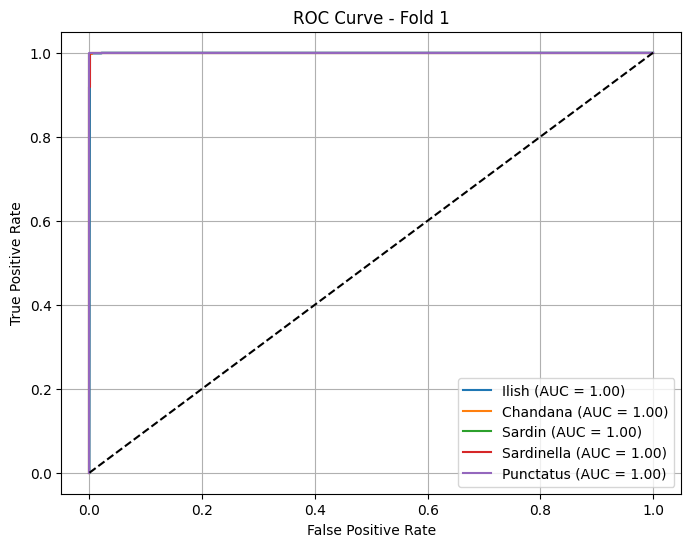

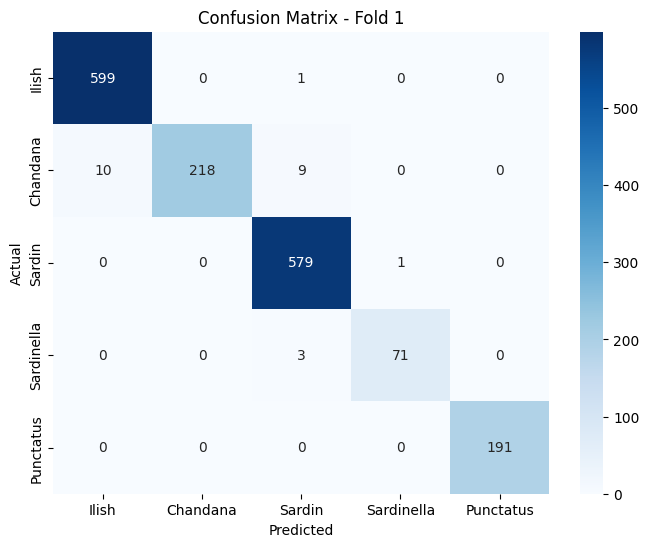

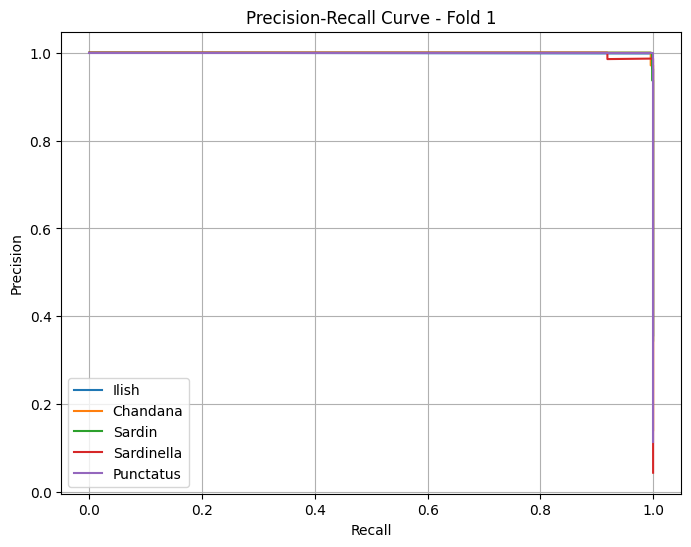

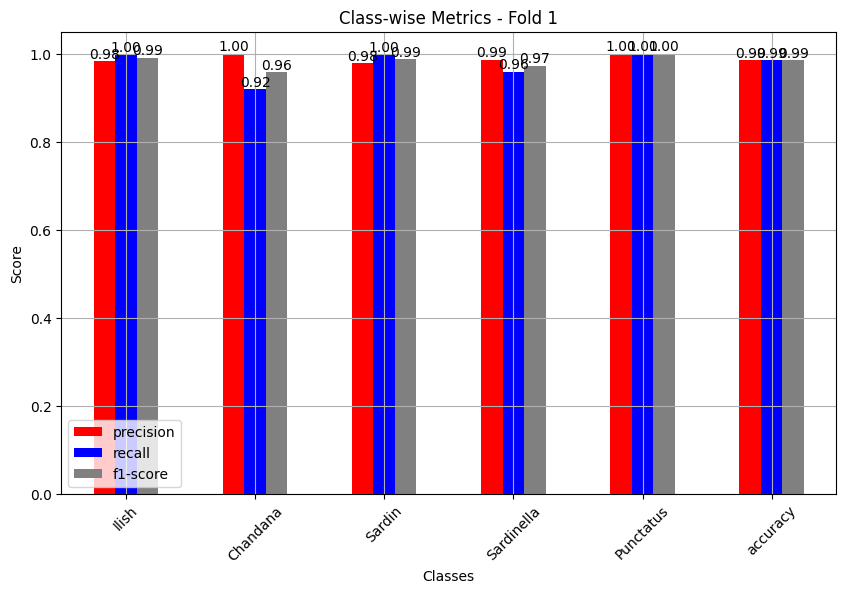

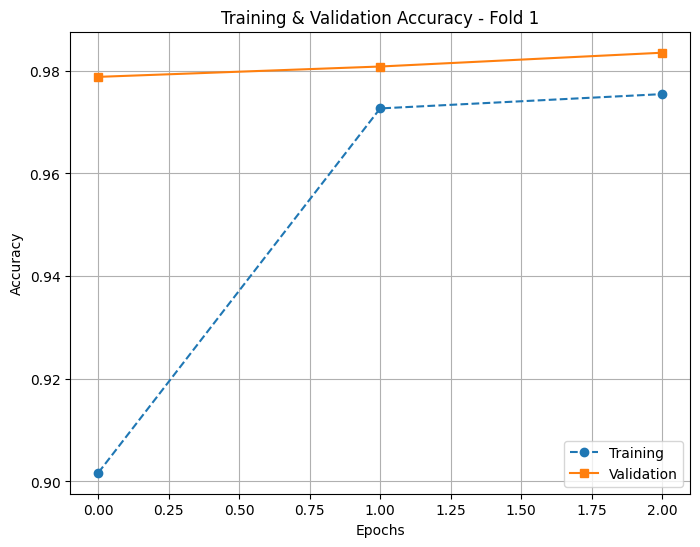

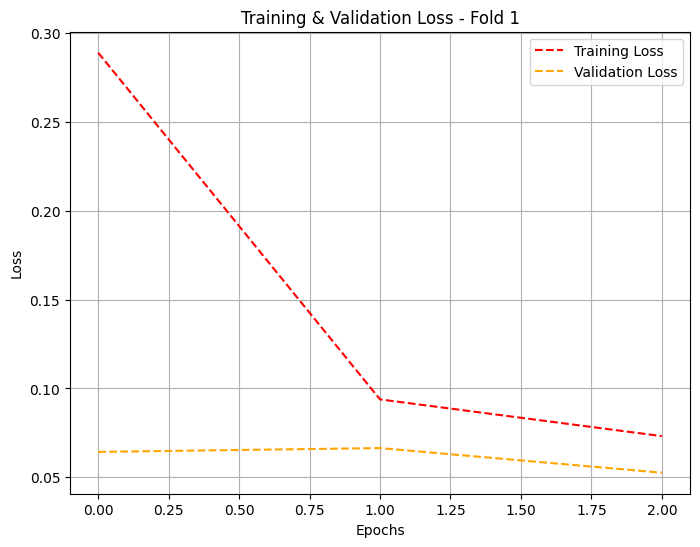

Classification Report - Fold 1:
              precision    recall  f1-score   support

       Ilish       0.98      1.00      0.99       600
    Chandana       1.00      0.92      0.96       237
      Sardin       0.98      1.00      0.99       580
  Sardinella       0.99      0.96      0.97        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           0.99      1682
   macro avg       0.99      0.98      0.98      1682
weighted avg       0.99      0.99      0.99      1682


Evaluating Fold 2:
211/211 ━━━━━━━━━━━━━━━━━━━━ 29s 87ms/step


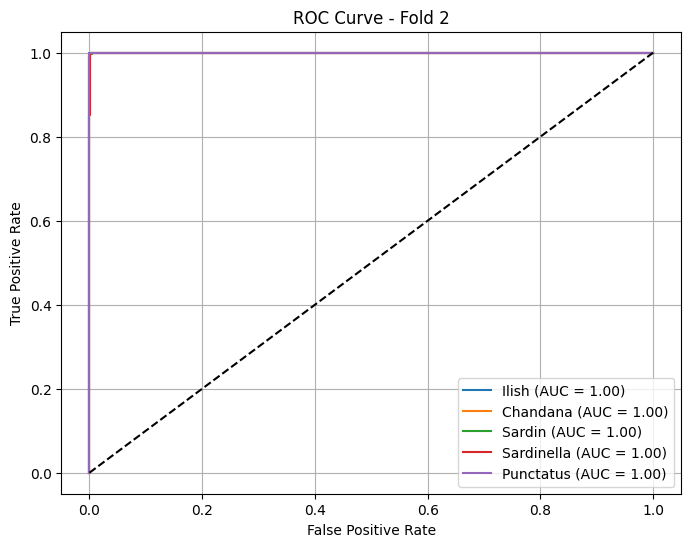

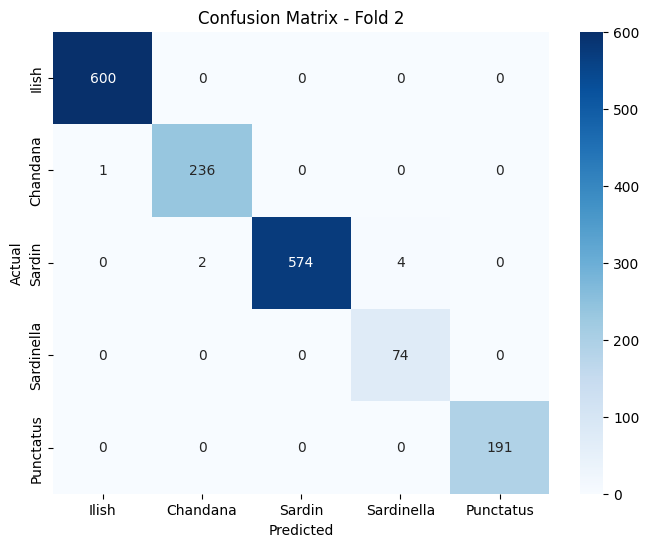

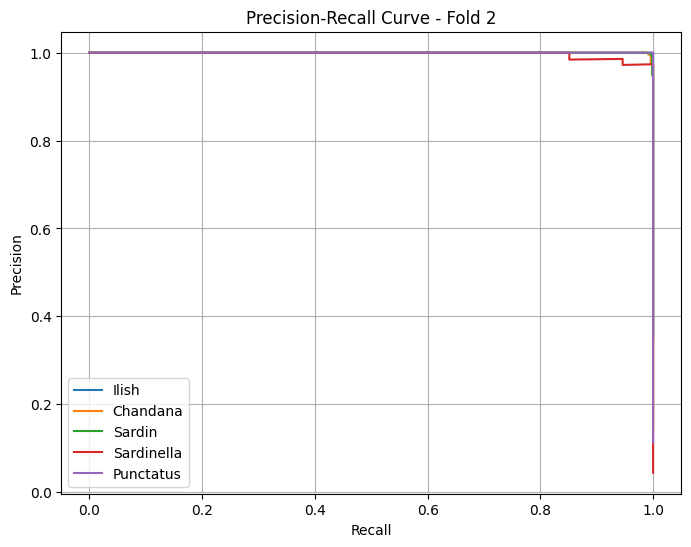

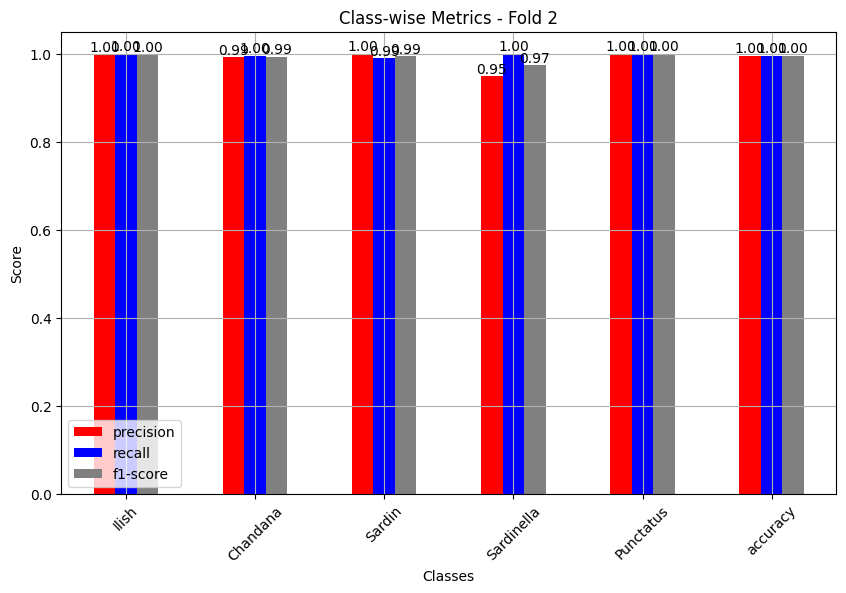

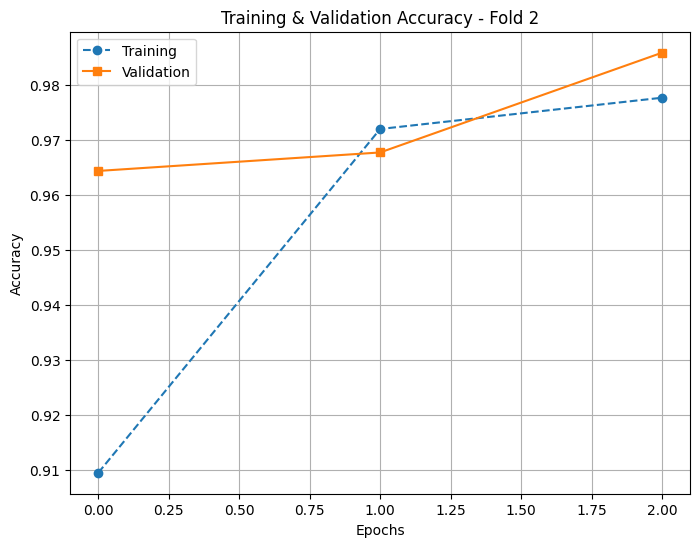

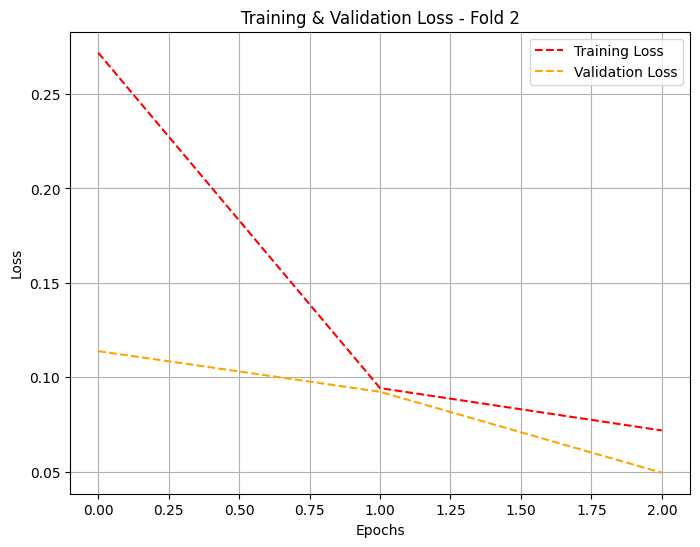

Classification Report - Fold 2:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       0.99      1.00      0.99       237
      Sardin       1.00      0.99      0.99       580
  Sardinella       0.95      1.00      0.97        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       0.99      1.00      0.99      1682
weighted avg       1.00      1.00      1.00      1682


Evaluating Fold 3:
211/211 ━━━━━━━━━━━━━━━━━━━━ 24s 67ms/step


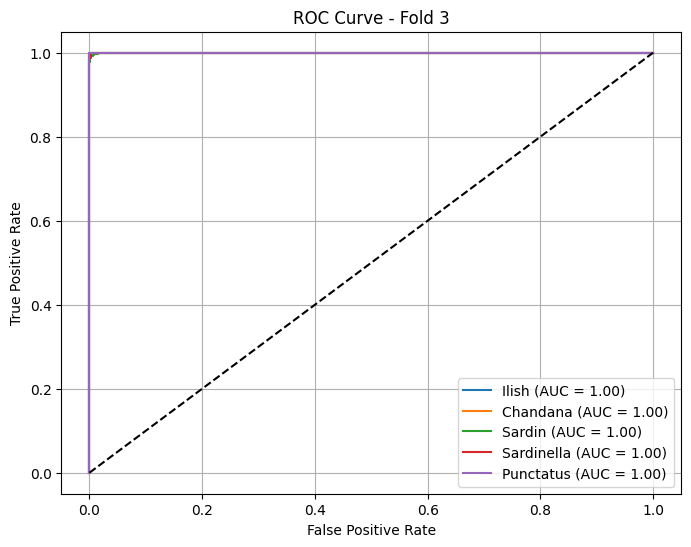

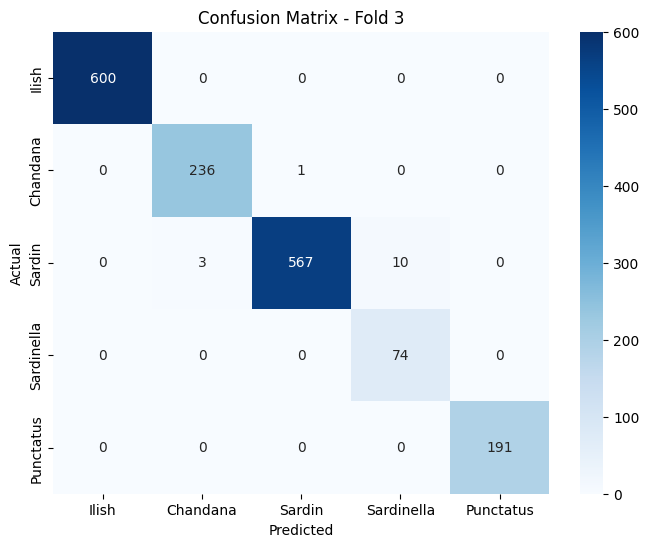

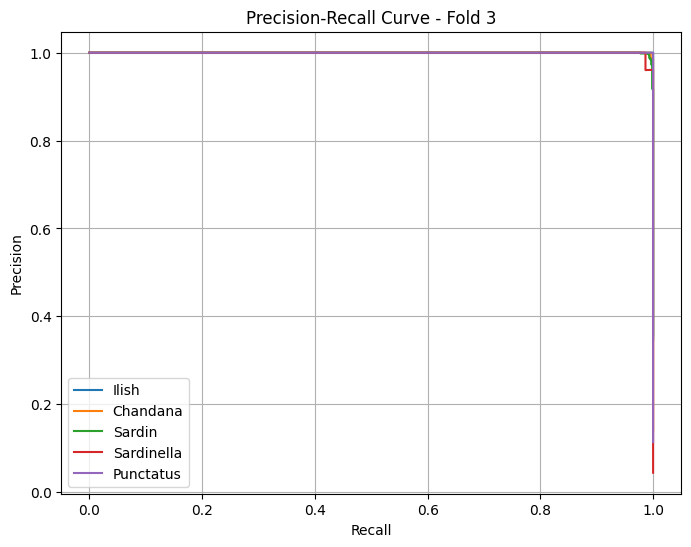

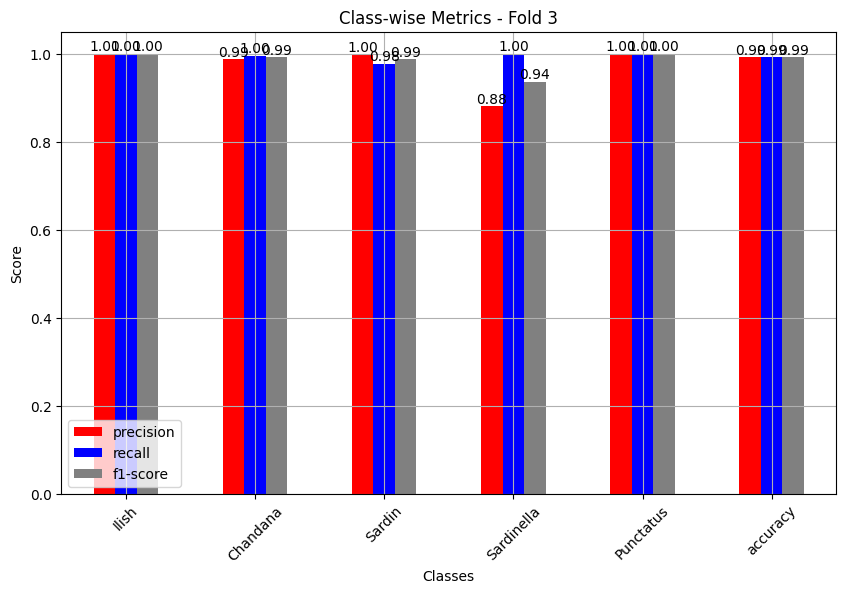

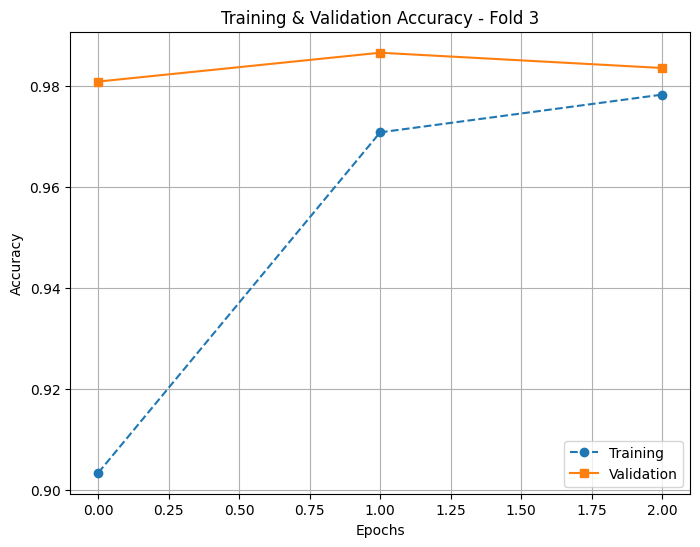

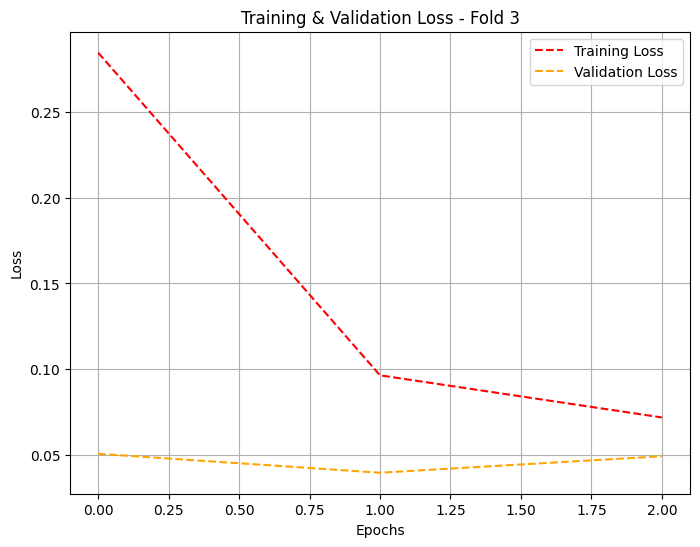

Classification Report - Fold 3:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       0.99      1.00      0.99       237
      Sardin       1.00      0.98      0.99       580
  Sardinella       0.88      1.00      0.94        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           0.99      1682
   macro avg       0.97      0.99      0.98      1682
weighted avg       0.99      0.99      0.99      1682


Evaluating Fold 4:
211/211 ━━━━━━━━━━━━━━━━━━━━ 24s 64ms/step


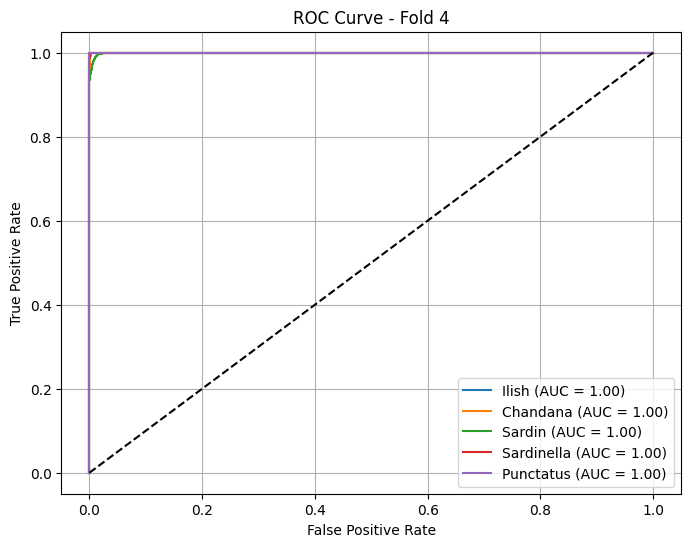

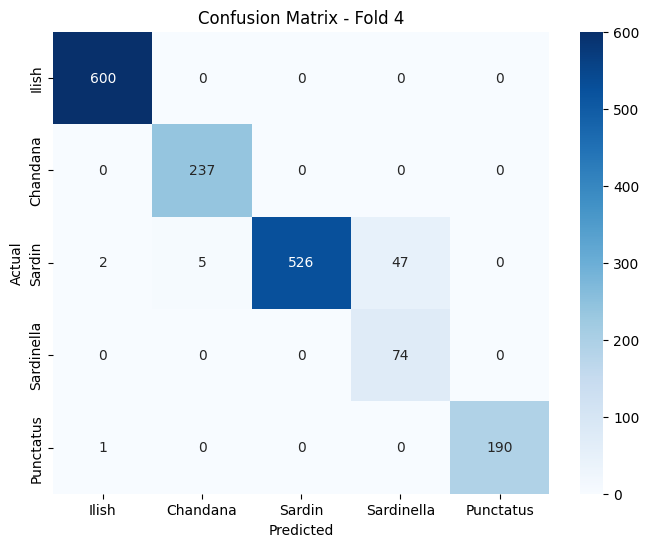

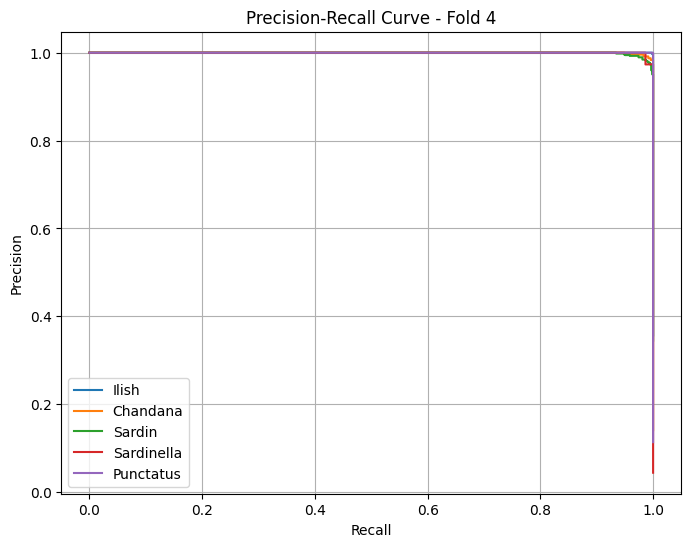

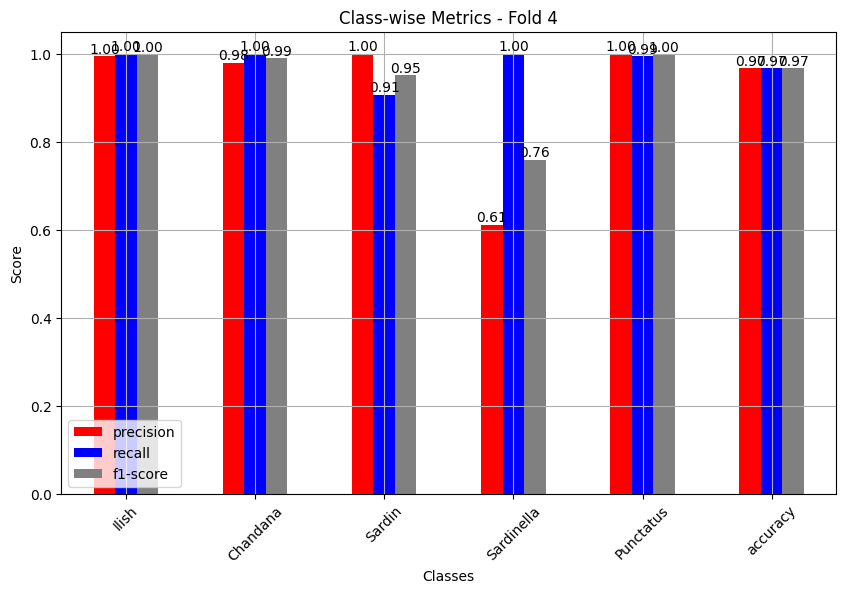

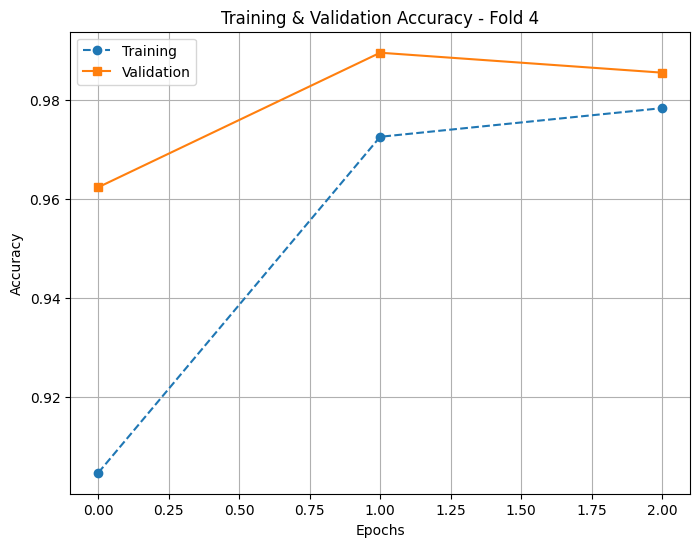

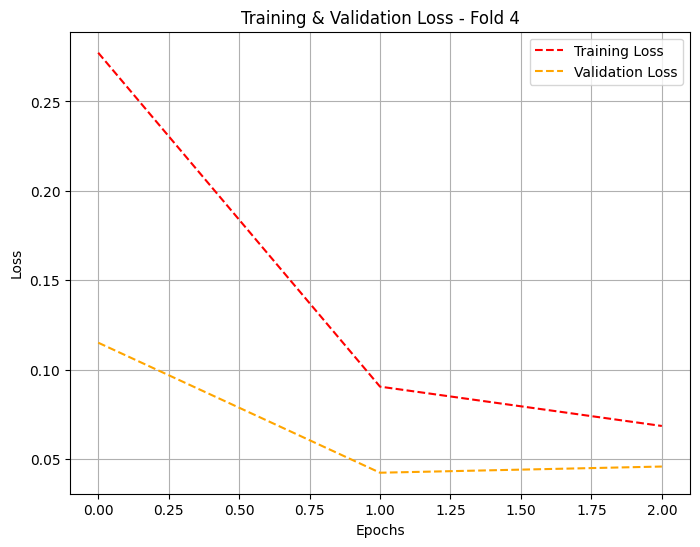

Classification Report - Fold 4:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       0.98      1.00      0.99       237
      Sardin       1.00      0.91      0.95       580
  Sardinella       0.61      1.00      0.76        74
   Punctatus       1.00      0.99      1.00       191

    accuracy                           0.97      1682
   macro avg       0.92      0.98      0.94      1682
weighted avg       0.98      0.97      0.97      1682


Combined Results for All Folds:


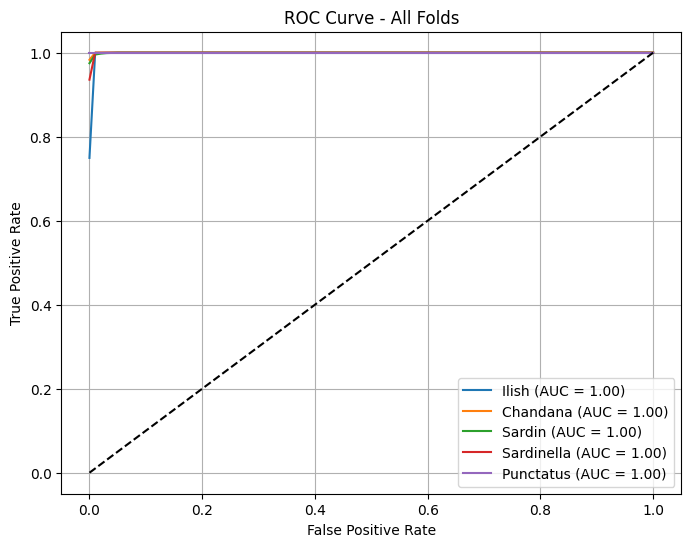

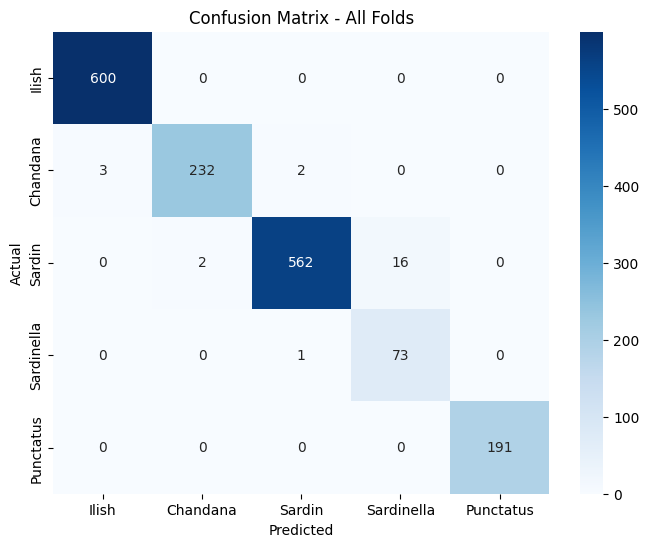

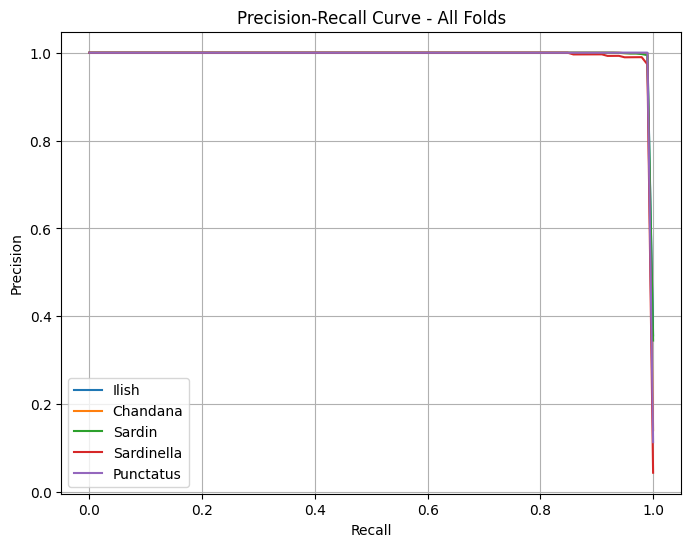

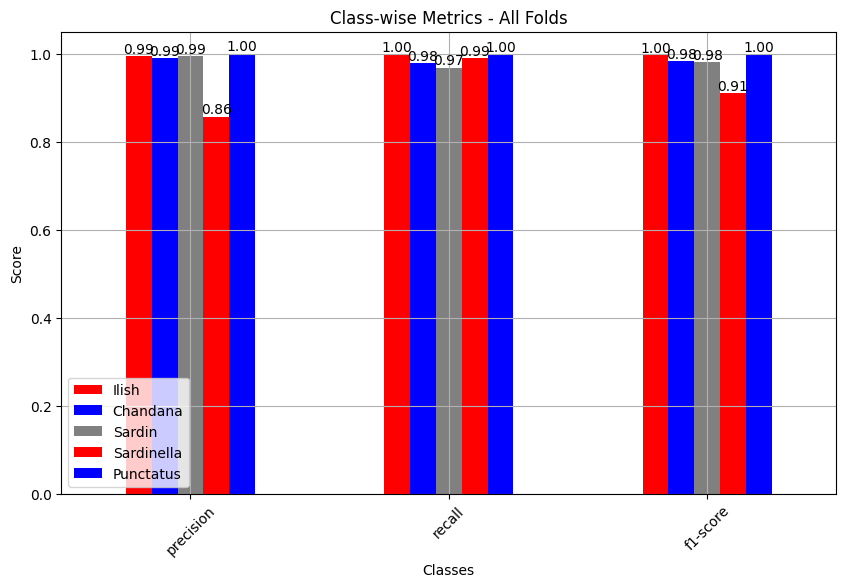

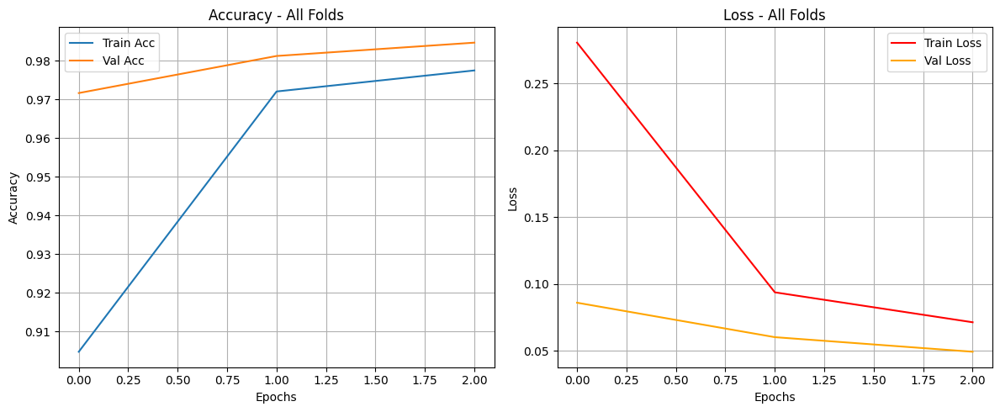


Final Combined Report (Learnable Weighted Ensemble):
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       0.99      1.00      0.99       237
      Sardin       1.00      0.99      1.00       580
  Sardinella       0.96      1.00      0.98        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       0.99      1.00      0.99      1682
weighted avg       1.00      1.00      1.00      1682

Final Accuracy: 0.9964, F1-Score: 0.9964


In [ ]:
# Install required packages
!pip install imbalanced-learn

import numpy as np
import tensorflow as tf
from tensorflow.keras.applications import ResNet50, EfficientNetB0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, Input, Lambda
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.metrics import roc_curve, auc, confusion_matrix, precision_recall_curve, classification_report, accuracy_score, f1_score
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import gc
import os
from collections import Counter

# Enable mixed precision
tf.keras.mixed_precision.set_global_policy('mixed_float16')

# Configure GPU memory growth
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    for gpu in gpus:
        tf.config.experimental.set_memory_growth(gpu, True)
    print(f"{len(gpus)} GPUs detected.")
else:
    print("No GPU detected. Running on CPU.")

# Parameters
input_shape = (224, 224, 3)
num_classes = 5
batch_size = 8
epochs = 3
k_folds = 4
class_labels = ['Ilish', 'Chandana', 'Sardin', 'Sardinella', 'Punctatus']


from google.colab import drive
drive.mount('/content/drive')

# Assuming X and Y are loaded from preprocessing
data_file = '/content/drive/MyDrive/Hilsha/X_data.npy'
labels_file = '/content/drive/MyDrive/Hilsha/Y_labels.npy'

if not (os.path.exists(data_file) and os.path.exists(labels_file)):
    raise FileNotFoundError("Preprocessed data files not found. Please preprocess the data first.")

X = np.load(data_file, mmap_mode='r')  # Memory-mapped for efficiency
Y = np.load(labels_file, mmap_mode='r')
print(f"Loaded X shape: {X.shape}, Y shape: {Y.shape}")



# Assuming X and Y are loaded
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=42)

# Normalize in batches (commented out)
# def normalize_in_batches(data, batch_size=1000):
#     data = data.astype('float32')
#     for i in range(0, len(data), batch_size):
#         data[i:min(i + batch_size, len(data))] /= 255.0
#     return data

# X_train_scaled = normalize_in_batches(X_train)
# X_test_scaled = normalize_in_batches(X_test)
X_train_scaled = X_train  # Use raw data as-is
X_test_scaled = X_test    # Use raw data as-is

# Apply SMOTE
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_train_resampled, Y_train_resampled = smote.fit_resample(X_train_scaled.reshape(X_train_scaled.shape[0], -1), Y_train)
X_train_resampled = X_train_resampled.reshape(-1, 224, 224, 3)
print("Class distribution after SMOTE:", Counter(Y_train_resampled))

# Image Augmentation
datagen = ImageDataGenerator(rotation_range=20, width_shift_range=0.2, height_shift_range=0.2, shear_range=0.2,
                             zoom_range=0.2, horizontal_flip=True, fill_mode="nearest")

def batch_generator(X, Y, batch_size=32):
    size = X.shape[0]
    while True:
        indices = np.random.permutation(size)
        for start in range(0, size, batch_size):
            batch_idx = indices[start:min(start + batch_size, size)]
            X_batch, Y_batch = X[batch_idx], Y[batch_idx]
            augmented_images = next(datagen.flow(X_batch, shuffle=False, batch_size=batch_size))
            yield augmented_images, Y_batch  # Sparse labels for sparse_categorical_crossentropy

# Define Base Models
def create_base_model(input_shape=(224, 224, 3), model_type='ResNet'):
    base = ResNet50(weights='imagenet', include_top=False, input_shape=input_shape) if model_type == 'ResNet' else EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape)
    for layer in base.layers[:-5]:
        layer.trainable = False
    for layer in base.layers[-5:]:
        layer.trainable = True
    return base

# Define Ensemble Model with Fixed Shape and Type Correction
def create_ensemble_model(input_shape=(224, 224, 3), num_classes=5):
    # Create base models
    model1 = create_base_model(input_shape, model_type='ResNet')
    model2 = create_base_model(input_shape, model_type='EfficientNet')

    # Rename layers to avoid name clashes
    for layer in model1.layers:
        layer._name = f"resnet_{layer.name}"
    for layer in model2.layers:
        layer._name = f"efficientnet_{layer.name}"

    input_layer = Input(shape=input_shape)
    output1 = model1(input_layer)
    output2 = model2(input_layer)

    output1 = GlobalAveragePooling2D()(output1)  # Shape: (None, 2048) for ResNet50
    output2 = GlobalAveragePooling2D()(output2)  # Shape: (None, 1280) for EfficientNetB0

    # Project both outputs to a common dimension (e.g., 1280)
    output1 = Dense(1280, activation='relu')(output1)  # Outputs float32 by default
    output2 = Dense(1280, activation='relu')(output2)  # Outputs float32 by default

    # # Cast outputs to float16 to match alpha and mixed precision policy
    # output1 = tf.cast(output1, tf.float16)
    # output2 = tf.cast(output2, tf.float16)

    # Cast outputs to float16 using Lambda layer to match alpha and mixed precision policy
    output1 = Lambda(lambda x: tf.cast(x, tf.float16))(output1)
    output2 = Lambda(lambda x: tf.cast(x, tf.float16))(output2)

    # alpha = tf.Variable(0.5, trainable=True, dtype=tf.float16, name="alpha")
    # ensemble_output = Lambda(lambda x: alpha * x[0] + (1 - alpha) * x[1],
    #                          output_shape=(1280,))([output1, output2])

    alpha = tf.Variable(0.5, trainable=True, dtype=tf.float16, name="alpha")
    ensemble_output = Lambda(lambda x: alpha * tf.cast(x[0], tf.float16) + (1 - alpha) * tf.cast(x[1], tf.float16),
                         output_shape=(1280,))([output1, output2])

    x = Dense(128, activation='relu')(ensemble_output)
    x = Dropout(0.5)(x)
    final_output = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=input_layer, outputs=final_output)
    model.compile(optimizer=Adam(learning_rate=0.001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

# K-Fold Training
def train_with_kfold(X_train, Y_train, X_test, Y_test, k=4, batch_size=32, epochs=3):
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
    histories = []
    trained_models = []

    with tf.device('/GPU:0'):
        for fold_no, (train_idx, val_idx) in enumerate(skf.split(X_train, Y_train), 1):
            print(f"Training Fold {fold_no}/{k}")
            X_train_fold, X_val_fold = X_train[train_idx], X_train[val_idx]
            Y_train_fold, Y_val_fold = Y_train[train_idx], Y_train[val_idx]

            ensemble_model = create_ensemble_model(input_shape, num_classes)

            train_gen = batch_generator(X_train_fold, Y_train_fold, batch_size)
            val_gen = batch_generator(X_val_fold, Y_val_fold, batch_size)

            callbacks = [
                ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2),
                ModelCheckpoint(f'best_ensemble_model_{fold_no}.weights.h5', save_best_only=True,
                                monitor='val_accuracy', mode='max', save_weights_only=True),
                EarlyStopping(monitor='val_accuracy', patience=3, restore_best_weights=True)
            ]

            history = ensemble_model.fit(train_gen, validation_data=val_gen, epochs=epochs,
                                         steps_per_epoch=len(X_train_fold)//batch_size,
                                         validation_steps=len(X_val_fold)//batch_size, callbacks=callbacks, verbose=1)

            histories.append(history)
            trained_models.append(ensemble_model)

            tf.keras.backend.clear_session()
            gc.collect()

    return histories, trained_models

# Evaluation and Plotting
def evaluate_and_plot(histories, X_test, Y_test, trained_models):
    ensemble_probs_list, ensemble_preds_list = [], []

    with tf.device('/GPU:0'):
        # Fold-wise Visualization
        print("\nFold-by-Fold Visualizations:")
        for fold_no, (model, history) in enumerate(zip(trained_models, histories), 1):
            print(f"\nEvaluating Fold {fold_no}:")
            probs = model.predict(X_test, batch_size=8)
            preds = np.argmax(probs, axis=1)
            ensemble_probs_list.append(probs)
            ensemble_preds_list.append(preds)

            # Fold-wise Plots
            def plot_roc_fold(Y_test, probs, fold_no):
                plt.figure(figsize=(8, 6))
                for i, cls in enumerate(class_labels):
                    fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                    roc_auc = auc(fpr, tpr)
                    plt.plot(fpr, tpr, label=f'{cls} (AUC = {roc_auc:.2f})')
                plt.plot([0, 1], [0, 1], 'k--')
                plt.title(f'ROC Curve - Fold {fold_no}')
                plt.xlabel('False Positive Rate')
                plt.ylabel('True Positive Rate')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_confusion_fold(Y_test, preds, fold_no):
                cm = confusion_matrix(Y_test, preds)
                plt.figure(figsize=(8, 6))
                sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
                plt.title(f'Confusion Matrix - Fold {fold_no}')
                plt.xlabel('Predicted')
                plt.ylabel('Actual')
                plt.show()

            def plot_pr_fold(Y_test, probs, fold_no):
                plt.figure(figsize=(8, 6))
                for i, cls in enumerate(class_labels):
                    precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                    plt.plot(recall, precision, label=cls)
                plt.title(f'Precision-Recall Curve - Fold {fold_no}')
                plt.xlabel('Recall')
                plt.ylabel('Precision')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_metrics_fold(Y_test, preds, fold_no):
                report = classification_report(Y_test, preds, target_names=class_labels, output_dict=True)
                df = pd.DataFrame(report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]
                df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
                for p in plt.gca().patches:
                    plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
                plt.title(f'Class-wise Metrics - Fold {fold_no}')
                plt.xlabel('Classes')
                plt.ylabel('Score')
                plt.xticks(rotation=45)
                plt.legend()
                plt.grid()
                plt.show()

            def plot_acc_fold(history, fold_no):
                plt.figure(figsize=(8, 6))
                plt.plot(history.history['accuracy'], label='Training', linestyle='dashed', marker='o')
                plt.plot(history.history['val_accuracy'], label='Validation', marker='s')
                plt.title(f'Training & Validation Accuracy - Fold {fold_no}')
                plt.xlabel('Epochs')
                plt.ylabel('Accuracy')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_loss_fold(history, fold_no):
                plt.figure(figsize=(8, 6))
                plt.plot(history.history['loss'], label='Training Loss', linestyle='dashed', color='red')
                plt.plot(history.history['val_loss'], label='Validation Loss', linestyle='dashed', color='orange')
                plt.title(f'Training & Validation Loss - Fold {fold_no}')
                plt.xlabel('Epochs')
                plt.ylabel('Loss')
                plt.legend()
                plt.grid()
                plt.show()

            def print_report_fold(Y_test, preds, fold_no):
                report = classification_report(Y_test, preds, target_names=class_labels)
                print(f"Classification Report - Fold {fold_no}:\n{report}")

            # Execute Fold-wise Plots
            plot_roc_fold(Y_test, probs, fold_no)
            plot_confusion_fold(Y_test, preds, fold_no)
            plot_pr_fold(Y_test, probs, fold_no)
            plot_metrics_fold(Y_test, preds, fold_no)
            plot_acc_fold(history, fold_no)
            plot_loss_fold(history, fold_no)
            print_report_fold(Y_test, preds, fold_no)

            tf.keras.backend.clear_session()
            gc.collect()

        # Combined Visualizations
        print("\nCombined Results for All Folds:")
        def plot_roc_combined(Y_test, probs_list):
            plt.figure(figsize=(8, 6))
            mean_fpr = np.linspace(0, 1, 100)
            for i, cls in enumerate(class_labels):
                tprs, aucs = [], []
                for probs in probs_list:
                    fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                    tprs.append(np.interp(mean_fpr, fpr, tpr))
                    aucs.append(auc(fpr, tpr))
                mean_tpr = np.mean(tprs, axis=0)
                mean_auc = auc(mean_fpr, mean_tpr)
                plt.plot(mean_fpr, mean_tpr, label=f'{cls} (AUC = {mean_auc:.2f})')
            plt.plot([0, 1], [0, 1], 'k--')
            plt.title('ROC Curve - All Folds')
            plt.xlabel('False Positive Rate')
            plt.ylabel('True Positive Rate')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_confusion_combined(Y_test, preds_list):
            mean_cm = np.mean([confusion_matrix(Y_test, preds) for preds in preds_list], axis=0)
            plt.figure(figsize=(8, 6))
            sns.heatmap(mean_cm, annot=True, fmt='.0f', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
            plt.title('Confusion Matrix - All Folds')
            plt.xlabel('Predicted')
            plt.ylabel('Actual')
            plt.show()

        def plot_pr_combined(Y_test, probs_list):
            plt.figure(figsize=(8, 6))
            mean_recall = np.linspace(0, 1, 100)
            for i, cls in enumerate(class_labels):
                precisions = []
                for probs in probs_list:
                    precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                    precisions.append(np.interp(mean_recall[::-1], recall[::-1], precision[::-1])[::-1])
                mean_precision = np.mean(precisions, axis=0)
                plt.plot(mean_recall, mean_precision, label=cls)
            plt.title('Precision-Recall Curve - All Folds')
            plt.xlabel('Recall')
            plt.ylabel('Precision')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_metrics_combined(Y_test, preds_list):
            reports = [classification_report(Y_test, preds, target_names=class_labels, output_dict=True) for preds in preds_list]
            mean_report = {metric: {cls: np.mean([r[cls][metric] for r in reports]) for cls in class_labels}
                           for metric in ['precision', 'recall', 'f1-score']}
            df = pd.DataFrame(mean_report).T
            df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
            for p in plt.gca().patches:
                plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
            plt.title('Class-wise Metrics - All Folds')
            plt.xlabel('Classes')
            plt.ylabel('Score')
            plt.xticks(rotation=45)
            plt.legend()
            plt.grid()
            plt.show()

        def plot_acc_loss_combined(histories):
            plt.figure(figsize=(12, 5))
            mean_acc = np.mean([h.history['accuracy'] for h in histories], axis=0)
            mean_val_acc = np.mean([h.history['val_accuracy'] for h in histories], axis=0)
            mean_loss = np.mean([h.history['loss'] for h in histories], axis=0)
            mean_val_loss = np.mean([h.history['val_loss'] for h in histories], axis=0)
            plt.subplot(1, 2, 1)
            plt.plot(mean_acc, label='Train Acc')
            plt.plot(mean_val_acc, label='Val Acc')
            plt.title('Accuracy - All Folds')
            plt.xlabel('Epochs')
            plt.ylabel('Accuracy')
            plt.legend()
            plt.grid()
            plt.subplot(1, 2, 2)
            plt.plot(mean_loss, label='Train Loss', color='red')
            plt.plot(mean_val_loss, label='Val Loss', color='orange')
            plt.title('Loss - All Folds')
            plt.xlabel('Epochs')
            plt.ylabel('Loss')
            plt.legend()
            plt.grid()
            plt.tight_layout()
            plt.show()

        def print_final_report(Y_test, probs_list):
            mean_probs = np.mean(probs_list, axis=0)
            final_preds = np.argmax(mean_probs, axis=1)
            report = classification_report(Y_test, final_preds, target_names=class_labels)
            acc = accuracy_score(Y_test, final_preds)
            f1 = f1_score(Y_test, final_preds, average='weighted')
            print(f"\nFinal Combined Report (Learnable Weighted Ensemble):\n{report}")
            print(f"Final Accuracy: {acc:.4f}, F1-Score: {f1:.4f}")

        # Execute Combined Plots
        plot_roc_combined(Y_test, ensemble_probs_list)
        plot_confusion_combined(Y_test, ensemble_preds_list)
        plot_pr_combined(Y_test, ensemble_probs_list)
        plot_metrics_combined(Y_test, ensemble_preds_list)
        plot_acc_loss_combined(histories)
        print_final_report(Y_test, ensemble_probs_list)

# Train and Evaluate
histories, trained_models = train_with_kfold(X_train_resampled, Y_train_resampled, X_test_scaled, Y_test)
print("Training Complete with Learnable Weighted Ensemble.")
evaluate_and_plot(histories, X_test_scaled, Y_test, trained_models)

1 GPUs detected.
Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Loaded X shape: (8407, 224, 224, 3), Y shape: (8407,)
Class distribution after SMOTE: Counter({np.int32(1): 2400, np.int32(0): 2400, np.int32(3): 2400, np.int32(2): 2400, np.int32(4): 2400})
Training Fold 1/3
Epoch 1/3
250/250 ━━━━━━━━━━━━━━━━━━━━ 170s 533ms/step - accuracy: 0.7989 - loss: 0.5481 - val_accuracy: 0.9482 - val_loss: 0.1736 - learning_rate: 0.0010
Epoch 2/3
250/250 ━━━━━━━━━━━━━━━━━━━━ 119s 480ms/step - accuracy: 0.9653 - loss: 0.1117 - val_accuracy: 0.9768 - val_loss: 0.0765 - learning_rate: 0.0010
Epoch 3/3
250/250 ━━━━━━━━━━━━━━━━━━━━ 119s 478ms/step - accuracy: 0.9780 - loss: 0.0734 - val_accuracy: 0.9803 - val_loss: 0.0757 - learning_rate: 0.0010
Training Fold 2/3
Epoch 1/3
250/250 ━━━━━━━━━━━━━━━━━━━━ 166s 529ms/step - accuracy: 0.8097 - loss: 0.5214 - val_accuracy: 0.9680 - val_loss: 0.0932 - learning_rate: 0.0010
Epoch 2

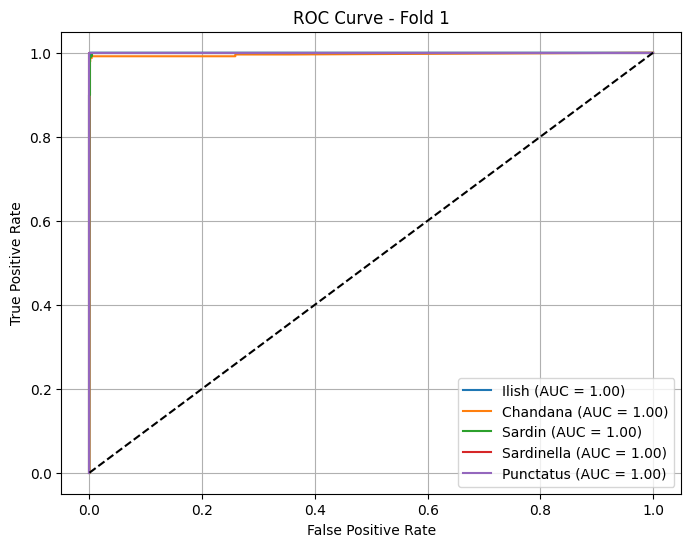

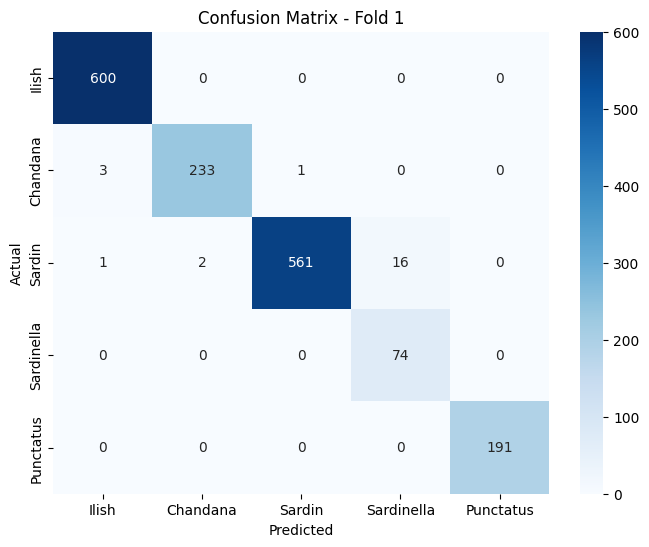

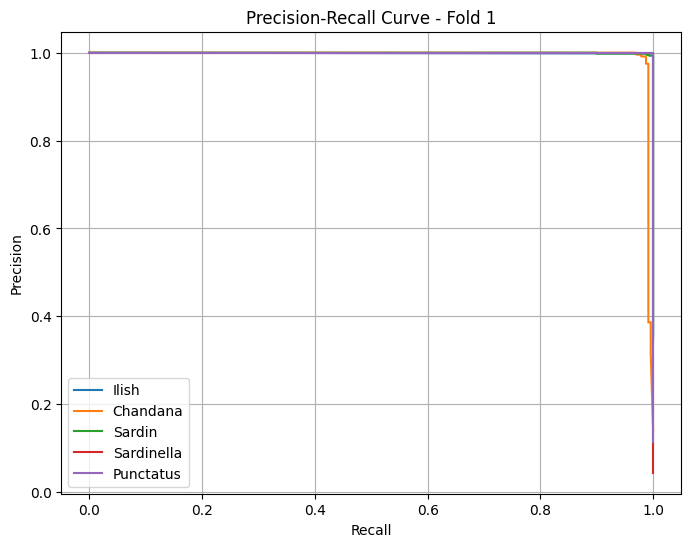

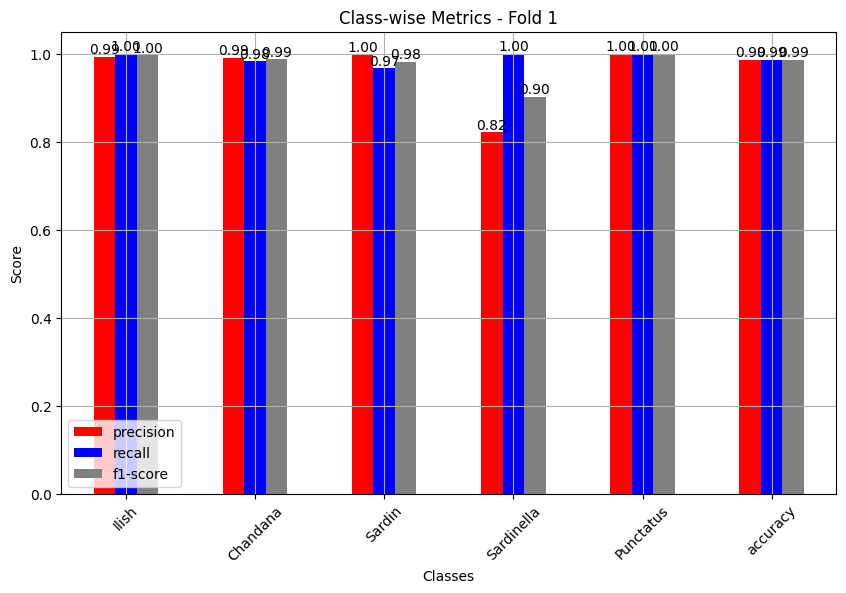

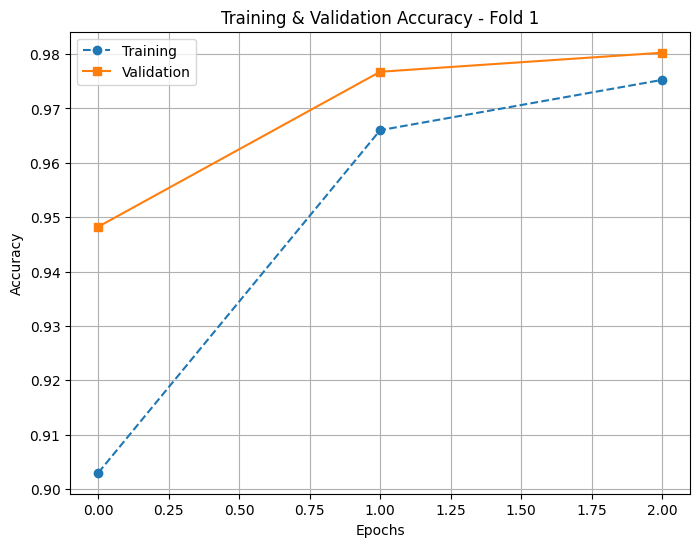

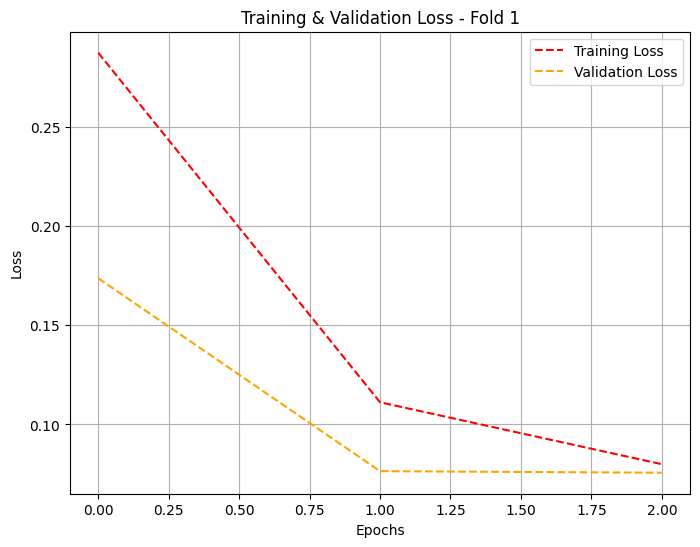

Classification Report - Fold 1:
              precision    recall  f1-score   support

       Ilish       0.99      1.00      1.00       600
    Chandana       0.99      0.98      0.99       237
      Sardin       1.00      0.97      0.98       580
  Sardinella       0.82      1.00      0.90        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           0.99      1682
   macro avg       0.96      0.99      0.97      1682
weighted avg       0.99      0.99      0.99      1682


Evaluating Fold 2:
211/211 ━━━━━━━━━━━━━━━━━━━━ 24s 68ms/step


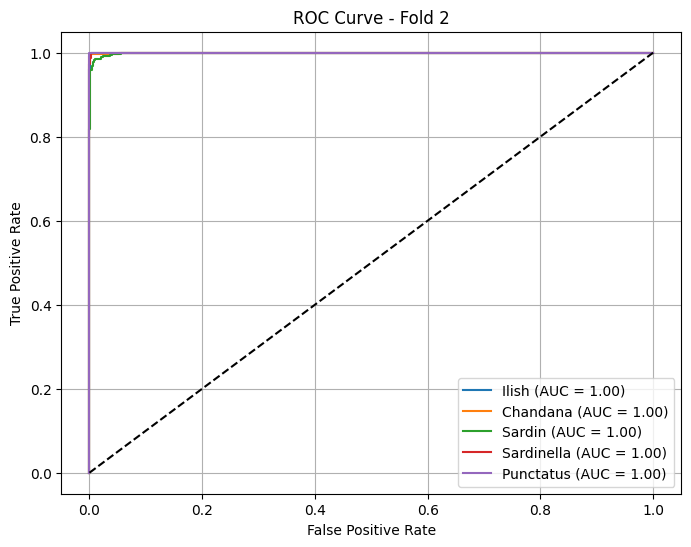

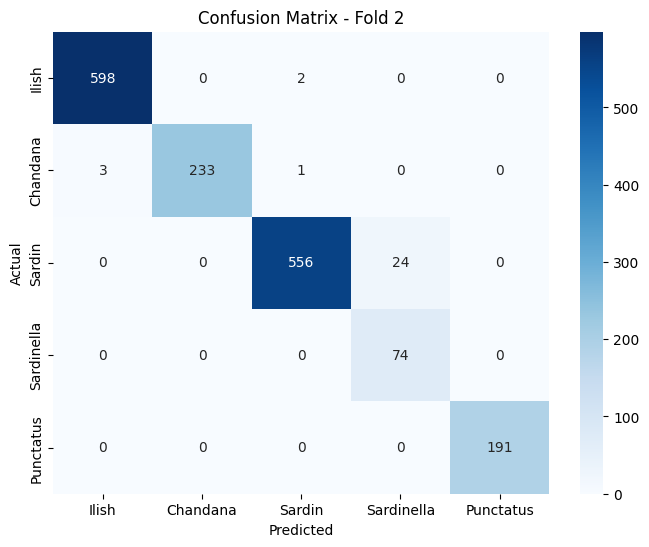

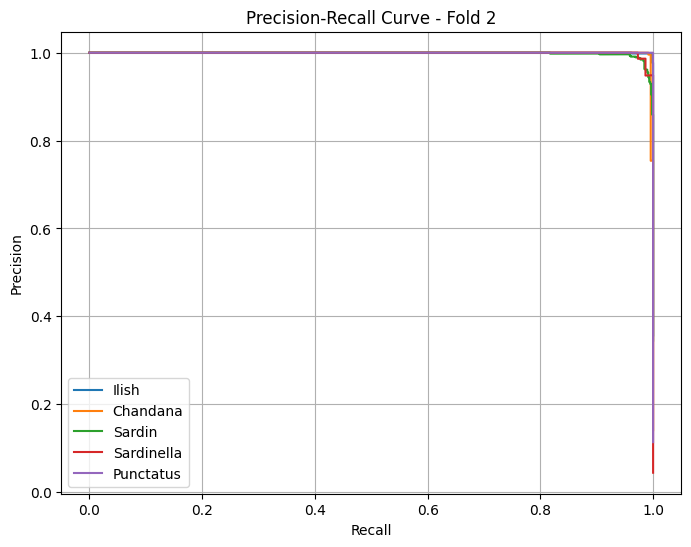

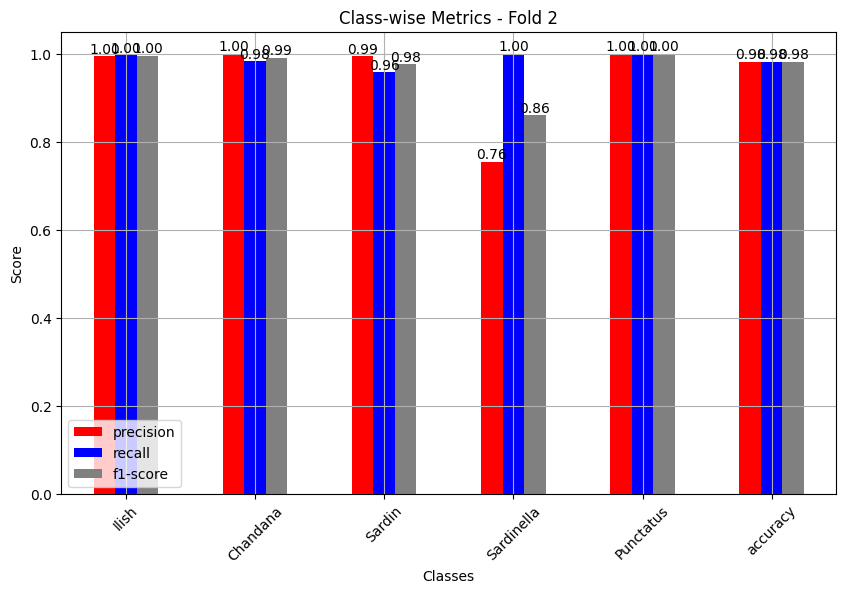

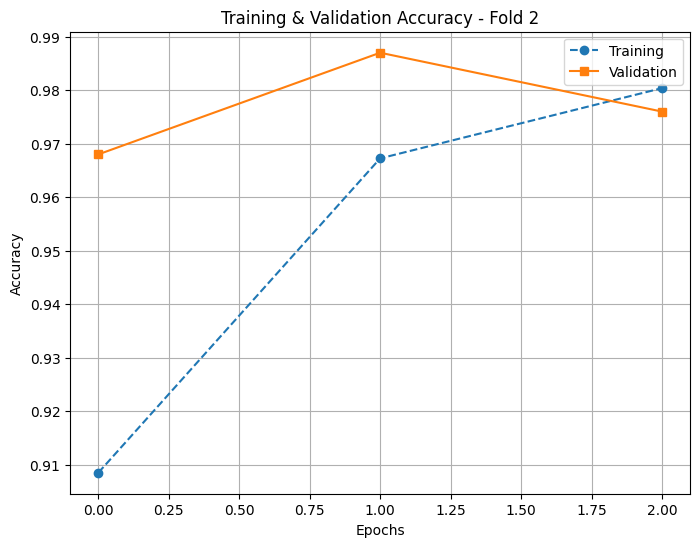

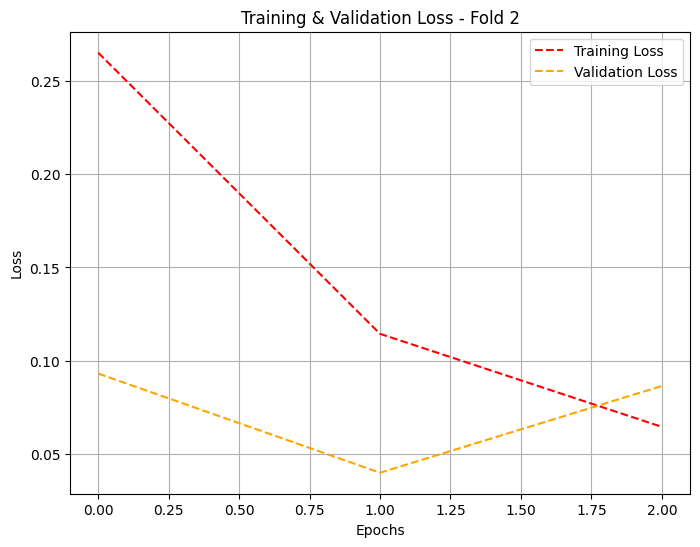

Classification Report - Fold 2:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      0.98      0.99       237
      Sardin       0.99      0.96      0.98       580
  Sardinella       0.76      1.00      0.86        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           0.98      1682
   macro avg       0.95      0.99      0.96      1682
weighted avg       0.99      0.98      0.98      1682


Evaluating Fold 3:
211/211 ━━━━━━━━━━━━━━━━━━━━ 25s 67ms/step


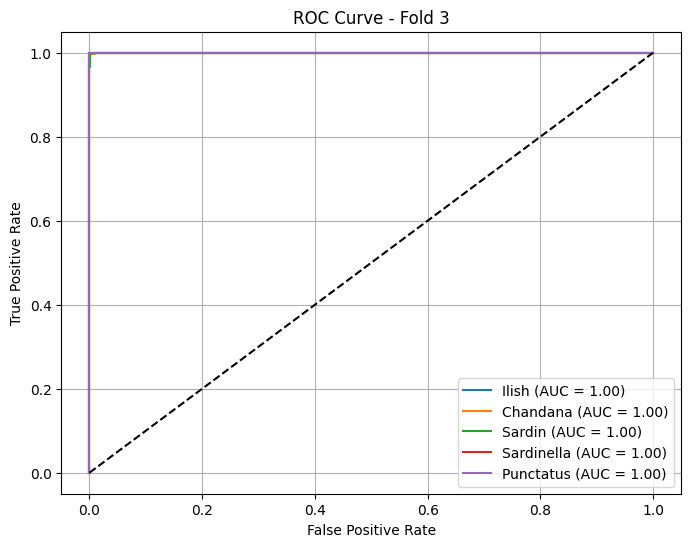

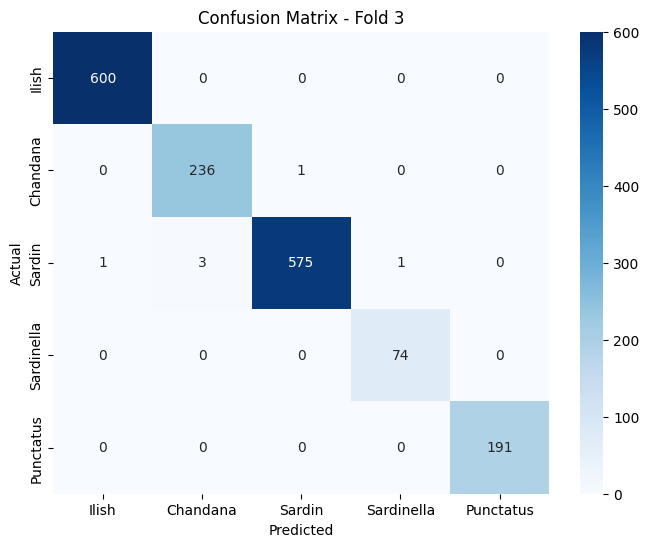

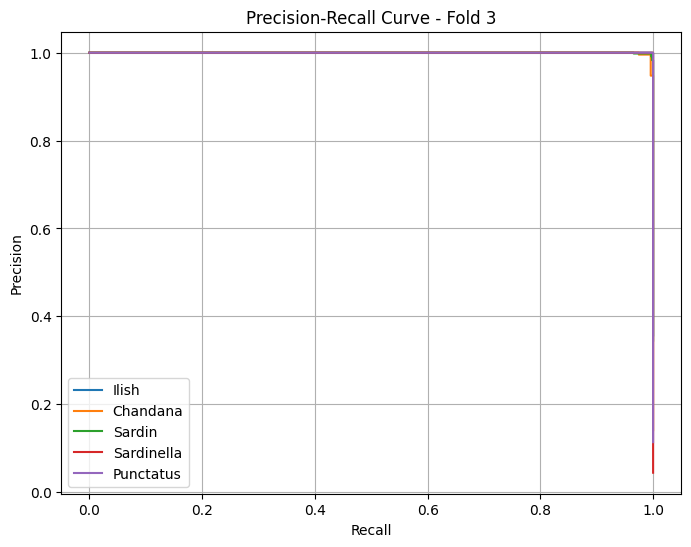

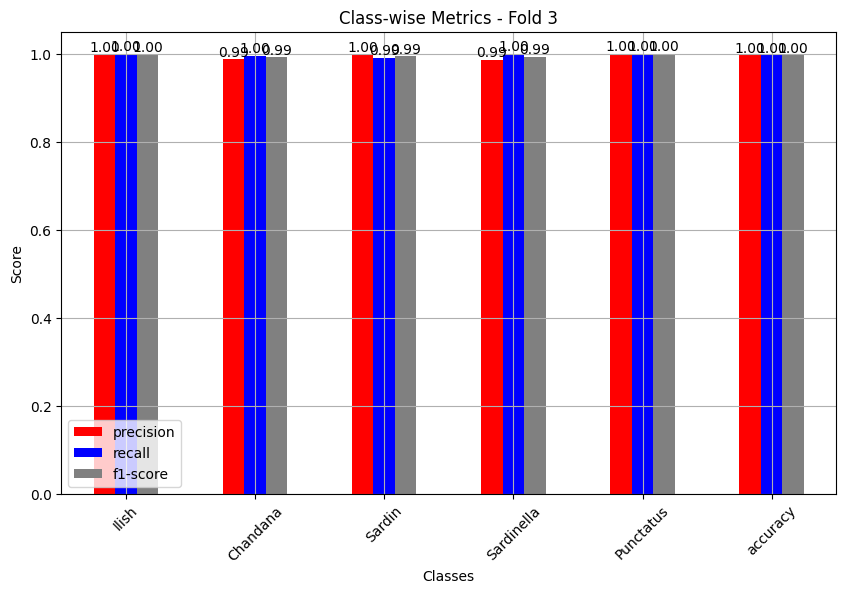

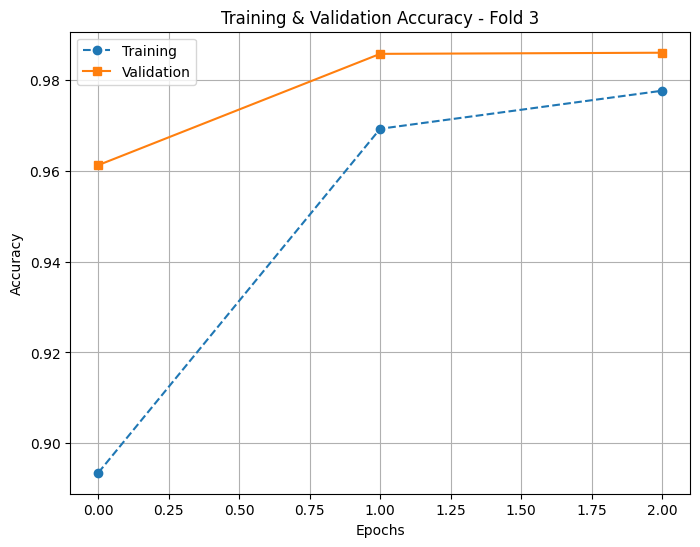

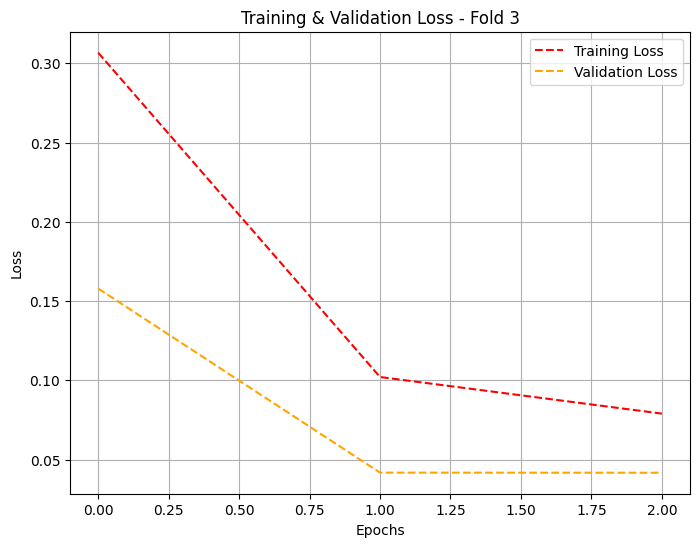

Classification Report - Fold 3:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       0.99      1.00      0.99       237
      Sardin       1.00      0.99      0.99       580
  Sardinella       0.99      1.00      0.99        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       0.99      1.00      1.00      1682
weighted avg       1.00      1.00      1.00      1682


Combined Results for All Folds:


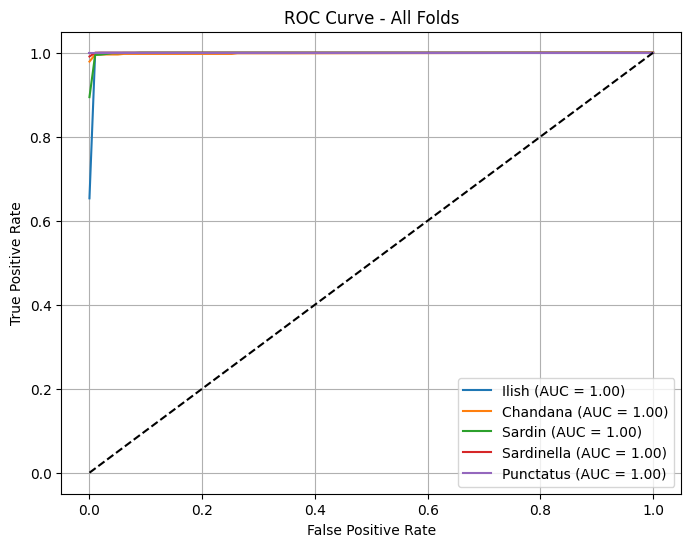

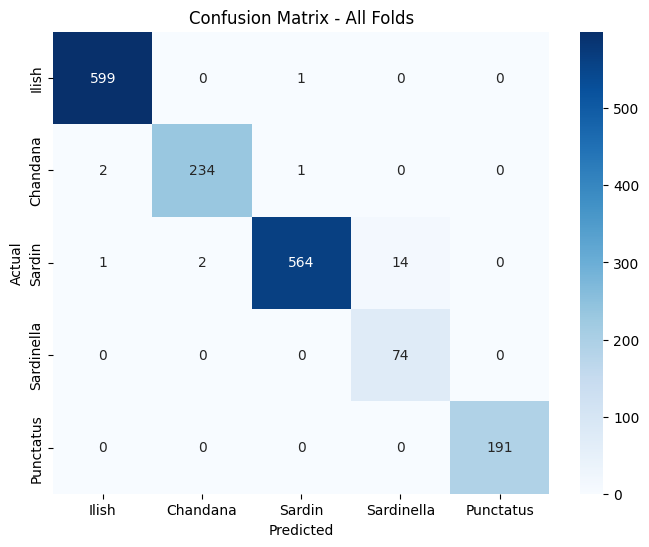

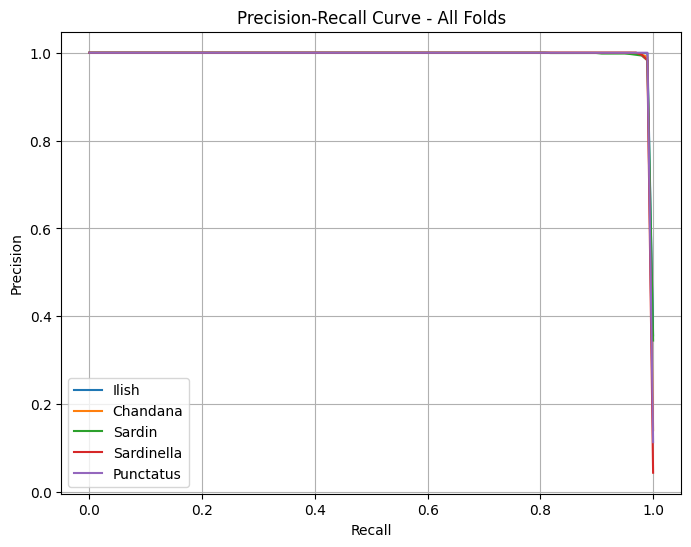

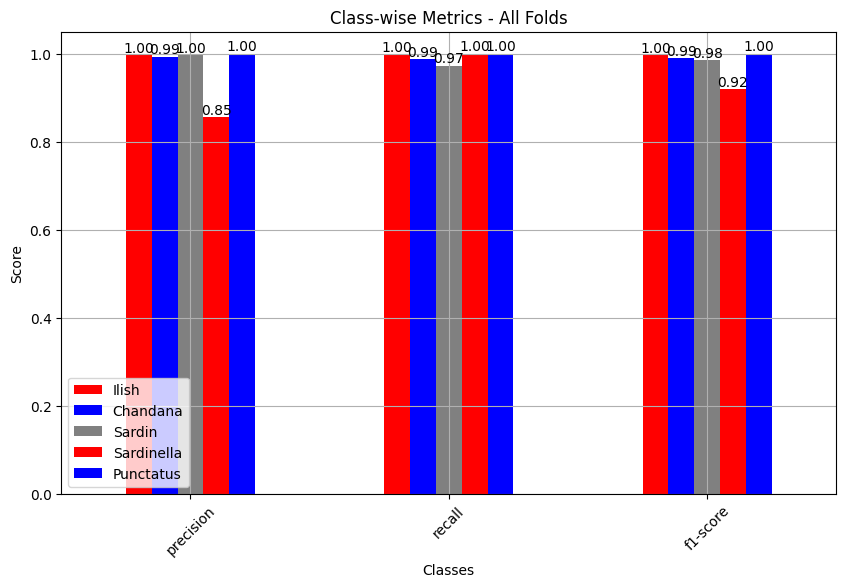

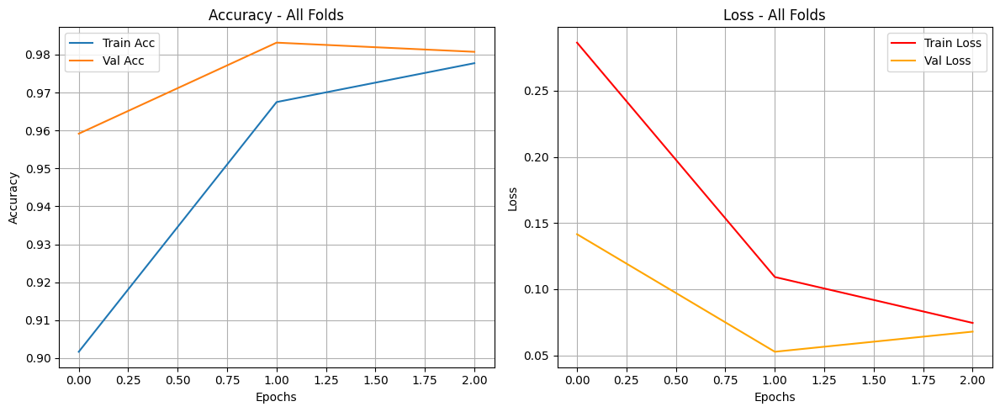


Final Combined Report (Learnable Weighted Ensemble):
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      0.99      1.00       237
      Sardin       1.00      0.98      0.99       580
  Sardinella       0.89      1.00      0.94        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           0.99      1682
   macro avg       0.98      1.00      0.99      1682
weighted avg       0.99      0.99      0.99      1682

Final Accuracy: 0.9935, F1-Score: 0.9936


In [ ]:
# Install required packages
!pip install imbalanced-learn

import numpy as np
import tensorflow as tf
from tensorflow.keras.applications import ResNet50, EfficientNetB0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, Input, Lambda
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.metrics import roc_curve, auc, confusion_matrix, precision_recall_curve, classification_report, accuracy_score, f1_score
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import gc
import os
from collections import Counter

# Enable mixed precision
tf.keras.mixed_precision.set_global_policy('mixed_float16')

# Configure GPU memory growth
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    for gpu in gpus:
        tf.config.experimental.set_memory_growth(gpu, True)
    print(f"{len(gpus)} GPUs detected.")
else:
    print("No GPU detected. Running on CPU.")

# Parameters
input_shape = (224, 224, 3)
num_classes = 5
batch_size = 8
epochs = 3
k_folds = 3
class_labels = ['Ilish', 'Chandana', 'Sardin', 'Sardinella', 'Punctatus']


from google.colab import drive
drive.mount('/content/drive')

# Assuming X and Y are loaded from preprocessing
data_file = '/content/drive/MyDrive/Hilsha/X_data.npy'
labels_file = '/content/drive/MyDrive/Hilsha/Y_labels.npy'

if not (os.path.exists(data_file) and os.path.exists(labels_file)):
    raise FileNotFoundError("Preprocessed data files not found. Please preprocess the data first.")

X = np.load(data_file, mmap_mode='r')  # Memory-mapped for efficiency
Y = np.load(labels_file, mmap_mode='r')
print(f"Loaded X shape: {X.shape}, Y shape: {Y.shape}")



# Assuming X and Y are loaded
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=42)

# Normalize in batches (commented out)
# def normalize_in_batches(data, batch_size=1000):
#     data = data.astype('float32')
#     for i in range(0, len(data), batch_size):
#         data[i:min(i + batch_size, len(data))] /= 255.0
#     return data

# X_train_scaled = normalize_in_batches(X_train)
# X_test_scaled = normalize_in_batches(X_test)
X_train_scaled = X_train  # Use raw data as-is
X_test_scaled = X_test    # Use raw data as-is

# Apply SMOTE
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_train_resampled, Y_train_resampled = smote.fit_resample(X_train_scaled.reshape(X_train_scaled.shape[0], -1), Y_train)
X_train_resampled = X_train_resampled.reshape(-1, 224, 224, 3)
print("Class distribution after SMOTE:", Counter(Y_train_resampled))

# Image Augmentation
datagen = ImageDataGenerator(rotation_range=20, width_shift_range=0.2, height_shift_range=0.2, shear_range=0.2,
                             zoom_range=0.2, horizontal_flip=True, fill_mode="nearest")

def batch_generator(X, Y, batch_size=32):
    size = X.shape[0]
    while True:
        indices = np.random.permutation(size)
        for start in range(0, size, batch_size):
            batch_idx = indices[start:min(start + batch_size, size)]
            X_batch, Y_batch = X[batch_idx], Y[batch_idx]
            augmented_images = next(datagen.flow(X_batch, shuffle=False, batch_size=batch_size))
            yield augmented_images, Y_batch  # Sparse labels for sparse_categorical_crossentropy

# Define Base Models
def create_base_model(input_shape=(224, 224, 3), model_type='ResNet'):
    base = ResNet50(weights='imagenet', include_top=False, input_shape=input_shape) if model_type == 'ResNet' else EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape)
    for layer in base.layers[:-5]:
        layer.trainable = False
    for layer in base.layers[-5:]:
        layer.trainable = True
    return base

# Define Ensemble Model with Fixed Shape and Type Correction
def create_ensemble_model(input_shape=(224, 224, 3), num_classes=5):
    # Create base models
    model1 = create_base_model(input_shape, model_type='ResNet')
    model2 = create_base_model(input_shape, model_type='EfficientNet')

    # Rename layers to avoid name clashes
    for layer in model1.layers:
        layer._name = f"resnet_{layer.name}"
    for layer in model2.layers:
        layer._name = f"efficientnet_{layer.name}"

    input_layer = Input(shape=input_shape)
    output1 = model1(input_layer)
    output2 = model2(input_layer)

    output1 = GlobalAveragePooling2D()(output1)  # Shape: (None, 2048) for ResNet50
    output2 = GlobalAveragePooling2D()(output2)  # Shape: (None, 1280) for EfficientNetB0

    # Project both outputs to a common dimension (e.g., 1280)
    output1 = Dense(1280, activation='relu')(output1)  # Outputs float32 by default
    output2 = Dense(1280, activation='relu')(output2)  # Outputs float32 by default

    # # Cast outputs to float16 to match alpha and mixed precision policy
    # output1 = tf.cast(output1, tf.float16)
    # output2 = tf.cast(output2, tf.float16)

    # Cast outputs to float16 using Lambda layer to match alpha and mixed precision policy
    output1 = Lambda(lambda x: tf.cast(x, tf.float16))(output1)
    output2 = Lambda(lambda x: tf.cast(x, tf.float16))(output2)

    # alpha = tf.Variable(0.5, trainable=True, dtype=tf.float16, name="alpha")
    # ensemble_output = Lambda(lambda x: alpha * x[0] + (1 - alpha) * x[1],
    #                          output_shape=(1280,))([output1, output2])

    alpha = tf.Variable(0.5, trainable=True, dtype=tf.float16, name="alpha")
    ensemble_output = Lambda(lambda x: alpha * tf.cast(x[0], tf.float16) + (1 - alpha) * tf.cast(x[1], tf.float16),
                         output_shape=(1280,))([output1, output2])

    x = Dense(128, activation='relu')(ensemble_output)
    x = Dropout(0.5)(x)
    final_output = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=input_layer, outputs=final_output)
    model.compile(optimizer=Adam(learning_rate=0.001), loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

# K-Fold Training
def train_with_kfold(X_train, Y_train, X_test, Y_test, k=3, batch_size=32, epochs=3):
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
    histories = []
    trained_models = []

    with tf.device('/GPU:0'):
        for fold_no, (train_idx, val_idx) in enumerate(skf.split(X_train, Y_train), 1):
            print(f"Training Fold {fold_no}/{k}")
            X_train_fold, X_val_fold = X_train[train_idx], X_train[val_idx]
            Y_train_fold, Y_val_fold = Y_train[train_idx], Y_train[val_idx]

            ensemble_model = create_ensemble_model(input_shape, num_classes)

            train_gen = batch_generator(X_train_fold, Y_train_fold, batch_size)
            val_gen = batch_generator(X_val_fold, Y_val_fold, batch_size)

            callbacks = [
                ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2),
                ModelCheckpoint(f'best_ensemble_model_{fold_no}.weights.h5', save_best_only=True,
                                monitor='val_accuracy', mode='max', save_weights_only=True),
                EarlyStopping(monitor='val_accuracy', patience=3, restore_best_weights=True)
            ]

            history = ensemble_model.fit(train_gen, validation_data=val_gen, epochs=epochs,
                                         steps_per_epoch=len(X_train_fold)//batch_size,
                                         validation_steps=len(X_val_fold)//batch_size, callbacks=callbacks, verbose=1)

            histories.append(history)
            trained_models.append(ensemble_model)

            tf.keras.backend.clear_session()
            gc.collect()

    return histories, trained_models

# Evaluation and Plotting
def evaluate_and_plot(histories, X_test, Y_test, trained_models):
    ensemble_probs_list, ensemble_preds_list = [], []

    with tf.device('/GPU:0'):
        # Fold-wise Visualization
        print("\nFold-by-Fold Visualizations:")
        for fold_no, (model, history) in enumerate(zip(trained_models, histories), 1):
            print(f"\nEvaluating Fold {fold_no}:")
            probs = model.predict(X_test, batch_size=8)
            preds = np.argmax(probs, axis=1)
            ensemble_probs_list.append(probs)
            ensemble_preds_list.append(preds)

            # Fold-wise Plots
            def plot_roc_fold(Y_test, probs, fold_no):
                plt.figure(figsize=(8, 6))
                for i, cls in enumerate(class_labels):
                    fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                    roc_auc = auc(fpr, tpr)
                    plt.plot(fpr, tpr, label=f'{cls} (AUC = {roc_auc:.2f})')
                plt.plot([0, 1], [0, 1], 'k--')
                plt.title(f'ROC Curve - Fold {fold_no}')
                plt.xlabel('False Positive Rate')
                plt.ylabel('True Positive Rate')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_confusion_fold(Y_test, preds, fold_no):
                cm = confusion_matrix(Y_test, preds)
                plt.figure(figsize=(8, 6))
                sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
                plt.title(f'Confusion Matrix - Fold {fold_no}')
                plt.xlabel('Predicted')
                plt.ylabel('Actual')
                plt.show()

            def plot_pr_fold(Y_test, probs, fold_no):
                plt.figure(figsize=(8, 6))
                for i, cls in enumerate(class_labels):
                    precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                    plt.plot(recall, precision, label=cls)
                plt.title(f'Precision-Recall Curve - Fold {fold_no}')
                plt.xlabel('Recall')
                plt.ylabel('Precision')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_metrics_fold(Y_test, preds, fold_no):
                report = classification_report(Y_test, preds, target_names=class_labels, output_dict=True)
                df = pd.DataFrame(report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]
                df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
                for p in plt.gca().patches:
                    plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
                plt.title(f'Class-wise Metrics - Fold {fold_no}')
                plt.xlabel('Classes')
                plt.ylabel('Score')
                plt.xticks(rotation=45)
                plt.legend()
                plt.grid()
                plt.show()

            def plot_acc_fold(history, fold_no):
                plt.figure(figsize=(8, 6))
                plt.plot(history.history['accuracy'], label='Training', linestyle='dashed', marker='o')
                plt.plot(history.history['val_accuracy'], label='Validation', marker='s')
                plt.title(f'Training & Validation Accuracy - Fold {fold_no}')
                plt.xlabel('Epochs')
                plt.ylabel('Accuracy')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_loss_fold(history, fold_no):
                plt.figure(figsize=(8, 6))
                plt.plot(history.history['loss'], label='Training Loss', linestyle='dashed', color='red')
                plt.plot(history.history['val_loss'], label='Validation Loss', linestyle='dashed', color='orange')
                plt.title(f'Training & Validation Loss - Fold {fold_no}')
                plt.xlabel('Epochs')
                plt.ylabel('Loss')
                plt.legend()
                plt.grid()
                plt.show()

            def print_report_fold(Y_test, preds, fold_no):
                report = classification_report(Y_test, preds, target_names=class_labels)
                print(f"Classification Report - Fold {fold_no}:\n{report}")

            # Execute Fold-wise Plots
            plot_roc_fold(Y_test, probs, fold_no)
            plot_confusion_fold(Y_test, preds, fold_no)
            plot_pr_fold(Y_test, probs, fold_no)
            plot_metrics_fold(Y_test, preds, fold_no)
            plot_acc_fold(history, fold_no)
            plot_loss_fold(history, fold_no)
            print_report_fold(Y_test, preds, fold_no)

            tf.keras.backend.clear_session()
            gc.collect()

        # Combined Visualizations
        print("\nCombined Results for All Folds:")
        def plot_roc_combined(Y_test, probs_list):
            plt.figure(figsize=(8, 6))
            mean_fpr = np.linspace(0, 1, 100)
            for i, cls in enumerate(class_labels):
                tprs, aucs = [], []
                for probs in probs_list:
                    fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                    tprs.append(np.interp(mean_fpr, fpr, tpr))
                    aucs.append(auc(fpr, tpr))
                mean_tpr = np.mean(tprs, axis=0)
                mean_auc = auc(mean_fpr, mean_tpr)
                plt.plot(mean_fpr, mean_tpr, label=f'{cls} (AUC = {mean_auc:.2f})')
            plt.plot([0, 1], [0, 1], 'k--')
            plt.title('ROC Curve - All Folds')
            plt.xlabel('False Positive Rate')
            plt.ylabel('True Positive Rate')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_confusion_combined(Y_test, preds_list):
            mean_cm = np.mean([confusion_matrix(Y_test, preds) for preds in preds_list], axis=0)
            plt.figure(figsize=(8, 6))
            sns.heatmap(mean_cm, annot=True, fmt='.0f', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
            plt.title('Confusion Matrix - All Folds')
            plt.xlabel('Predicted')
            plt.ylabel('Actual')
            plt.show()

        def plot_pr_combined(Y_test, probs_list):
            plt.figure(figsize=(8, 6))
            mean_recall = np.linspace(0, 1, 100)
            for i, cls in enumerate(class_labels):
                precisions = []
                for probs in probs_list:
                    precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                    precisions.append(np.interp(mean_recall[::-1], recall[::-1], precision[::-1])[::-1])
                mean_precision = np.mean(precisions, axis=0)
                plt.plot(mean_recall, mean_precision, label=cls)
            plt.title('Precision-Recall Curve - All Folds')
            plt.xlabel('Recall')
            plt.ylabel('Precision')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_metrics_combined(Y_test, preds_list):
            reports = [classification_report(Y_test, preds, target_names=class_labels, output_dict=True) for preds in preds_list]
            mean_report = {metric: {cls: np.mean([r[cls][metric] for r in reports]) for cls in class_labels}
                           for metric in ['precision', 'recall', 'f1-score']}
            df = pd.DataFrame(mean_report).T
            df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
            for p in plt.gca().patches:
                plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
            plt.title('Class-wise Metrics - All Folds')
            plt.xlabel('Classes')
            plt.ylabel('Score')
            plt.xticks(rotation=45)
            plt.legend()
            plt.grid()
            plt.show()

        def plot_acc_loss_combined(histories):
            plt.figure(figsize=(12, 5))
            mean_acc = np.mean([h.history['accuracy'] for h in histories], axis=0)
            mean_val_acc = np.mean([h.history['val_accuracy'] for h in histories], axis=0)
            mean_loss = np.mean([h.history['loss'] for h in histories], axis=0)
            mean_val_loss = np.mean([h.history['val_loss'] for h in histories], axis=0)
            plt.subplot(1, 2, 1)
            plt.plot(mean_acc, label='Train Acc')
            plt.plot(mean_val_acc, label='Val Acc')
            plt.title('Accuracy - All Folds')
            plt.xlabel('Epochs')
            plt.ylabel('Accuracy')
            plt.legend()
            plt.grid()
            plt.subplot(1, 2, 2)
            plt.plot(mean_loss, label='Train Loss', color='red')
            plt.plot(mean_val_loss, label='Val Loss', color='orange')
            plt.title('Loss - All Folds')
            plt.xlabel('Epochs')
            plt.ylabel('Loss')
            plt.legend()
            plt.grid()
            plt.tight_layout()
            plt.show()

        def print_final_report(Y_test, probs_list):
            mean_probs = np.mean(probs_list, axis=0)
            final_preds = np.argmax(mean_probs, axis=1)
            report = classification_report(Y_test, final_preds, target_names=class_labels)
            acc = accuracy_score(Y_test, final_preds)
            f1 = f1_score(Y_test, final_preds, average='weighted')
            print(f"\nFinal Combined Report (Learnable Weighted Ensemble):\n{report}")
            print(f"Final Accuracy: {acc:.4f}, F1-Score: {f1:.4f}")

        # Execute Combined Plots
        plot_roc_combined(Y_test, ensemble_probs_list)
        plot_confusion_combined(Y_test, ensemble_preds_list)
        plot_pr_combined(Y_test, ensemble_probs_list)
        plot_metrics_combined(Y_test, ensemble_preds_list)
        plot_acc_loss_combined(histories)
        print_final_report(Y_test, ensemble_probs_list)

# Train and Evaluate
histories, trained_models = train_with_kfold(X_train_resampled, Y_train_resampled, X_test_scaled, Y_test)
print("Training Complete with Learnable Weighted Ensemble.")
evaluate_and_plot(histories, X_test_scaled, Y_test, trained_models)

#3rd - Adaptive Confidence-Based Ensemble

# Adaptive Weighted Ensemble - Mathematical Explanation

## Introduction

The Adaptive Weighted Ensemble method combines predictions from multiple models, such as ResNet and Inception, by assigning dynamic weights based on confidence scores. This ensures that the final prediction is influenced more by the model that is more confident in its decision.

## Mathematical Formulation

Let:

- $P_{ResNet}(x)$ be the probability distribution predicted by the ResNet model.  
- $P_{Inception}(x)$ be the probability distribution predicted by the Inception model.  
- $C_{ResNet}(x)$ and $C_{Inception}(x)$ be the confidence scores of each model, calculated as the maximum probability of the predicted class.  

### Confidence Score Calculation  

$$
C_{ResNet}(x) = \max P_{ResNet}(x)
$$

$$
C_{Inception}(x) = \max P_{Inception}(x)
$$

### Weight Calculation  

$$
w_{ResNet}(x) = \frac{C_{ResNet}(x)}{C_{ResNet}(x) + C_{Inception}(x)}
$$

$$
w_{Inception}(x) = \frac{C_{Inception}(x)}{C_{ResNet}(x) + C_{Inception}(x)}
$$

### Final Prediction  

The final ensemble prediction $P_{final}(x)$ is computed as a weighted sum of the individual model predictions:

$$
P_{final}(x) = w_{ResNet}(x) P_{ResNet}(x) + w_{Inception}(x) P_{Inception}(x)
$$

### Class Selection  

The final predicted class $\hat{y}$ is determined by selecting the class with the highest probability:

$$
\hat{y} = \arg\max P_{final}(x)
$$

## Easy Example  

Suppose we are classifying images into 3 classes: **Cat, Dog, and Bird**.

- The ResNet model predicts:  
  $$ P_{ResNet}(x) = [0.2, 0.7, 0.1] $$  
- The Inception model predicts:  
  $$ P_{Inception}(x) = [0.3, 0.6, 0.1] $$  

### Step 1: Compute Confidence Scores  

$$
C_{ResNet}(x) = \max [0.2, 0.7, 0.1] = 0.7
$$

$$
C_{Inception}(x) = \max [0.3, 0.6, 0.1] = 0.6
$$

### Step 2: Compute Weights  

$$
w_{ResNet}(x) = \frac{0.7}{0.7 + 0.6} = \frac{0.7}{1.3} \approx 0.538
$$

$$
w_{Inception}(x) = \frac{0.6}{0.7 + 0.6} = \frac{0.6}{1.3} \approx 0.462
$$

### Step 3: Compute Final Probability Distribution  

$$
P_{final}(x) = (0.538 \times [0.2, 0.7, 0.1]) + (0.462 \times [0.3, 0.6, 0.1])
$$

Expanding the calculations:

$$
P_{final}(x) = [0.538 \times 0.2 + 0.462 \times 0.3, 0.538 \times 0.7 + 0.462 \times 0.6, 0.538 \times 0.1 + 0.462 \times 0.1]
$$

$$
P_{final}(x) = [0.1076 + 0.1386, 0.3766 + 0.2772, 0.0538 + 0.0462]
$$

$$
P_{final}(x) = [0.2462, 0.6538, 0.1]
$$

Since the highest probability is for **Dog (0.6538)**, the final predicted class is:

$$
\hat{y} = \text{Dog}
$$

## Advantages  

- **Adaptive Weights:** More confident models contribute more to the final decision.  
- **Improved Accuracy:** Reduces the impact of weak predictions from one model.  
- **Generalization:** Works well across different datasets and tasks.  

This approach ensures that the ensemble dynamically adapts based on model confidence, leading to more reliable predictions.


1 GPUs detected.
Loaded X shape: (8407, 224, 224, 3), Y shape: (8407,)
Class distribution after SMOTE: Counter({np.int32(1): 2400, np.int32(0): 2400, np.int32(3): 2400, np.int32(2): 2400, np.int32(4): 2400})
Training Fold 1/5


/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Epoch 1/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step - accuracy: 0.7542 - loss: 0.6980

300/300 ━━━━━━━━━━━━━━━━━━━━ 148s 418ms/step - accuracy: 0.7546 - loss: 0.6969 - val_accuracy: 0.8950 - val_loss: 0.3637 - learning_rate: 0.0010
Epoch 2/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step - accuracy: 0.9477 - loss: 0.1691

300/300 ━━━━━━━━━━━━━━━━━━━━ 119s 396ms/step - accuracy: 0.9478 - loss: 0.1690 - val_accuracy: 0.9583 - val_loss: 0.1178 - learning_rate: 0.0010
Epoch 3/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 116s 387ms/step - accuracy: 0.9626 - loss: 0.1294 - val_accuracy: 0.9292 - val_loss: 0.2661 - learning_rate: 0.0010
Epoch 4/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step - accuracy: 0.9745 - loss: 0.0875

300/300 ━━━━━━━━━━━━━━━━━━━━ 116s 387ms/step - accuracy: 0.9745 - loss: 0.0875 - val_accuracy: 0.9742 - val_loss: 0.0825 - learning_rate: 0.0010
Epoch 5/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step - accuracy: 0.9766 - loss: 0.0765

300/300 ━━━━━━━━━━━━━━━━━━━━ 113s 377ms/step - accuracy: 0.9766 - loss: 0.0765 - val_accuracy: 0.9817 - val_loss: 0.0616 - learning_rate: 0.0010
Epoch 1/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 161s 432ms/step - accuracy: 0.7501 - loss: 0.7005 - val_accuracy: 0.9704 - val_loss: 0.0879 - learning_rate: 0.0010
Epoch 2/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 119s 399ms/step - accuracy: 0.9628 - loss: 0.1183 - val_accuracy: 0.9817 - val_loss: 0.0618 - learning_rate: 0.0010
Epoch 3/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step - accuracy: 0.9768 - loss: 0.0770

300/300 ━━━━━━━━━━━━━━━━━━━━ 119s 397ms/step - accuracy: 0.9768 - loss: 0.0770 - val_accuracy: 0.9900 - val_loss: 0.0312 - learning_rate: 0.0010
Epoch 4/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 117s 390ms/step - accuracy: 0.9795 - loss: 0.0710 - val_accuracy: 0.9717 - val_loss: 0.0802 - learning_rate: 0.0010
Epoch 5/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step - accuracy: 0.9837 - loss: 0.0554

300/300 ━━━━━━━━━━━━━━━━━━━━ 114s 381ms/step - accuracy: 0.9837 - loss: 0.0554 - val_accuracy: 0.9904 - val_loss: 0.0278 - learning_rate: 0.0010
Training Fold 2/5
Epoch 1/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step - accuracy: 0.7911 - loss: 0.5744

300/300 ━━━━━━━━━━━━━━━━━━━━ 145s 413ms/step - accuracy: 0.7914 - loss: 0.5735 - val_accuracy: 0.9417 - val_loss: 0.1933 - learning_rate: 0.0010
Epoch 2/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step - accuracy: 0.9562 - loss: 0.1521

300/300 ━━━━━━━━━━━━━━━━━━━━ 118s 395ms/step - accuracy: 0.9563 - loss: 0.1521 - val_accuracy: 0.9708 - val_loss: 0.0875 - learning_rate: 0.0010
Epoch 3/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 116s 388ms/step - accuracy: 0.9656 - loss: 0.1041 - val_accuracy: 0.9671 - val_loss: 0.1101 - learning_rate: 0.0010
Epoch 4/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 115s 384ms/step - accuracy: 0.9763 - loss: 0.0825 - val_accuracy: 0.9458 - val_loss: 0.1674 - learning_rate: 0.0010
Epoch 5/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step - accuracy: 0.9835 - loss: 0.0514

300/300 ━━━━━━━━━━━━━━━━━━━━ 113s 378ms/step - accuracy: 0.9835 - loss: 0.0514 - val_accuracy: 0.9862 - val_loss: 0.0427 - learning_rate: 5.0000e-04
Epoch 1/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step - accuracy: 0.7949 - loss: 0.5738

300/300 ━━━━━━━━━━━━━━━━━━━━ 159s 423ms/step - accuracy: 0.7952 - loss: 0.5730 - val_accuracy: 0.9875 - val_loss: 0.0558 - learning_rate: 0.0010
Epoch 2/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step - accuracy: 0.9615 - loss: 0.1199

300/300 ━━━━━━━━━━━━━━━━━━━━ 118s 395ms/step - accuracy: 0.9615 - loss: 0.1199 - val_accuracy: 0.9879 - val_loss: 0.0384 - learning_rate: 0.0010
Epoch 3/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 117s 392ms/step - accuracy: 0.9766 - loss: 0.0765 - val_accuracy: 0.9875 - val_loss: 0.0373 - learning_rate: 0.0010
Epoch 4/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 307ms/step - accuracy: 0.9803 - loss: 0.0604

300/300 ━━━━━━━━━━━━━━━━━━━━ 116s 388ms/step - accuracy: 0.9803 - loss: 0.0604 - val_accuracy: 0.9937 - val_loss: 0.0239 - learning_rate: 0.0010
Epoch 5/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 302ms/step - accuracy: 0.9854 - loss: 0.0508

300/300 ━━━━━━━━━━━━━━━━━━━━ 115s 383ms/step - accuracy: 0.9854 - loss: 0.0508 - val_accuracy: 0.9950 - val_loss: 0.0163 - learning_rate: 0.0010
Training Fold 3/5
Epoch 1/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 318ms/step - accuracy: 0.7866 - loss: 0.6316

300/300 ━━━━━━━━━━━━━━━━━━━━ 141s 416ms/step - accuracy: 0.7869 - loss: 0.6307 - val_accuracy: 0.9550 - val_loss: 0.1437 - learning_rate: 0.0010
Epoch 2/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step - accuracy: 0.9484 - loss: 0.1723

300/300 ━━━━━━━━━━━━━━━━━━━━ 118s 395ms/step - accuracy: 0.9484 - loss: 0.1722 - val_accuracy: 0.9588 - val_loss: 0.1367 - learning_rate: 0.0010
Epoch 3/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step - accuracy: 0.9677 - loss: 0.1054

300/300 ━━━━━━━━━━━━━━━━━━━━ 118s 395ms/step - accuracy: 0.9677 - loss: 0.1054 - val_accuracy: 0.9729 - val_loss: 0.0863 - learning_rate: 0.0010
Epoch 4/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 304ms/step - accuracy: 0.9739 - loss: 0.0811

300/300 ━━━━━━━━━━━━━━━━━━━━ 115s 386ms/step - accuracy: 0.9739 - loss: 0.0811 - val_accuracy: 0.9792 - val_loss: 0.0609 - learning_rate: 0.0010
Epoch 5/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 113s 378ms/step - accuracy: 0.9756 - loss: 0.0791 - val_accuracy: 0.9775 - val_loss: 0.0661 - learning_rate: 0.0010
Epoch 1/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step - accuracy: 0.7756 - loss: 0.5930

300/300 ━━━━━━━━━━━━━━━━━━━━ 153s 419ms/step - accuracy: 0.7759 - loss: 0.5921 - val_accuracy: 0.9854 - val_loss: 0.0531 - learning_rate: 0.0010
Epoch 2/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step - accuracy: 0.9681 - loss: 0.1076

300/300 ━━━━━━━━━━━━━━━━━━━━ 118s 393ms/step - accuracy: 0.9681 - loss: 0.1076 - val_accuracy: 0.9858 - val_loss: 0.0498 - learning_rate: 0.0010
Epoch 3/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 117s 390ms/step - accuracy: 0.9776 - loss: 0.0833 - val_accuracy: 0.9854 - val_loss: 0.0427 - learning_rate: 0.0010
Epoch 4/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 305ms/step - accuracy: 0.9806 - loss: 0.0606

300/300 ━━━━━━━━━━━━━━━━━━━━ 116s 387ms/step - accuracy: 0.9806 - loss: 0.0606 - val_accuracy: 0.9937 - val_loss: 0.0216 - learning_rate: 0.0010
Epoch 5/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 113s 379ms/step - accuracy: 0.9864 - loss: 0.0511 - val_accuracy: 0.9904 - val_loss: 0.0414 - learning_rate: 0.0010
Training Fold 4/5
Epoch 1/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 314ms/step - accuracy: 0.7984 - loss: 0.5732

300/300 ━━━━━━━━━━━━━━━━━━━━ 139s 411ms/step - accuracy: 0.7987 - loss: 0.5724 - val_accuracy: 0.9471 - val_loss: 0.1604 - learning_rate: 0.0010
Epoch 2/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step - accuracy: 0.9497 - loss: 0.1508

300/300 ━━━━━━━━━━━━━━━━━━━━ 119s 397ms/step - accuracy: 0.9498 - loss: 0.1508 - val_accuracy: 0.9688 - val_loss: 0.0875 - learning_rate: 0.0010
Epoch 3/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 313ms/step - accuracy: 0.9622 - loss: 0.1169

300/300 ━━━━━━━━━━━━━━━━━━━━ 118s 394ms/step - accuracy: 0.9622 - loss: 0.1169 - val_accuracy: 0.9796 - val_loss: 0.0733 - learning_rate: 0.0010
Epoch 4/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 115s 384ms/step - accuracy: 0.9706 - loss: 0.0910 - val_accuracy: 0.9742 - val_loss: 0.0729 - learning_rate: 0.0010
Epoch 5/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step - accuracy: 0.9801 - loss: 0.0630

300/300 ━━━━━━━━━━━━━━━━━━━━ 114s 381ms/step - accuracy: 0.9801 - loss: 0.0630 - val_accuracy: 0.9808 - val_loss: 0.0555 - learning_rate: 0.0010
Epoch 1/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 151s 419ms/step - accuracy: 0.7974 - loss: 0.5808 - val_accuracy: 0.9808 - val_loss: 0.0583 - learning_rate: 0.0010
Epoch 2/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 315ms/step - accuracy: 0.9660 - loss: 0.1173

300/300 ━━━━━━━━━━━━━━━━━━━━ 118s 394ms/step - accuracy: 0.9660 - loss: 0.1173 - val_accuracy: 0.9879 - val_loss: 0.0427 - learning_rate: 0.0010
Epoch 3/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 310ms/step - accuracy: 0.9743 - loss: 0.0804

300/300 ━━━━━━━━━━━━━━━━━━━━ 116s 389ms/step - accuracy: 0.9743 - loss: 0.0804 - val_accuracy: 0.9908 - val_loss: 0.0312 - learning_rate: 0.0010
Epoch 4/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 114s 382ms/step - accuracy: 0.9775 - loss: 0.0708 - val_accuracy: 0.9833 - val_loss: 0.0442 - learning_rate: 0.0010
Epoch 5/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 298ms/step - accuracy: 0.9803 - loss: 0.0626

300/300 ━━━━━━━━━━━━━━━━━━━━ 113s 379ms/step - accuracy: 0.9803 - loss: 0.0626 - val_accuracy: 0.9921 - val_loss: 0.0252 - learning_rate: 0.0010
Training Fold 5/5
Epoch 1/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 316ms/step - accuracy: 0.7803 - loss: 0.6208

300/300 ━━━━━━━━━━━━━━━━━━━━ 139s 412ms/step - accuracy: 0.7806 - loss: 0.6199 - val_accuracy: 0.9650 - val_loss: 0.1101 - learning_rate: 0.0010
Epoch 2/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 317ms/step - accuracy: 0.9512 - loss: 0.1574

300/300 ━━━━━━━━━━━━━━━━━━━━ 119s 399ms/step - accuracy: 0.9512 - loss: 0.1574 - val_accuracy: 0.9858 - val_loss: 0.0470 - learning_rate: 0.0010
Epoch 3/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 117s 392ms/step - accuracy: 0.9669 - loss: 0.1135 - val_accuracy: 0.8971 - val_loss: 0.4291 - learning_rate: 0.0010
Epoch 4/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 116s 388ms/step - accuracy: 0.9734 - loss: 0.0899 - val_accuracy: 0.9758 - val_loss: 0.0619 - learning_rate: 0.0010
Epoch 5/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 0s 295ms/step - accuracy: 0.9856 - loss: 0.0504

300/300 ━━━━━━━━━━━━━━━━━━━━ 112s 376ms/step - accuracy: 0.9856 - loss: 0.0504 - val_accuracy: 0.9946 - val_loss: 0.0209 - learning_rate: 5.0000e-04
Epoch 1/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 151s 420ms/step - accuracy: 0.7705 - loss: 0.6145 - val_accuracy: 0.9679 - val_loss: 0.0931 - learning_rate: 0.0010
Epoch 2/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 118s 394ms/step - accuracy: 0.9636 - loss: 0.1265 - val_accuracy: 0.9942 - val_loss: 0.0242 - learning_rate: 0.0010
Epoch 3/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 116s 388ms/step - accuracy: 0.9711 - loss: 0.0889 - val_accuracy: 0.9912 - val_loss: 0.0221 - learning_rate: 0.0010
Epoch 4/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 115s 385ms/step - accuracy: 0.9795 - loss: 0.0693 - val_accuracy: 0.9904 - val_loss: 0.0284 - learning_rate: 0.0010
Epoch 5/5
300/300 ━━━━━━━━━━━━━━━━━━━━ 112s 376ms/step - accuracy: 0.9833 - loss: 0.0511 - val_accuracy: 0.9946 - val_loss: 0.0191 - learning_rate: 0.0010
Training Complete.

Fold-by-Fold Visualizations:

Evaluating Fold 1:
211/211

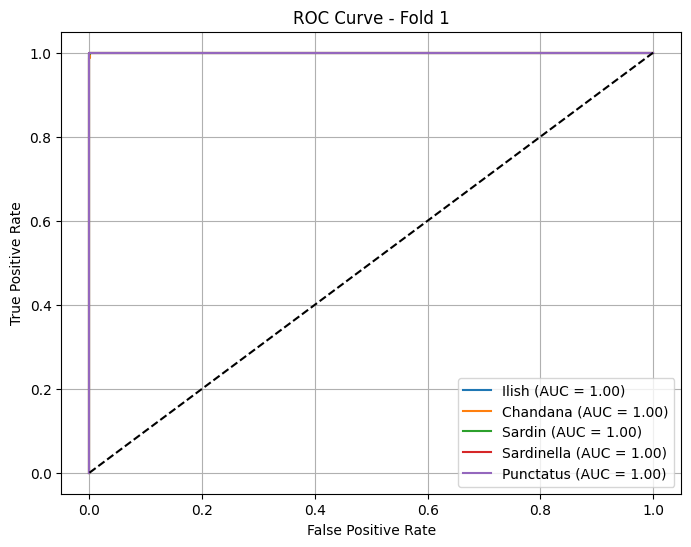

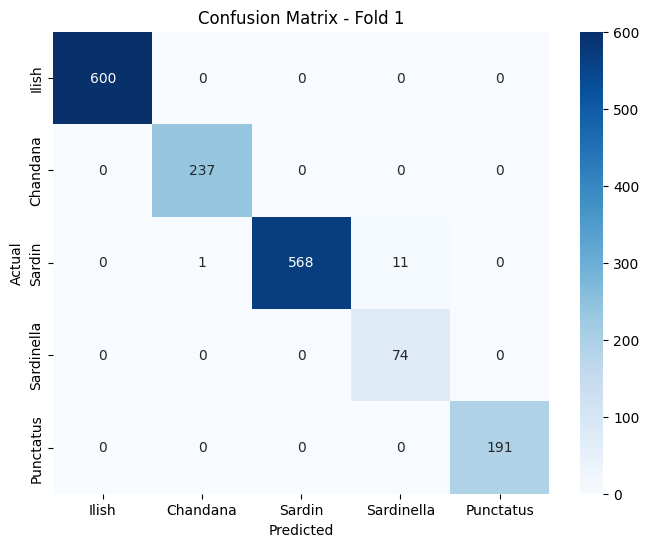

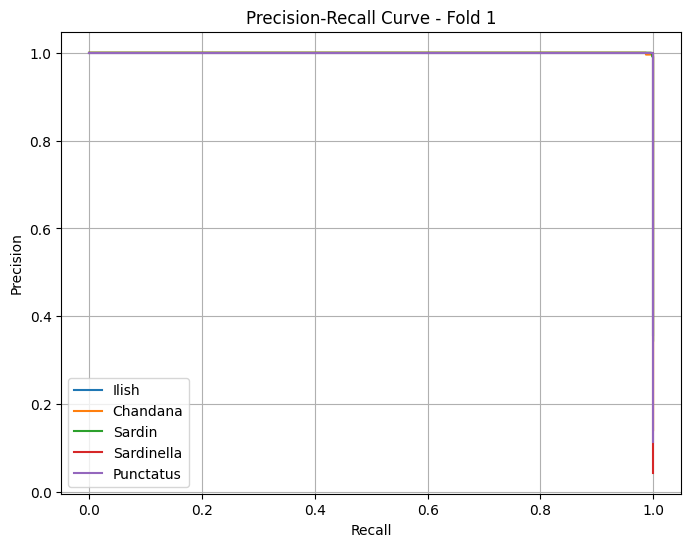

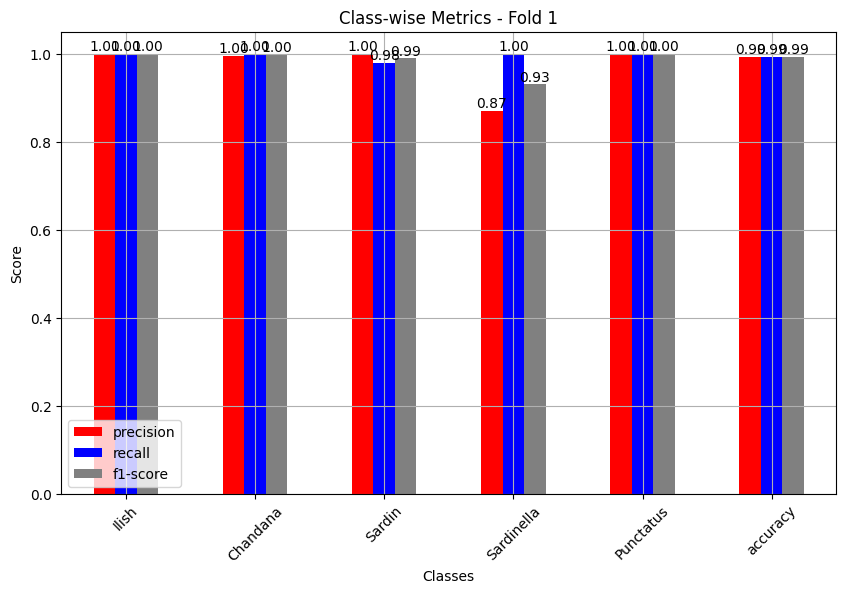

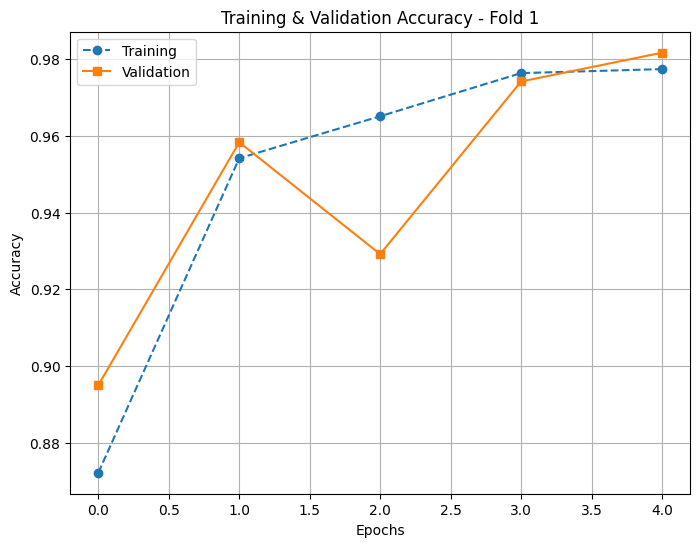

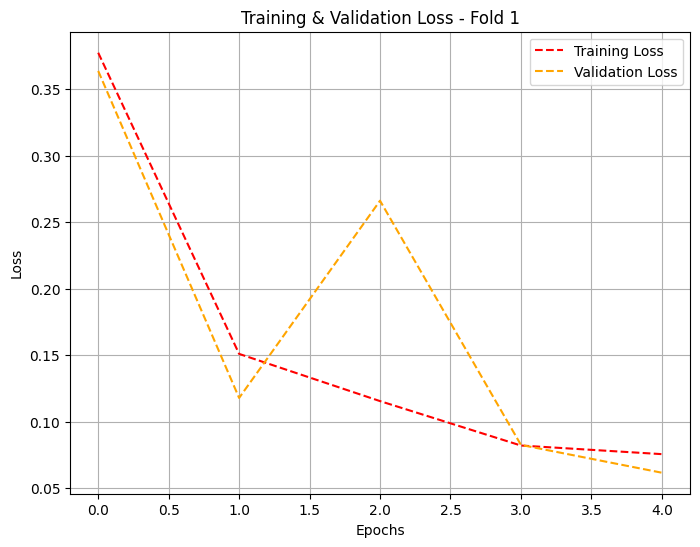

Classification Report - Fold 1:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      1.00      1.00       237
      Sardin       1.00      0.98      0.99       580
  Sardinella       0.87      1.00      0.93        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           0.99      1682
   macro avg       0.97      1.00      0.98      1682
weighted avg       0.99      0.99      0.99      1682


Evaluating Fold 2:
211/211 ━━━━━━━━━━━━━━━━━━━━ 13s 37ms/step
211/211 ━━━━━━━━━━━━━━━━━━━━ 19s 48ms/step


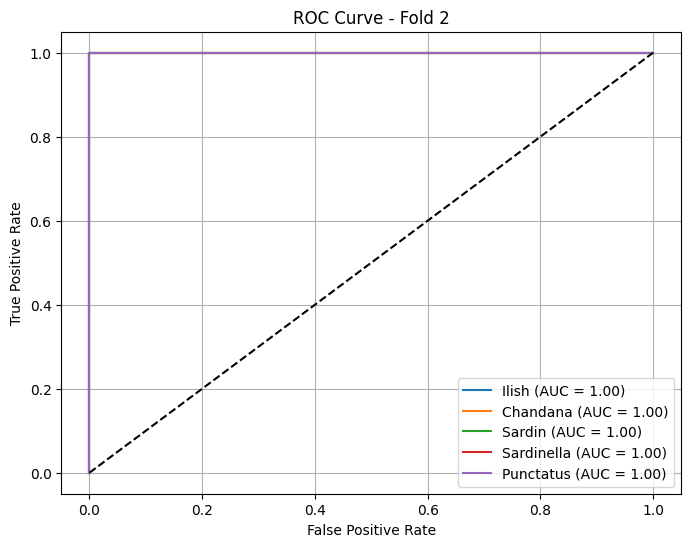

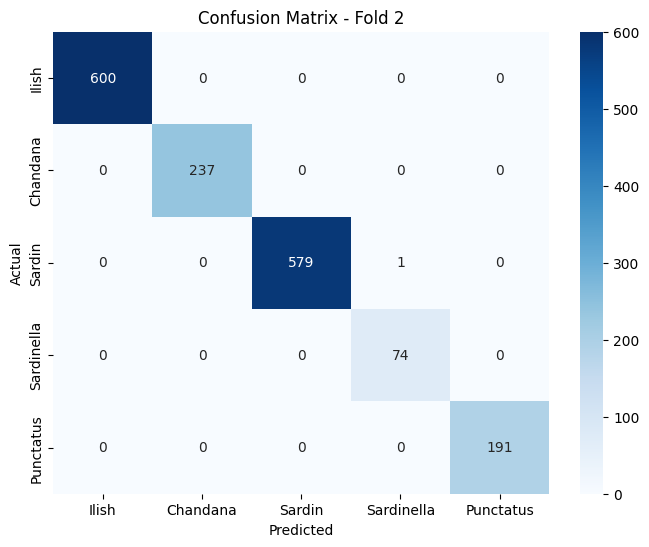

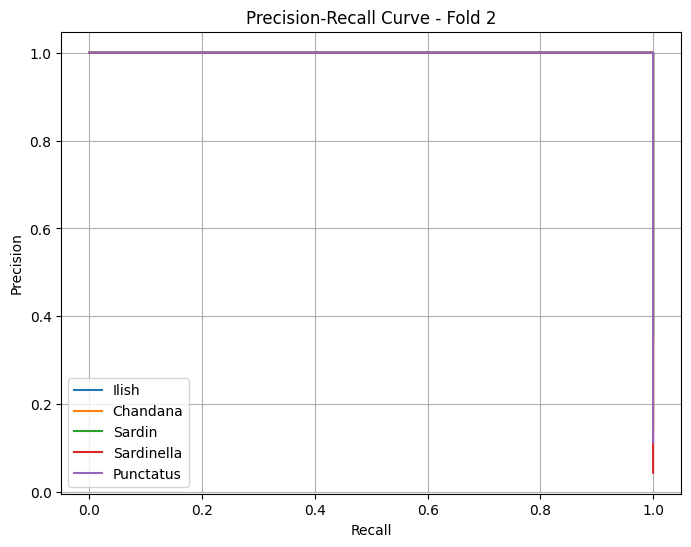

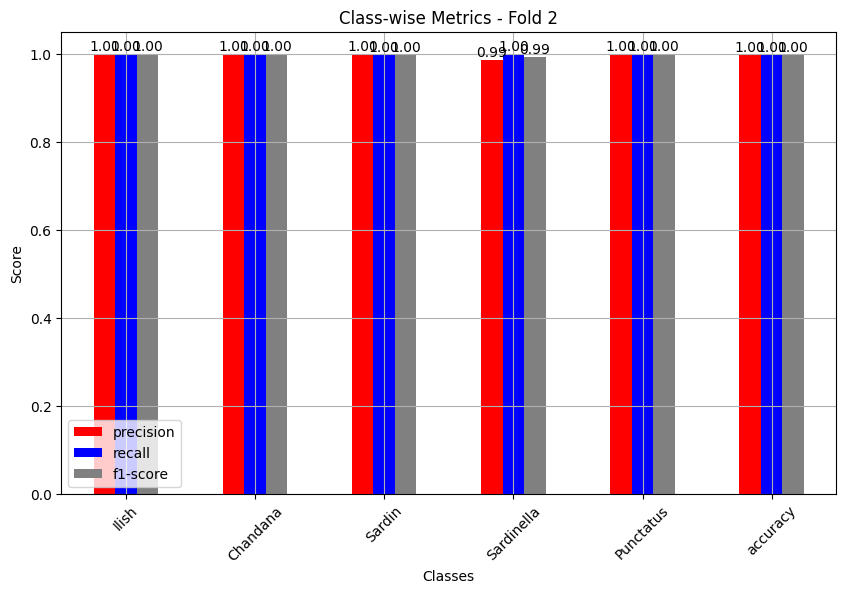

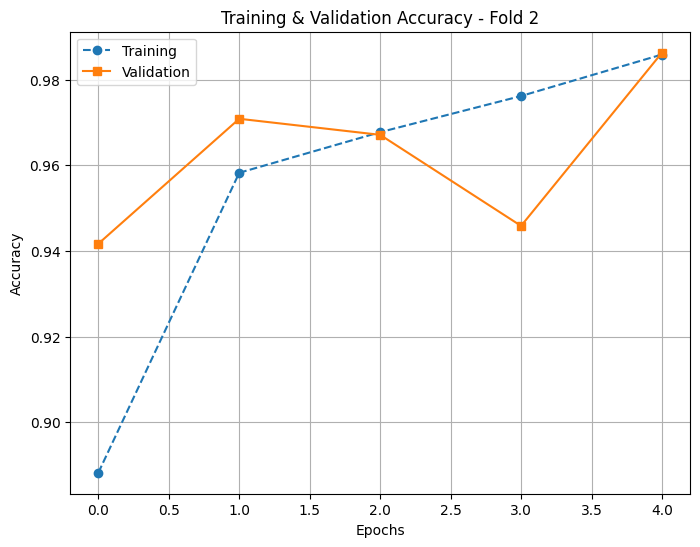

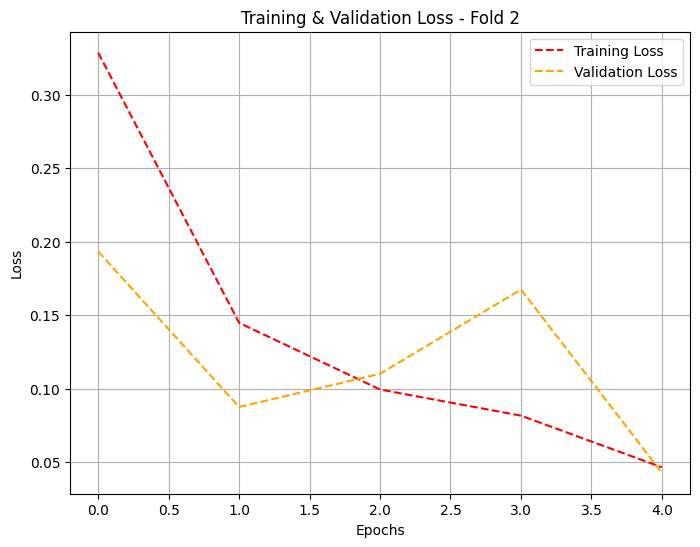

Classification Report - Fold 2:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      1.00      1.00       237
      Sardin       1.00      1.00      1.00       580
  Sardinella       0.99      1.00      0.99        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       1.00      1.00      1.00      1682
weighted avg       1.00      1.00      1.00      1682


Evaluating Fold 3:
211/211 ━━━━━━━━━━━━━━━━━━━━ 10s 29ms/step
211/211 ━━━━━━━━━━━━━━━━━━━━ 14s 36ms/step


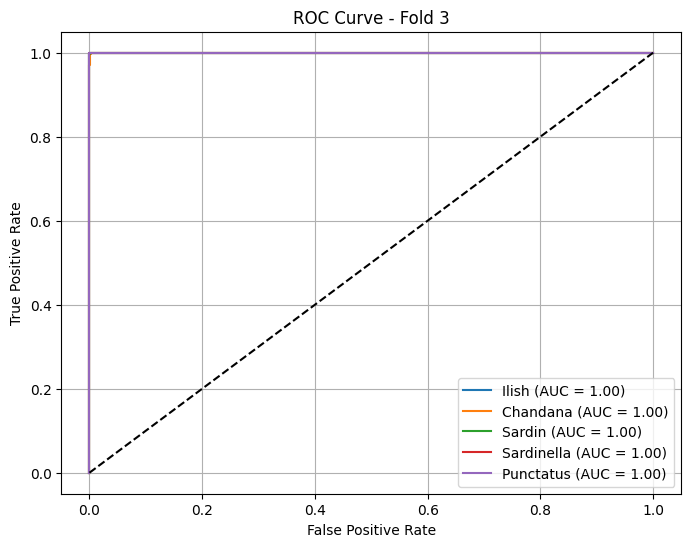

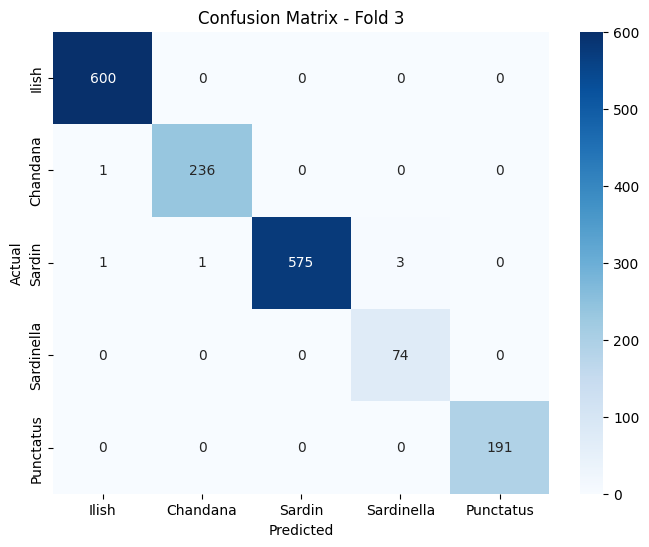

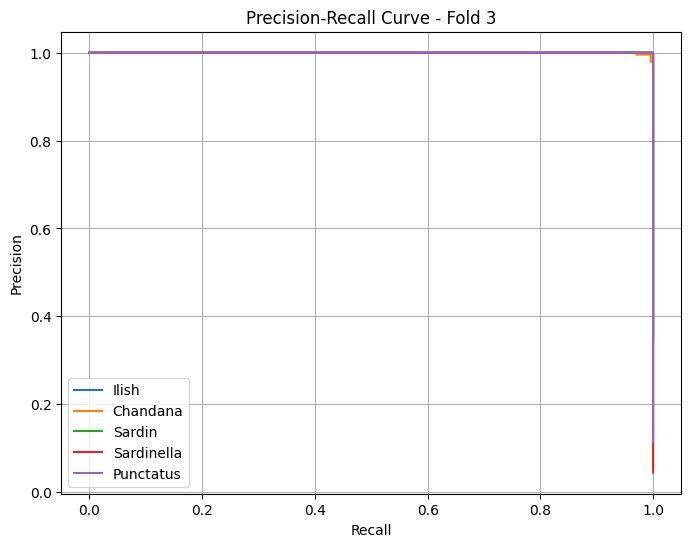

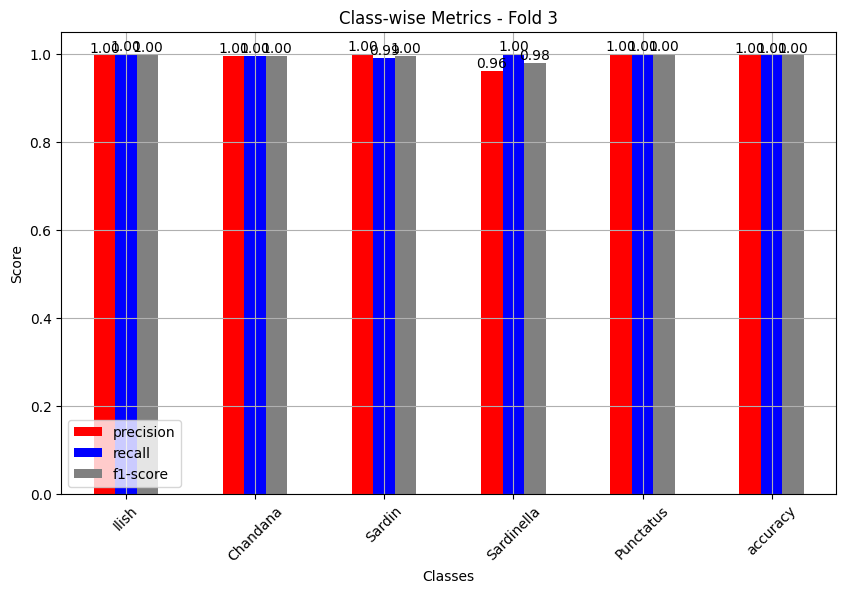

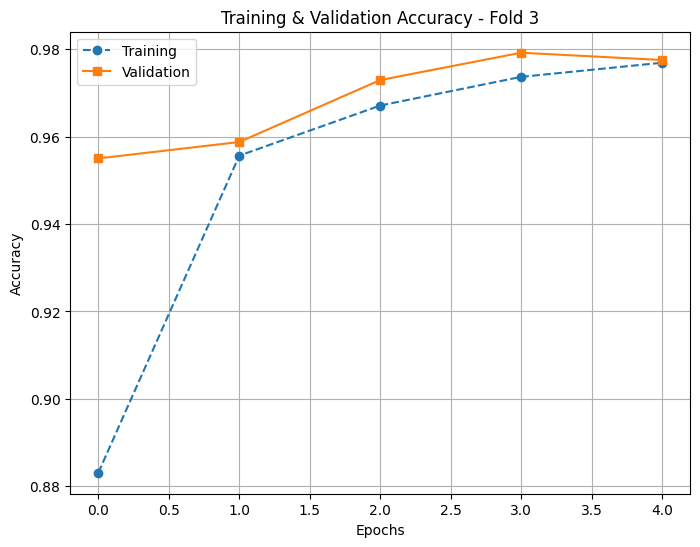

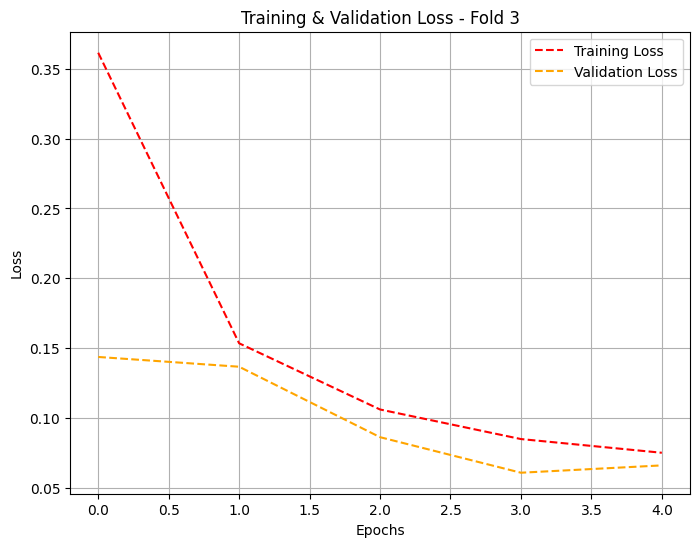

Classification Report - Fold 3:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      1.00      1.00       237
      Sardin       1.00      0.99      1.00       580
  Sardinella       0.96      1.00      0.98        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       0.99      1.00      0.99      1682
weighted avg       1.00      1.00      1.00      1682


Evaluating Fold 4:
211/211 ━━━━━━━━━━━━━━━━━━━━ 10s 29ms/step
211/211 ━━━━━━━━━━━━━━━━━━━━ 14s 36ms/step


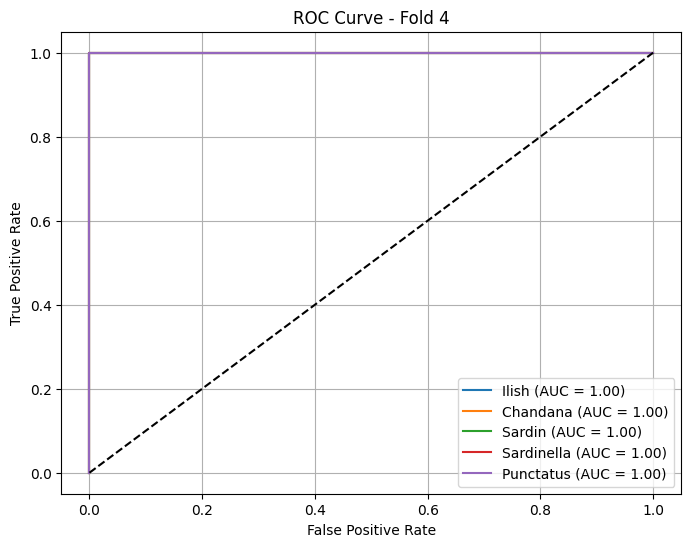

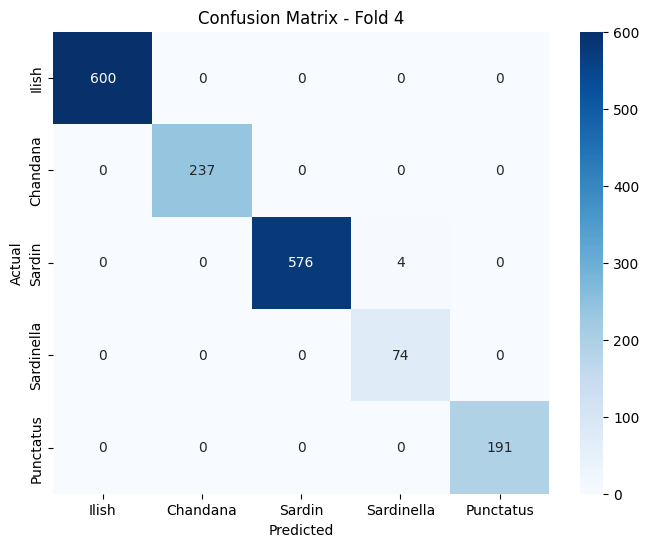

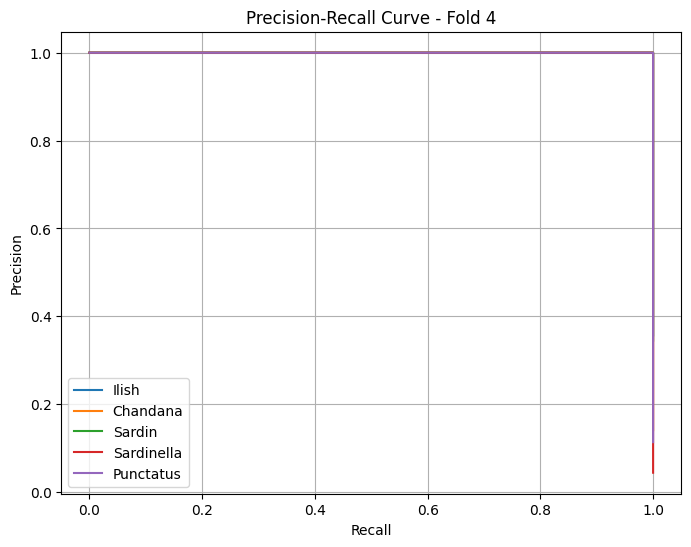

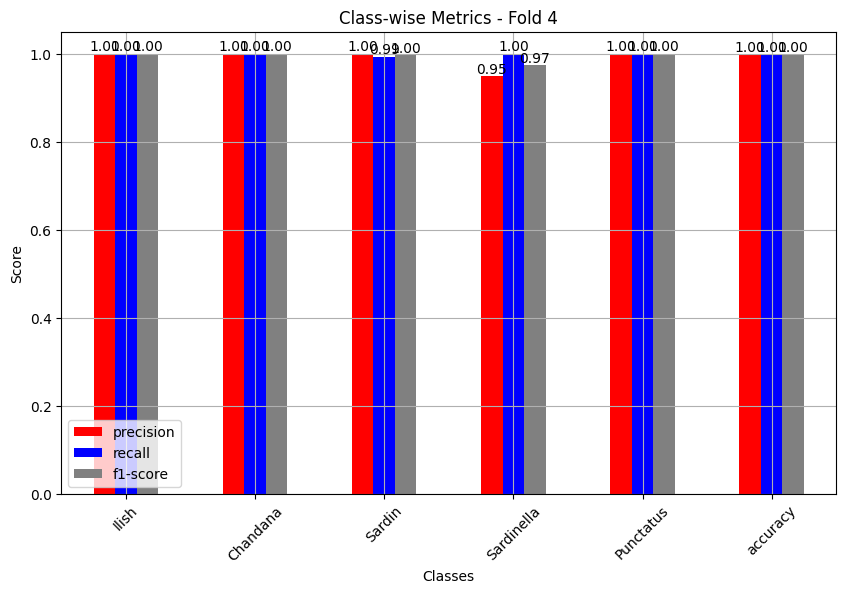

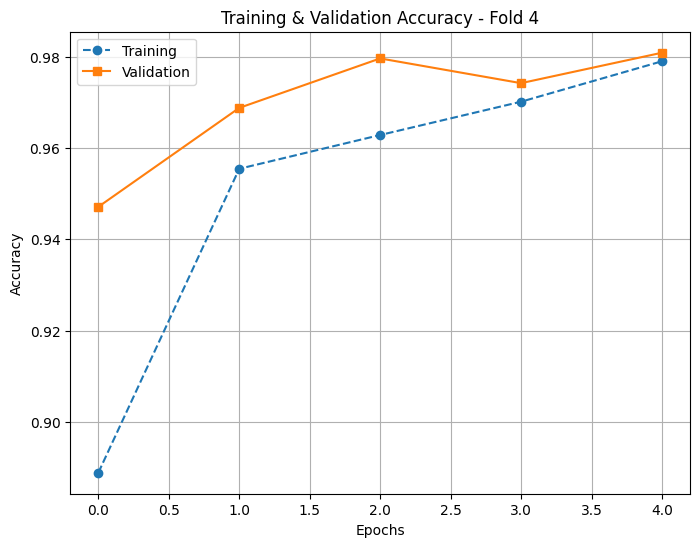

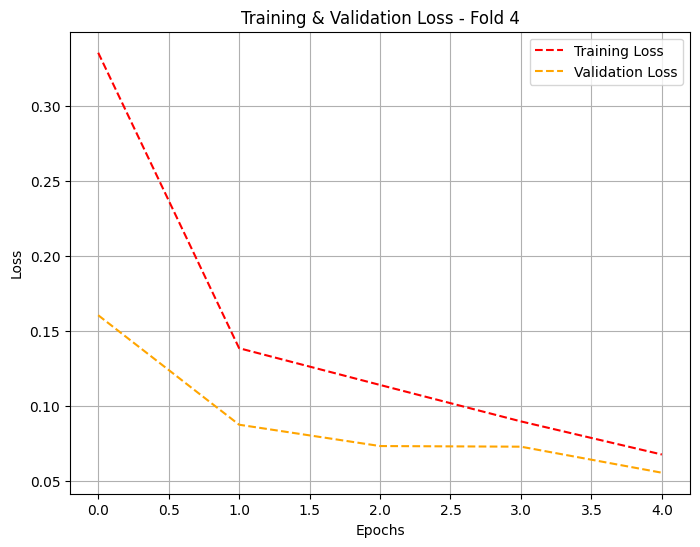

Classification Report - Fold 4:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      1.00      1.00       237
      Sardin       1.00      0.99      1.00       580
  Sardinella       0.95      1.00      0.97        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       0.99      1.00      0.99      1682
weighted avg       1.00      1.00      1.00      1682


Evaluating Fold 5:
211/211 ━━━━━━━━━━━━━━━━━━━━ 10s 29ms/step
211/211 ━━━━━━━━━━━━━━━━━━━━ 14s 35ms/step


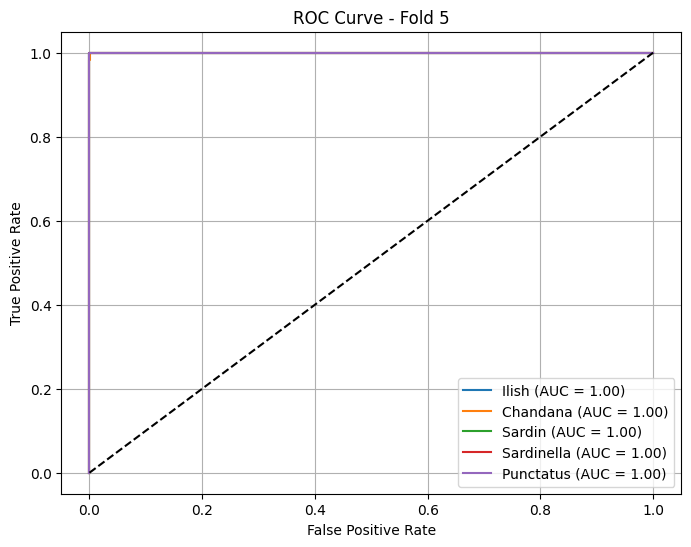

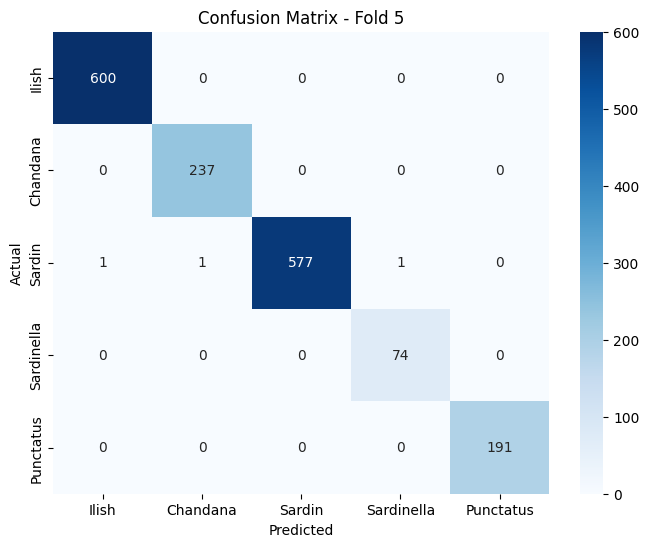

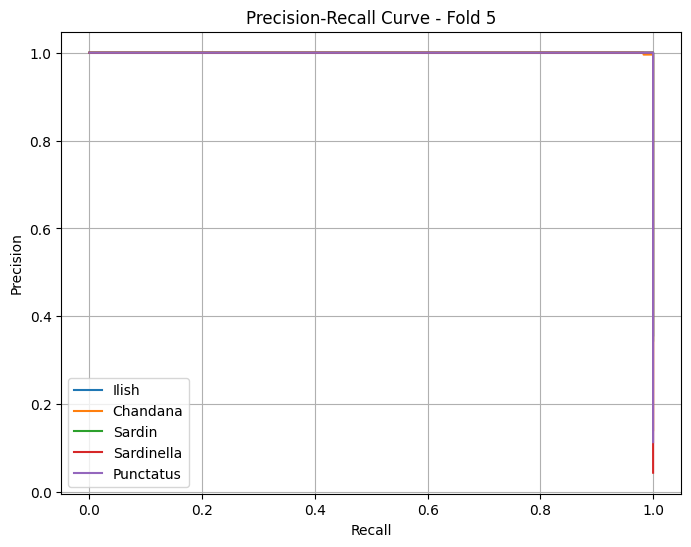

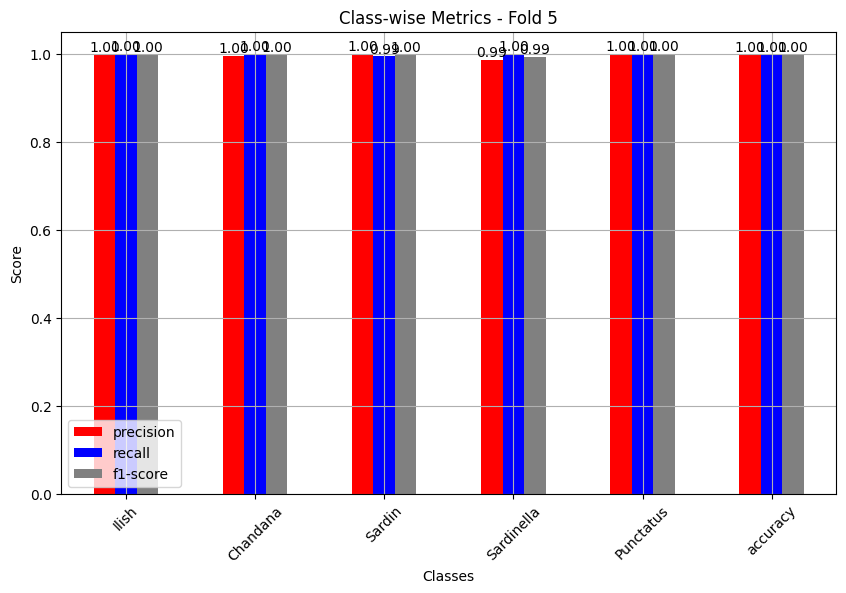

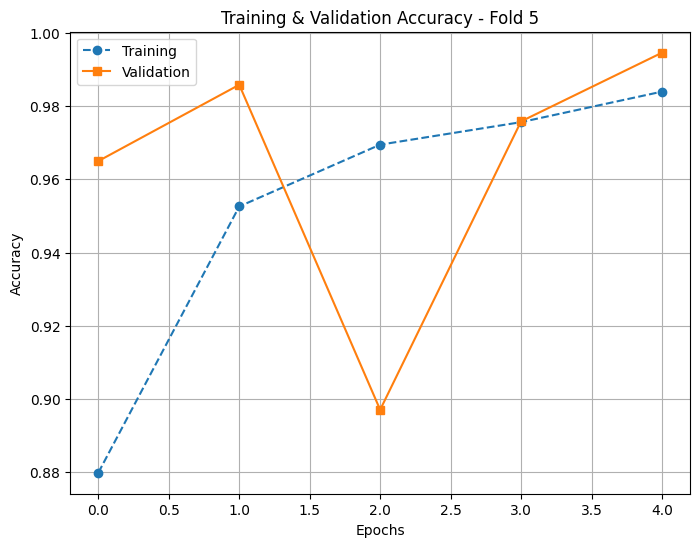

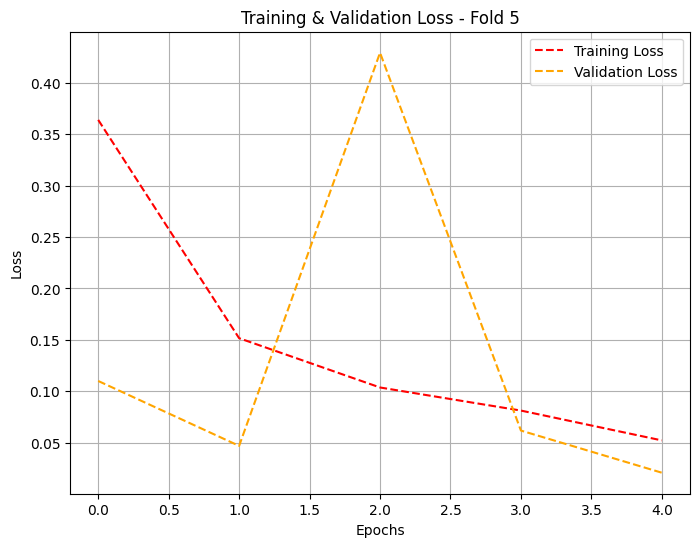

Classification Report - Fold 5:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      1.00      1.00       237
      Sardin       1.00      0.99      1.00       580
  Sardinella       0.99      1.00      0.99        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       1.00      1.00      1.00      1682
weighted avg       1.00      1.00      1.00      1682


Combined Results for All Folds:


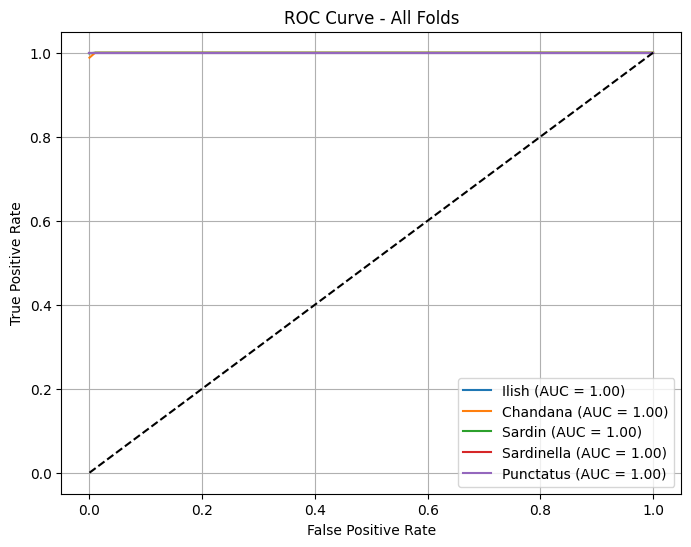

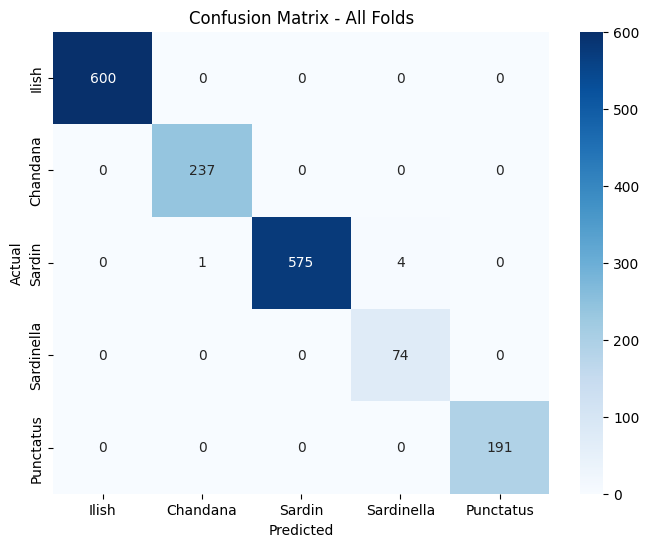

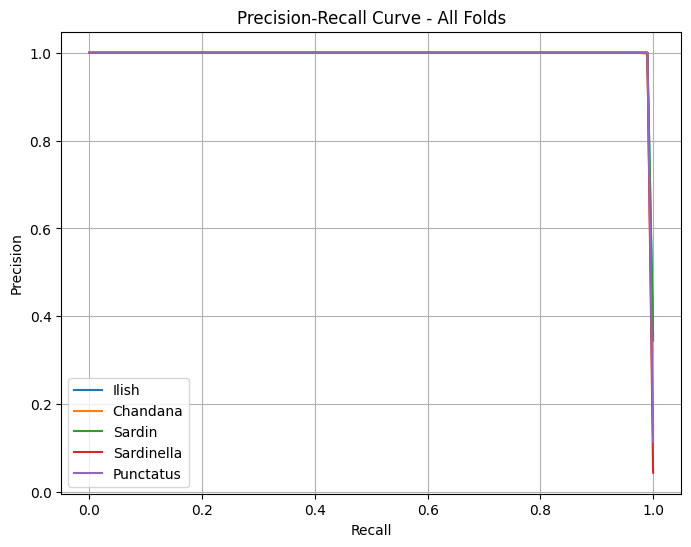

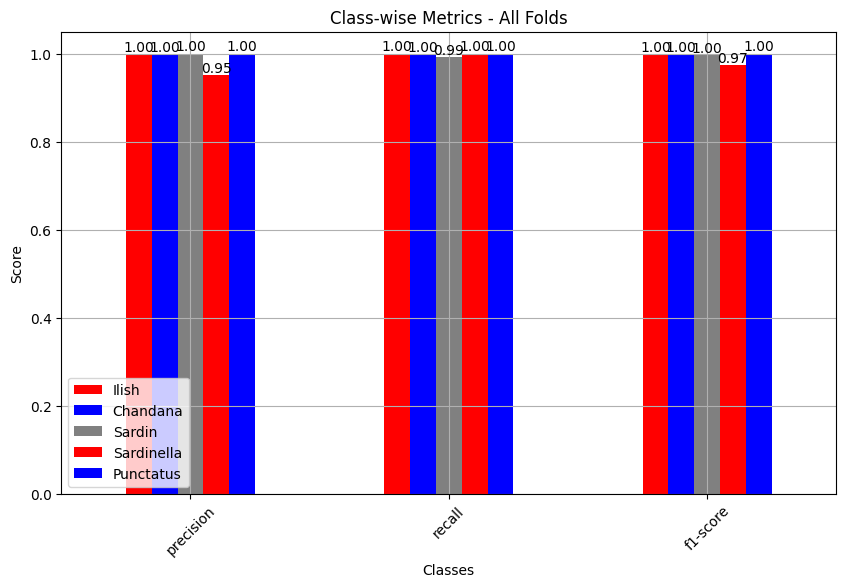

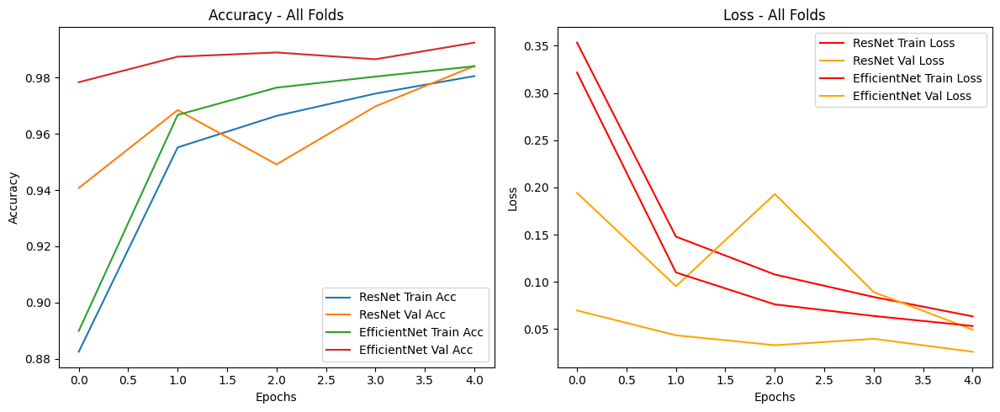


Final Combined Report:
              precision    recall  f1-score   support

       Ilish       1.00      1.00      1.00       600
    Chandana       1.00      1.00      1.00       237
      Sardin       1.00      0.99      1.00       580
  Sardinella       0.96      1.00      0.98        74
   Punctatus       1.00      1.00      1.00       191

    accuracy                           1.00      1682
   macro avg       0.99      1.00      0.99      1682
weighted avg       1.00      1.00      1.00      1682

Final Accuracy: 0.9976, F1-Score: 0.9976


In [ ]:
# # Install imbalanced-learn if not installed
# !pip install imbalanced-learn

# # 📌 Data Processing and Model Evaluation
# import numpy as np
# import pandas as pd
# import tensorflow as tf
# import seaborn as sns
# import matplotlib.pyplot as plt
# from collections import Counter

# # 📌 TensorFlow/Keras Components
# from tensorflow.keras.applications import ResNet50, EfficientNetB0
# from tensorflow.keras.models import Model
# from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, LeakyReLU, BatchNormalization
# from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
# from tensorflow.keras.optimizers import Adam
# from tensorflow.keras.utils import to_categorical
# from tensorflow.keras.preprocessing.image import ImageDataGenerator

# # 📌 Scikit-learn for Data Splitting and Evaluation
# from sklearn.model_selection import StratifiedKFold, train_test_split
# from sklearn.utils.class_weight import compute_class_weight
# from sklearn.metrics import accuracy_score, roc_curve, auc, precision_recall_curve, confusion_matrix, f1_score, classification_report

# # 📌 Handling Imbalanced Data
# from imblearn.over_sampling import SMOTE




# # Assuming X and Y are already loaded and preprocessed as numpy arrays
# # Split dataset
# X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=42)

# # Normalize data
# X_train_scaled = X_train
# X_test_scaled = X_test

# # Apply SMOTE to balance classes on the labels (not on flattened data)
# smote = SMOTE(sampling_strategy='auto', random_state=42)
# X_train_resampled, Y_train_resampled = smote.fit_resample(X_train_scaled.reshape(X_train_scaled.shape[0], -1), Y_train)

# # Check class distribution after SMOTE
# print("Class distribution after SMOTE:", Counter(Y_train_resampled))

# # Reshape back to image format
# X_train_resampled = X_train_resampled.reshape(-1, 224, 224, 3)






# # Parameters
# input_shape = (224, 224, 3)
# num_classes = 5
# batch_size = 32
# epochs = 15
# k_folds = 5

# # Image Augmentation
# datagen = ImageDataGenerator(
#     # rescale=1./255,
#     rotation_range=20,
#     width_shift_range=0.2,
#     height_shift_range=0.2,
#     shear_range=0.2,
#     zoom_range=0.2,
#     horizontal_flip=True,
#     fill_mode="nearest"
# )

# # Custom Batch Generator
# def batch_generator(X, Y, batch_size=32):
#     size = X.shape[0]
#     while True:
#         indices = np.random.permutation(size)
#         for start in range(0, size, batch_size):
#             end = min(start + batch_size, size)
#             batch_idx = indices[start:end]
#             X_batch, Y_batch = X[batch_idx], Y[batch_idx]

#             # Apply augmentation
#             augmented_images = next(datagen.flow(X_batch, shuffle=False, batch_size=batch_size))
#             yield augmented_images, to_categorical(Y_batch, num_classes)



# # Create Base Model (ResNet/Inception)
# def create_base_model(input_shape=(224, 224, 3), model_type='ResNet'):
#     if model_type == 'ResNet':
#         base_model = ResNet50(weights='imagenet', include_top=False, input_shape=input_shape)
#     elif model_type == 'Inception':
#         base_model = EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape)

#     # Unfreeze top 10 layers
#     for layer in base_model.layers[:-10]:
#         layer.trainable = False
#     for layer in base_model.layers[-10:]:
#         layer.trainable = True

#     x = GlobalAveragePooling2D()(base_model.output)
#     x = Dense(256)(x)
#     x = BatchNormalization()(x)
#     x = LeakyReLU(alpha=0.1)(x)
#     x = Dropout(0.5)(x)

#     x = Dense(128)(x)
#     x = BatchNormalization()(x)
#     x = LeakyReLU(alpha=0.1)(x)
#     x = Dropout(0.5)(x)

#     output = Dense(num_classes, activation='softmax')(x)

#     model = Model(inputs=base_model.input, outputs=output)
#     model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
#     return model

# # K-Fold Training with Adaptive Weighted Ensemble
# def train_with_kfold(X_train, Y_train, X_test, Y_test, k=5, batch_size=32, epochs=15):
#     skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
#     histories = {'ResNet': [], 'Inception': []}
#     ensemble_predictions = np.zeros((X_test.shape[0], num_classes))

#     trained_resnet_models = []
#     trained_inception_models = []

#     for fold_no, (train_idx, val_idx) in enumerate(skf.split(X_train, Y_train), 1):
#         print(f"Training Fold {fold_no}/{k}")

#         X_train_fold, X_val_fold = X_train[train_idx], X_train[val_idx]
#         Y_train_fold, Y_val_fold = Y_train[train_idx], Y_train[val_idx]

#         resnet_model = create_base_model(model_type='ResNet')
#         inception_model = create_base_model(model_type='Inception')

#         train_generator = batch_generator(X_train_fold, Y_train_fold, batch_size)
#         val_generator = batch_generator(X_val_fold, Y_val_fold, batch_size)

#         callbacks = [
#             ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, verbose=1),
#             ModelCheckpoint(f'best_model_resnet_fold_{fold_no}.h5', save_best_only=True, monitor='val_loss', mode='min'),
#             ModelCheckpoint(f'best_model_inception_fold_{fold_no}.h5', save_best_only=True, monitor='val_loss', mode='min'),
#             EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
#         ]

#         history_resnet = resnet_model.fit(
#             train_generator, validation_data=val_generator, epochs=epochs, verbose=1,
#             callbacks=callbacks, steps_per_epoch=len(X_train_fold) // batch_size,
#             validation_steps=len(X_val_fold) // batch_size)

#         history_inception = inception_model.fit(
#             train_generator, validation_data=val_generator, epochs=epochs, verbose=1,
#             callbacks=callbacks, steps_per_epoch=len(X_train_fold) // batch_size,
#             validation_steps=len(X_val_fold) // batch_size)

#         histories['ResNet'].append(history_resnet)
#         histories['Inception'].append(history_inception)

#         trained_resnet_models.append(resnet_model)
#         trained_inception_models.append(inception_model)

#         resnet_preds = resnet_model.predict(X_test)
#         inception_preds = inception_model.predict(X_test)

#         ensemble_probs, ensemble_preds = get_ensemble_predictions(resnet_preds, inception_preds)
#         ensemble_predictions += ensemble_probs

#     ensemble_predictions /= k
#     final_classes = np.argmax(ensemble_predictions, axis=1)
#     accuracy = np.mean(final_classes == Y_test)
#     print(f"Final Ensemble Model Accuracy: {accuracy * 100:.2f}%")

#     return final_classes, histories, trained_resnet_models, trained_inception_models

# # Function to calculate the weighted average of predictions based on confidence
# def get_ensemble_predictions(resnet_probs, inception_probs):
#     # Confidence-based weighting: Higher confidence gets more weight
#     resnet_confidence = np.max(resnet_probs, axis=1)
#     inception_confidence = np.max(inception_probs, axis=1)

#     # Normalize confidence scores to sum up to 1
#     total_confidence = resnet_confidence + inception_confidence
#     resnet_weight = resnet_confidence / total_confidence
#     inception_weight = inception_confidence / total_confidence

#     # Compute weighted average of the probabilities
#     ensemble_probs = resnet_weight[:, np.newaxis] * resnet_probs + inception_weight[:, np.newaxis] * inception_probs

#     # Get final predicted classes from the ensemble probabilities
#     ensemble_preds = np.argmax(ensemble_probs, axis=1)
#     return ensemble_probs, ensemble_preds


# final_predictions, history_dict, trained_resnet_models, trained_inception_models = train_with_kfold(
#     X_train_resampled, Y_train_resampled, X_test_scaled, Y_test, k=k_folds)
# print("Training Complete. Adaptive Weighted Ensemble Model is ready!")










#                                                          #Result for Single Fold.......
# import numpy as np
# import matplotlib.pyplot as plt
# import seaborn as sns
# import pandas as pd
# from sklearn.metrics import roc_curve, auc, confusion_matrix, precision_recall_curve, classification_report
# from sklearn.metrics import accuracy_score, f1_score

# # Define class labels
# class_labels = ['Ilish', 'Chandana', 'Sardin', 'Sardinella', 'Punctatus']

# # Function to plot ROC curve
# def plot_roc_curve(Y_test, Y_test_pred_prob, class_labels, fold_no):
#     plt.figure(figsize=(8, 6))
#     for i in range(len(class_labels)):
#         y_true_binary = (Y_test == i).astype(int)
#         y_score = Y_test_pred_prob[:, i]
#         fpr, tpr, _ = roc_curve(y_true_binary, y_score)
#         roc_auc = auc(fpr, tpr)
#         plt.plot(fpr, tpr, label=f'{class_labels[i]} (AUC = {roc_auc:.2f})')
#     plt.plot([0, 1], [0, 1], 'k--')
#     plt.title(f'ROC Curve - Fold {fold_no}')
#     plt.xlabel('False Positive Rate')
#     plt.ylabel('True Positive Rate')
#     plt.legend()
#     plt.grid()
#     plt.show()

# # Function to plot Confusion Matrix
# def plot_confusion_matrix(Y_test, Y_test_pred, class_labels, fold_no):
#     conf_matrix = confusion_matrix(Y_test, Y_test_pred)
#     plt.figure(figsize=(8, 6))
#     sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
#     plt.title(f'Confusion Matrix - Fold {fold_no}')
#     plt.xlabel('Predicted')
#     plt.ylabel('Actual')
#     plt.show()

# # Function to plot Precision-Recall curve
# def plot_precision_recall_curve(Y_test, Y_test_pred_prob, class_labels, fold_no):
#     plt.figure(figsize=(8, 6))
#     for i in range(len(class_labels)):
#         precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), Y_test_pred_prob[:, i])
#         plt.plot(recall, precision, label=f'{class_labels[i]}')
#     plt.title(f'Precision-Recall Curve - Fold {fold_no}')
#     plt.xlabel('Recall')
#     plt.ylabel('Precision')
#     plt.legend()
#     plt.grid()
#     plt.show()

# # Function to plot Training & Validation Accuracy over epochs
# def plot_accuracy(history_list):
#     plt.figure(figsize=(8, 6))
#     for i, history in enumerate(history_list):
#         plt.plot(history.history['accuracy'], label=f'Fold {i+1} Training', linestyle='dashed', marker='o')
#         plt.plot(history.history['val_accuracy'], label=f'Fold {i+1} Validation', marker='s')
#     plt.title('Training & Validation Accuracy Over Epochs')
#     plt.xlabel('Epochs')
#     plt.ylabel('Accuracy')
#     plt.legend()
#     plt.grid()
#     plt.show()

# # Function to plot Training & Validation Loss over epochs
# def plot_loss(history_list):
#     plt.figure(figsize=(8, 6))
#     for i, history in enumerate(history_list):
#         plt.plot(history.history['loss'], label=f'Fold {i+1} Training Loss', linestyle='dashed', color='red')
#         plt.plot(history.history['val_loss'], label=f'Fold {i+1} Validation Loss', linestyle='dashed', color='orange')
#     plt.title('Training & Validation Loss')
#     plt.xlabel('Epochs')
#     plt.ylabel('Loss')
#     plt.legend()
#     plt.grid()
#     plt.show()

# # Function to compare class-wise metrics
# def plot_classwise_metrics(Y_test, Y_test_pred, prev_Y_test_pred=None):
#     report = classification_report(Y_test, Y_test_pred, target_names=class_labels, output_dict=True)
#     df_report = pd.DataFrame(report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]
#     colors = {'precision': 'red', 'recall': 'blue', 'f1-score': 'gray'}

#     # Current model class-wise metrics
#     plt.figure(figsize=(10, 6))
#     df_report.plot(kind='bar', width=0.7, color=[colors[col] for col in df_report.columns])
#     for p in plt.gca().patches:
#         plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width() / 2, p.get_height()),
#                            ha='center', va='bottom', fontsize=10, color='black')
#     plt.title('Current Model Class-wise Metrics')
#     plt.xlabel('Classes')
#     plt.ylabel('Score')
#     plt.xticks(rotation=45)
#     plt.legend()
#     plt.grid()
#     plt.show()

#     # Previous model class-wise metrics (if available)
#     if prev_Y_test_pred is not None:
#         prev_report = classification_report(Y_test, prev_Y_test_pred, target_names=class_labels, output_dict=True)
#         prev_df_report = pd.DataFrame(prev_report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]

#         plt.figure(figsize=(10, 6))
#         prev_df_report.plot(kind='bar', width=0.7, color=['pink', 'lightblue', 'lightgray'])
#         for p in plt.gca().patches:
#             plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width() / 2, p.get_height()),
#                                ha='center', va='bottom', fontsize=10, color='black')
#         plt.title('Previous Model Class-wise Metrics')
#         plt.xlabel('Classes')
#         plt.ylabel('Score')
#         plt.xticks(rotation=45)
#         plt.legend()
#         plt.grid()
#         plt.show()

# # Function to display classification report
# def print_classification_report(Y_test, Y_test_pred, class_labels, fold_no):
#     report = classification_report(Y_test, Y_test_pred, target_names=class_labels)
#     print(f"Classification Report - Fold {fold_no}:\n", report)



# # Function to evaluate and plot metrics
# def evaluate_and_plot(history_dict, X_test, Y_test, resnet_model, inception_model):
#     for fold_no, history in enumerate(history_dict['ResNet'], 1):
#         print(f"\nEvaluating Fold {fold_no}:")

#         resnet_probs = resnet_model.predict(X_test)
#         inception_probs = inception_model.predict(X_test)

#         ensemble_probs, ensemble_preds = get_ensemble_predictions(resnet_probs, inception_probs)

#         plot_roc_curve(Y_test, ensemble_probs, class_labels, fold_no)
#         plot_confusion_matrix(Y_test, ensemble_preds, class_labels, fold_no)
#         plot_precision_recall_curve(Y_test, ensemble_probs, class_labels, fold_no)
#         plot_classwise_metrics(Y_test, ensemble_preds)
#         plot_accuracy([history])
#         plot_loss([history])
#         print_classification_report(Y_test, ensemble_preds, class_labels, fold_no)



# # Use the first trained model for evaluation
# resnet_model = trained_resnet_models[0]
# inception_model = trained_inception_models[0]
# evaluate_and_plot(history_dict, X_test_scaled, Y_test, resnet_model, inception_model)










#                                                                 #For Single Plot
# print("Single Plot by Combinding all the folds result.......")

# import numpy as np
# import matplotlib.pyplot as plt
# import seaborn as sns
# import pandas as pd
# from sklearn.metrics import roc_curve, auc, confusion_matrix, precision_recall_curve, classification_report, accuracy_score, f1_score

# # Define class labels
# class_labels = ['Ilish', 'Chandana', 'Sardin', 'Sardinella', 'Punctatus']

# # Function to calculate the weighted average of predictions based on confidence
# def get_ensemble_predictions(resnet_probs, inception_probs):
#     resnet_confidence = np.max(resnet_probs, axis=1)
#     inception_confidence = np.max(inception_probs, axis=1)
#     total_confidence = resnet_confidence + inception_confidence
#     resnet_weight = resnet_confidence / total_confidence
#     inception_weight = inception_confidence / total_confidence
#     ensemble_probs = resnet_weight[:, np.newaxis] * resnet_probs + inception_weight[:, np.newaxis] * inception_probs
#     ensemble_preds = np.argmax(ensemble_probs, axis=1)
#     return ensemble_probs, ensemble_preds

# # Function to plot ROC curve for all folds combined
# def plot_roc_curve_all_folds(Y_test, ensemble_probs_list, class_labels):
#     plt.figure(figsize=(10, 8))
#     for i in range(len(class_labels)):
#         y_true_binary = (Y_test == i).astype(int)
#         mean_fpr = np.linspace(0, 1, 100)
#         tpr_list = []
#         auc_list = []

#         for fold_probs in ensemble_probs_list:
#             fpr, tpr, _ = roc_curve(y_true_binary, fold_probs[:, i])
#             roc_auc = auc(fpr, tpr)
#             interp_tpr = np.interp(mean_fpr, fpr, tpr)
#             interp_tpr[0] = 0.0
#             tpr_list.append(interp_tpr)
#             auc_list.append(roc_auc)

#         mean_tpr = np.mean(tpr_list, axis=0)
#         mean_tpr[-1] = 1.0
#         mean_auc = auc(mean_fpr, mean_tpr)
#         std_auc = np.std(auc_list)

#         plt.plot(mean_fpr, mean_tpr, label=f'{class_labels[i]} (AUC = {mean_auc:.2f} ± {std_auc:.2f})')

#     plt.plot([0, 1], [0, 1], 'k--')
#     plt.title('ROC Curve - All Folds Combined')
#     plt.xlabel('False Positive Rate')
#     plt.ylabel('True Positive Rate')
#     plt.legend(loc='lower right')
#     plt.grid()
#     plt.show()

# # Function to plot Confusion Matrix for all folds combined
# def plot_confusion_matrix_all_folds(Y_test, ensemble_preds_list, class_labels):
#     combined_conf_matrix = np.zeros((len(class_labels), len(class_labels)), dtype=int)
#     for preds in ensemble_preds_list:
#         conf_matrix = confusion_matrix(Y_test, preds)
#         combined_conf_matrix += conf_matrix

#     plt.figure(figsize=(10, 8))
#     sns.heatmap(combined_conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
#     plt.title('Confusion Matrix - All Folds Combined')
#     plt.xlabel('Predicted')
#     plt.ylabel('Actual')
#     plt.show()

# # Function to plot Precision-Recall curve for all folds combined
# def plot_precision_recall_curve_all_folds(Y_test, ensemble_probs_list, class_labels):
#     plt.figure(figsize=(10, 8))
#     for i in range(len(class_labels)):
#         precision_list = []
#         recall_list = []

#         for fold_probs in ensemble_probs_list:
#             precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), fold_probs[:, i])
#             interp_recall = np.linspace(0, 1, 100)
#             interp_precision = np.interp(interp_recall[::-1], recall[::-1], precision[::-1])[::-1]
#             precision_list.append(interp_precision)

#         mean_precision = np.mean(precision_list, axis=0)
#         plt.plot(interp_recall, mean_precision, label=f'{class_labels[i]}')

#     plt.title('Precision-Recall Curve - All Folds Combined')
#     plt.xlabel('Recall')
#     plt.ylabel('Precision')
#     plt.legend(loc='lower left')
#     plt.grid()
#     plt.show()

# # Function to plot Training & Validation Accuracy over epochs for all folds
# def plot_accuracy_all_folds(history_dict):
#     plt.figure(figsize=(12, 8))
#     for model_type, histories in history_dict.items():
#         for i, history in enumerate(histories):
#             plt.plot(history.history['accuracy'], label=f'{model_type} Fold {i+1} Training', linestyle='dashed', marker='o')
#             plt.plot(history.history['val_accuracy'], label=f'{model_type} Fold {i+1} Validation', marker='s')
#     plt.title('Training & Validation Accuracy Over Epochs - All Folds')
#     plt.xlabel('Epochs')
#     plt.ylabel('Accuracy')
#     plt.legend(loc='lower right', bbox_to_anchor=(1.15, 0), ncol=1)
#     plt.grid()
#     plt.show()

# # Function to plot Training & Validation Loss over epochs for all folds
# def plot_loss_all_folds(history_dict):
#     plt.figure(figsize=(12, 8))
#     for model_type, histories in history_dict.items():
#         for i, history in enumerate(histories):
#             plt.plot(history.history['loss'], label=f'{model_type} Fold {i+1} Training Loss', linestyle='dashed', marker='o')
#             plt.plot(history.history['val_loss'], label=f'{model_type} Fold {i+1} Validation Loss', marker='s')
#     plt.title('Training & Validation Loss - All Folds')
#     plt.xlabel('Epochs')
#     plt.ylabel('Loss')
#     plt.legend(loc='upper right', bbox_to_anchor=(1.15, 1), ncol=1)
#     plt.grid()
#     plt.show()

# # Function to compare class-wise metrics for all folds combined
# def plot_classwise_metrics_all_folds(Y_test, ensemble_preds_list, class_labels):
#     report_dicts = []
#     for preds in ensemble_preds_list:
#         report = classification_report(Y_test, preds, target_names=class_labels, output_dict=True)
#         report_dicts.append(report)

#     mean_report = {}
#     for metric in ['precision', 'recall', 'f1-score']:
#         mean_report[metric] = {}
#         for cls in class_labels:
#             metric_values = [r[cls][metric] for r in report_dicts]
#             mean_report[metric][cls] = np.mean(metric_values)

#     df_report = pd.DataFrame(mean_report, index=class_labels).T
#     colors = {'precision': 'red', 'recall': 'blue', 'f1-score': 'gray'}

#     plt.figure(figsize=(12, 8))
#     df_report.T.plot(kind='bar', width=0.7, color=[colors[col] for col in df_report.index])
#     for p in plt.gca().patches:
#         plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width() / 2, p.get_height()),
#                            ha='center', va='bottom', fontsize=10, color='black')
#     plt.title('Class-wise Metrics - All Folds Combined')
#     plt.xlabel('Classes')
#     plt.ylabel('Score')
#     plt.xticks(rotation=45)
#     plt.legend(title='Metrics')
#     plt.grid()
#     plt.show()

# # Function to display classification report for a single fold (not used here but kept for reference)
# # def print_classification_report(Y_test, Y_test_pred, class_labels, fold_no):
# #     report = classification_report(Y_test, Y_test_pred, target_names=class_labels)
# #     print(f"Classification Report - Fold {fold_no}:\n{report}")

# # Function to display classification report for all folds combined
# def print_classification_report_all_folds(Y_test, ensemble_preds_list, class_labels):
#     report_dicts = []
#     for preds in ensemble_preds_list:
#         report = classification_report(Y_test, preds, target_names=class_labels, output_dict=True)
#         report_dicts.append(report)

#     mean_report = {}
#     for cls in class_labels + ['macro avg', 'weighted avg']:
#         mean_report[cls] = {}
#         for metric in ['precision', 'recall', 'f1-score', 'support']:
#             metric_values = [r[cls][metric] for r in report_dicts]
#             mean_report[cls][metric] = np.mean(metric_values) if metric != 'support' else int(np.mean(metric_values))

#     print("Classification Report - All Folds Combined:")
#     print(pd.DataFrame(mean_report).T.to_string())

# # New function to display final combined classification report with accuracy, F1, and misclassification
# def print_final_combined_classification_report(Y_test, ensemble_probs_list, class_labels):
#     # Average probabilities across folds
#     mean_ensemble_probs = np.mean(ensemble_probs_list, axis=0)
#     final_preds = np.argmax(mean_ensemble_probs, axis=1)

#     # Calculate metrics
#     final_report = classification_report(Y_test, final_preds, target_names=class_labels)
#     final_accuracy = accuracy_score(Y_test, final_preds)
#     final_f1 = f1_score(Y_test, final_preds, average='weighted')
#     misclassification_count = np.sum(Y_test != final_preds)

#     # Print detailed report
#     print("\nFinal Combined Classification Report (Averaged Predictions Across All Folds):")
#     print(final_report)
#     print(f"Total Misclassifications: {misclassification_count} out of {len(Y_test)} samples")
#     print(f"Final Weighted F1-Score: {final_f1:.4f}")
#     print(f"Final Combined Accuracy: {final_accuracy:.4f}")



# # Modified evaluate_and_plot function to include final combined report
# def evaluate_and_plot(history_dict, X_test, Y_test, trained_resnet_models, trained_inception_models):
#     ensemble_probs_list = []
#     ensemble_preds_list = []

#     # Generate predictions for all folds
#     for resnet_model, inception_model in zip(trained_resnet_models, trained_inception_models):
#         resnet_probs = resnet_model.predict(X_test)
#         inception_probs = inception_model.predict(X_test)
#         ensemble_probs, ensemble_preds = get_ensemble_predictions(resnet_probs, inception_probs)
#         ensemble_probs_list.append(ensemble_probs)
#         ensemble_preds_list.append(ensemble_preds)

#     # Plot combined results
#     plot_roc_curve_all_folds(Y_test, ensemble_probs_list, class_labels)
#     plot_confusion_matrix_all_folds(Y_test, ensemble_preds_list, class_labels)
#     plot_precision_recall_curve_all_folds(Y_test, ensemble_probs_list, class_labels)
#     plot_accuracy_all_folds(history_dict)
#     plot_loss_all_folds(history_dict)
#     plot_classwise_metrics_all_folds(Y_test, ensemble_preds_list, class_labels)
#     print_classification_report_all_folds(Y_test, ensemble_preds_list, class_labels)

#     # Add final combined classification report
#     print_final_combined_classification_report(Y_test, ensemble_probs_list, class_labels)

# # Call the evaluation function with all trained models
# evaluate_and_plot(history_dict, X_test_scaled, Y_test, trained_resnet_models, trained_inception_models)


# Install required packages
!pip install imbalanced-learn

import numpy as np
import tensorflow as tf
from tensorflow.keras.applications import ResNet50, EfficientNetB0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, LeakyReLU, BatchNormalization
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.metrics import roc_curve, auc, confusion_matrix, precision_recall_curve, classification_report, accuracy_score, f1_score
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import gc
from collections import Counter
import os

# Enable mixed precision
tf.keras.mixed_precision.set_global_policy('mixed_float16')

# Configure GPU memory growth
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    for gpu in gpus:
        tf.config.experimental.set_memory_growth(gpu, True)
    print(f"{len(gpus)} GPUs detected.")
else:
    print("No GPU detected. Running on CPU.")



# Assuming X and Y are loaded from preprocessing
data_file = '/content/preprocessed_data/X_data.npy'
labels_file = '/content/preprocessed_data/Y_labels.npy'

if not (os.path.exists(data_file) and os.path.exists(labels_file)):
    raise FileNotFoundError("Preprocessed data files not found. Please preprocess the data first.")

X = np.load(data_file, mmap_mode='r')  # Memory-mapped for efficiency
Y = np.load(labels_file, mmap_mode='r')
print(f"Loaded X shape: {X.shape}, Y shape: {Y.shape}")




# Parameters
input_shape = (224, 224, 3)
num_classes = 5
batch_size = 8
epochs = 5
k_folds = 5
class_labels = ['Ilish', 'Chandana', 'Sardin', 'Sardinella', 'Punctatus']

# Assuming X and Y are loaded
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=42)

# Normalize in batches
# def normalize_in_batches(data, batch_size=1000):
#     # Convert data to float32 to allow division with float values
#     data = data.astype('float32')  # Add this line before the loop
#     for i in range(0, len(data), batch_size):
#         data[i:min(i + batch_size, len(data))] /= 255.0
#     return data

# X_train_scaled = normalize_in_batches(X_train)
# X_test_scaled = normalize_in_batches(X_test)

# Apply SMOTE
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_train_resampled, Y_train_resampled = smote.fit_resample(X_train.reshape(X_train.shape[0], -1), Y_train)
X_train_resampled = X_train_resampled.reshape(-1, 224, 224, 3)
print("Class distribution after SMOTE:", Counter(Y_train_resampled))

# Image Augmentation
datagen = ImageDataGenerator(rotation_range=20, width_shift_range=0.2, height_shift_range=0.2, shear_range=0.2,
                             zoom_range=0.2, horizontal_flip=True, fill_mode="nearest")

def batch_generator(X, Y, batch_size=32):
    size = X.shape[0]
    while True:
        indices = np.random.permutation(size)
        for start in range(0, size, batch_size):
            batch_idx = indices[start:min(start + batch_size, size)]
            X_batch, Y_batch = X[batch_idx], Y[batch_idx]
            augmented_images = next(datagen.flow(X_batch, shuffle=False, batch_size=batch_size))
            yield augmented_images, to_categorical(Y_batch, num_classes)

# Simplified Base Model
def create_base_model(input_shape=(224, 224, 3), model_type='ResNet'):
    base = ResNet50(weights='imagenet', include_top=False, input_shape=input_shape) if model_type == 'ResNet' else EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape)

    # Unfreeze top 10 layers
    for layer in base.layers[:-10]:
        layer.trainable = False
    for layer in base.layers[-10:]:
        layer.trainable = True

    x = GlobalAveragePooling2D()(base.output)
    x = Dense(256)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.1)(x)
    x = Dropout(0.5)(x)

    x = Dense(128)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.1)(x)
    x = Dropout(0.5)(x)

    output = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=base.input, outputs=output)
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])#optimizer=Adam(learning_rate=0.0005)
    return model

# Confidence-Based Ensemble
def get_ensemble_predictions(resnet_probs, efficientnet_probs):
    resnet_conf = np.max(resnet_probs, axis=1)
    efficientnet_conf = np.max(efficientnet_probs, axis=1)
    total_conf = resnet_conf + efficientnet_conf + 1e-10
    resnet_weight = resnet_conf / total_conf
    efficientnet_weight = efficientnet_conf / total_conf
    ensemble_probs = resnet_weight[:, np.newaxis] * resnet_probs + efficientnet_weight[:, np.newaxis] * efficientnet_probs
    return ensemble_probs, np.argmax(ensemble_probs, axis=1)

# K-Fold Training
def train_with_kfold(X_train, Y_train, X_test, Y_test, k=5, batch_size=32, epochs=5):
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
    histories = {'ResNet': [], 'EfficientNet': []}
    trained_resnet_models, trained_efficientnet_models = [], []

    with tf.device('/GPU:0'):
        for fold_no, (train_idx, val_idx) in enumerate(skf.split(X_train, Y_train), 1):
            print(f"Training Fold {fold_no}/{k}")
            X_train_fold, X_val_fold = X_train[train_idx], X_train[val_idx]
            Y_train_fold, Y_val_fold = Y_train[train_idx], Y_train[val_idx]

            resnet_model = create_base_model(model_type='ResNet')
            efficientnet_model = create_base_model(model_type='EfficientNet')

            train_gen = batch_generator(X_train_fold, Y_train_fold, batch_size)
            val_gen = batch_generator(X_val_fold, Y_val_fold, batch_size)

            callbacks = [
                ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2),
                ModelCheckpoint(f'best_model_{fold_no}.h5', save_best_only=True, monitor='val_accuracy', mode='max'),
                EarlyStopping(monitor='val_accuracy', patience=3, restore_best_weights=True)
            ]

            resnet_history = resnet_model.fit(train_gen, validation_data=val_gen, epochs=epochs,
                                              steps_per_epoch=len(X_train_fold)//batch_size,
                                              validation_steps=len(X_val_fold)//batch_size, callbacks=callbacks, verbose=1)
            efficientnet_history = efficientnet_model.fit(train_gen, validation_data=val_gen, epochs=epochs,
                                                          steps_per_epoch=len(X_train_fold)//batch_size,
                                                          validation_steps=len(X_val_fold)//batch_size, callbacks=callbacks, verbose=1)

            histories['ResNet'].append(resnet_history)
            histories['EfficientNet'].append(efficientnet_history)
            trained_resnet_models.append(resnet_model)
            trained_efficientnet_models.append(efficientnet_model)

            tf.keras.backend.clear_session()
            gc.collect()

    return histories, trained_resnet_models, trained_efficientnet_models


#Training....
history_dict, resnet_models, efficientnet_models = train_with_kfold(X_train_resampled, Y_train_resampled, X_test, Y_test)
print("Training Complete.")

# Evaluation and Plotting
def evaluate_and_plot(history_dict, X_test, Y_test, resnet_models, efficientnet_models):
    ensemble_probs_list, ensemble_preds_list = [], []

    with tf.device('/GPU:0'):
        # Fold-wise Visualization
        print("\nFold-by-Fold Visualizations:")
        for fold_no, (resnet_model, efficientnet_model, resnet_history) in enumerate(zip(resnet_models, efficientnet_models, history_dict['ResNet']), 1):
            print(f"\nEvaluating Fold {fold_no}:")
            resnet_probs = resnet_model.predict(X_test, batch_size=8)
            efficientnet_probs = efficientnet_model.predict(X_test, batch_size=8)
            ensemble_probs, ensemble_preds = get_ensemble_predictions(resnet_probs, efficientnet_probs)
            ensemble_probs_list.append(ensemble_probs)
            ensemble_preds_list.append(ensemble_preds)

            # Fold-wise Plots
            def plot_roc_fold(Y_test, probs, fold_no):
                plt.figure(figsize=(8, 6))
                for i, cls in enumerate(class_labels):
                    fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                    roc_auc = auc(fpr, tpr)
                    plt.plot(fpr, tpr, label=f'{cls} (AUC = {roc_auc:.2f})')
                plt.plot([0, 1], [0, 1], 'k--')
                plt.title(f'ROC Curve - Fold {fold_no}')
                plt.xlabel('False Positive Rate')
                plt.ylabel('True Positive Rate')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_confusion_fold(Y_test, preds, fold_no):
                cm = confusion_matrix(Y_test, preds)
                plt.figure(figsize=(8, 6))
                sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
                plt.title(f'Confusion Matrix - Fold {fold_no}')
                plt.xlabel('Predicted')
                plt.ylabel('Actual')
                plt.show()

            def plot_pr_fold(Y_test, probs, fold_no):
                plt.figure(figsize=(8, 6))
                for i, cls in enumerate(class_labels):
                    precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                    plt.plot(recall, precision, label=cls)
                plt.title(f'Precision-Recall Curve - Fold {fold_no}')
                plt.xlabel('Recall')
                plt.ylabel('Precision')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_metrics_fold(Y_test, preds, fold_no):
                report = classification_report(Y_test, preds, target_names=class_labels, output_dict=True)
                df = pd.DataFrame(report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]
                df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
                for p in plt.gca().patches:
                    plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
                plt.title(f'Class-wise Metrics - Fold {fold_no}')
                plt.xlabel('Classes')
                plt.ylabel('Score')
                plt.xticks(rotation=45)
                plt.legend()
                plt.grid()
                plt.show()

            def plot_acc_fold(history, fold_no):
                plt.figure(figsize=(8, 6))
                plt.plot(history.history['accuracy'], label='Training', linestyle='dashed', marker='o')
                plt.plot(history.history['val_accuracy'], label='Validation', marker='s')
                plt.title(f'Training & Validation Accuracy - Fold {fold_no}')
                plt.xlabel('Epochs')
                plt.ylabel('Accuracy')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_loss_fold(history, fold_no):
                plt.figure(figsize=(8, 6))
                plt.plot(history.history['loss'], label='Training Loss', linestyle='dashed', color='red')
                plt.plot(history.history['val_loss'], label='Validation Loss', linestyle='dashed', color='orange')
                plt.title(f'Training & Validation Loss - Fold {fold_no}')
                plt.xlabel('Epochs')
                plt.ylabel('Loss')
                plt.legend()
                plt.grid()
                plt.show()

            def print_report_fold(Y_test, preds, fold_no):
                report = classification_report(Y_test, preds, target_names=class_labels)
                print(f"Classification Report - Fold {fold_no}:\n{report}")

            # Execute Fold-wise Plots
            plot_roc_fold(Y_test, ensemble_probs, fold_no)
            plot_confusion_fold(Y_test, ensemble_preds, fold_no)
            plot_pr_fold(Y_test, ensemble_probs, fold_no)
            plot_metrics_fold(Y_test, ensemble_preds, fold_no)
            plot_acc_fold(resnet_history, fold_no)
            plot_loss_fold(resnet_history, fold_no)
            print_report_fold(Y_test, ensemble_preds, fold_no)

            tf.keras.backend.clear_session()
            gc.collect()

        # Combined Visualizations
        print("\nCombined Results for All Folds:")
        def plot_roc_combined(Y_test, probs_list):
            plt.figure(figsize=(8, 6))
            mean_fpr = np.linspace(0, 1, 100)
            for i, cls in enumerate(class_labels):
                tprs, aucs = [], []
                for probs in probs_list:
                    fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                    tprs.append(np.interp(mean_fpr, fpr, tpr))
                    aucs.append(auc(fpr, tpr))
                mean_tpr = np.mean(tprs, axis=0)
                mean_auc = auc(mean_fpr, mean_tpr)
                plt.plot(mean_fpr, mean_tpr, label=f'{cls} (AUC = {mean_auc:.2f})')
            plt.plot([0, 1], [0, 1], 'k--')
            plt.title('ROC Curve - All Folds')
            plt.xlabel('False Positive Rate')
            plt.ylabel('True Positive Rate')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_confusion_combined(Y_test, preds_list):
            mean_cm = np.mean([confusion_matrix(Y_test, preds) for preds in preds_list], axis=0)
            plt.figure(figsize=(8, 6))
            sns.heatmap(mean_cm, annot=True, fmt='.0f', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
            plt.title('Confusion Matrix - All Folds')
            plt.xlabel('Predicted')
            plt.ylabel('Actual')
            plt.show()

        def plot_pr_combined(Y_test, probs_list):
            plt.figure(figsize=(8, 6))
            mean_recall = np.linspace(0, 1, 100)
            for i, cls in enumerate(class_labels):
                precisions = []
                for probs in probs_list:
                    precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                    precisions.append(np.interp(mean_recall[::-1], recall[::-1], precision[::-1])[::-1])
                mean_precision = np.mean(precisions, axis=0)
                plt.plot(mean_recall, mean_precision, label=cls)
            plt.title('Precision-Recall Curve - All Folds')
            plt.xlabel('Recall')
            plt.ylabel('Precision')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_metrics_combined(Y_test, preds_list):
            reports = [classification_report(Y_test, preds, target_names=class_labels, output_dict=True) for preds in preds_list]
            mean_report = {metric: {cls: np.mean([r[cls][metric] for r in reports]) for cls in class_labels}
                           for metric in ['precision', 'recall', 'f1-score']}
            df = pd.DataFrame(mean_report).T
            df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
            for p in plt.gca().patches:
                plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
            plt.title('Class-wise Metrics - All Folds')
            plt.xlabel('Classes')
            plt.ylabel('Score')
            plt.xticks(rotation=45)
            plt.legend()
            plt.grid()
            plt.show()

        def plot_acc_loss_combined(history_dict):
            plt.figure(figsize=(12, 5))
            for model, histories in history_dict.items():
                mean_acc = np.mean([h.history['accuracy'] for h in histories], axis=0)
                mean_val_acc = np.mean([h.history['val_accuracy'] for h in histories], axis=0)
                mean_loss = np.mean([h.history['loss'] for h in histories], axis=0)
                mean_val_loss = np.mean([h.history['val_loss'] for h in histories], axis=0)
                plt.subplot(1, 2, 1)
                plt.plot(mean_acc, label=f'{model} Train Acc')
                plt.plot(mean_val_acc, label=f'{model} Val Acc')
                plt.title('Accuracy - All Folds')
                plt.xlabel('Epochs')
                plt.ylabel('Accuracy')
                plt.legend()
                plt.grid()
                plt.subplot(1, 2, 2)
                plt.plot(mean_loss, label=f'{model} Train Loss', color='red')
                plt.plot(mean_val_loss, label=f'{model} Val Loss', color='orange')
                plt.title('Loss - All Folds')
                plt.xlabel('Epochs')
                plt.ylabel('Loss')
                plt.legend()
                plt.grid()
            plt.tight_layout()
            plt.show()

        def print_final_report(Y_test, probs_list):
            mean_probs = np.mean(probs_list, axis=0)
            final_preds = np.argmax(mean_probs, axis=1)
            report = classification_report(Y_test, final_preds, target_names=class_labels)
            acc = accuracy_score(Y_test, final_preds)
            f1 = f1_score(Y_test, final_preds, average='weighted')
            print(f"\nFinal Combined Report:\n{report}")
            print(f"Final Accuracy: {acc:.4f}, F1-Score: {f1:.4f}")

        # Execute Combined Plots
        plot_roc_combined(Y_test, ensemble_probs_list)
        plot_confusion_combined(Y_test, ensemble_preds_list)
        plot_pr_combined(Y_test, ensemble_probs_list)
        plot_metrics_combined(Y_test, ensemble_preds_list)
        plot_acc_loss_combined(history_dict)
        print_final_report(Y_test, ensemble_probs_list)

# Train and Evaluate
evaluate_and_plot(history_dict, X_test, Y_test, resnet_models, efficientnet_models)

#4th - SnapShot Ensemble

In [ ]:
# Install required packages
!pip install imbalanced-learn

import numpy as np
import tensorflow as tf
from tensorflow.keras.applications import ResNet50, EfficientNetB0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, LeakyReLU, BatchNormalization
from tensorflow.keras.callbacks import Callback, ReduceLROnPlateau, EarlyStopping
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.utils import to_categorical
from sklearn.model_selection import train_test_split
from sklearn.metrics import roc_curve, auc, confusion_matrix, precision_recall_curve, classification_report, accuracy_score, f1_score
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import gc
from collections import Counter

# Enable mixed precision
tf.keras.mixed_precision.set_global_policy('mixed_float16')

# Configure GPU memory growth
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    for gpu in gpus:
        tf.config.experimental.set_memory_growth(gpu, True)
    print(f"{len(gpus)} GPUs detected.")
else:
    print("No GPU detected. Running on CPU.")

# Parameters
input_shape = (224, 224, 3)
num_classes = 5
batch_size = 8
epochs =6
cycles = 5
class_labels = ['Ilish', 'Chandana', 'Sardin', 'Sardinella', 'Punctatus']

# Assuming X and Y are loaded
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=42)

# Apply SMOTE
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_train_resampled, Y_train_resampled = smote.fit_resample(X_train.reshape(X_train.shape[0], -1), Y_train)
X_train_resampled = X_train_resampled.reshape(-1, 224, 224, 3)
print("Class distribution after SMOTE:", Counter(Y_train_resampled))

# Image Augmentation
datagen = ImageDataGenerator(rotation_range=20, width_shift_range=0.2, height_shift_range=0.2, shear_range=0.2,
                             zoom_range=0.2, horizontal_flip=True, fill_mode="nearest")

def batch_generator(X, Y, batch_size=8):
    size = X.shape[0]
    while True:
        indices = np.random.permutation(size)
        for start in range(0, size, batch_size):
            batch_idx = indices[start:min(start + batch_size, size)]
            X_batch, Y_batch = X[batch_idx], Y[batch_idx]
            augmented_images = next(datagen.flow(X_batch, shuffle=False, batch_size=batch_size))
            yield augmented_images, to_categorical(Y_batch, num_classes)

# Base Model Definition
def create_base_model(input_shape=(224, 224, 3), model_type='ResNet'):
    base = ResNet50(weights='imagenet', include_top=False, input_shape=input_shape) if model_type == 'ResNet' else EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape)
    for layer in base.layers[:-5]:
        layer.trainable = False
    for layer in base.layers[-5:]:
        layer.trainable = True

    x = GlobalAveragePooling2D()(base.output)
    x = Dense(128)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.1)(x)
    x = Dropout(0.3)(x)
    output = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=base.input, outputs=output)
    return model

# Cyclic Learning Rate Callback (Fixed)
class CyclicLR(Callback):
    def __init__(self, base_lr=0.0001, max_lr=0.001, step_size=2000., mode='triangular'):
        super(CyclicLR, self).__init__()
        self.base_lr = base_lr
        self.max_lr = max_lr
        self.step_size = step_size
        self.mode = mode
        self.cycle = 0
        self.history = {}

    def on_train_begin(self, logs=None):
        logs = logs or {}
        self.cycle = 0
        # Set initial learning rate directly on the optimizer
        optimizer = self.model.optimizer
        if isinstance(optimizer, tf.keras.mixed_precision.LossScaleOptimizer):
            optimizer.inner_optimizer.learning_rate.assign(self.base_lr)
        else:
            optimizer.learning_rate.assign(self.base_lr)

    def on_batch_end(self, batch, logs=None):
        logs = logs or {}
        # Calculate cyclic learning rate
        cycle = np.floor(1 + batch / (2. * self.step_size))
        x = np.abs(batch / self.step_size - 2. * cycle + 1)
        lr = self.base_lr + (self.max_lr - self.base_lr) * max(0, (1 - x))

        # Set learning rate directly on the optimizer
        optimizer = self.model.optimizer
        if isinstance(optimizer, tf.keras.mixed_precision.LossScaleOptimizer):
            current_lr = optimizer.inner_optimizer.learning_rate.numpy()
            optimizer.inner_optimizer.learning_rate.assign(lr)
        else:
            current_lr = optimizer.learning_rate.numpy()
            optimizer.learning_rate.assign(lr)

        self.history.setdefault('lr', []).append(current_lr)



# Snapshot Callback
class SnapshotCallback(Callback):
    def __init__(self, snapshots, period):
        super(SnapshotCallback, self).__init__()
        self.snapshots = snapshots
        self.period = period
        self.epoch_count = 0

    def on_epoch_end(self, epoch, logs={}):
        self.epoch_count += 1
        if (self.epoch_count % self.period) == 0:
            snapshot_idx = (self.epoch_count // self.period) - 1
            if snapshot_idx < len(self.snapshots):
                self.snapshots[snapshot_idx] = self.model.get_weights()
                print(f"Saved snapshot {snapshot_idx + 1} at epoch {self.epoch_count}")

# Training with Snapshots
def train_with_snapshots(X_train, Y_train, X_test, Y_test, batch_size=8, epochs=6, cycles=5):
    histories = {'ResNet': [], 'EfficientNet': []}
    resnet_snapshots = [None] * cycles
    efficientnet_snapshots = [None] * cycles

    with tf.device('/GPU:0'):
        # Train ResNet50
        resnet_model = create_base_model(model_type='ResNet')
        resnet_model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])
        train_gen = batch_generator(X_train, Y_train, batch_size)
        steps_per_epoch = len(X_train) // batch_size
        period = epochs // cycles

        resnet_callbacks = [
            CyclicLR(base_lr=0.0001, max_lr=0.001, step_size=steps_per_epoch * period),
            SnapshotCallback(resnet_snapshots, period),
            EarlyStopping(monitor='loss', patience=3)
        ]

        resnet_history = resnet_model.fit(train_gen, epochs=epochs, steps_per_epoch=steps_per_epoch,
                                          callbacks=resnet_callbacks, verbose=1)
        histories['ResNet'].append(resnet_history)

        # Train EfficientNetB0
        efficientnet_model = create_base_model(model_type='EfficientNet')
        efficientnet_model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])
        efficientnet_callbacks = [
            CyclicLR(base_lr=0.0001, max_lr=0.001, step_size=steps_per_epoch * period),
            SnapshotCallback(efficientnet_snapshots, period),
            EarlyStopping(monitor='loss', patience=3)
        ]

        efficientnet_history = efficientnet_model.fit(train_gen, epochs=epochs, steps_per_epoch=steps_per_epoch,
                                                      callbacks=efficientnet_callbacks, verbose=1)
        histories['EfficientNet'].append(efficientnet_history)

    return histories, resnet_model, resnet_snapshots, efficientnet_model, efficientnet_snapshots

# Snapshot Ensemble Predictions
def get_snapshot_ensemble_predictions(model, snapshots, X_test, batch_size=8):
    probs_list = []
    for weights in snapshots:
        if weights is not None:
            model.set_weights(weights)
            probs = model.predict(X_test, batch_size=batch_size)
            probs_list.append(probs)
    ensemble_probs = np.mean(probs_list, axis=0)
    ensemble_preds = np.argmax(ensemble_probs, axis=1)
    return ensemble_probs, ensemble_preds

# Evaluation and Plotting
def evaluate_and_plot(history_dict, X_test, Y_test, resnet_model, resnet_snapshots, efficientnet_model, efficientnet_snapshots):
    with tf.device('/GPU:0'):
        # Snapshot Predictions
        resnet_probs, resnet_preds = get_snapshot_ensemble_predictions(resnet_model, resnet_snapshots, X_test)
        efficientnet_probs, efficientnet_preds = get_snapshot_ensemble_predictions(efficientnet_model, efficientnet_snapshots, X_test)
        ensemble_probs = (resnet_probs + efficientnet_probs) / 2
        ensemble_preds = np.argmax(ensemble_probs, axis=1)

        # Visualization Functions
        def plot_roc(Y_test, probs, title):
            plt.figure(figsize=(8, 6))
            for i, cls in enumerate(class_labels):
                fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                roc_auc = auc(fpr, tpr)
                plt.plot(fpr, tpr, label=f'{cls} (AUC = {roc_auc:.2f})')
            plt.plot([0, 1], [0, 1], 'k--')
            plt.title(title)
            plt.xlabel('False Positive Rate')
            plt.ylabel('True Positive Rate')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_confusion(Y_test, preds, title):
            cm = confusion_matrix(Y_test, preds)
            plt.figure(figsize=(8, 6))
            sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
            plt.title(title)
            plt.xlabel('Predicted')
            plt.ylabel('Actual')
            plt.show()

        def plot_pr(Y_test, probs, title):
            plt.figure(figsize=(8, 6))
            for i, cls in enumerate(class_labels):
                precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                plt.plot(recall, precision, label=cls)
            plt.title(title)
            plt.xlabel('Recall')
            plt.ylabel('Precision')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_metrics(Y_test, preds, title):
            report = classification_report(Y_test, preds, target_names=class_labels, output_dict=True)
            df = pd.DataFrame(report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]
            df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
            for p in plt.gca().patches:
                plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
            plt.title(title)
            plt.xlabel('Classes')
            plt.ylabel('Score')
            plt.xticks(rotation=45)
            plt.legend()
            plt.grid()
            plt.show()

        def plot_acc_loss(history_dict):
            plt.figure(figsize=(12, 5))
            for model, histories in history_dict.items():
                for h in histories:
                    plt.subplot(1, 2, 1)
                    plt.plot(h.history['accuracy'], label=f'{model} Train Acc')
                    plt.title('Training Accuracy')
                    plt.xlabel('Epochs')
                    plt.ylabel('Accuracy')
                    plt.legend()
                    plt.grid()
                    plt.subplot(1, 2, 2)
                    plt.plot(h.history['loss'], label=f'{model} Train Loss', color='red')
                    plt.title('Training Loss')
                    plt.xlabel('Epochs')
                    plt.ylabel('Loss')
                    plt.legend()
                    plt.grid()
            plt.tight_layout()
            plt.show()

        def print_report(Y_test, preds, title):
            report = classification_report(Y_test, preds, target_names=class_labels)
            acc = accuracy_score(Y_test, preds)
            f1 = f1_score(Y_test, preds, average='weighted')
            print(f"\n{title}:\n{report}")
            print(f"Accuracy: {acc:.4f}, F1-Score: {f1:.4f}")

        # Execute Visualizations
        print("\nSnapshot Ensemble Results:")
        plot_roc(Y_test, ensemble_probs, "ROC Curve - Snapshot Ensemble")
        plot_confusion(Y_test, ensemble_preds, "Confusion Matrix - Snapshot Ensemble")
        plot_pr(Y_test, ensemble_probs, "Precision-Recall Curve - Snapshot Ensemble")
        plot_metrics(Y_test, ensemble_preds, "Class-wise Metrics - Snapshot Ensemble")
        plot_acc_loss(history_dict)
        print_report(Y_test, ensemble_preds, "Final Snapshot Ensemble Report")

        tf.keras.backend.clear_session()
        gc.collect()

# Train and Evaluate
histories, resnet_model, resnet_snapshots, efficientnet_model, efficientnet_snapshots = train_with_snapshots(
    X_train_resampled, Y_train_resampled, X_test, Y_test)
print("Training Complete with Snapshot Ensembling.")
evaluate_and_plot(histories, X_test, Y_test, resnet_model, resnet_snapshots, efficientnet_model, efficientnet_snapshots)

#5th - Meta Model

# Meta-Model Prediction Process

After the base models (ResNet50 and InceptionV3) make predictions, the output is stacked and passed through the **meta-model** for final prediction. The meta-model is trained to combine the base model predictions into a single prediction.

### Step-by-Step Process

1. **Base Model Predictions**: Each base model (ResNet50 and InceptionV3) generates predictions on the validation data, which are the probabilities for each class:

   - Let $\hat{y}_{\text{ResNet\_preds}}$ be the predictions from the ResNet50 model for a batch of $N$ samples:

   $$
   \hat{y}_{\text{ResNet\_preds}} = \left[\hat{y}_{\text{ResNet}}^{(1)}, \hat{y}_{\text{ResNet}}^{(2)}, \dots, \hat{y}_{\text{ResNet}}^{(N)}\right]
   $$

   - Similarly, let $\hat{y}_{\text{Inception\_preds}}$ be the predictions from the InceptionV3 model for the same batch:

   $$
   \hat{y}_{\text{Inception\_preds}} = \left[\hat{y}_{\text{Inception}}^{(1)}, \hat{y}_{\text{Inception}}^{(2)}, \dots, \hat{y}_{\text{Inception}}^{(N)}\right]
   $$

2. **Stacking Base Model Predictions**: The predictions from both models are concatenated to form a combined feature vector for each sample:

   $$
   \hat{y}_{\text{stacked}}^{(i)} = \left[\hat{y}_{\text{ResNet}}^{(i)}, \hat{y}_{\text{Inception}}^{(i)}\right]
   $$

   Where $\hat{y}_{\text{stacked}}^{(i)}$ is the combined prediction vector for the $i$-th sample.

   - The stacked prediction for all $N$ samples becomes:

   $$
   \hat{Y}_{\text{stacked}} = \left[\hat{y}_{\text{stacked}}^{(1)}, \hat{y}_{\text{stacked}}^{(2)}, \dots, \hat{y}_{\text{stacked}}^{(N)}\right]
   $$

3. **Meta-Model Input**: The stacked predictions are used as input to the meta-model. The meta-model receives the combined feature vectors $\hat{y}_{\text{stacked}}^{(i)}$.

4. **Meta-Model Architecture**: The meta-model takes the stacked vector $\hat{y}_{\text{stacked}}^{(i)}$ as input and processes it through several dense layers:

   $$
   x = \text{Dense}(128, \text{activation='relu'})(\hat{y}_{\text{stacked}}^{(i)})
   $$

   $$
   x = \text{Dropout}(0.5)(x)
   $$

   $$
   x = \text{Dense}(64, \text{activation='relu'})(x)
   $$

   Finally, the output layer predicts the class probabilities using softmax activation:

   $$
   \hat{y}_{\text{final}}^{(i)} = \text{Softmax}(x)
   $$

   Where $\hat{y}_{\text{final}}^{(i)}$ is the predicted class probabilities for the $i$-th sample.

### Example

For a single sample $i$:

1. Suppose the predictions from the base models are as follows:

   - ResNet50 prediction: $\hat{y}_{\text{ResNet}}^{(i)} = [0.1, 0.3, 0.2, 0.1, 0.3]$
   - InceptionV3 prediction: $\hat{y}_{\text{Inception}}^{(i)} = [0.2, 0.4, 0.1, 0.1, 0.2]$

2. The stacked prediction for sample $i$ becomes:

   $$
   \hat{y}_{\text{stacked}}^{(i)} = [0.1, 0.3, 0.2, 0.1, 0.3, 0.2, 0.4, 0.1, 0.1, 0.2]
   $$

3. This stacked vector is passed to the meta-model, which processes it and outputs the final prediction (after dense layers and softmax activation):

   $$
   \hat{y}_{\text{final}}^{(i)} = \text{Softmax}(x) = [0.25, 0.2, 0.1, 0.2, 0.25]
   $$

   These are the predicted class probabilities for sample $i$.

### Benefits of Using a Meta-Model

1. **Improved Accuracy**: By combining the predictions of multiple models, the meta-model can leverage the strengths of each base model and reduce the risk of overfitting or underfitting, improving overall accuracy.

2. **Robustness to Overfitting**: The meta-model helps to prevent overfitting, as it combines the output of several models, which are less likely to overfit in the same way as a single model might.

3. **Diversity of Base Models**: Using different architectures, such as ResNet50 and InceptionV3, introduces diversity into the model ensemble. This allows the meta-model to learn a more generalized decision boundary, as different models may capture different patterns in the data.

4. **Handling Imbalanced Data**: The meta-model can also help in handling class imbalance better. Since it takes predictions from multiple models, it can learn to focus on the features that the different models might have missed, leading to improved performance on underrepresented classes.

5. **Ensemble Learning Power**: The meta-model is an example of **stacking**, a type of ensemble learning, which is known for boosting the performance of machine learning models by combining predictions from multiple models rather than relying on a single model.

### Conclusion

The meta-model uses the stacked predictions from the base models to generate a final output. The output is a probability distribution over the possible classes, where the class with the highest probability is chosen as the predicted label.

This technique leverages the power of ensemble learning, offering enhanced predictive performance and improved generalization.


1 GPUs detected.
Class distribution after SMOTE: Counter({np.int64(3): 2800, np.int64(0): 2800, np.int64(1): 2800, np.int64(4): 2800, np.int64(2): 2800})

Training Fold 1/2
Epoch 1/2


/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


875/875 ━━━━━━━━━━━━━━━━━━━━ 159s 166ms/step - accuracy: 0.2532 - loss: 9.3008 - val_accuracy: 0.1476 - val_loss: 6.3317 - learning_rate: 5.0000e-04
Epoch 2/2
875/875 ━━━━━━━━━━━━━━━━━━━━ 139s 160ms/step - accuracy: 0.2932 - loss: 6.4121 - val_accuracy: 0.1713 - val_loss: 4.9814 - learning_rate: 5.0000e-04
87910968/87910968 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step
Epoch 1/2
875/875 ━━━━━━━━━━━━━━━━━━━━ 164s 168ms/step - accuracy: 0.1681 - loss: 10.5904 - val_accuracy: 0.1230 - val_loss: 5.9803 - learning_rate: 5.0000e-04
Epoch 2/2
875/875 ━━━━━━━━━━━━━━━━━━━━ 140s 160ms/step - accuracy: 0.2092 - loss: 7.1898 - val_accuracy: 0.1934 - val_loss: 4.9345 - learning_rate: 5.0000e-04
875/875 ━━━━━━━━━━━━━━━━━━━━ 10s 6ms/step
875/875 ━━━━━━━━━━━━━━━━━━━━ 12s 6ms/step
Epoch 1/2
700/700 ━━━━━━━━━━━━━━━━━━━━ 8s 5ms/step - accuracy: 0.3192 - loss: 5.2674 - val_accuracy: 0.1636 - val_loss: 4.7493 - learning_rate: 5.0000e-04
Epoch 2/2
700/700 ━━━━━━━━━━━━━━━━━━━━ 2s 3ms/step - accuracy: 0.3950 - loss: 3.459

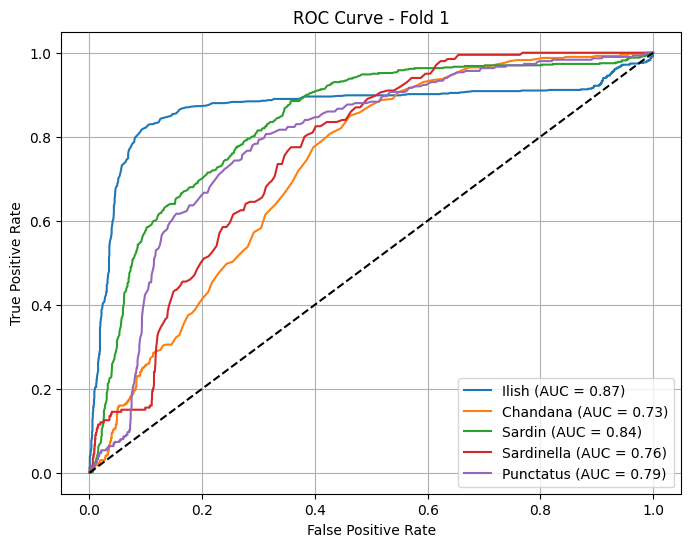

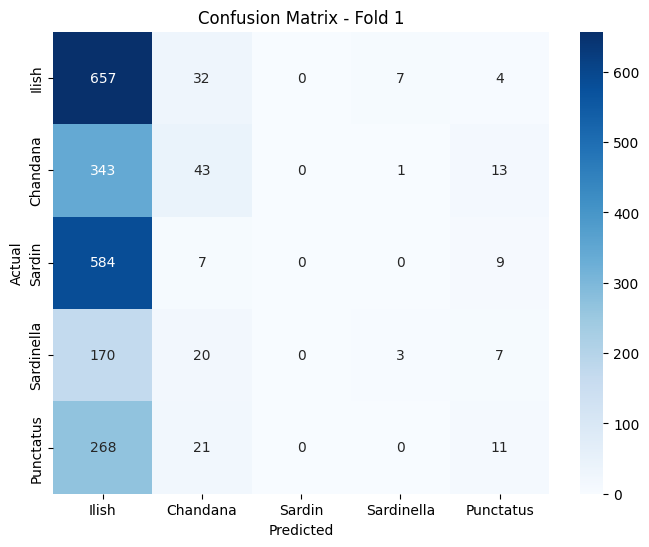

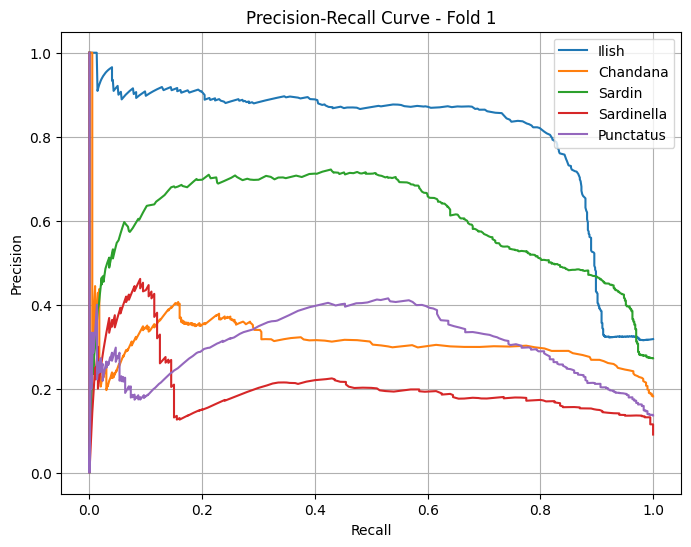

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


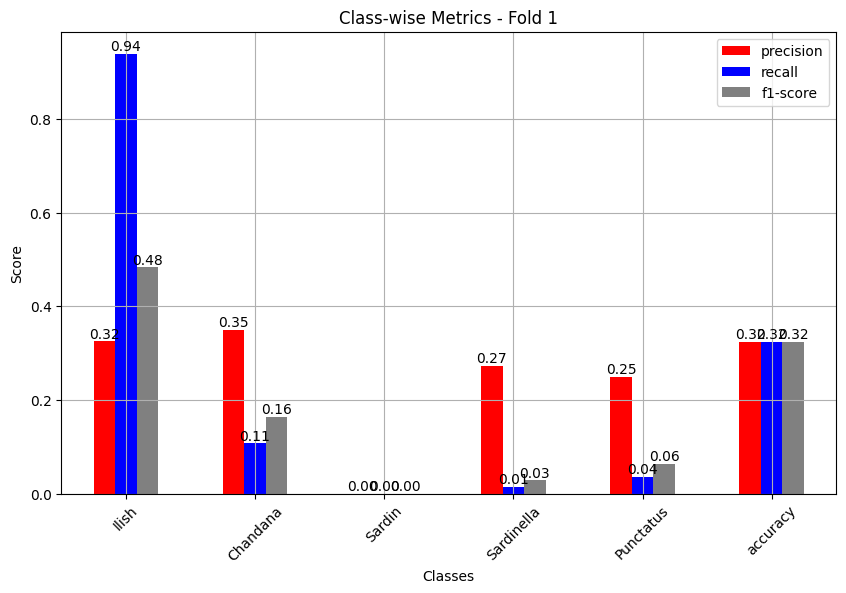

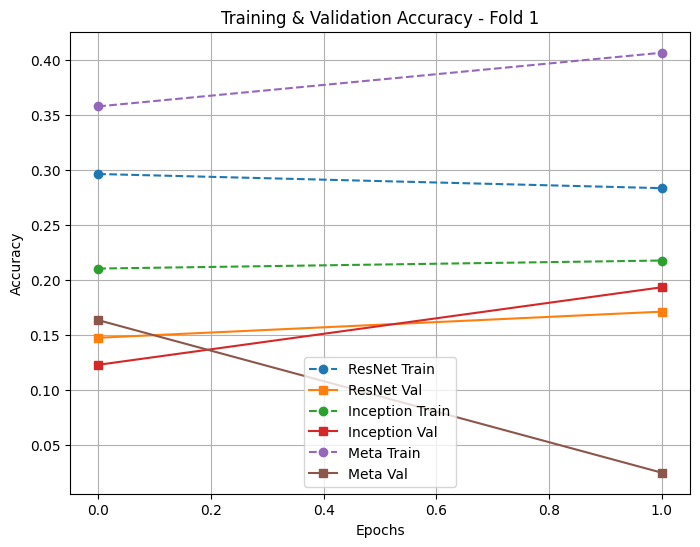

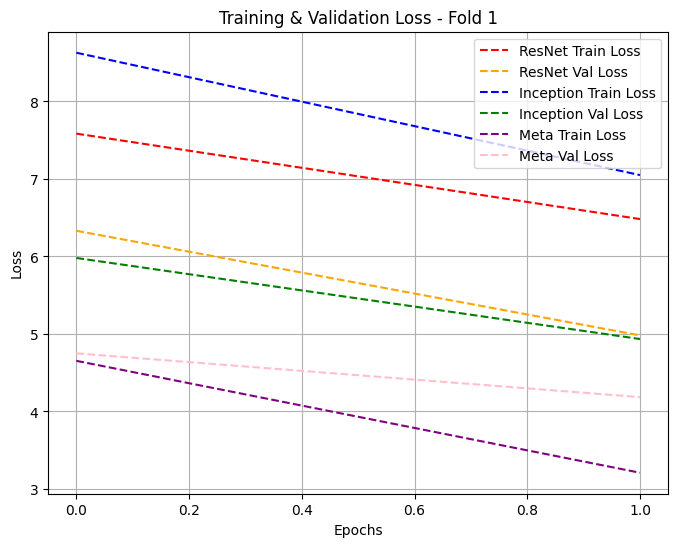

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Classification Report - Fold 1:
              precision    recall  f1-score   support

       Ilish       0.32      0.94      0.48       700
    Chandana       0.35      0.11      0.16       400
      Sardin       0.00      0.00      0.00       600
  Sardinella       0.27      0.01      0.03       200
   Punctatus       0.25      0.04      0.06       300

    accuracy                           0.32      2200
   macro avg       0.24      0.22      0.15      2200
weighted avg       0.23      0.32      0.19      2200


Evaluating Fold 2:
275/275 ━━━━━━━━━━━━━━━━━━━━ 4s 11ms/step
275/275 ━━━━━━━━━━━━━━━━━━━━ 3s 8ms/step
275/275 ━━━━━━━━━━━━━━━━━━━━ 1s 1ms/step


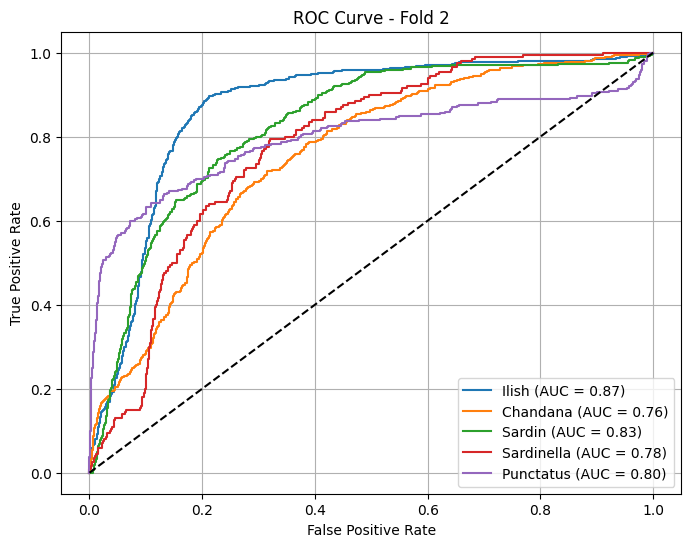

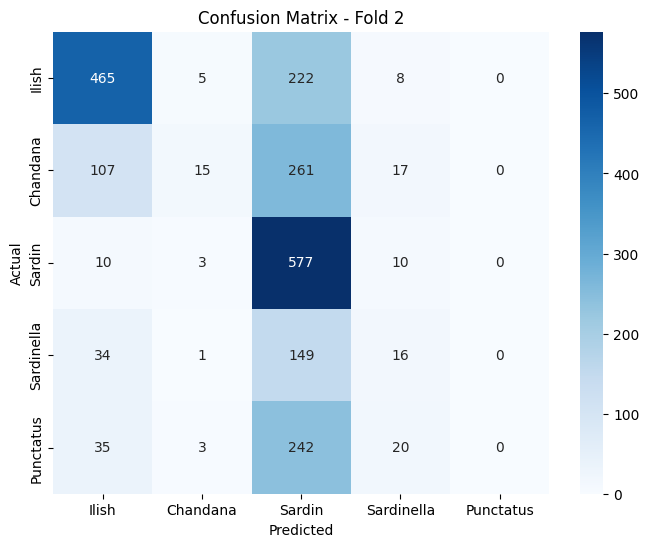

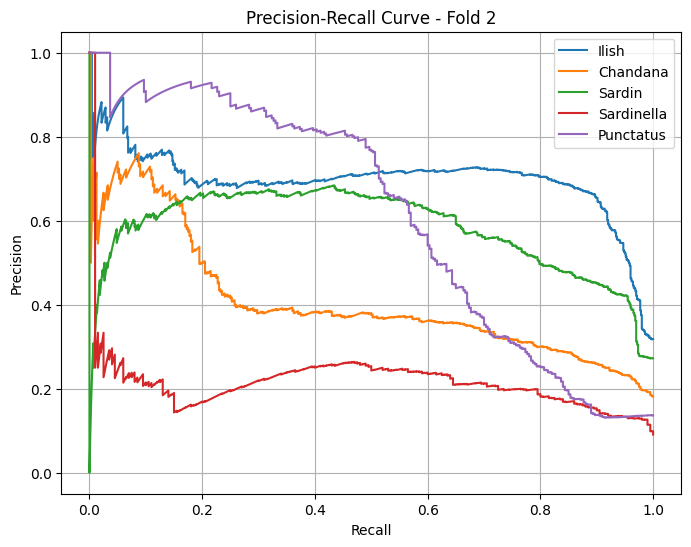

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


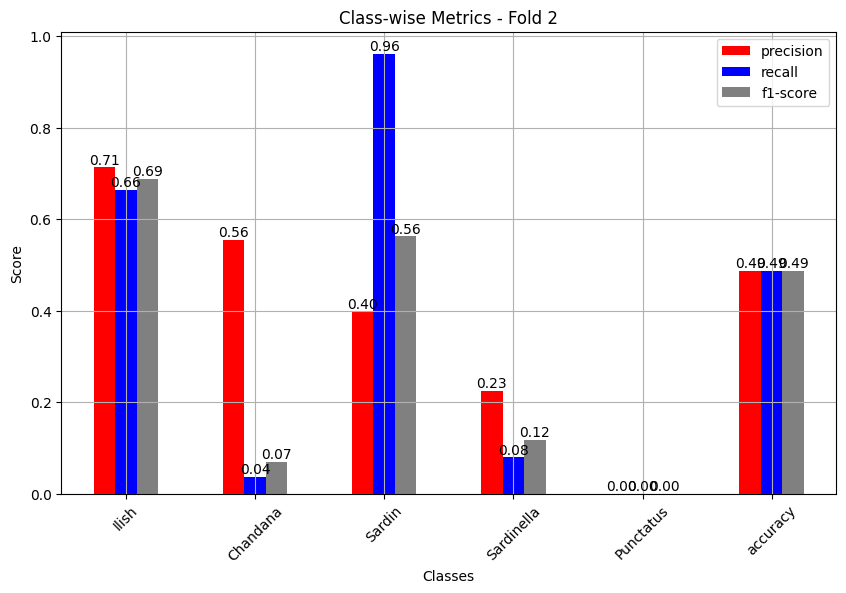

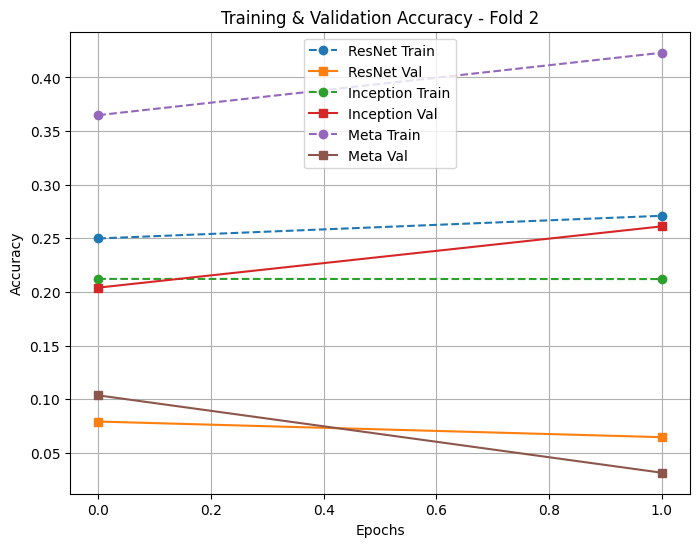

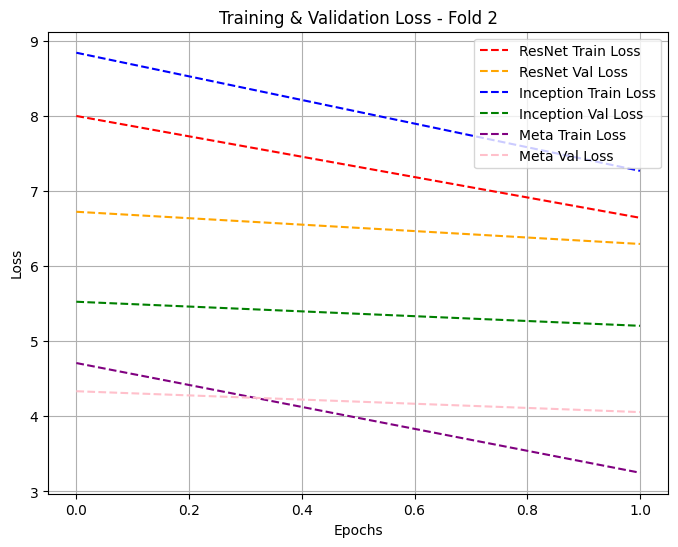

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


Classification Report - Fold 2:
              precision    recall  f1-score   support

       Ilish       0.71      0.66      0.69       700
    Chandana       0.56      0.04      0.07       400
      Sardin       0.40      0.96      0.56       600
  Sardinella       0.23      0.08      0.12       200
   Punctatus       0.00      0.00      0.00       300

    accuracy                           0.49      2200
   macro avg       0.38      0.35      0.29      2200
weighted avg       0.46      0.49      0.40      2200


Combined Results for All Folds:


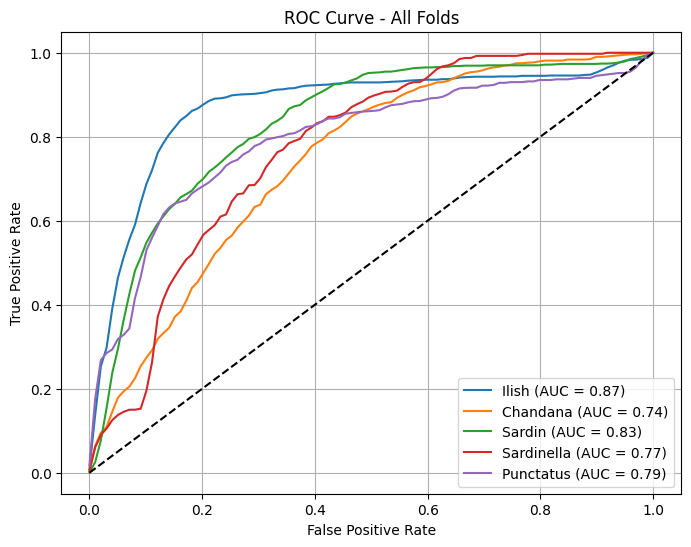

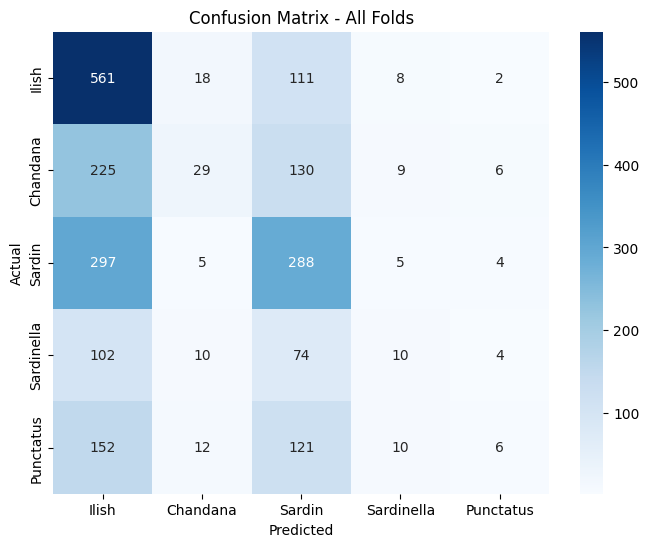

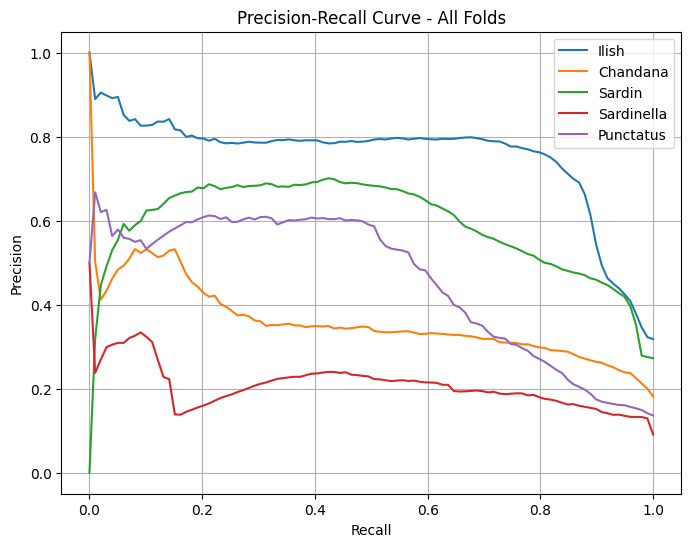

/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/m

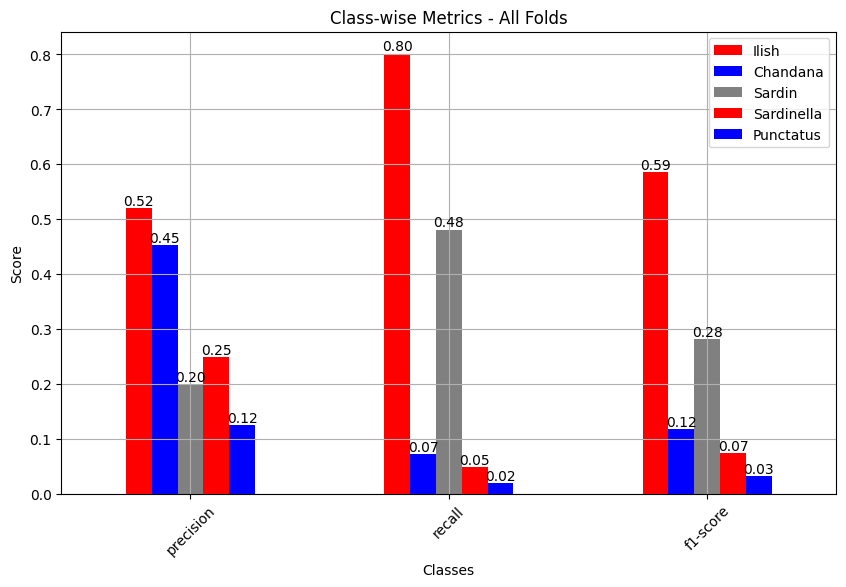

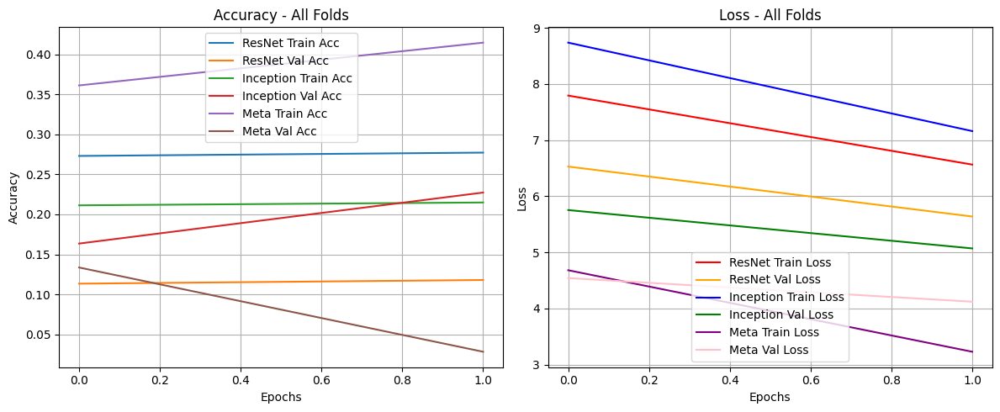


Final Combined Report (Meta-Model Ensemble):
              precision    recall  f1-score   support

       Ilish       0.35      0.95      0.51       700
    Chandana       0.35      0.09      0.14       400
      Sardin       0.62      0.15      0.24       600
  Sardinella       0.24      0.07      0.10       200
   Punctatus       0.00      0.00      0.00       300

    accuracy                           0.37      2200
   macro avg       0.31      0.25      0.20      2200
weighted avg       0.37      0.37      0.26      2200

Final Accuracy: 0.3655, F1-Score: 0.2636


/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/usr/local/lib/python3.11/dist-packages/sklearn/metrics/_classification.py:1565: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


In [ ]:
# Install required packages
!pip install imbalanced-learn

import numpy as np
import tensorflow as tf
from tensorflow.keras.applications import ResNet50, InceptionV3
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, LeakyReLU, BatchNormalization, Input, Concatenate
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
from tensorflow.keras.optimizers import AdamW
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.regularizers import l2
from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.metrics import roc_curve, auc, confusion_matrix, precision_recall_curve, classification_report, accuracy_score, f1_score
from imblearn.over_sampling import SMOTE
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
import gc
from collections import Counter

# Enable mixed precision
tf.keras.mixed_precision.set_global_policy('mixed_float16')

# Configure GPU memory growth
gpus = tf.config.experimental.list_physical_devices('GPU')
if gpus:
    for gpu in gpus:
        tf.config.experimental.set_memory_growth(gpu, True)
    print(f"{len(gpus)} GPUs detected.")
else:
    print("No GPU detected. Running on CPU.")

# Parameters
input_shape = (224, 224, 3)
num_classes = 5
batch_size = 8
epochs = 2  # Reduced for quicker testing; increase as needed
k_folds = 2
class_labels = ['Ilish', 'Chandana', 'Sardin', 'Sardinella', 'Punctatus']

# Assuming X and Y are loaded (replace with your data loading logic)
# Example placeholder: X = np.random.rand(100, 224, 224, 3), Y = np.random.randint(0, 5, 100)
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=42)

# Normalize in batches (commented out)
# def normalize_in_batches(data, batch_size=1000):
#     data = data.astype('float32')
#     for i in range(0, len(data), batch_size):
#         data[i:min(i + batch_size, len(data))] /= 255.0
#     return data

# X_train_scaled = normalize_in_batches(X_train)
# X_test_scaled = normalize_in_batches(X_test)
X_train_scaled = X_train  # Use raw data as-is
X_test_scaled = X_test    # Use raw data as-is

# Apply SMOTE
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_train_resampled, Y_train_resampled = smote.fit_resample(X_train_scaled.reshape(X_train_scaled.shape[0], -1), Y_train)
X_train_resampled = X_train_resampled.reshape(-1, 224, 224, 3)
print("Class distribution after SMOTE:", Counter(Y_train_resampled))

# Image Augmentation
datagen = ImageDataGenerator(rotation_range=20, width_shift_range=0.2, height_shift_range=0.2, shear_range=0.2,
                             zoom_range=0.2, horizontal_flip=True, fill_mode="nearest")

def batch_generator(X, Y, batch_size=8):
    size = X.shape[0]
    while True:
        indices = np.random.permutation(size)
        for start in range(0, size, batch_size):
            batch_idx = indices[start:min(start + batch_size, size)]
            X_batch, Y_batch = X[batch_idx], Y[batch_idx]
            augmented_images = next(datagen.flow(X_batch, shuffle=False, batch_size=batch_size))
            yield augmented_images, Y_batch  # Sparse labels for sparse_categorical_crossentropy

# Define simplified base model
def create_base_model(input_shape=(224, 224, 3), model_type='ResNet'):
    if model_type == 'ResNet':
        base_model = ResNet50(weights='imagenet', include_top=False, input_shape=input_shape)
    elif model_type == 'Inception':
        base_model = InceptionV3(weights='imagenet', include_top=False, input_shape=input_shape)

    for layer in base_model.layers[:-5]:  # Unfreeze fewer layers to save memory
        layer.trainable = False
    for layer in base_model.layers[-5:]:
        layer.trainable = True

    x = base_model.output
    x = GlobalAveragePooling2D()(x)
    x = Dense(128, kernel_regularizer=l2(0.01))(x)  # Reduced from 256
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.1)(x)
    x = Dropout(0.3)(x)  # Reduced dropout to save memory

    model = Model(inputs=base_model.input, outputs=x)
    model.compile(optimizer=AdamW(learning_rate=0.0005, weight_decay=0.004),
                  loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

# Simplified meta-model
def create_meta_model(input_shape=(128*2,), num_classes=5):  # Reduced input size from 256*2
    input_layer = Input(shape=input_shape)
    x = Dense(256, kernel_regularizer=l2(0.01))(input_layer)  # Reduced from 512
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.1)(x)
    x = Dropout(0.3)(x)

    x = Dense(128, kernel_regularizer=l2(0.01))(x)  # Simplified, no residual
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.1)(x)
    x = Dropout(0.3)(x)

    output_layer = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=input_layer, outputs=output_layer)
    model.compile(optimizer=AdamW(learning_rate=0.0005, weight_decay=0.004),
                  loss='sparse_categorical_crossentropy', metrics=['accuracy'])
    return model

# K-Fold Training for Base Models and Meta-Model
def train_with_kfold(X_train, Y_train, X_test, Y_test, k=2, batch_size=8, epochs=2):
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
    base_histories = {'ResNet': [], 'Inception': []}
    meta_histories = []
    trained_base_models = {'ResNet': [], 'Inception': []}
    trained_meta_models = []

    with tf.device('/GPU:0'):
        for fold_no, (train_idx, val_idx) in enumerate(skf.split(X_train, Y_train), 1):
            print(f"\nTraining Fold {fold_no}/{k}")
            X_train_fold, X_val_fold = X_train[train_idx], X_train[val_idx]
            Y_train_fold, Y_val_fold = Y_train[train_idx], Y_train[val_idx]

            # Train ResNet50
            resnet_model = create_base_model(input_shape, model_type='ResNet')
            train_gen = batch_generator(X_train_fold, Y_train_fold, batch_size)
            val_gen = batch_generator(X_val_fold, Y_val_fold, batch_size)
            callbacks = [
                ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=2),
                ModelCheckpoint(f'best_resnet_fold_{fold_no}.weights.h5', save_best_only=True,
                                monitor='val_accuracy', mode='max', save_weights_only=True),
                EarlyStopping(monitor='val_accuracy', patience=3, restore_best_weights=True)
            ]
            resnet_history = resnet_model.fit(train_gen, validation_data=val_gen, epochs=epochs,
                                              steps_per_epoch=len(X_train_fold)//batch_size,
                                              validation_steps=len(X_val_fold)//batch_size,
                                              callbacks=callbacks, verbose=1)
            base_histories['ResNet'].append(resnet_history)
            trained_base_models['ResNet'].append(resnet_model)

            # Train InceptionV3
            inception_model = create_base_model(input_shape, model_type='Inception')
            inception_history = inception_model.fit(train_gen, validation_data=val_gen, epochs=epochs,
                                                    steps_per_epoch=len(X_train_fold)//batch_size,
                                                    validation_steps=len(X_val_fold)//batch_size,
                                                    callbacks=callbacks, verbose=1)
            base_histories['Inception'].append(inception_history)
            trained_base_models['Inception'].append(inception_model)

            # Generate intermediate features for meta-model training
            resnet_features = resnet_model.predict(X_val_fold, batch_size=batch_size)
            inception_features = inception_model.predict(X_val_fold, batch_size=batch_size)
            meta_input = np.concatenate([resnet_features, inception_features], axis=1)

            # Train meta-model
            meta_model = create_meta_model(input_shape=(128*2,), num_classes=num_classes)
            meta_history = meta_model.fit(meta_input, Y_val_fold, epochs=epochs, batch_size=batch_size,
                                          validation_split=0.2, callbacks=callbacks, verbose=1)
            meta_histories.append(meta_history)
            trained_meta_models.append(meta_model)

            tf.keras.backend.clear_session()
            gc.collect()

    return base_histories, meta_histories, trained_base_models, trained_meta_models

# Evaluation and Plotting with Fold-Wise and Combined Visualizations
def evaluate_and_plot(base_histories, meta_histories, X_test, Y_test, trained_base_models, trained_meta_models):
    ensemble_probs_list, ensemble_preds_list = [], []

    with tf.device('/GPU:0'):
        # Fold-wise Visualization
        print("\nFold-by-Fold Visualizations:")
        for fold_no, (resnet_model, inception_model, meta_model, base_resnet_hist, base_inception_hist, meta_hist) in enumerate(
            zip(trained_base_models['ResNet'], trained_base_models['Inception'], trained_meta_models,
                base_histories['ResNet'], base_histories['Inception'], meta_histories), 1):

            print(f"\nEvaluating Fold {fold_no}:")
            resnet_features = resnet_model.predict(X_test, batch_size=8)
            inception_features = inception_model.predict(X_test, batch_size=8)
            meta_input = np.concatenate([resnet_features, inception_features], axis=1)
            probs = meta_model.predict(meta_input, batch_size=8)
            preds = np.argmax(probs, axis=1)
            ensemble_probs_list.append(probs)
            ensemble_preds_list.append(preds)

            # Fold-wise Plots
            def plot_roc_fold(Y_test, probs, fold_no):
                plt.figure(figsize=(8, 6))
                for i, cls in enumerate(class_labels):
                    fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                    roc_auc = auc(fpr, tpr)
                    plt.plot(fpr, tpr, label=f'{cls} (AUC = {roc_auc:.2f})')
                plt.plot([0, 1], [0, 1], 'k--')
                plt.title(f'ROC Curve - Fold {fold_no}')
                plt.xlabel('False Positive Rate')
                plt.ylabel('True Positive Rate')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_confusion_fold(Y_test, preds, fold_no):
                cm = confusion_matrix(Y_test, preds)
                plt.figure(figsize=(8, 6))
                sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
                plt.title(f'Confusion Matrix - Fold {fold_no}')
                plt.xlabel('Predicted')
                plt.ylabel('Actual')
                plt.show()

            def plot_pr_fold(Y_test, probs, fold_no):
                plt.figure(figsize=(8, 6))
                for i, cls in enumerate(class_labels):
                    precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                    plt.plot(recall, precision, label=cls)
                plt.title(f'Precision-Recall Curve - Fold {fold_no}')
                plt.xlabel('Recall')
                plt.ylabel('Precision')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_metrics_fold(Y_test, preds, fold_no):
                report = classification_report(Y_test, preds, target_names=class_labels, output_dict=True)
                df = pd.DataFrame(report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]
                df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
                for p in plt.gca().patches:
                    plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
                plt.title(f'Class-wise Metrics - Fold {fold_no}')
                plt.xlabel('Classes')
                plt.ylabel('Score')
                plt.xticks(rotation=45)
                plt.legend()
                plt.grid()
                plt.show()

            def plot_acc_fold(history_dict, fold_no):
                plt.figure(figsize=(8, 6))
                plt.plot(history_dict['ResNet'].history['accuracy'], label='ResNet Train', linestyle='dashed', marker='o')
                plt.plot(history_dict['ResNet'].history['val_accuracy'], label='ResNet Val', marker='s')
                plt.plot(history_dict['Inception'].history['accuracy'], label='Inception Train', linestyle='dashed', marker='o')
                plt.plot(history_dict['Inception'].history['val_accuracy'], label='Inception Val', marker='s')
                plt.plot(history_dict['Meta'].history['accuracy'], label='Meta Train', linestyle='dashed', marker='o')
                plt.plot(history_dict['Meta'].history['val_accuracy'], label='Meta Val', marker='s')
                plt.title(f'Training & Validation Accuracy - Fold {fold_no}')
                plt.xlabel('Epochs')
                plt.ylabel('Accuracy')
                plt.legend()
                plt.grid()
                plt.show()

            def plot_loss_fold(history_dict, fold_no):
                plt.figure(figsize=(8, 6))
                plt.plot(history_dict['ResNet'].history['loss'], label='ResNet Train Loss', linestyle='dashed', color='red')
                plt.plot(history_dict['ResNet'].history['val_loss'], label='ResNet Val Loss', linestyle='dashed', color='orange')
                plt.plot(history_dict['Inception'].history['loss'], label='Inception Train Loss', linestyle='dashed', color='blue')
                plt.plot(history_dict['Inception'].history['val_loss'], label='Inception Val Loss', linestyle='dashed', color='green')
                plt.plot(history_dict['Meta'].history['loss'], label='Meta Train Loss', linestyle='dashed', color='purple')
                plt.plot(history_dict['Meta'].history['val_loss'], label='Meta Val Loss', linestyle='dashed', color='pink')
                plt.title(f'Training & Validation Loss - Fold {fold_no}')
                plt.xlabel('Epochs')
                plt.ylabel('Loss')
                plt.legend()
                plt.grid()
                plt.show()

            def print_report_fold(Y_test, preds, fold_no):
                report = classification_report(Y_test, preds, target_names=class_labels)
                print(f"Classification Report - Fold {fold_no}:\n{report}")

            # Execute Fold-wise Plots
            history_dict = {'ResNet': base_resnet_hist, 'Inception': base_inception_hist, 'Meta': meta_hist}
            plot_roc_fold(Y_test, probs, fold_no)
            plot_confusion_fold(Y_test, preds, fold_no)
            plot_pr_fold(Y_test, probs, fold_no)
            plot_metrics_fold(Y_test, preds, fold_no)
            plot_acc_fold(history_dict, fold_no)
            plot_loss_fold(history_dict, fold_no)
            print_report_fold(Y_test, preds, fold_no)

            tf.keras.backend.clear_session()
            gc.collect()

        # Combined Visualizations
        print("\nCombined Results for All Folds:")
        def plot_roc_combined(Y_test, probs_list):
            plt.figure(figsize=(8, 6))
            mean_fpr = np.linspace(0, 1, 100)
            for i, cls in enumerate(class_labels):
                tprs, aucs = [], []
                for probs in probs_list:
                    fpr, tpr, _ = roc_curve((Y_test == i).astype(int), probs[:, i])
                    tprs.append(np.interp(mean_fpr, fpr, tpr))
                    aucs.append(auc(fpr, tpr))
                mean_tpr = np.mean(tprs, axis=0)
                mean_auc = auc(mean_fpr, mean_tpr)
                plt.plot(mean_fpr, mean_tpr, label=f'{cls} (AUC = {mean_auc:.2f})')
            plt.plot([0, 1], [0, 1], 'k--')
            plt.title('ROC Curve - All Folds')
            plt.xlabel('False Positive Rate')
            plt.ylabel('True Positive Rate')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_confusion_combined(Y_test, preds_list):
            mean_cm = np.mean([confusion_matrix(Y_test, preds) for preds in preds_list], axis=0)
            plt.figure(figsize=(8, 6))
            sns.heatmap(mean_cm, annot=True, fmt='.0f', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
            plt.title('Confusion Matrix - All Folds')
            plt.xlabel('Predicted')
            plt.ylabel('Actual')
            plt.show()

        def plot_pr_combined(Y_test, probs_list):
            plt.figure(figsize=(8, 6))
            mean_recall = np.linspace(0, 1, 100)
            for i, cls in enumerate(class_labels):
                precisions = []
                for probs in probs_list:
                    precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), probs[:, i])
                    precisions.append(np.interp(mean_recall[::-1], recall[::-1], precision[::-1])[::-1])
                mean_precision = np.mean(precisions, axis=0)
                plt.plot(mean_recall, mean_precision, label=cls)
            plt.title('Precision-Recall Curve - All Folds')
            plt.xlabel('Recall')
            plt.ylabel('Precision')
            plt.legend()
            plt.grid()
            plt.show()

        def plot_metrics_combined(Y_test, preds_list):
            reports = [classification_report(Y_test, preds, target_names=class_labels, output_dict=True) for preds in preds_list]
            mean_report = {metric: {cls: np.mean([r[cls][metric] for r in reports]) for cls in class_labels}
                           for metric in ['precision', 'recall', 'f1-score']}
            df = pd.DataFrame(mean_report).T
            df.plot(kind='bar', color=['red', 'blue', 'gray'], figsize=(10, 6))
            for p in plt.gca().patches:
                plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width()/2, p.get_height()), ha='center', va='bottom')
            plt.title('Class-wise Metrics - All Folds')
            plt.xlabel('Classes')
            plt.ylabel('Score')
            plt.xticks(rotation=45)
            plt.legend()
            plt.grid()
            plt.show()

        def plot_acc_loss_combined(base_histories, meta_histories):
            plt.figure(figsize=(12, 5))
            mean_resnet_acc = np.mean([h.history['accuracy'] for h in base_histories['ResNet']], axis=0)
            mean_resnet_val_acc = np.mean([h.history['val_accuracy'] for h in base_histories['ResNet']], axis=0)
            mean_inception_acc = np.mean([h.history['accuracy'] for h in base_histories['Inception']], axis=0)
            mean_inception_val_acc = np.mean([h.history['val_accuracy'] for h in base_histories['Inception']], axis=0)
            mean_meta_acc = np.mean([h.history['accuracy'] for h in meta_histories], axis=0)
            mean_meta_val_acc = np.mean([h.history['val_accuracy'] for h in meta_histories], axis=0)

            mean_resnet_loss = np.mean([h.history['loss'] for h in base_histories['ResNet']], axis=0)
            mean_resnet_val_loss = np.mean([h.history['val_loss'] for h in base_histories['ResNet']], axis=0)
            mean_inception_loss = np.mean([h.history['loss'] for h in base_histories['Inception']], axis=0)
            mean_inception_val_loss = np.mean([h.history['val_loss'] for h in base_histories['Inception']], axis=0)
            mean_meta_loss = np.mean([h.history['loss'] for h in meta_histories], axis=0)
            mean_meta_val_loss = np.mean([h.history['val_loss'] for h in meta_histories], axis=0)

            plt.subplot(1, 2, 1)
            plt.plot(mean_resnet_acc, label='ResNet Train Acc')
            plt.plot(mean_resnet_val_acc, label='ResNet Val Acc')
            plt.plot(mean_inception_acc, label='Inception Train Acc')
            plt.plot(mean_inception_val_acc, label='Inception Val Acc')
            plt.plot(mean_meta_acc, label='Meta Train Acc')
            plt.plot(mean_meta_val_acc, label='Meta Val Acc')
            plt.title('Accuracy - All Folds')
            plt.xlabel('Epochs')
            plt.ylabel('Accuracy')
            plt.legend()
            plt.grid()

            plt.subplot(1, 2, 2)
            plt.plot(mean_resnet_loss, label='ResNet Train Loss', color='red')
            plt.plot(mean_resnet_val_loss, label='ResNet Val Loss', color='orange')
            plt.plot(mean_inception_loss, label='Inception Train Loss', color='blue')
            plt.plot(mean_inception_val_loss, label='Inception Val Loss', color='green')
            plt.plot(mean_meta_loss, label='Meta Train Loss', color='purple')
            plt.plot(mean_meta_val_loss, label='Meta Val Loss', color='pink')
            plt.title('Loss - All Folds')
            plt.xlabel('Epochs')
            plt.ylabel('Loss')
            plt.legend()
            plt.grid()
            plt.tight_layout()
            plt.show()

        def print_final_report(Y_test, probs_list):
            mean_probs = np.mean(probs_list, axis=0)
            final_preds = np.argmax(mean_probs, axis=1)
            report = classification_report(Y_test, final_preds, target_names=class_labels)
            acc = accuracy_score(Y_test, final_preds)
            f1 = f1_score(Y_test, final_preds, average='weighted')
            print(f"\nFinal Combined Report (Meta-Model Ensemble):\n{report}")
            print(f"Final Accuracy: {acc:.4f}, F1-Score: {f1:.4f}")

        # Execute Combined Plots
        plot_roc_combined(Y_test, ensemble_probs_list)
        plot_confusion_combined(Y_test, ensemble_preds_list)
        plot_pr_combined(Y_test, ensemble_probs_list)
        plot_metrics_combined(Y_test, ensemble_preds_list)
        plot_acc_loss_combined(base_histories, meta_histories)
        print_final_report(Y_test, ensemble_probs_list)

# Train and Evaluate
base_histories, meta_histories, trained_base_models, trained_meta_models = train_with_kfold(
    X_train_resampled, Y_train_resampled, X_test_scaled, Y_test)
print("Training Complete with Meta-Model Ensemble.")
evaluate_and_plot(base_histories, meta_histories, X_test_scaled, Y_test, trained_base_models, trained_meta_models)

#Single Transfer Model Training

#CNN


Evaluating Fold 1:
69/69 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step


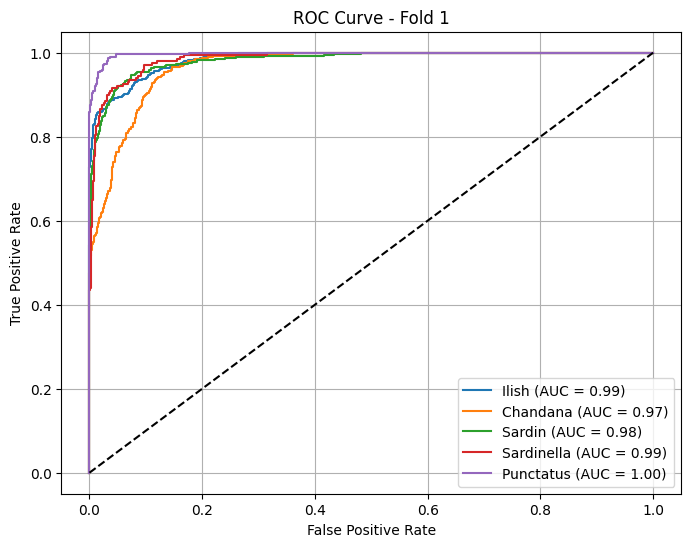

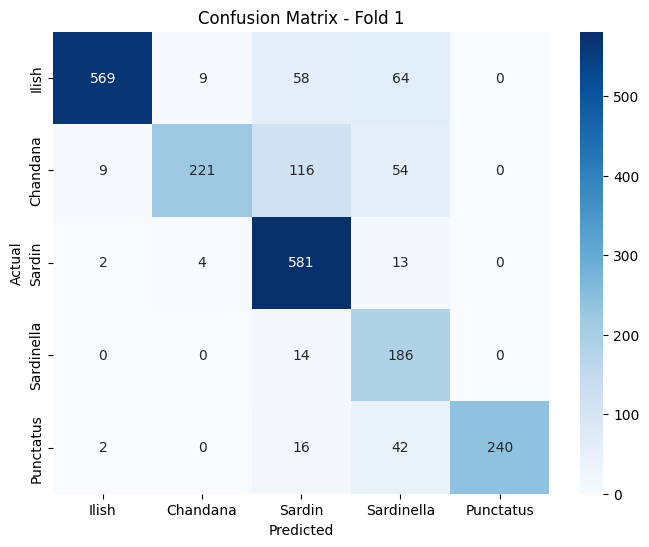

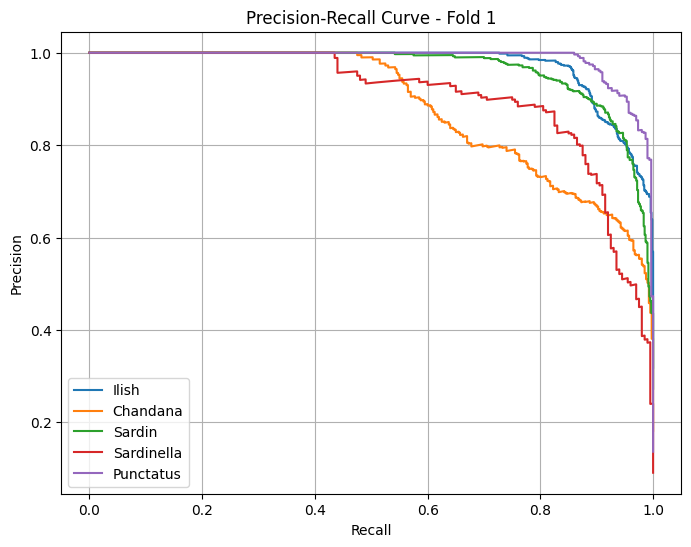

<Figure size 1000x600 with 0 Axes>

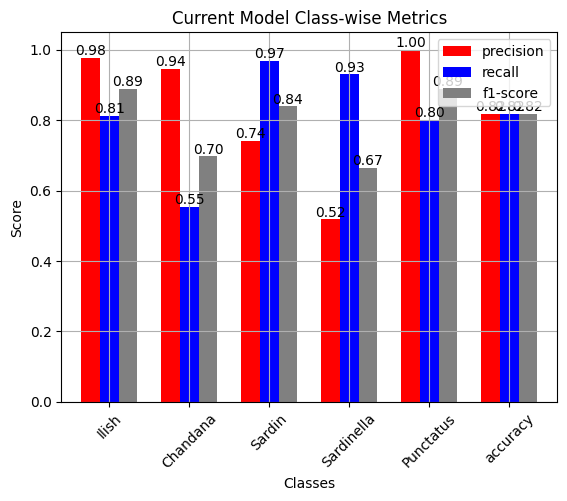

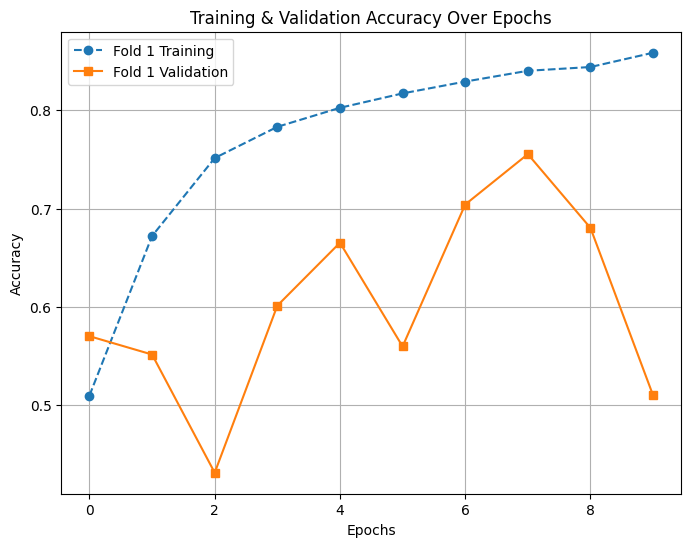

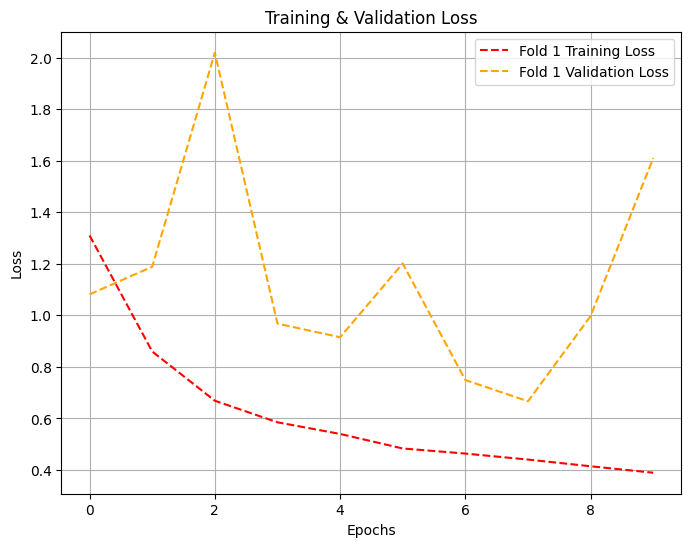

Classification Report - Fold 1:
               precision    recall  f1-score   support

       Ilish       0.98      0.81      0.89       700
    Chandana       0.94      0.55      0.70       400
      Sardin       0.74      0.97      0.84       600
  Sardinella       0.52      0.93      0.67       200
   Punctatus       1.00      0.80      0.89       300

    accuracy                           0.82      2200
   macro avg       0.84      0.81      0.80      2200
weighted avg       0.87      0.82      0.82      2200


Evaluating Fold 2:
69/69 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step


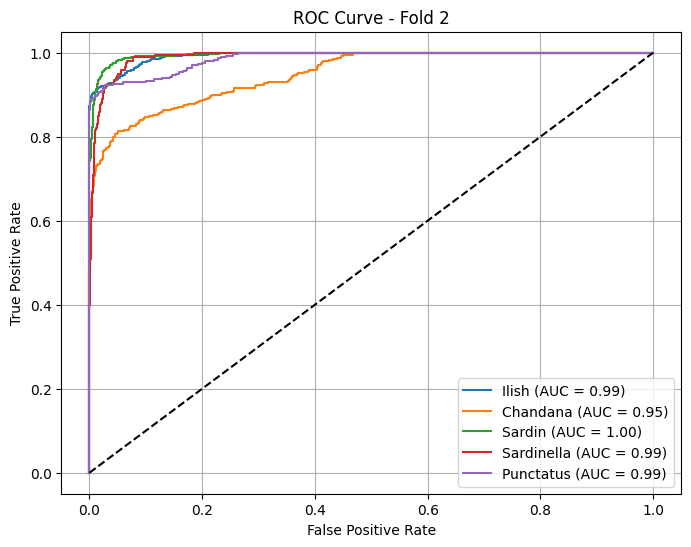

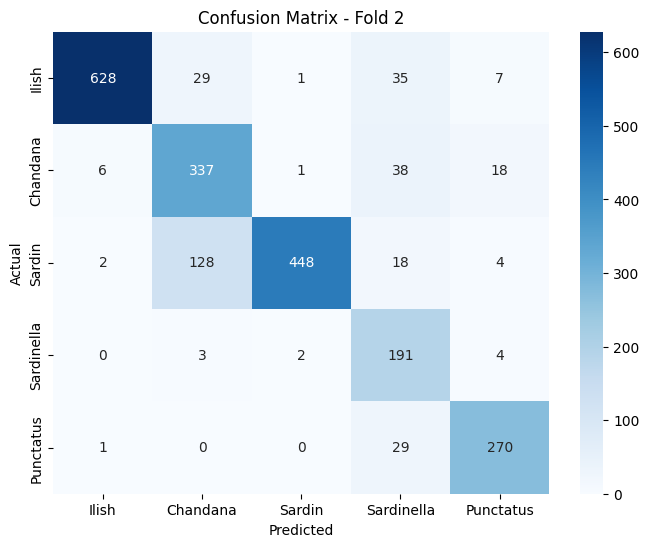

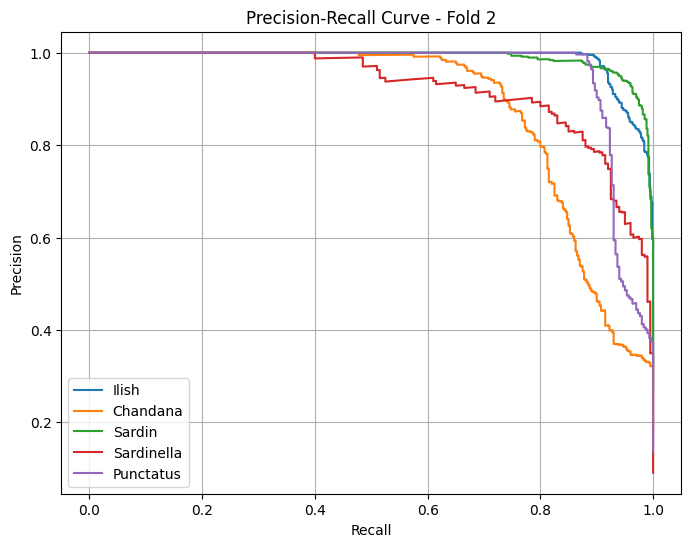

<Figure size 1000x600 with 0 Axes>

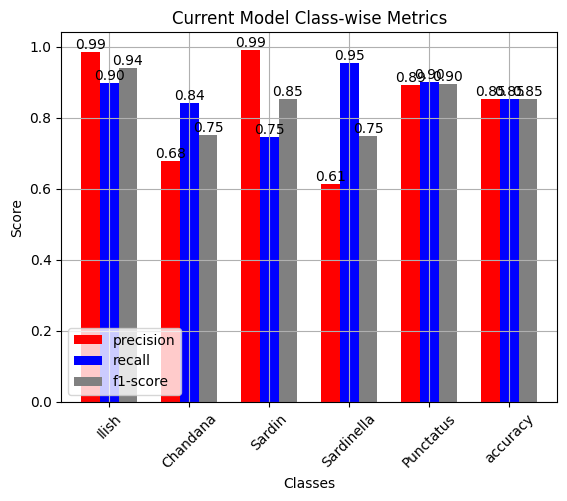

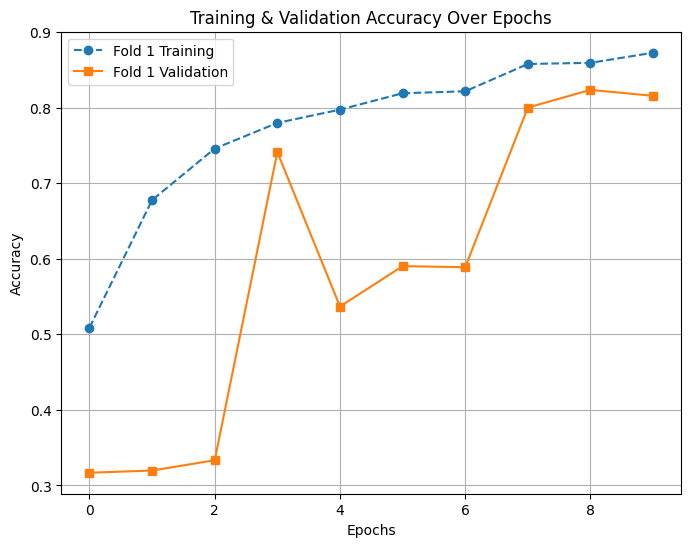

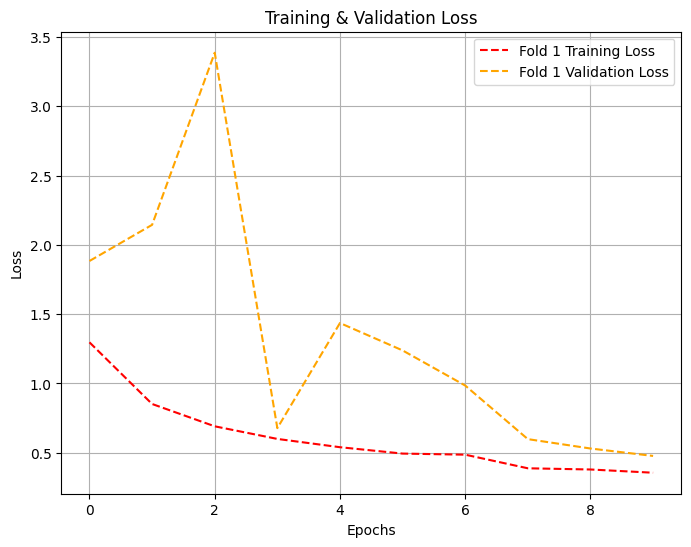

Classification Report - Fold 2:
               precision    recall  f1-score   support

       Ilish       0.99      0.90      0.94       700
    Chandana       0.68      0.84      0.75       400
      Sardin       0.99      0.75      0.85       600
  Sardinella       0.61      0.95      0.75       200
   Punctatus       0.89      0.90      0.90       300

    accuracy                           0.85      2200
   macro avg       0.83      0.87      0.84      2200
weighted avg       0.88      0.85      0.86      2200


Evaluating Fold 3:
69/69 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step


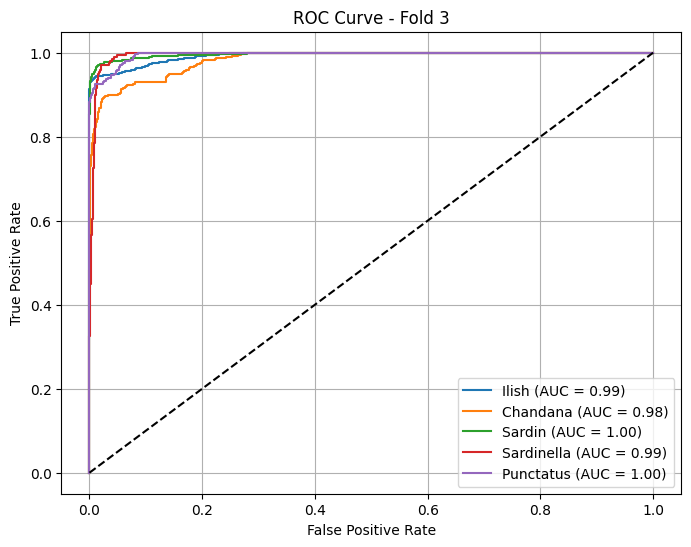

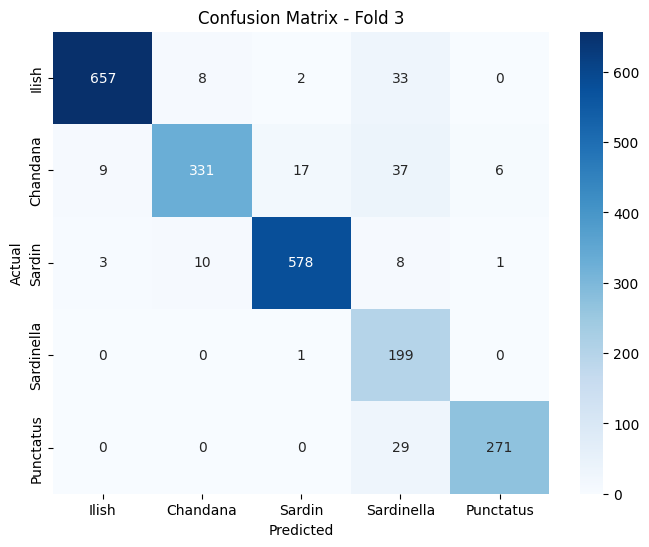

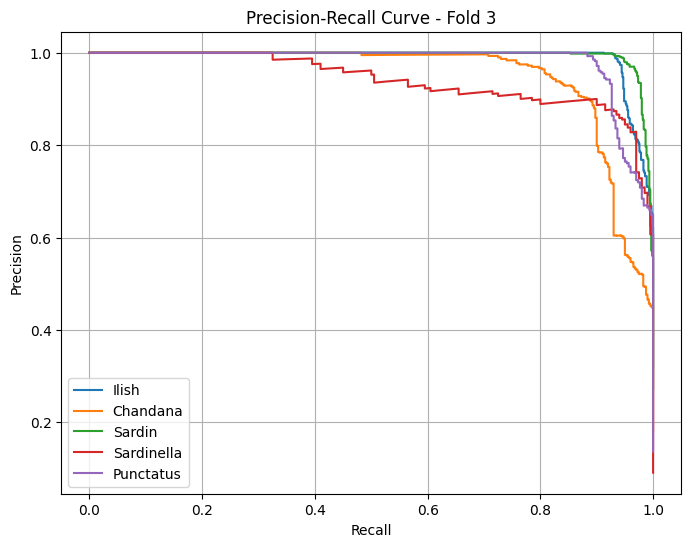

<Figure size 1000x600 with 0 Axes>

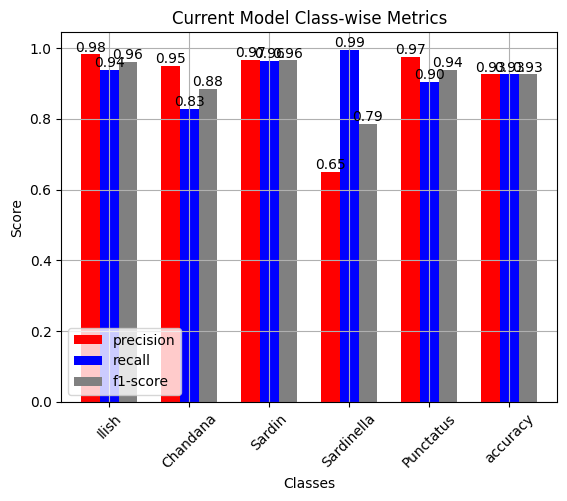

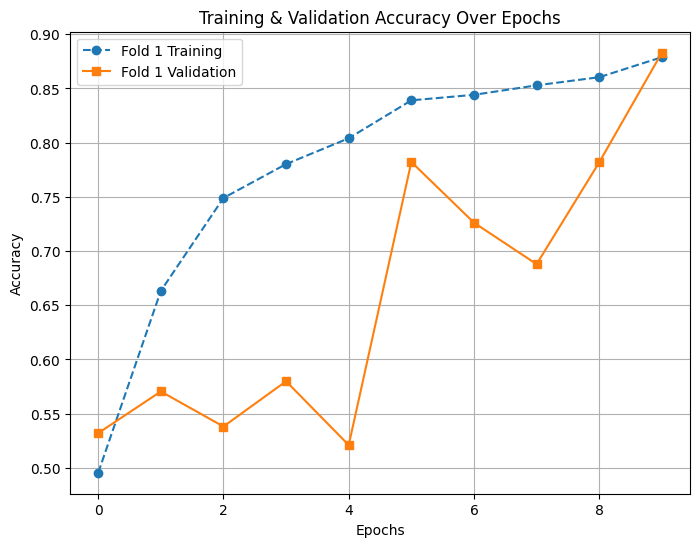

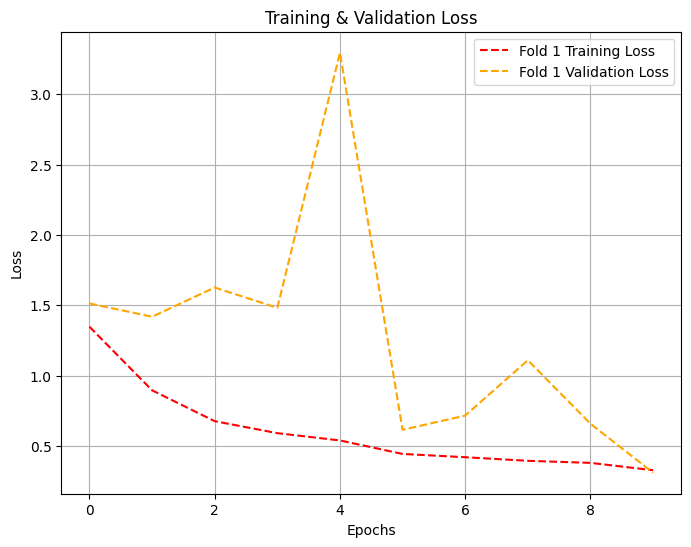

Classification Report - Fold 3:
               precision    recall  f1-score   support

       Ilish       0.98      0.94      0.96       700
    Chandana       0.95      0.83      0.88       400
      Sardin       0.97      0.96      0.96       600
  Sardinella       0.65      0.99      0.79       200
   Punctatus       0.97      0.90      0.94       300

    accuracy                           0.93      2200
   macro avg       0.90      0.93      0.91      2200
weighted avg       0.94      0.93      0.93      2200


Evaluating Fold 4:
69/69 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step


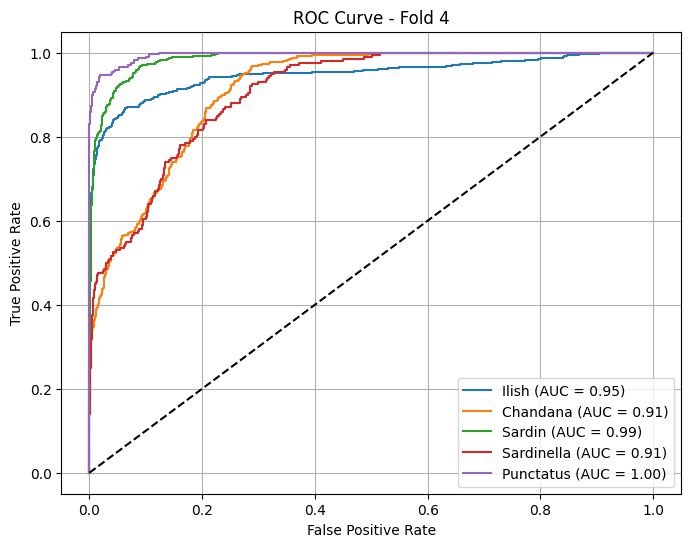

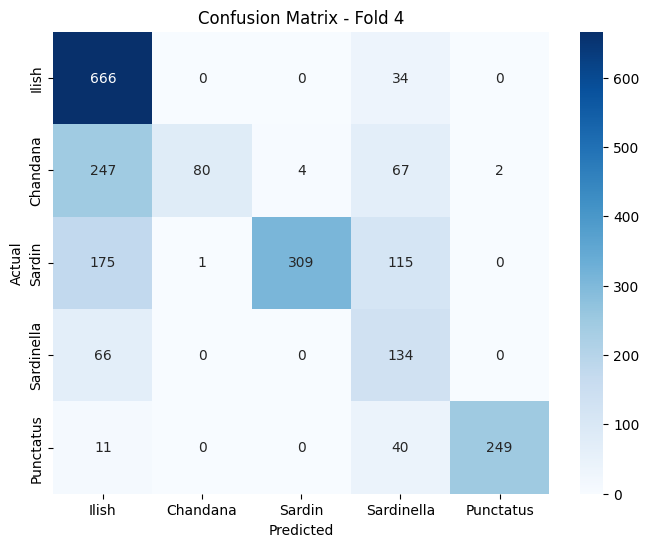

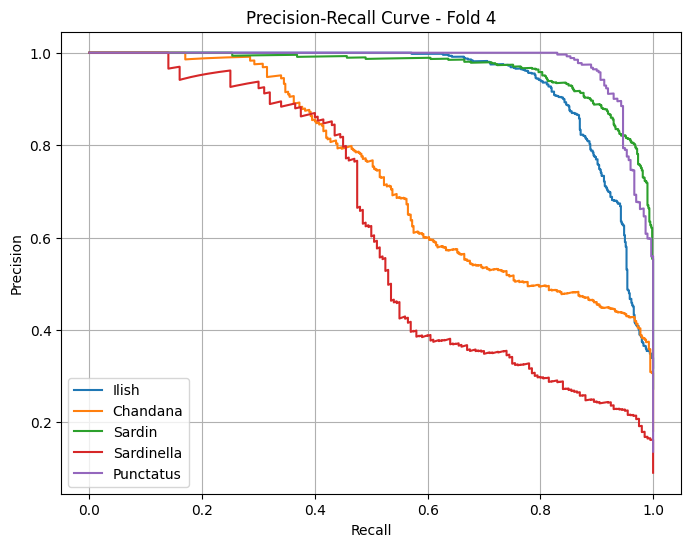

<Figure size 1000x600 with 0 Axes>

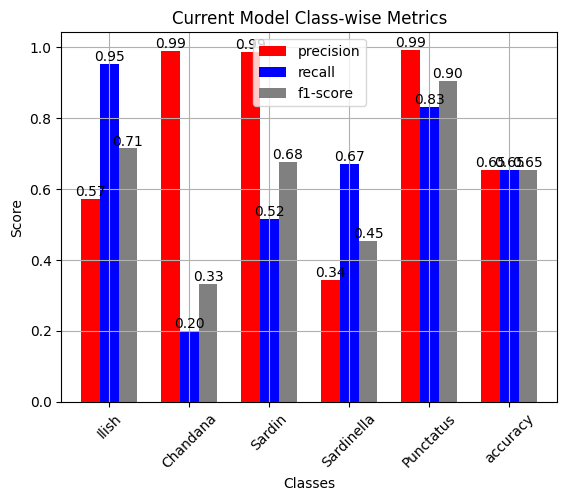

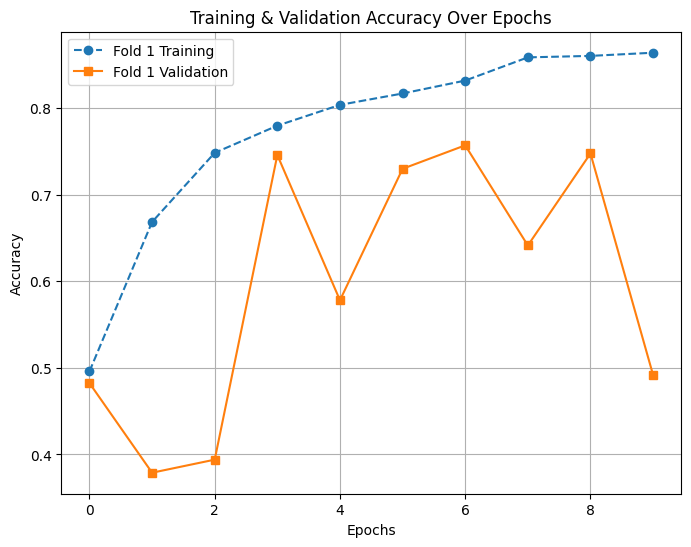

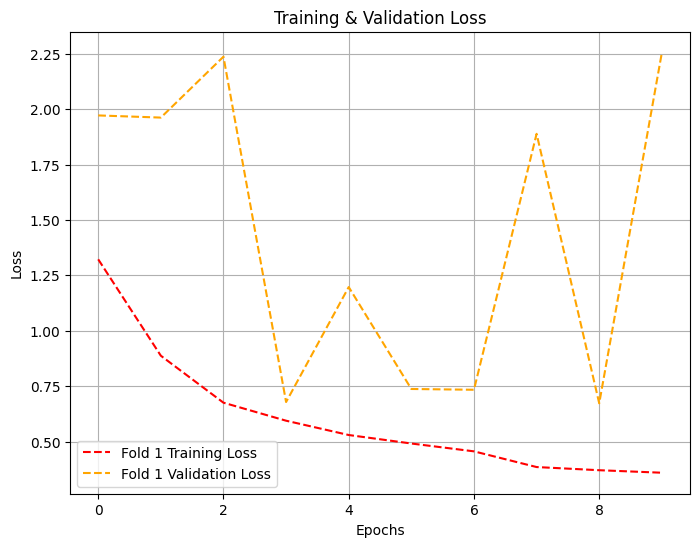

Classification Report - Fold 4:
               precision    recall  f1-score   support

       Ilish       0.57      0.95      0.71       700
    Chandana       0.99      0.20      0.33       400
      Sardin       0.99      0.52      0.68       600
  Sardinella       0.34      0.67      0.45       200
   Punctatus       0.99      0.83      0.90       300

    accuracy                           0.65      2200
   macro avg       0.78      0.63      0.62      2200
weighted avg       0.80      0.65      0.64      2200


Evaluating Fold 5:
69/69 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step


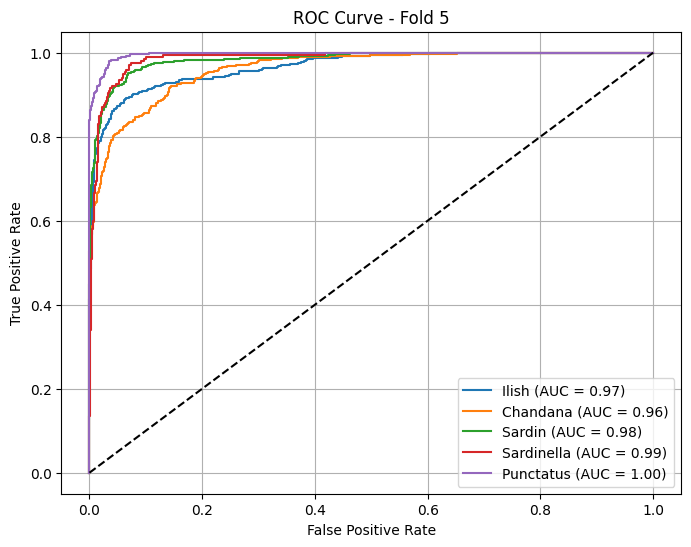

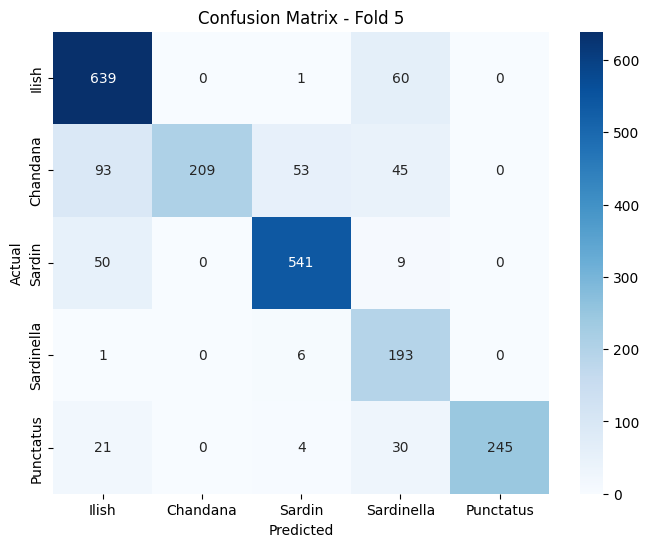

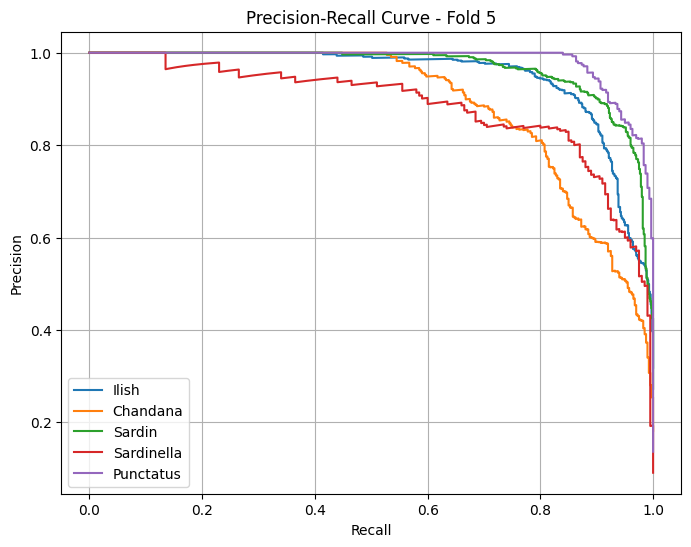

<Figure size 1000x600 with 0 Axes>

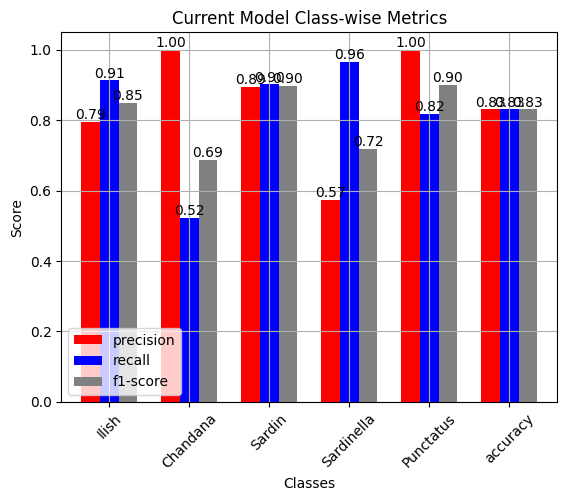

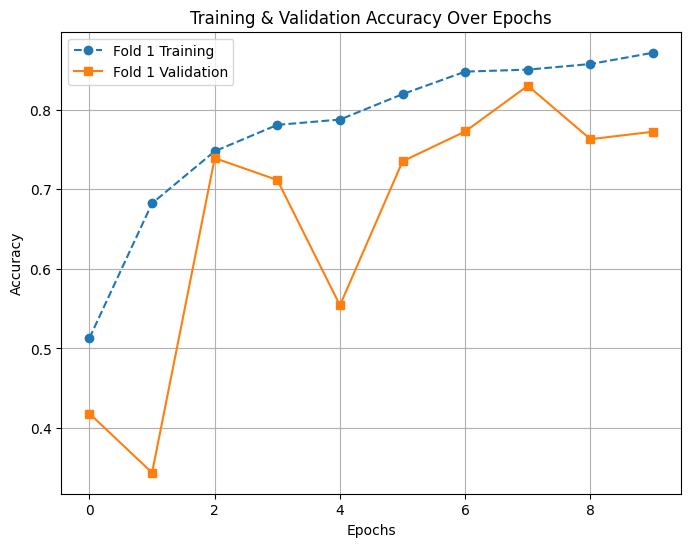

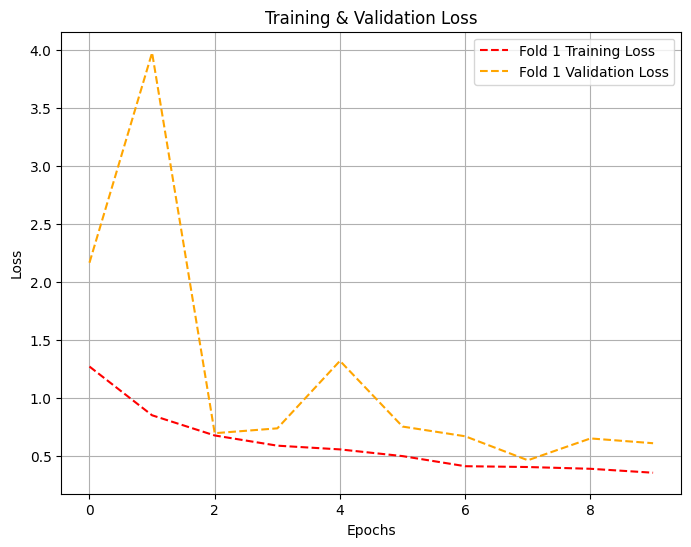

Classification Report - Fold 5:
               precision    recall  f1-score   support

       Ilish       0.79      0.91      0.85       700
    Chandana       1.00      0.52      0.69       400
      Sardin       0.89      0.90      0.90       600
  Sardinella       0.57      0.96      0.72       200
   Punctatus       1.00      0.82      0.90       300

    accuracy                           0.83      2200
   macro avg       0.85      0.82      0.81      2200
weighted avg       0.87      0.83      0.83      2200

Results in a Single Plot....

Processing Fold 1:
69/69 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step

Processing Fold 2:
69/69 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step

Processing Fold 3:
69/69 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step

Processing Fold 4:
69/69 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step

Processing Fold 5:
69/69 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step


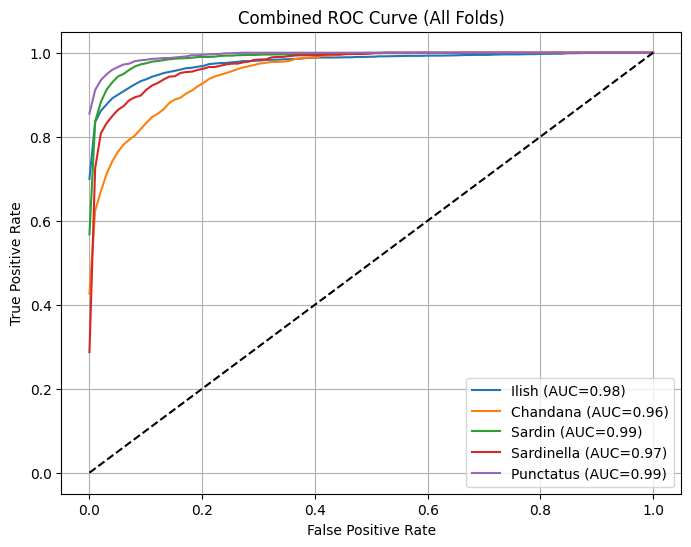

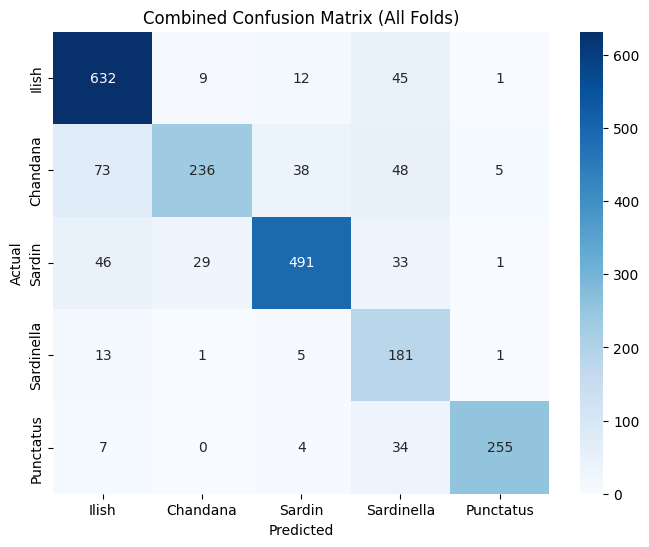

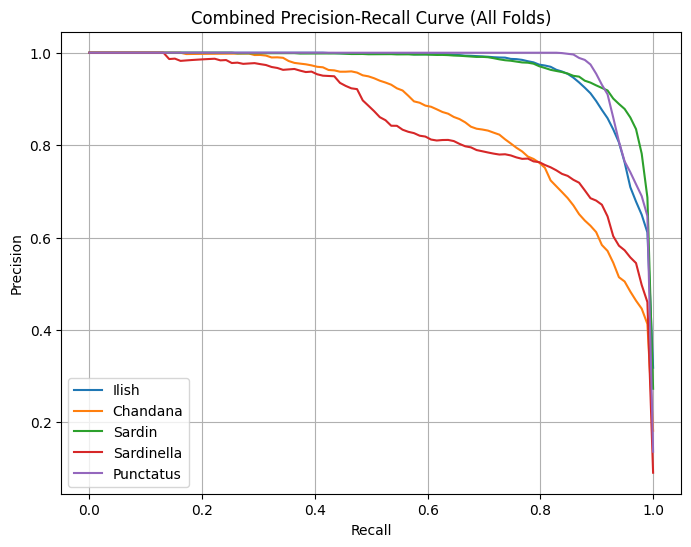

69/69 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step
69/69 ━━━━━━━━━━━━━━━━━━━━ 1s 14ms/step
69/69 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step
69/69 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step
69/69 ━━━━━━━━━━━━━━━━━━━━ 1s 15ms/step


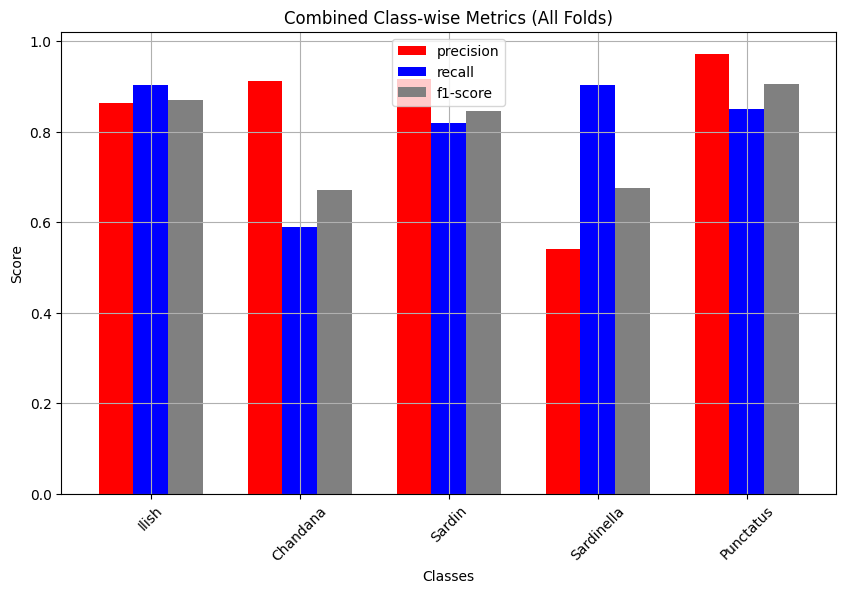

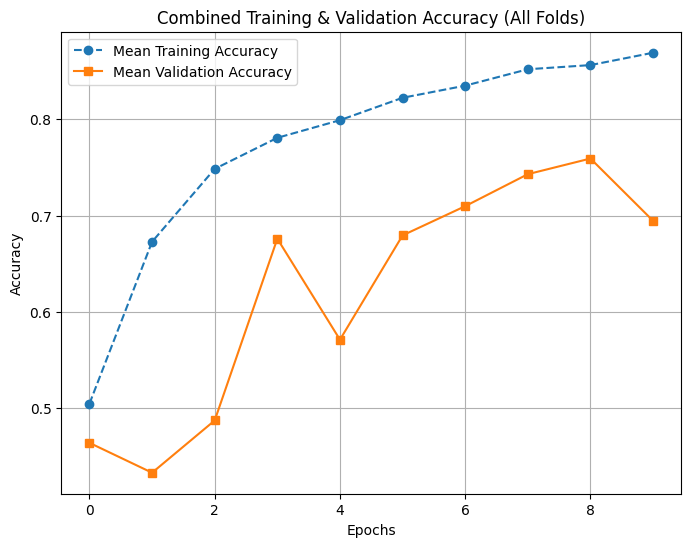

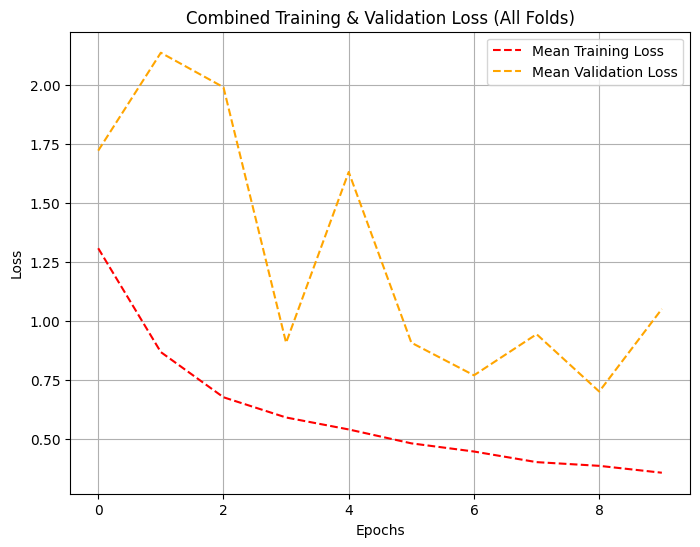


Final Combined Classification Report Across All Folds:
               precision    recall  f1-score   support

       Ilish       0.82      0.90      0.86      3500
    Chandana       0.86      0.59      0.70      2000
      Sardin       0.89      0.82      0.85      3000
  Sardinella       0.53      0.90      0.67      1000
   Punctatus       0.97      0.85      0.91      1500

    accuracy                           0.82     11000
   macro avg       0.81      0.81      0.80     11000
weighted avg       0.84      0.82      0.82     11000


Final Model Performance (Averaged across all folds):
Final Test Accuracy: 0.8156
Final F1 Score: 0.7971


In [ ]:
import numpy as np
import pandas as pd
import tensorflow as tf
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter

from tensorflow.keras.models import Model, Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout, BatchNormalization, LeakyReLU, GlobalAveragePooling2D
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.metrics import accuracy_score, roc_curve, auc, precision_recall_curve, confusion_matrix, f1_score, classification_report
from imblearn.over_sampling import SMOTE

# Assuming X and Y are already loaded and preprocessed
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=42)

# Apply SMOTE
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_train_resampled, Y_train_resampled = smote.fit_resample(X_train.reshape(X_train.shape[0], -1), Y_train)
X_train_resampled = X_train_resampled.reshape(-1, 224, 224, 3)

# Parameters
input_shape = (224, 224, 3)
num_classes = 5
batch_size = 32
epochs = 5
k_folds = 5

# Data Augmentation
datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode="nearest"
)

def batch_generator(X, Y, batch_size=32):
    size = X.shape[0]
    used_indices = set()  # Track used samples per fold
    while True:
        indices = np.random.permutation(size)
        for start in range(0, size, batch_size):
            end = min(start + batch_size, size)
            batch_idx = indices[start:end]

            # Ensure no overlap across folds
            unique_batch_idx = [idx for idx in batch_idx if idx not in used_indices]
            used_indices.update(unique_batch_idx)

            if not unique_batch_idx:  # If all data is used, reset for next epoch
                used_indices.clear()
                continue

            X_batch, Y_batch = X[unique_batch_idx], Y[unique_batch_idx]
            augmented_images = next(datagen.flow(X_batch, shuffle=False, batch_size=len(unique_batch_idx)))
            yield augmented_images, to_categorical(Y_batch, num_classes)



# ------------------ Custom CNN Model ------------------
def create_custom_cnn(input_shape=(224, 224, 3), num_classes=5):
    model = Sequential([
        Conv2D(32, (3, 3), activation=None, input_shape=input_shape, padding="same"),
        BatchNormalization(),
        LeakyReLU(alpha=0.1),
        MaxPooling2D(pool_size=(2, 2)),

        Conv2D(64, (3, 3), activation=None, padding="same"),
        BatchNormalization(),
        LeakyReLU(alpha=0.1),
        MaxPooling2D(pool_size=(2, 2)),

        Conv2D(128, (3, 3), activation=None, padding="same"),
        BatchNormalization(),
        LeakyReLU(alpha=0.1),
        MaxPooling2D(pool_size=(2, 2)),

        Conv2D(256, (3, 3), activation=None, padding="same"),
        BatchNormalization(),
        LeakyReLU(alpha=0.1),
        MaxPooling2D(pool_size=(2, 2)),

        Flatten(),
        Dense(256),
        BatchNormalization(),
        LeakyReLU(alpha=0.1),
        Dropout(0.5),

        Dense(128),
        BatchNormalization(),
        LeakyReLU(alpha=0.1),
        Dropout(0.5),

        Dense(num_classes, activation='softmax')
    ])

    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    return model

# ------------------ Training with K-Fold Cross Validation ------------------
def train_with_kfold(X_train, Y_train, X_test, Y_test, k=5, batch_size=32, epochs=10):
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
    histories = []
    ensemble_predictions = np.zeros((X_test.shape[0], num_classes))

    for fold_no, (train_idx, val_idx) in enumerate(skf.split(X_train, Y_train), 1):
        print(f"Training Fold {fold_no}/{k}")

        X_train_fold, X_val_fold = X_train[train_idx], X_train[val_idx]
        Y_train_fold, Y_val_fold = Y_train[train_idx], Y_train[val_idx]

        cnn_model = create_custom_cnn()
        train_generator = batch_generator(X_train_fold, Y_train_fold, batch_size)
        val_generator = batch_generator(X_val_fold, Y_val_fold, batch_size)

        callbacks = [
            ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, verbose=1),
            ModelCheckpoint(f'best_model_cnn_fold_{fold_no}.keras', save_best_only=True, monitor='val_loss', mode='min'),
            EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
        ]

        history = cnn_model.fit(train_generator, validation_data=val_generator, epochs=epochs, verbose=1,
                                callbacks=callbacks, steps_per_epoch=len(X_train_fold)//batch_size,
                                validation_steps=len(X_val_fold)//batch_size)
        histories.append(history)

        cnn_preds = cnn_model.predict(X_test)
        ensemble_predictions += cnn_preds

    ensemble_predictions /= k
    final_classes = np.argmax(ensemble_predictions, axis=1)
    accuracy = np.mean(final_classes == Y_test)
    print(f"Final Model Accuracy: {accuracy * 100:.2f}%")
    return final_classes, histories

# ------------------ Start Training ------------------
final_predictions, history_dict = train_with_kfold(X_train_resampled, Y_train_resampled, X_test, Y_test, k=k_folds)
print("Training Complete. CNN Model is ready!")







import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from sklearn.metrics import roc_curve, auc, confusion_matrix, precision_recall_curve, classification_report, accuracy_score, f1_score

# Define class labels
class_labels = ['Ilish', 'Chandana', 'Sardin', 'Sardinella', 'Punctatus']

# Function to plot ROC curve
def plot_roc_curve(Y_test, Y_test_pred_prob, class_labels, fold_no):
    plt.figure(figsize=(8, 6))
    for i in range(len(class_labels)):
        y_true_binary = (Y_test == i).astype(int)
        y_score = Y_test_pred_prob[:, i]
        fpr, tpr, _ = roc_curve(y_true_binary, y_score)
        roc_auc = auc(fpr, tpr)
        plt.plot(fpr, tpr, label=f'{class_labels[i]} (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], 'k--')
    plt.title(f'ROC Curve - Fold {fold_no}')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend()
    plt.grid()
    plt.show()

# Function to plot Confusion Matrix
def plot_confusion_matrix(Y_test, Y_test_pred, class_labels, fold_no):
    conf_matrix = confusion_matrix(Y_test, Y_test_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
    plt.title(f'Confusion Matrix - Fold {fold_no}')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show()

# Function to plot Precision-Recall curve
def plot_precision_recall_curve(Y_test, Y_test_pred_prob, class_labels, fold_no):
    plt.figure(figsize=(8, 6))
    for i in range(len(class_labels)):
        precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), Y_test_pred_prob[:, i])
        plt.plot(recall, precision, label=f'{class_labels[i]}')
    plt.title(f'Precision-Recall Curve - Fold {fold_no}')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.legend()
    plt.grid()
    plt.show()

# Function to plot Training & Validation Accuracy over epochs
def plot_accuracy(history_list):
    plt.figure(figsize=(8, 6))
    for i, history in enumerate(history_list):
        plt.plot(history.history['accuracy'], label=f'Fold {i+1} Training', linestyle='dashed', marker='o')
        plt.plot(history.history['val_accuracy'], label=f'Fold {i+1} Validation', marker='s')
    plt.title('Training & Validation Accuracy Over Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid()
    plt.show()

# Function to plot Training & Validation Loss over epochs
def plot_loss(history_list):
    plt.figure(figsize=(8, 6))
    for i, history in enumerate(history_list):
        plt.plot(history.history['loss'], label=f'Fold {i+1} Training Loss', linestyle='dashed', color='red')
        plt.plot(history.history['val_loss'], label=f'Fold {i+1} Validation Loss', linestyle='dashed', color='orange')
    plt.title('Training & Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid()
    plt.show()



# Function to compare class-wise metrics
def plot_classwise_metrics(Y_test, Y_test_pred, prev_Y_test_pred=None):
    report = classification_report(Y_test, Y_test_pred, target_names=class_labels, output_dict=True)
    df_report = pd.DataFrame(report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]
    colors = {'precision': 'red', 'recall': 'blue', 'f1-score': 'gray'}

    # Current model class-wise metrics
    plt.figure(figsize=(10, 6))
    df_report.plot(kind='bar', width=0.7, color=[colors[col] for col in df_report.columns])
    for p in plt.gca().patches:
        plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width() / 2, p.get_height()),
                           ha='center', va='bottom', fontsize=10, color='black')
    plt.title('Current Model Class-wise Metrics')
    plt.xlabel('Classes')
    plt.ylabel('Score')
    plt.xticks(rotation=45)
    plt.legend()
    plt.grid()
    plt.show()

    # Previous model class-wise metrics (if available)
    if prev_Y_test_pred is not None:
        prev_report = classification_report(Y_test, prev_Y_test_pred, target_names=class_labels, output_dict=True)
        prev_df_report = pd.DataFrame(prev_report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]

        plt.figure(figsize=(10, 6))
        prev_df_report.plot(kind='bar', width=0.7, color=['pink', 'lightblue', 'lightgray'])
        for p in plt.gca().patches:
            plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width() / 2, p.get_height()),
                               ha='center', va='bottom', fontsize=10, color='black')
        plt.title('Previous Model Class-wise Metrics')
        plt.xlabel('Classes')
        plt.ylabel('Score')
        plt.xticks(rotation=45)
        plt.legend()
        plt.grid()
        plt.show()

# Function to display classification report
def print_classification_report(Y_test, Y_test_pred, class_labels, fold_no):
    report = classification_report(Y_test, Y_test_pred, target_names=class_labels)
    print(f"Classification Report - Fold {fold_no}:\n", report)

# Generate all individual plots for each fold
for fold_no, history in enumerate(history_dict, 1):
    print(f"\nEvaluating Fold {fold_no}:")

    # Get predictions for the current fold (final_predictions for this fold)
    fold_predictions = history.model.predict(X_test)  # or use history if separate fold predictions are stored
    plot_roc_curve(Y_test, fold_predictions, class_labels, fold_no)
    plot_confusion_matrix(Y_test, np.argmax(fold_predictions, axis=1), class_labels, fold_no)
    plot_precision_recall_curve(Y_test, fold_predictions, class_labels, fold_no)
    plot_classwise_metrics(Y_test, np.argmax(fold_predictions, axis=1))  # Class-wise metrics for the current fold
    # Call accuracy and loss plot functions for the current fold
    plot_accuracy([history])  # Pass a list with a single fold's history
    plot_loss([history])  # Pass a list with a single fold's history
    #Classification Report
    print_classification_report(Y_test, np.argmax(fold_predictions, axis=1), class_labels, fold_no)







#For All the Results in a single plot
print("Results in a Single Plot....")

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from sklearn.metrics import roc_curve, auc, precision_recall_curve, confusion_matrix, classification_report

# Initialize lists to store results from all folds
all_fpr, all_tpr, all_roc_auc = [], [], []
all_precisions, all_recalls = [], []
all_conf_matrices = []
history_list = []
all_predictions = []
all_true_labels = []

num_classes = len(class_labels)

for fold_no, history in enumerate(history_dict, 1):
    print(f"\nProcessing Fold {fold_no}:")

    # Get predictions and true labels
    fold_predictions = history.model.predict(X_test)
    fold_pred_labels = np.argmax(fold_predictions, axis=1)

    all_predictions.append(fold_predictions)
    all_true_labels.append(Y_test)

    # Store training history
    history_list.append(history)

    # ROC Curve
    fold_fpr, fold_tpr, fold_auc = [], [], []
    for i in range(num_classes):
        y_true_binary = (Y_test == i).astype(int)
        y_score = fold_predictions[:, i]
        fpr, tpr, _ = roc_curve(y_true_binary, y_score)
        fold_fpr.append(fpr)
        fold_tpr.append(tpr)
        fold_auc.append(auc(fpr, tpr))

    all_fpr.append(fold_fpr)
    all_tpr.append(fold_tpr)
    all_roc_auc.append(fold_auc)

    # Precision-Recall Curve
    fold_precisions, fold_recalls = [], []
    for i in range(num_classes):
        precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), fold_predictions[:, i])
        fold_precisions.append(precision)
        fold_recalls.append(recall)

    all_precisions.append(fold_precisions)
    all_recalls.append(fold_recalls)

    # Confusion Matrix
    all_conf_matrices.append(confusion_matrix(Y_test, fold_pred_labels))

# Convert predictions and true labels to numpy arrays
all_predictions = np.vstack(all_predictions)
all_true_labels = np.hstack(all_true_labels)

# **1. Combined ROC Curve**
plt.figure(figsize=(8, 6))
mean_fpr = np.linspace(0, 1, 100)  # Standard length for interpolation

for i in range(num_classes):
    interpolated_tprs = [np.interp(mean_fpr, all_fpr[j][i], all_tpr[j][i]) for j in range(len(all_fpr))]
    mean_tpr = np.mean(interpolated_tprs, axis=0)
    mean_auc = np.mean([all_roc_auc[j][i] for j in range(len(all_roc_auc))])
    plt.plot(mean_fpr, mean_tpr, label=f'{class_labels[i]} (AUC={mean_auc:.2f})')

plt.plot([0, 1], [0, 1], 'k--')
plt.title('Combined ROC Curve (All Folds)')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.grid()
plt.show()

# **2. Combined Confusion Matrix**
mean_conf_matrix = np.mean(all_conf_matrices, axis=0)
plt.figure(figsize=(8, 6))
sns.heatmap(mean_conf_matrix, annot=True, fmt='.0f', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.title('Combined Confusion Matrix (All Folds)')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# **3. Combined Precision-Recall Curve**
plt.figure(figsize=(8, 6))
for i in range(num_classes):
    interpolated_precisions = [np.interp(mean_fpr, all_recalls[j][i][::-1], all_precisions[j][i][::-1]) for j in range(len(all_recalls))]
    mean_precision = np.mean(interpolated_precisions, axis=0)
    mean_recall = np.linspace(0, 1, 100)
    plt.plot(mean_recall, mean_precision, label=f'{class_labels[i]}')

plt.title('Combined Precision-Recall Curve (All Folds)')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.legend()
plt.grid()
plt.show()

# **4. Combined Class-wise Metrics**
all_reports = [classification_report(Y_test, np.argmax(history.model.predict(X_test), axis=1),
                                     target_names=class_labels, output_dict=True) for history in history_dict]
avg_report = {}
for label in class_labels:
    avg_report[label] = {
        'precision': np.mean([r[label]['precision'] for r in all_reports]),
        'recall': np.mean([r[label]['recall'] for r in all_reports]),
        'f1-score': np.mean([r[label]['f1-score'] for r in all_reports])
    }
df_avg_report = pd.DataFrame(avg_report).transpose()
df_avg_report.plot(kind='bar', width=0.7, figsize=(10, 6), color=['red', 'blue', 'gray'])
plt.title('Combined Class-wise Metrics (All Folds)')
plt.xlabel('Classes')
plt.ylabel('Score')
plt.xticks(rotation=45)
plt.legend()
plt.grid()
plt.show()

# **5. Combined Training & Validation Accuracy**
plt.figure(figsize=(8, 6))
mean_train_acc = np.mean([history.history['accuracy'] for history in history_list], axis=0)
mean_val_acc = np.mean([history.history['val_accuracy'] for history in history_list], axis=0)
plt.plot(mean_train_acc, label='Mean Training Accuracy', linestyle='dashed', marker='o')
plt.plot(mean_val_acc, label='Mean Validation Accuracy', marker='s')
plt.title('Combined Training & Validation Accuracy (All Folds)')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()
plt.show()

# **6. Combined Training & Validation Loss**
plt.figure(figsize=(8, 6))
mean_train_loss = np.mean([history.history['loss'] for history in history_list], axis=0)
mean_val_loss = np.mean([history.history['val_loss'] for history in history_list], axis=0)
plt.plot(mean_train_loss, label='Mean Training Loss', linestyle='dashed', color='red')
plt.plot(mean_val_loss, label='Mean Validation Loss', linestyle='dashed', color='orange')
plt.title('Combined Training & Validation Loss (All Folds)')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()

# **7. Print Combined Classification Report**
final_report = classification_report(all_true_labels, np.argmax(all_predictions, axis=1), target_names=class_labels)
print("\nFinal Combined Classification Report Across All Folds:\n", final_report)



from sklearn.metrics import accuracy_score, f1_score
# Compute final accuracy
final_accuracy = accuracy_score(all_true_labels, np.argmax(all_predictions, axis=1))
# Compute final F1 score (macro average across all classes)
final_f1_score = f1_score(all_true_labels, np.argmax(all_predictions, axis=1), average='macro')
# Print the final model performance
print("\nFinal Model Performance (Averaged across all folds):")
print(f"Final Test Accuracy: {final_accuracy:.4f}")
print(f"Final F1 Score: {final_f1_score:.4f}")

#ResNet50,EfficientNetB0,InceptionV3,MobileNetV2,VGG19

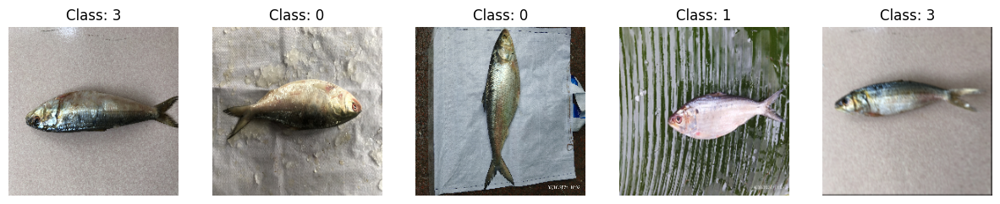

Original class distribution: Counter({np.int64(0): 2800, np.int64(2): 2400, np.int64(1): 1600, np.int64(4): 1200, np.int64(3): 800})
Resampled class distribution: Counter({np.int64(3): 2800, np.int64(0): 2800, np.int64(1): 2800, np.int64(4): 2800, np.int64(2): 2800})
Training Fold 1/5
94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 3s 0us/step


/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Epoch 1/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 164s 412ms/step - accuracy: 0.7320 - loss: 0.7402 - val_accuracy: 0.9019 - val_loss: 0.2962 - learning_rate: 0.0010
Epoch 2/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 134s 384ms/step - accuracy: 0.9098 - loss: 0.2713 - val_accuracy: 0.9120 - val_loss: 0.2624 - learning_rate: 0.0010
Epoch 3/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 133s 380ms/step - accuracy: 0.9291 - loss: 0.2237 - val_accuracy: 0.9404 - val_loss: 0.1766 - learning_rate: 0.0010
Epoch 4/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 136s 389ms/step - accuracy: 0.9472 - loss: 0.1666 - val_accuracy: 0.9548 - val_loss: 0.1426 - learning_rate: 0.0010
Epoch 5/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 129s 369ms/step - accuracy: 0.9477 - loss: 0.1540 - val_accuracy: 0.9540 - val_loss: 0.1242 - learning_rate: 0.0010
Epoch 6/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 123s 351ms/step - accuracy: 0.9496 - loss: 0.1461 - val_accuracy: 0.9544 - val_loss: 0.1252 - learning_rate: 0.0010
Epoch 7/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 114s 326ms/step - accura

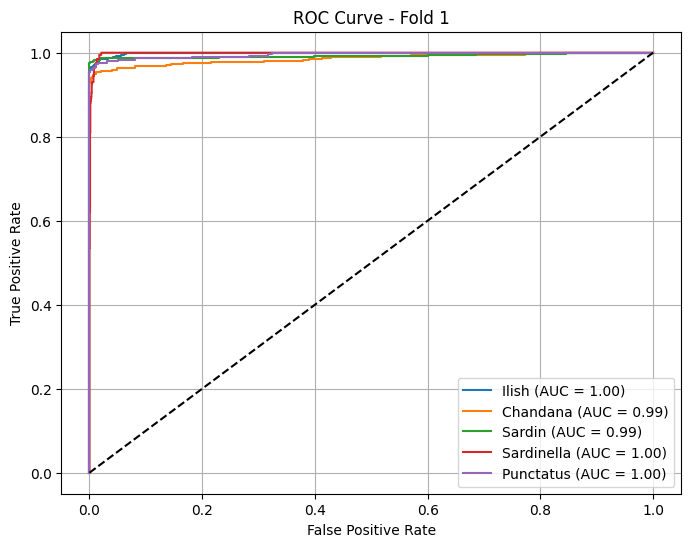

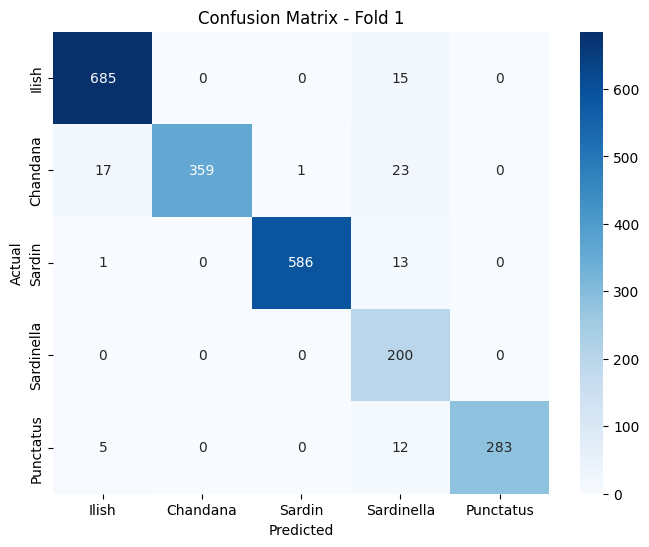

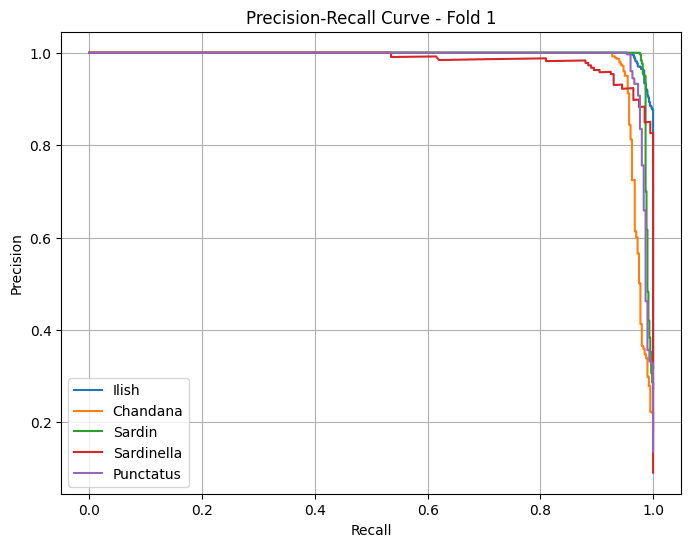

<Figure size 1000x600 with 0 Axes>

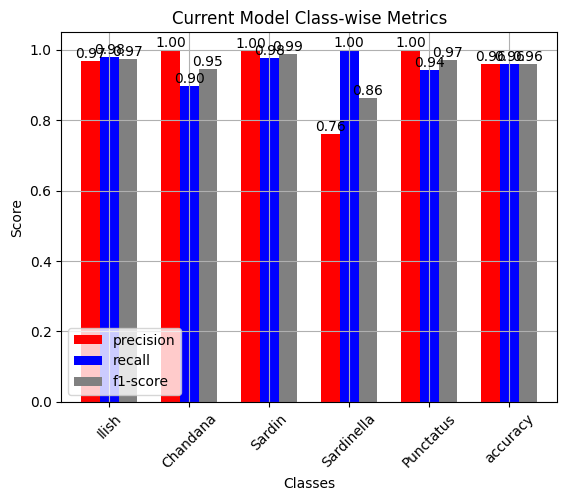

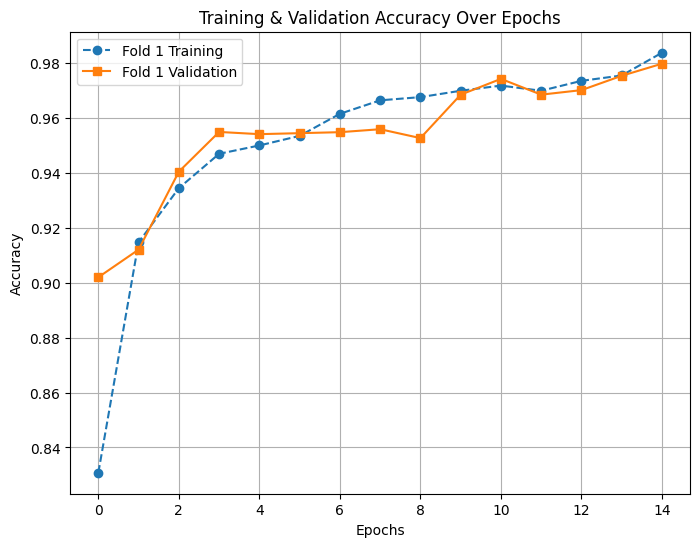

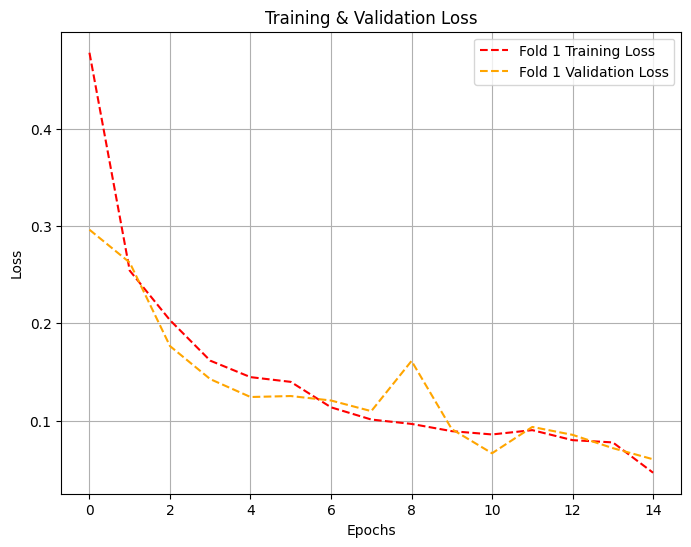

Classification Report - Fold 1:
               precision    recall  f1-score   support

       Ilish       0.97      0.98      0.97       700
    Chandana       1.00      0.90      0.95       400
      Sardin       1.00      0.98      0.99       600
  Sardinella       0.76      1.00      0.86       200
   Punctatus       1.00      0.94      0.97       300

    accuracy                           0.96      2200
   macro avg       0.95      0.96      0.95      2200
weighted avg       0.97      0.96      0.96      2200


Evaluating Fold 2:
69/69 ━━━━━━━━━━━━━━━━━━━━ 6s 81ms/step


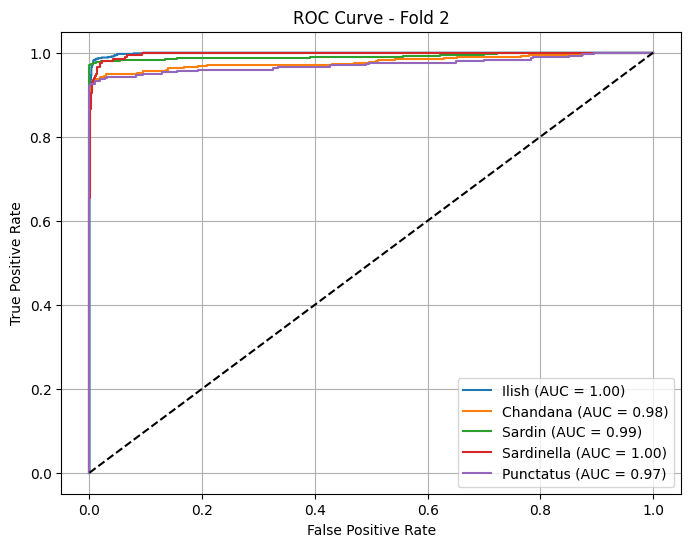

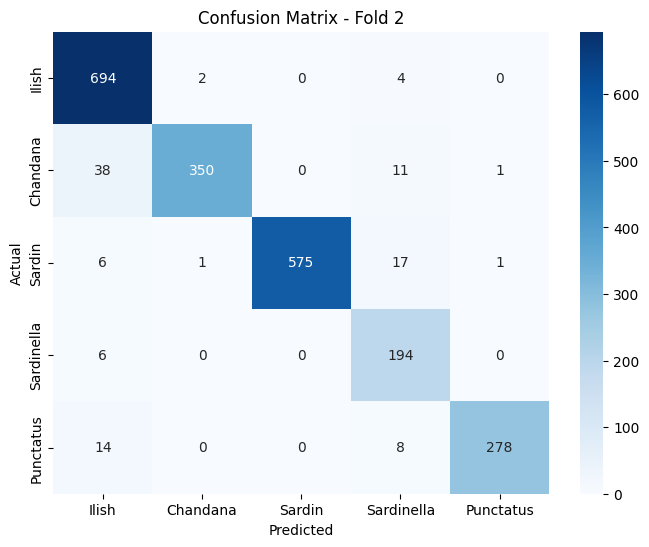

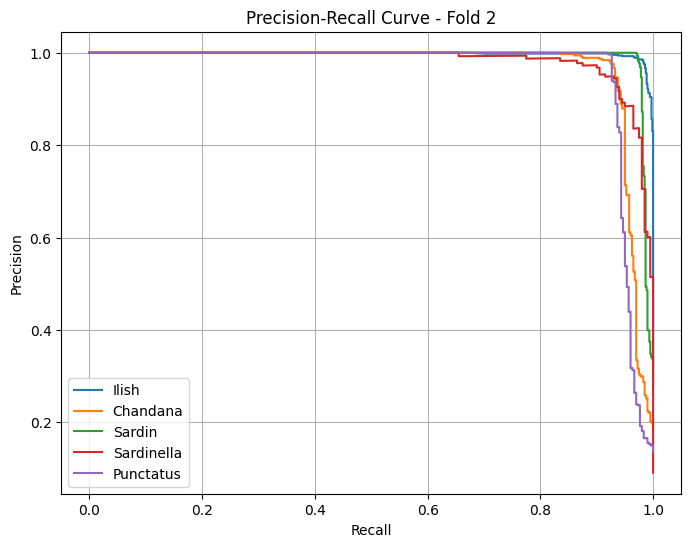

<Figure size 1000x600 with 0 Axes>

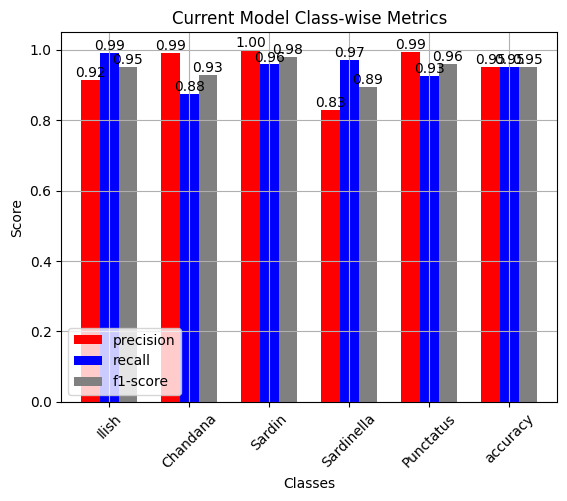

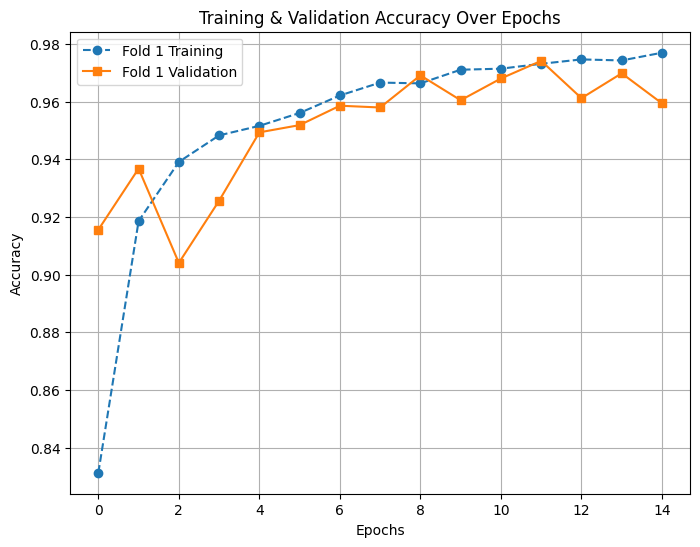

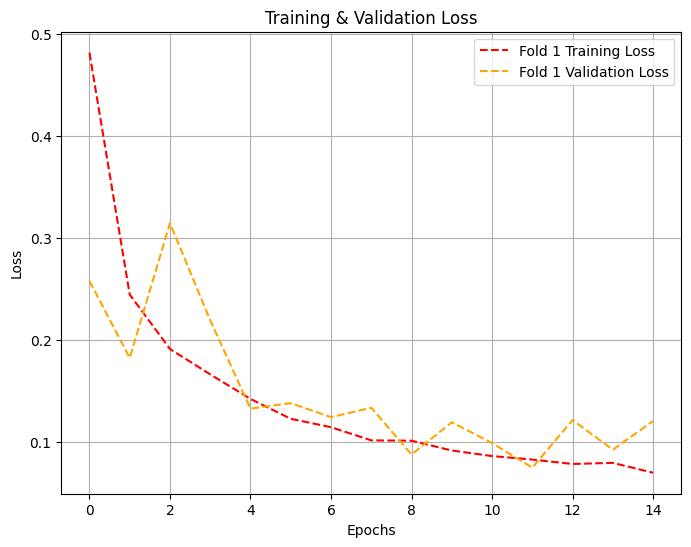

Classification Report - Fold 2:
               precision    recall  f1-score   support

       Ilish       0.92      0.99      0.95       700
    Chandana       0.99      0.88      0.93       400
      Sardin       1.00      0.96      0.98       600
  Sardinella       0.83      0.97      0.89       200
   Punctatus       0.99      0.93      0.96       300

    accuracy                           0.95      2200
   macro avg       0.95      0.94      0.94      2200
weighted avg       0.96      0.95      0.95      2200


Evaluating Fold 3:
69/69 ━━━━━━━━━━━━━━━━━━━━ 6s 81ms/step


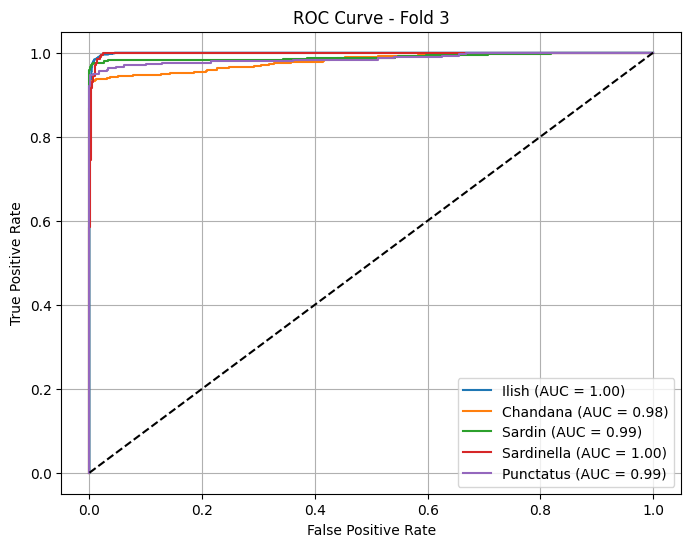

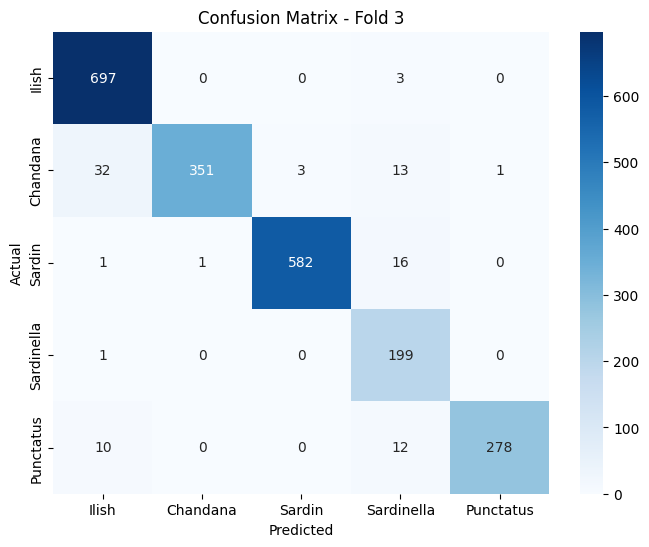

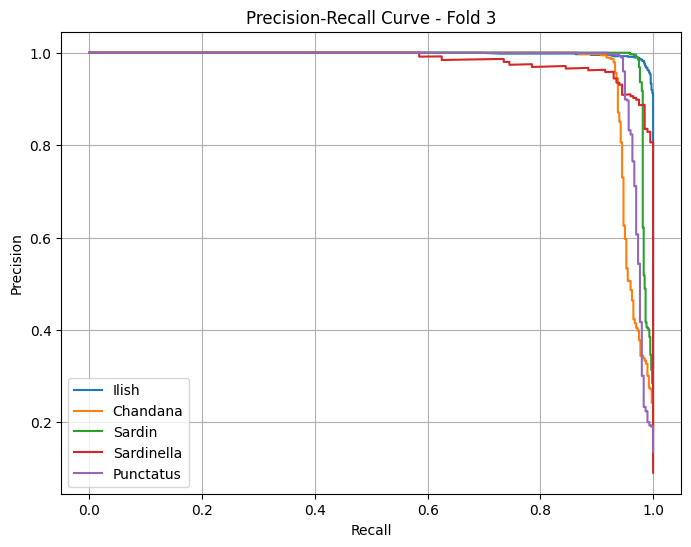

<Figure size 1000x600 with 0 Axes>

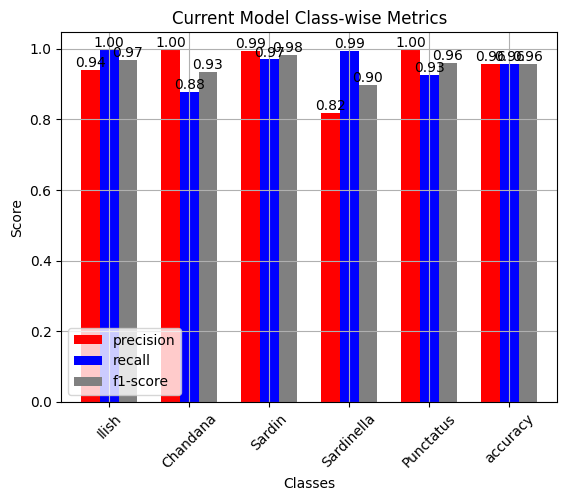

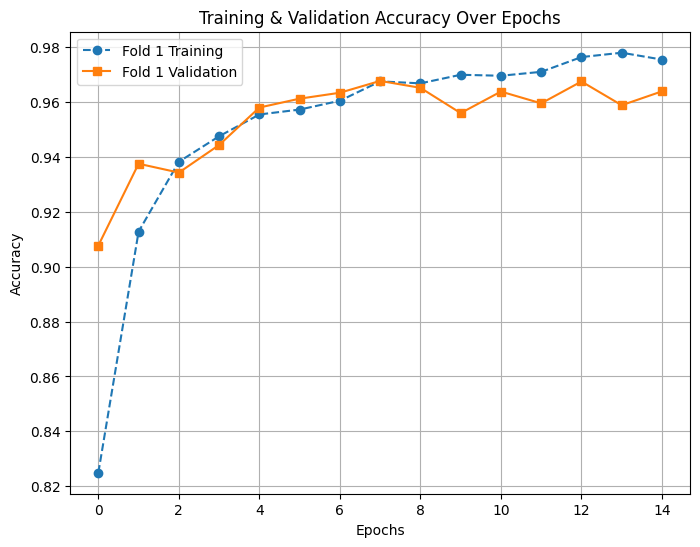

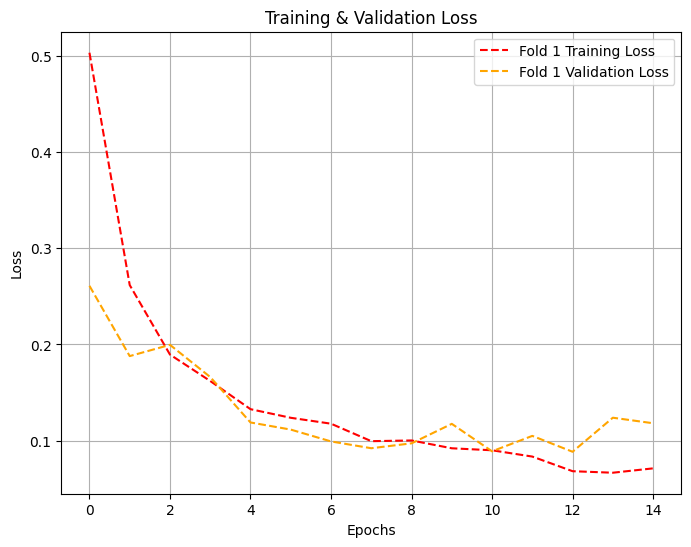

Classification Report - Fold 3:
               precision    recall  f1-score   support

       Ilish       0.94      1.00      0.97       700
    Chandana       1.00      0.88      0.93       400
      Sardin       0.99      0.97      0.98       600
  Sardinella       0.82      0.99      0.90       200
   Punctatus       1.00      0.93      0.96       300

    accuracy                           0.96      2200
   macro avg       0.95      0.95      0.95      2200
weighted avg       0.96      0.96      0.96      2200


Evaluating Fold 4:
69/69 ━━━━━━━━━━━━━━━━━━━━ 5s 80ms/step


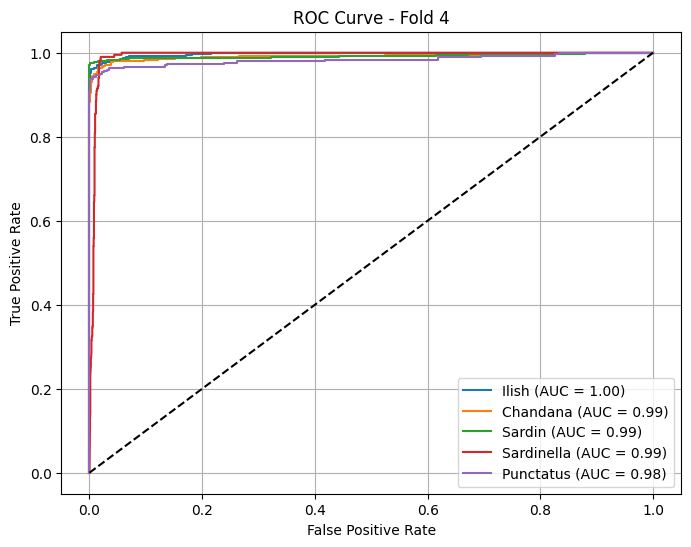

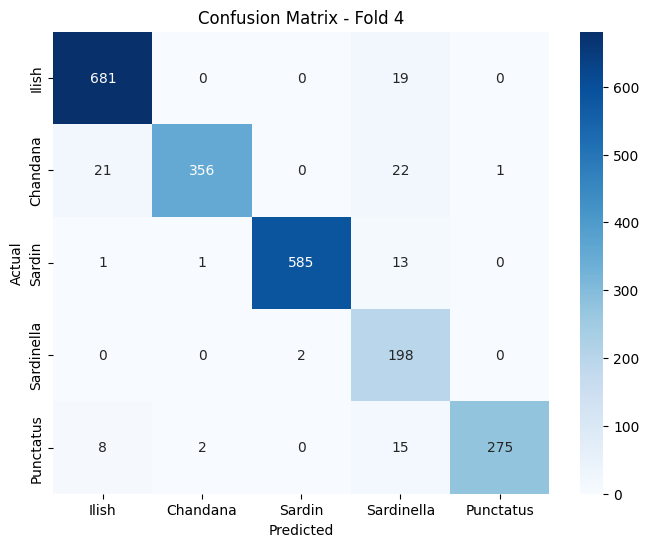

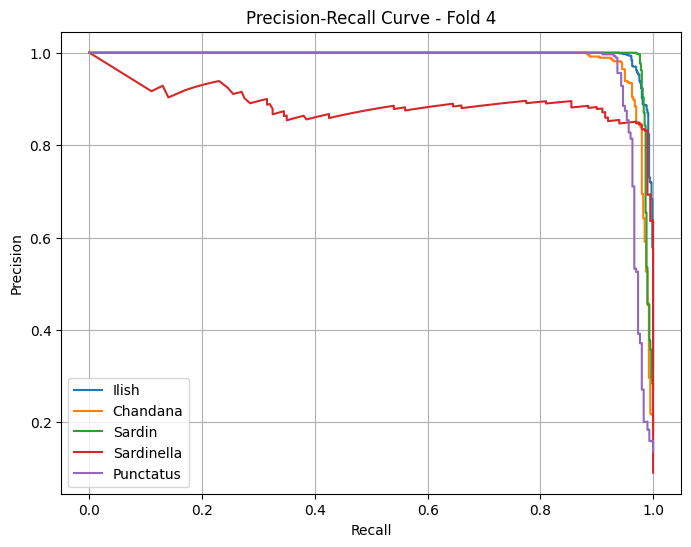

<Figure size 1000x600 with 0 Axes>

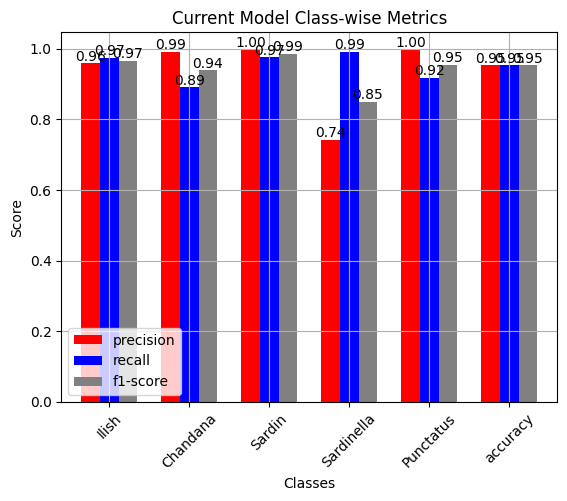

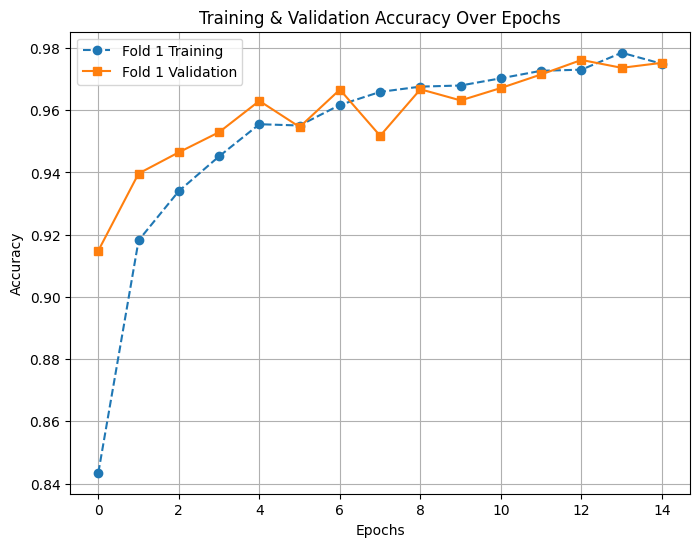

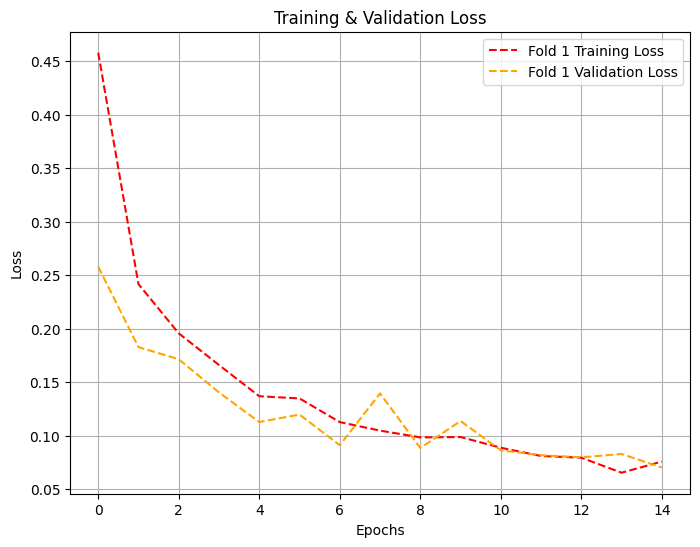

Classification Report - Fold 4:
               precision    recall  f1-score   support

       Ilish       0.96      0.97      0.97       700
    Chandana       0.99      0.89      0.94       400
      Sardin       1.00      0.97      0.99       600
  Sardinella       0.74      0.99      0.85       200
   Punctatus       1.00      0.92      0.95       300

    accuracy                           0.95      2200
   macro avg       0.94      0.95      0.94      2200
weighted avg       0.96      0.95      0.95      2200


Evaluating Fold 5:
69/69 ━━━━━━━━━━━━━━━━━━━━ 6s 79ms/step


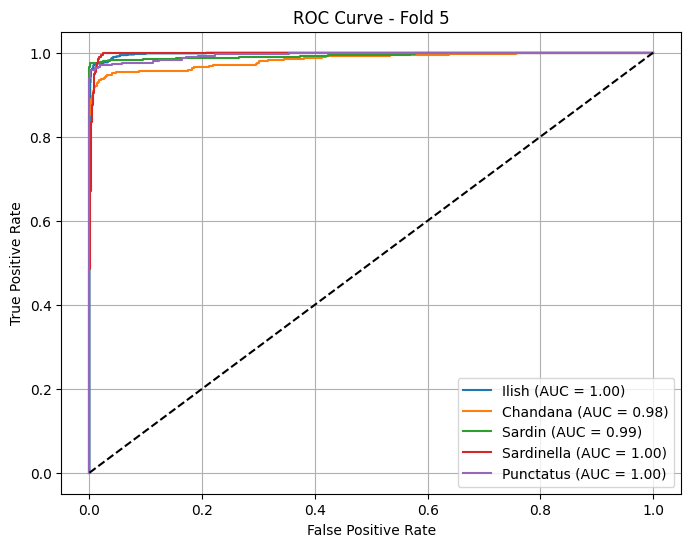

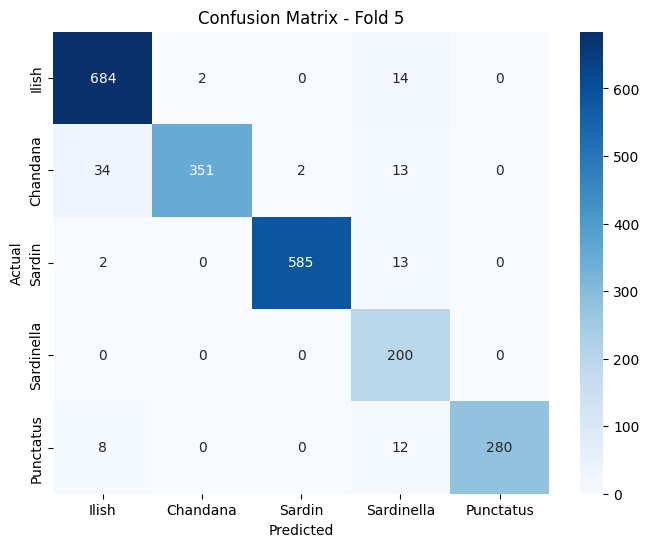

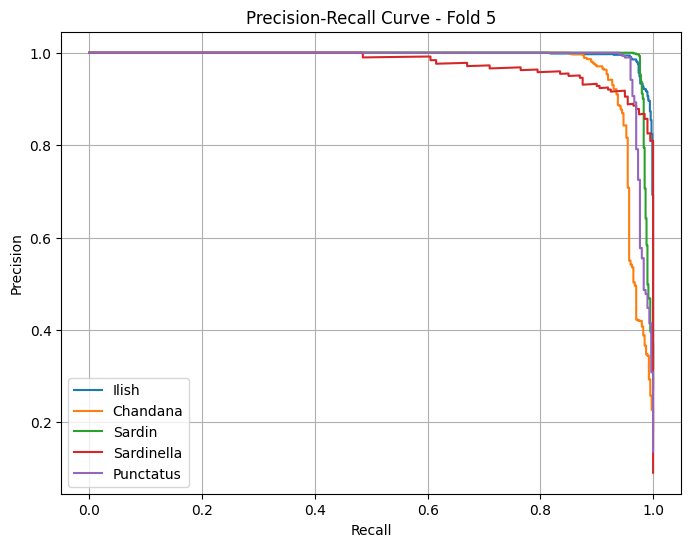

<Figure size 1000x600 with 0 Axes>

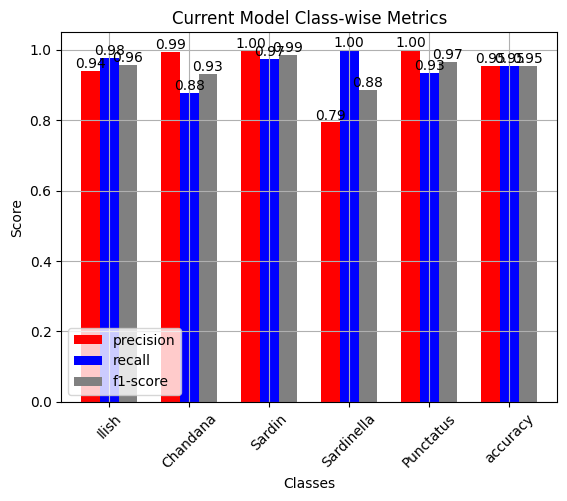

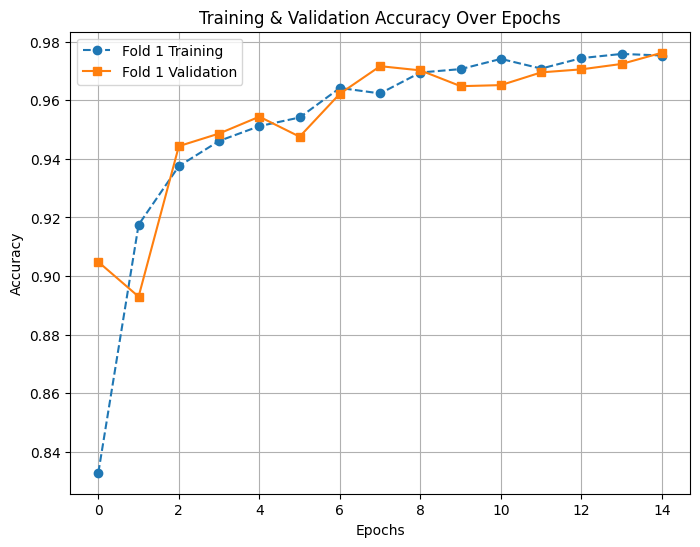

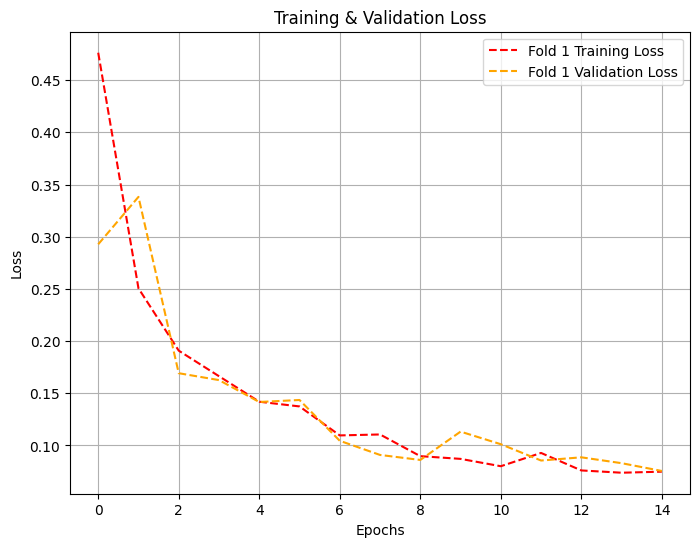

Classification Report - Fold 5:
               precision    recall  f1-score   support

       Ilish       0.94      0.98      0.96       700
    Chandana       0.99      0.88      0.93       400
      Sardin       1.00      0.97      0.99       600
  Sardinella       0.79      1.00      0.88       200
   Punctatus       1.00      0.93      0.97       300

    accuracy                           0.95      2200
   macro avg       0.94      0.95      0.95      2200
weighted avg       0.96      0.95      0.96      2200

Results in a Single Plot....

Processing Fold 1:
69/69 ━━━━━━━━━━━━━━━━━━━━ 5s 78ms/step

Processing Fold 2:
69/69 ━━━━━━━━━━━━━━━━━━━━ 5s 79ms/step

Processing Fold 3:
69/69 ━━━━━━━━━━━━━━━━━━━━ 5s 79ms/step

Processing Fold 4:
69/69 ━━━━━━━━━━━━━━━━━━━━ 5s 79ms/step

Processing Fold 5:
69/69 ━━━━━━━━━━━━━━━━━━━━ 5s 79ms/step


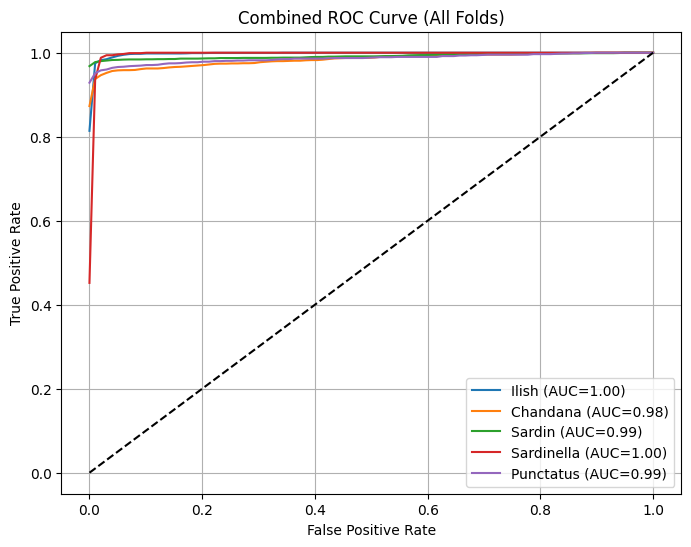

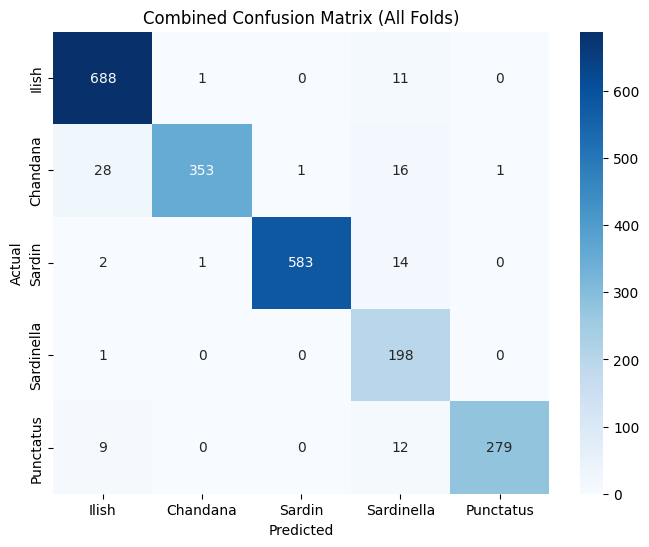

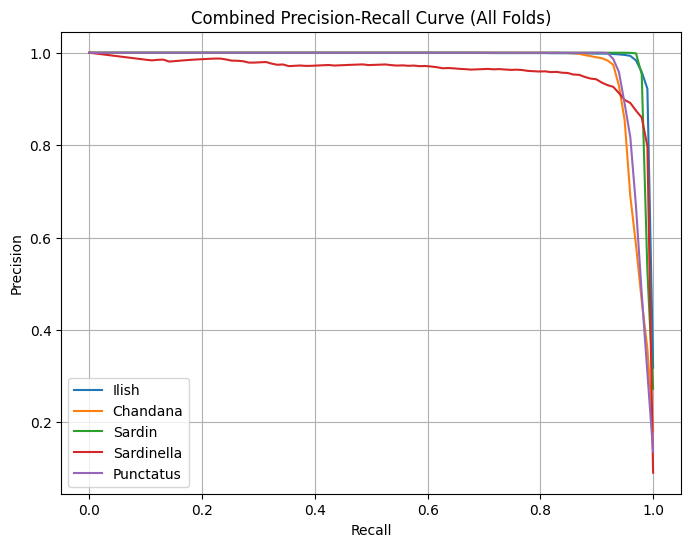

69/69 ━━━━━━━━━━━━━━━━━━━━ 6s 80ms/step
69/69 ━━━━━━━━━━━━━━━━━━━━ 5s 79ms/step
69/69 ━━━━━━━━━━━━━━━━━━━━ 6s 80ms/step
69/69 ━━━━━━━━━━━━━━━━━━━━ 6s 80ms/step
69/69 ━━━━━━━━━━━━━━━━━━━━ 5s 79ms/step


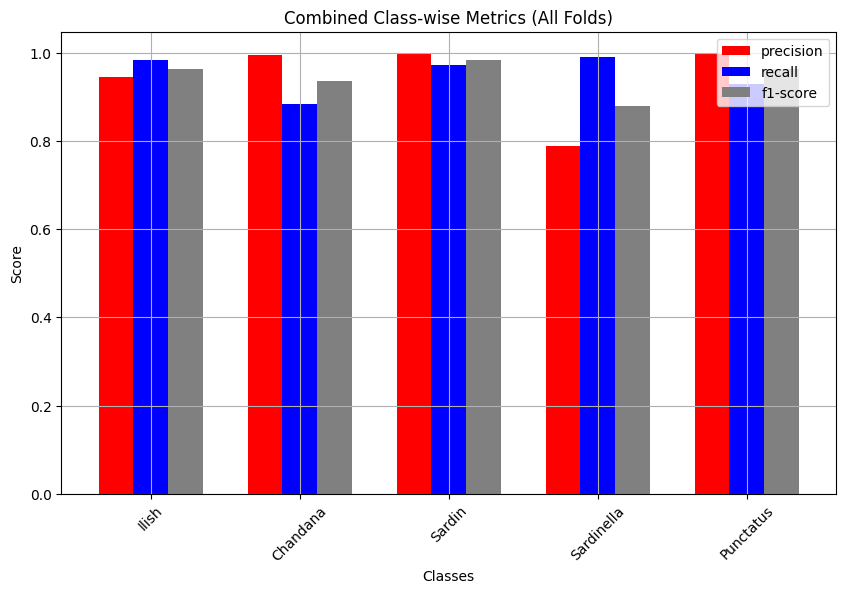

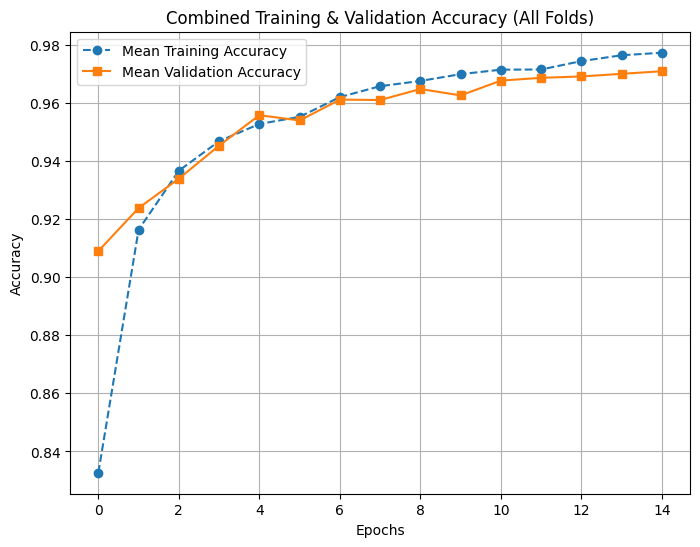

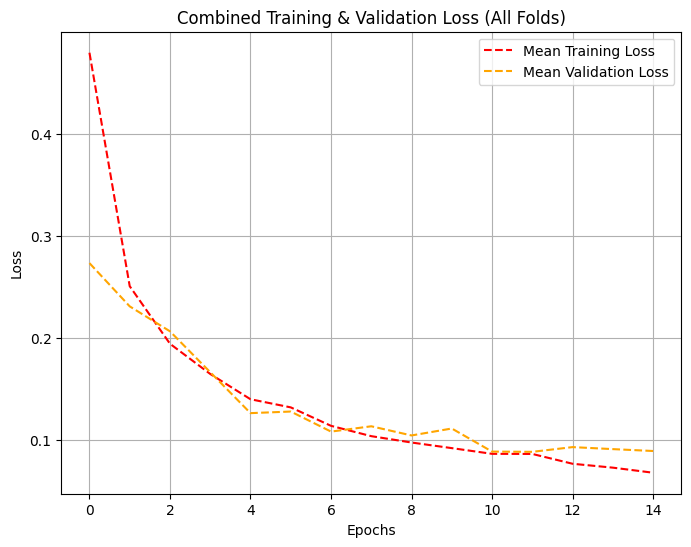


Final Combined Classification Report Across All Folds:
               precision    recall  f1-score   support

       Ilish       0.94      0.98      0.96      3500
    Chandana       0.99      0.88      0.94      2000
      Sardin       1.00      0.97      0.98      3000
  Sardinella       0.79      0.99      0.88      1000
   Punctatus       1.00      0.93      0.96      1500

    accuracy                           0.96     11000
   macro avg       0.94      0.95      0.94     11000
weighted avg       0.96      0.96      0.96     11000


Final Model Performance (Averaged across all folds):
Final Test Accuracy: 0.9551
Final F1 Score: 0.9445


In [ ]:
import numpy as np
import pandas as pd
import tensorflow as tf
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter

from tensorflow.keras.applications import ResNet50
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, LeakyReLU, BatchNormalization
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.metrics import accuracy_score, roc_curve, auc, precision_recall_curve, confusion_matrix, f1_score, classification_report
from imblearn.over_sampling import SMOTE

# Assuming X and Y are already loaded and preprocessed
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=42)

# !pip install imbalanced-learn
# #SMOTE (Synthetic Minority Over-sampling Technique)
# Synthetic Sample=Original Sample+λ×(Neighbor Sample−Original Sample)
# 1.Original Sample is the current sample from the minority class.
# 2.Neighbor Sample is a randomly chosen sample from the k-nearest neighbors.
# 3.λ is a random value between 0 and 1, which controls the degree of interpolation.


# # Apply SMOTE
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_train_resampled, Y_train_resampled = smote.fit_resample(X_train.reshape(X_train.shape[0], -1), Y_train)
X_train_resampled = X_train_resampled.reshape(-1, 224, 224, 3)

import matplotlib.pyplot as plt
import numpy as np

# Display some sample images from the resampled dataset
num_samples_to_show = 5  # Number of sample images to display
fig, axes = plt.subplots(1, num_samples_to_show, figsize=(15, 5))

# Plot the images
for i in range(num_samples_to_show):
    axes[i].imshow(X_train_resampled[i])  # Display the image
    axes[i].set_title(f"Class: {Y_train_resampled[i]}")  # Set the class as the title
    axes[i].axis('off')  # Hide the axis

plt.show()
print(f"Original class distribution: {Counter(Y_train)}")
print(f"Resampled class distribution: {Counter(Y_train_resampled)}")


# Parameters
input_shape = (224, 224, 3)
num_classes = 5
batch_size = 32
epochs = 15
k_folds = 5

datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode="nearest"
)


def batch_generator(X, Y, batch_size=32):
    size = X.shape[0]
    used_indices = set()  # Track used samples per fold
    while True:
        indices = np.random.permutation(size)
        for start in range(0, size, batch_size):
            end = min(start + batch_size, size)
            batch_idx = indices[start:end]

            # Ensure no overlap across folds
            unique_batch_idx = [idx for idx in batch_idx if idx not in used_indices]
            used_indices.update(unique_batch_idx)

            if not unique_batch_idx:  # If all data is used, reset for next epoch
                used_indices.clear()
                continue

            X_batch, Y_batch = X[unique_batch_idx], Y[unique_batch_idx]
            augmented_images = next(datagen.flow(X_batch, shuffle=False, batch_size=len(unique_batch_idx)))
            yield augmented_images, to_categorical(Y_batch, num_classes)


# from tensorflow.keras.applications import
# [
# ResNet50, ResNet101, ResNet152,
# EfficientNetB0, EfficientNetB1, EfficientNetB2, EfficientNetB3, EfficientNetB4, EfficientNetB5, EfficientNetB6, EfficientNetB7,
# VGG16, VGG19,
# Xception,
# InceptionV3, InceptionResNetV2,
# DenseNet121, DenseNet169, DenseNet201,
# MobileNet, MobileNetV2, MobileNetV3Small, MobileNetV3Large,
# NASNetLarge, NASNetMobile
# ]


def create_resnet_model(input_shape=(224, 224, 3)):
    base_model = ResNet50(weights='imagenet', include_top=False, input_shape=input_shape)

    for layer in base_model.layers[:-10]:
        layer.trainable = False
    for layer in base_model.layers[-10:]:
        layer.trainable = True

    x = GlobalAveragePooling2D()(base_model.output)
    x = Dense(256)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.1)(x)
    x = Dropout(0.5)(x)

    x = Dense(128)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.1)(x)
    x = Dropout(0.5)(x)

    output = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=base_model.input, outputs=output)
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    return model

def train_with_kfold(X_train, Y_train, X_test, Y_test, k=5, batch_size=32, epochs=15):
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
    histories = []
    ensemble_predictions = np.zeros((X_test.shape[0], num_classes))

    for fold_no, (train_idx, val_idx) in enumerate(skf.split(X_train, Y_train), 1):
    # for fold_no, (train_idx, val_idx) in enumerate(skf.split(X_train, np.argmax(Y_train, axis=1)), 1):

        print(f"Training Fold {fold_no}/{k}")

        X_train_fold, X_val_fold = X_train[train_idx], X_train[val_idx]
        Y_train_fold, Y_val_fold = Y_train[train_idx], Y_train[val_idx]

        resnet_model = create_resnet_model()
        train_generator = batch_generator(X_train_fold, Y_train_fold, batch_size)
        val_generator = batch_generator(X_val_fold, Y_val_fold, batch_size)

        callbacks = [
            ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, verbose=1),
            ModelCheckpoint(f'best_model_resnet_fold_{fold_no}.keras', save_best_only=True, monitor='val_loss', mode='min'),
            EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
        ]

        history = resnet_model.fit(train_generator, validation_data=val_generator, epochs=epochs, verbose=1,
                                   callbacks=callbacks, steps_per_epoch=len(X_train_fold)//batch_size,
                                   validation_steps=len(X_val_fold)//batch_size)
        histories.append(history)

        resnet_preds = resnet_model.predict(X_test)
        ensemble_predictions += resnet_preds

    ensemble_predictions /= k
    final_classes = np.argmax(ensemble_predictions, axis=1)
    accuracy = np.mean(final_classes == Y_test)
    print(f"Final Model Accuracy: {accuracy * 100:.2f}%")
    return final_classes, histories

final_predictions, history_dict = train_with_kfold(X_train_resampled, Y_train_resampled, X_test, Y_test, k=k_folds)
print("Training Complete. ResNet Model is ready!")






import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from sklearn.metrics import roc_curve, auc, confusion_matrix, precision_recall_curve, classification_report, accuracy_score, f1_score

# Define class labels
class_labels = ['Ilish', 'Chandana', 'Sardin', 'Sardinella', 'Punctatus']

# Function to plot ROC curve
def plot_roc_curve(Y_test, Y_test_pred_prob, class_labels, fold_no):
    plt.figure(figsize=(8, 6))
    for i in range(len(class_labels)):
        y_true_binary = (Y_test == i).astype(int)
        y_score = Y_test_pred_prob[:, i]
        fpr, tpr, _ = roc_curve(y_true_binary, y_score)
        roc_auc = auc(fpr, tpr)
        plt.plot(fpr, tpr, label=f'{class_labels[i]} (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], 'k--')
    plt.title(f'ROC Curve - Fold {fold_no}')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend()
    plt.grid()
    plt.show()

# Function to plot Confusion Matrix
def plot_confusion_matrix(Y_test, Y_test_pred, class_labels, fold_no):
    conf_matrix = confusion_matrix(Y_test, Y_test_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
    plt.title(f'Confusion Matrix - Fold {fold_no}')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show()

# Function to plot Precision-Recall curve
def plot_precision_recall_curve(Y_test, Y_test_pred_prob, class_labels, fold_no):
    plt.figure(figsize=(8, 6))
    for i in range(len(class_labels)):
        precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), Y_test_pred_prob[:, i])
        plt.plot(recall, precision, label=f'{class_labels[i]}')
    plt.title(f'Precision-Recall Curve - Fold {fold_no}')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.legend()
    plt.grid()
    plt.show()

# Function to plot Training & Validation Accuracy over epochs
def plot_accuracy(history_list):
    plt.figure(figsize=(8, 6))
    for i, history in enumerate(history_list):
        plt.plot(history.history['accuracy'], label=f'Fold {i+1} Training', linestyle='dashed', marker='o')
        plt.plot(history.history['val_accuracy'], label=f'Fold {i+1} Validation', marker='s')
    plt.title('Training & Validation Accuracy Over Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid()
    plt.show()

# Function to plot Training & Validation Loss over epochs
def plot_loss(history_list):
    plt.figure(figsize=(8, 6))
    for i, history in enumerate(history_list):
        plt.plot(history.history['loss'], label=f'Fold {i+1} Training Loss', linestyle='dashed', color='red')
        plt.plot(history.history['val_loss'], label=f'Fold {i+1} Validation Loss', linestyle='dashed', color='orange')
    plt.title('Training & Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid()
    plt.show()



# Function to compare class-wise metrics
def plot_classwise_metrics(Y_test, Y_test_pred, prev_Y_test_pred=None):
    report = classification_report(Y_test, Y_test_pred, target_names=class_labels, output_dict=True)
    df_report = pd.DataFrame(report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]
    colors = {'precision': 'red', 'recall': 'blue', 'f1-score': 'gray'}

    # Current model class-wise metrics
    plt.figure(figsize=(10, 6))
    df_report.plot(kind='bar', width=0.7, color=[colors[col] for col in df_report.columns])
    for p in plt.gca().patches:
        plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width() / 2, p.get_height()),
                           ha='center', va='bottom', fontsize=10, color='black')
    plt.title('Current Model Class-wise Metrics')
    plt.xlabel('Classes')
    plt.ylabel('Score')
    plt.xticks(rotation=45)
    plt.legend()
    plt.grid()
    plt.show()

    # Previous model class-wise metrics (if available)
    if prev_Y_test_pred is not None:
        prev_report = classification_report(Y_test, prev_Y_test_pred, target_names=class_labels, output_dict=True)
        prev_df_report = pd.DataFrame(prev_report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]

        plt.figure(figsize=(10, 6))
        prev_df_report.plot(kind='bar', width=0.7, color=['pink', 'lightblue', 'lightgray'])
        for p in plt.gca().patches:
            plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width() / 2, p.get_height()),
                               ha='center', va='bottom', fontsize=10, color='black')
        plt.title('Previous Model Class-wise Metrics')
        plt.xlabel('Classes')
        plt.ylabel('Score')
        plt.xticks(rotation=45)
        plt.legend()
        plt.grid()
        plt.show()

# Function to display classification report
def print_classification_report(Y_test, Y_test_pred, class_labels, fold_no):
    report = classification_report(Y_test, Y_test_pred, target_names=class_labels)
    print(f"Classification Report - Fold {fold_no}:\n", report)

# Generate all individual plots for each fold
for fold_no, history in enumerate(history_dict, 1):
    print(f"\nEvaluating Fold {fold_no}:")

    # Get predictions for the current fold (final_predictions for this fold)
    fold_predictions = history.model.predict(X_test)  # or use history if separate fold predictions are stored
    plot_roc_curve(Y_test, fold_predictions, class_labels, fold_no)
    plot_confusion_matrix(Y_test, np.argmax(fold_predictions, axis=1), class_labels, fold_no)
    plot_precision_recall_curve(Y_test, fold_predictions, class_labels, fold_no)
    plot_classwise_metrics(Y_test, np.argmax(fold_predictions, axis=1))  # Class-wise metrics for the current fold
    # Call accuracy and loss plot functions for the current fold
    plot_accuracy([history])  # Pass a list with a single fold's history
    plot_loss([history])  # Pass a list with a single fold's history
    #Classification Report
    print_classification_report(Y_test, np.argmax(fold_predictions, axis=1), class_labels, fold_no)








#For All the Results in a single plot
print("Results in a Single Plot....")

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from sklearn.metrics import roc_curve, auc, precision_recall_curve, confusion_matrix, classification_report

# Initialize lists to store results from all folds
all_fpr, all_tpr, all_roc_auc = [], [], []
all_precisions, all_recalls = [], []
all_conf_matrices = []
history_list = []
all_predictions = []
all_true_labels = []

num_classes = len(class_labels)

for fold_no, history in enumerate(history_dict, 1):
    print(f"\nProcessing Fold {fold_no}:")

    # Get predictions and true labels
    fold_predictions = history.model.predict(X_test)
    fold_pred_labels = np.argmax(fold_predictions, axis=1)

    all_predictions.append(fold_predictions)
    all_true_labels.append(Y_test)

    # Store training history
    history_list.append(history)

    # ROC Curve
    fold_fpr, fold_tpr, fold_auc = [], [], []
    for i in range(num_classes):
        y_true_binary = (Y_test == i).astype(int)
        y_score = fold_predictions[:, i]
        fpr, tpr, _ = roc_curve(y_true_binary, y_score)
        fold_fpr.append(fpr)
        fold_tpr.append(tpr)
        fold_auc.append(auc(fpr, tpr))

    all_fpr.append(fold_fpr)
    all_tpr.append(fold_tpr)
    all_roc_auc.append(fold_auc)

    # Precision-Recall Curve
    fold_precisions, fold_recalls = [], []
    for i in range(num_classes):
        precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), fold_predictions[:, i])
        fold_precisions.append(precision)
        fold_recalls.append(recall)

    all_precisions.append(fold_precisions)
    all_recalls.append(fold_recalls)

    # Confusion Matrix
    all_conf_matrices.append(confusion_matrix(Y_test, fold_pred_labels))

# Convert predictions and true labels to numpy arrays
all_predictions = np.vstack(all_predictions)
all_true_labels = np.hstack(all_true_labels)

# **1. Combined ROC Curve**
plt.figure(figsize=(8, 6))
mean_fpr = np.linspace(0, 1, 100)  # Standard length for interpolation

for i in range(num_classes):
    interpolated_tprs = [np.interp(mean_fpr, all_fpr[j][i], all_tpr[j][i]) for j in range(len(all_fpr))]
    mean_tpr = np.mean(interpolated_tprs, axis=0)
    mean_auc = np.mean([all_roc_auc[j][i] for j in range(len(all_roc_auc))])
    plt.plot(mean_fpr, mean_tpr, label=f'{class_labels[i]} (AUC={mean_auc:.2f})')

plt.plot([0, 1], [0, 1], 'k--')
plt.title('Combined ROC Curve (All Folds)')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.grid()
plt.show()

# **2. Combined Confusion Matrix**
mean_conf_matrix = np.mean(all_conf_matrices, axis=0)
plt.figure(figsize=(8, 6))
sns.heatmap(mean_conf_matrix, annot=True, fmt='.0f', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.title('Combined Confusion Matrix (All Folds)')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# **3. Combined Precision-Recall Curve**
plt.figure(figsize=(8, 6))
for i in range(num_classes):
    interpolated_precisions = [np.interp(mean_fpr, all_recalls[j][i][::-1], all_precisions[j][i][::-1]) for j in range(len(all_recalls))]
    mean_precision = np.mean(interpolated_precisions, axis=0)
    mean_recall = np.linspace(0, 1, 100)
    plt.plot(mean_recall, mean_precision, label=f'{class_labels[i]}')

plt.title('Combined Precision-Recall Curve (All Folds)')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.legend()
plt.grid()
plt.show()

# **4. Combined Class-wise Metrics**
all_reports = [classification_report(Y_test, np.argmax(history.model.predict(X_test), axis=1),
                                     target_names=class_labels, output_dict=True) for history in history_dict]
avg_report = {}
for label in class_labels:
    avg_report[label] = {
        'precision': np.mean([r[label]['precision'] for r in all_reports]),
        'recall': np.mean([r[label]['recall'] for r in all_reports]),
        'f1-score': np.mean([r[label]['f1-score'] for r in all_reports])
    }
df_avg_report = pd.DataFrame(avg_report).transpose()
df_avg_report.plot(kind='bar', width=0.7, figsize=(10, 6), color=['red', 'blue', 'gray'])
plt.title('Combined Class-wise Metrics (All Folds)')
plt.xlabel('Classes')
plt.ylabel('Score')
plt.xticks(rotation=45)
plt.legend()
plt.grid()
plt.show()

# **5. Combined Training & Validation Accuracy**
plt.figure(figsize=(8, 6))
mean_train_acc = np.mean([history.history['accuracy'] for history in history_list], axis=0)
mean_val_acc = np.mean([history.history['val_accuracy'] for history in history_list], axis=0)
plt.plot(mean_train_acc, label='Mean Training Accuracy', linestyle='dashed', marker='o')
plt.plot(mean_val_acc, label='Mean Validation Accuracy', marker='s')
plt.title('Combined Training & Validation Accuracy (All Folds)')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()
plt.show()

# **6. Combined Training & Validation Loss**
plt.figure(figsize=(8, 6))
mean_train_loss = np.mean([history.history['loss'] for history in history_list], axis=0)
mean_val_loss = np.mean([history.history['val_loss'] for history in history_list], axis=0)
plt.plot(mean_train_loss, label='Mean Training Loss', linestyle='dashed', color='red')
plt.plot(mean_val_loss, label='Mean Validation Loss', linestyle='dashed', color='orange')
plt.title('Combined Training & Validation Loss (All Folds)')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()

# **7. Print Combined Classification Report**
final_report = classification_report(all_true_labels, np.argmax(all_predictions, axis=1), target_names=class_labels)
print("\nFinal Combined Classification Report Across All Folds:\n", final_report)



from sklearn.metrics import accuracy_score, f1_score
# Compute final accuracy
final_accuracy = accuracy_score(all_true_labels, np.argmax(all_predictions, axis=1))
# Compute final F1 score (macro average across all classes)
final_f1_score = f1_score(all_true_labels, np.argmax(all_predictions, axis=1), average='macro')
# Print the final model performance
print("\nFinal Model Performance (Averaged across all folds):")
print(f"Final Test Accuracy: {final_accuracy:.4f}")
print(f"Final F1 Score: {final_f1_score:.4f}")

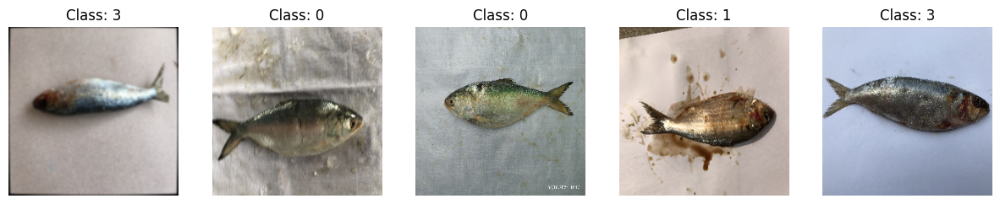

Original class distribution: Counter({np.int64(0): 2800, np.int64(2): 2400, np.int64(1): 1600, np.int64(4): 1200, np.int64(3): 800})
Resampled class distribution: Counter({np.int64(3): 2800, np.int64(0): 2800, np.int64(1): 2800, np.int64(4): 2800, np.int64(2): 2800})
Training Fold 1/5


/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Epoch 1/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 188s 455ms/step - accuracy: 0.7510 - loss: 0.6999 - val_accuracy: 0.9339 - val_loss: 0.1845 - learning_rate: 0.0010
Epoch 2/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 141s 403ms/step - accuracy: 0.9242 - loss: 0.2233 - val_accuracy: 0.9555 - val_loss: 0.1328 - learning_rate: 0.0010
Epoch 3/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 139s 397ms/step - accuracy: 0.9387 - loss: 0.1661 - val_accuracy: 0.9655 - val_loss: 0.0945 - learning_rate: 0.0010
Epoch 4/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 138s 395ms/step - accuracy: 0.9461 - loss: 0.1550 - val_accuracy: 0.9630 - val_loss: 0.1133 - learning_rate: 0.0010
Epoch 5/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 136s 389ms/step - accuracy: 0.9543 - loss: 0.1399 - val_accuracy: 0.9670 - val_loss: 0.0901 - learning_rate: 0.0010
Epoch 6/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 142s 406ms/step - accuracy: 0.9632 - loss: 0.1107 - val_accuracy: 0.9734 - val_loss: 0.0818 - learning_rate: 0.0010
Epoch 7/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 129s 370ms/step - accura

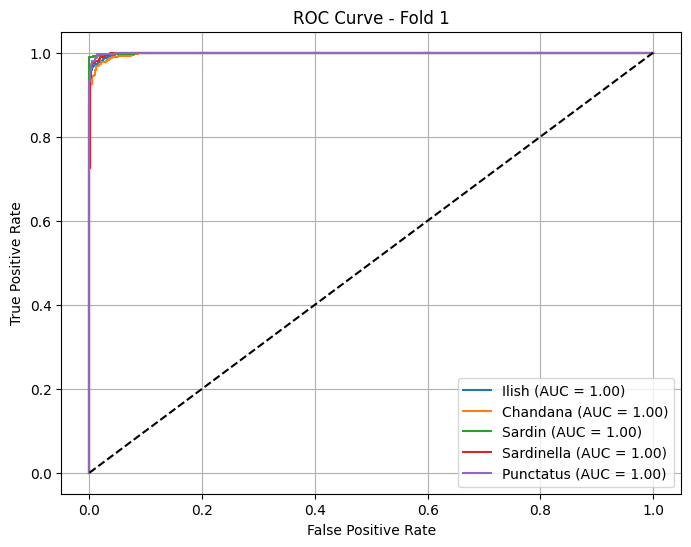

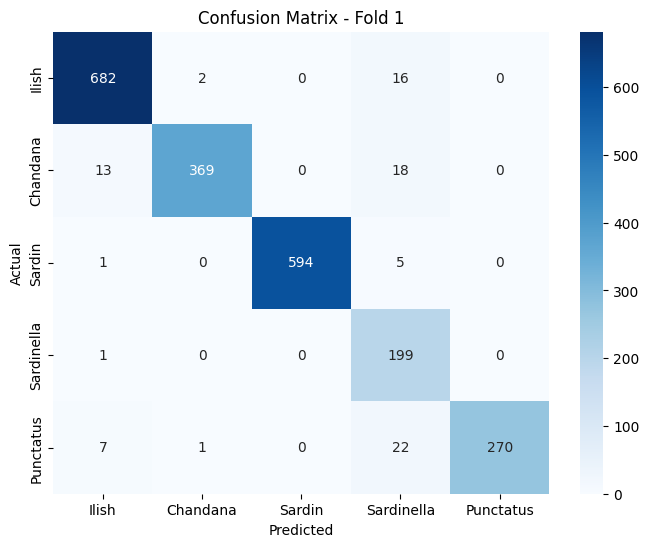

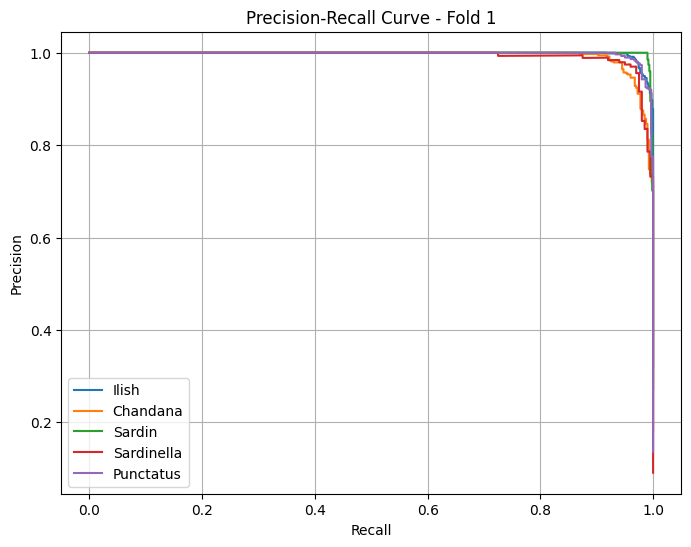

<Figure size 1000x600 with 0 Axes>

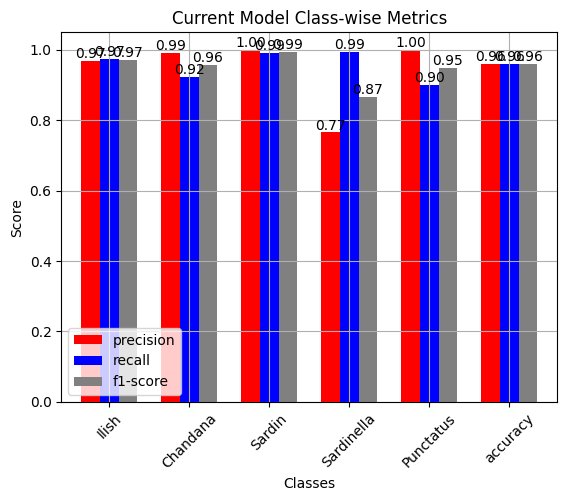

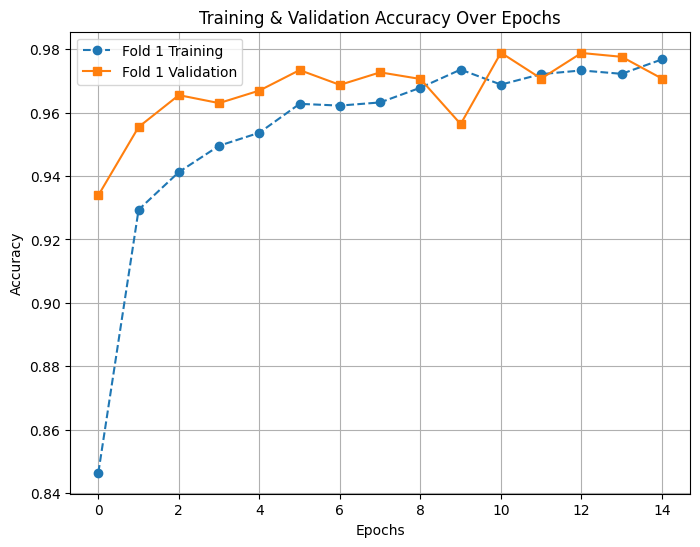

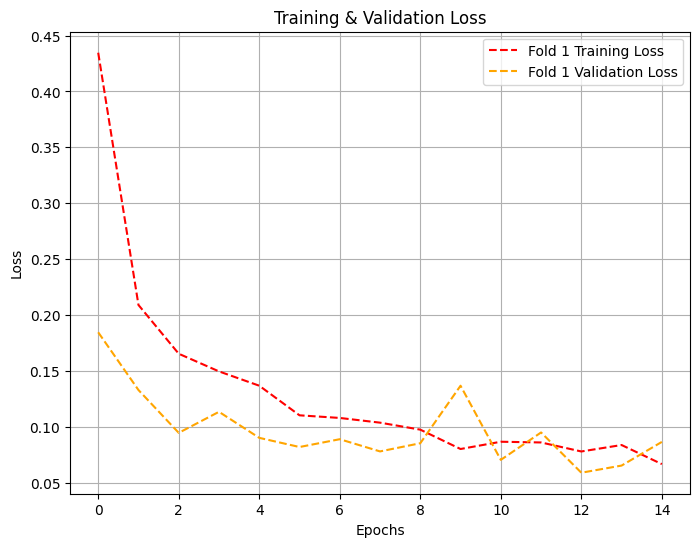

Classification Report - Fold 1:
               precision    recall  f1-score   support

       Ilish       0.97      0.97      0.97       700
    Chandana       0.99      0.92      0.96       400
      Sardin       1.00      0.99      0.99       600
  Sardinella       0.77      0.99      0.87       200
   Punctatus       1.00      0.90      0.95       300

    accuracy                           0.96      2200
   macro avg       0.95      0.96      0.95      2200
weighted avg       0.97      0.96      0.96      2200


Evaluating Fold 2:
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step


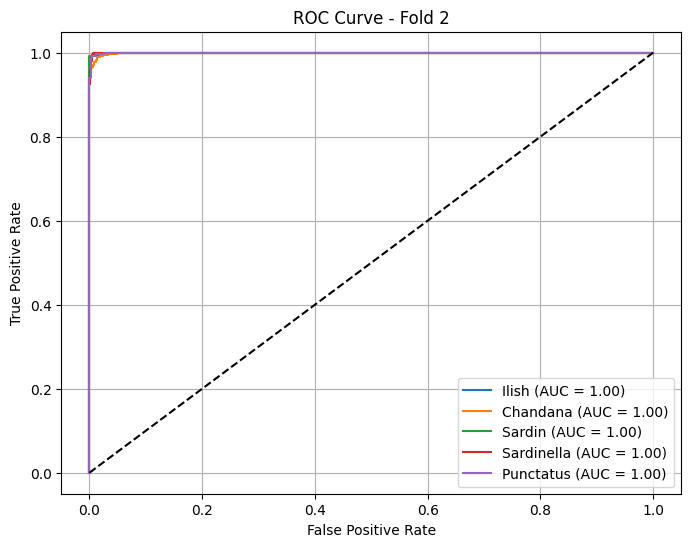

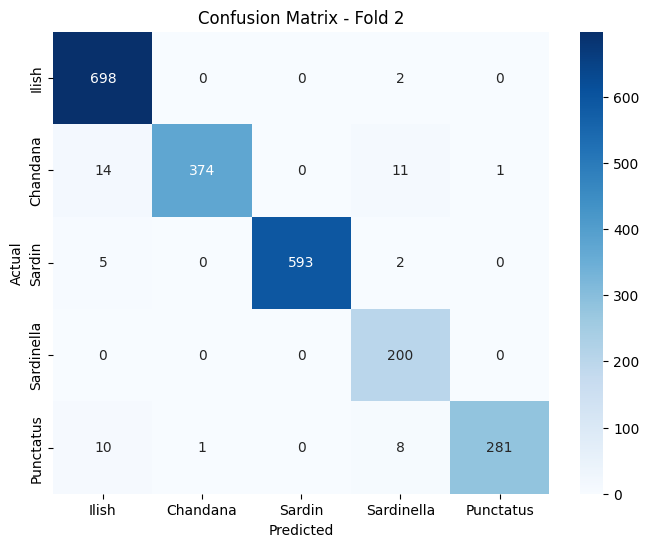

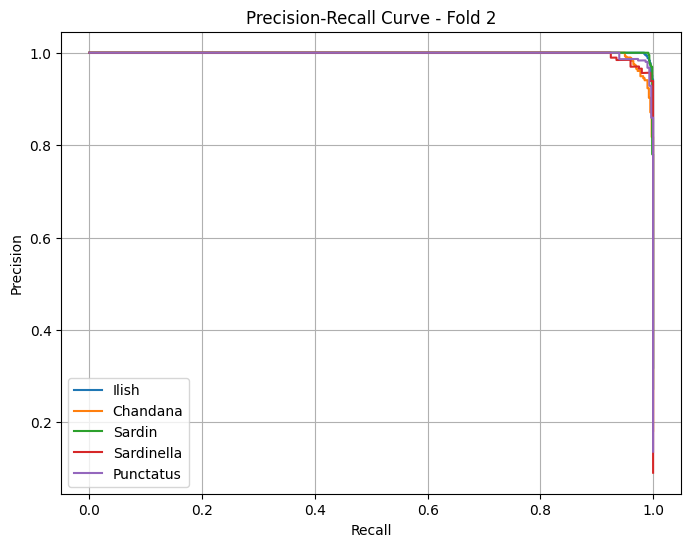

<Figure size 1000x600 with 0 Axes>

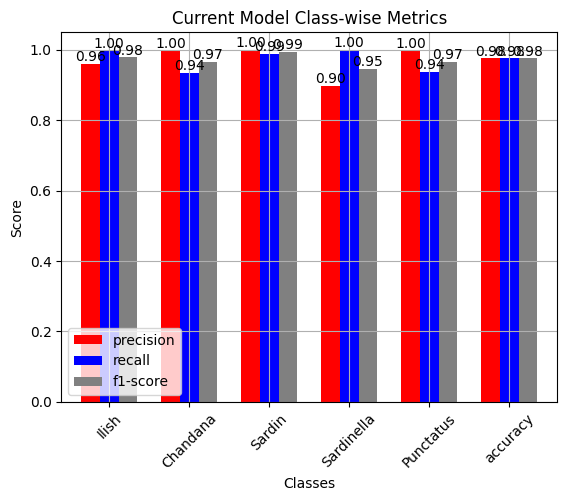

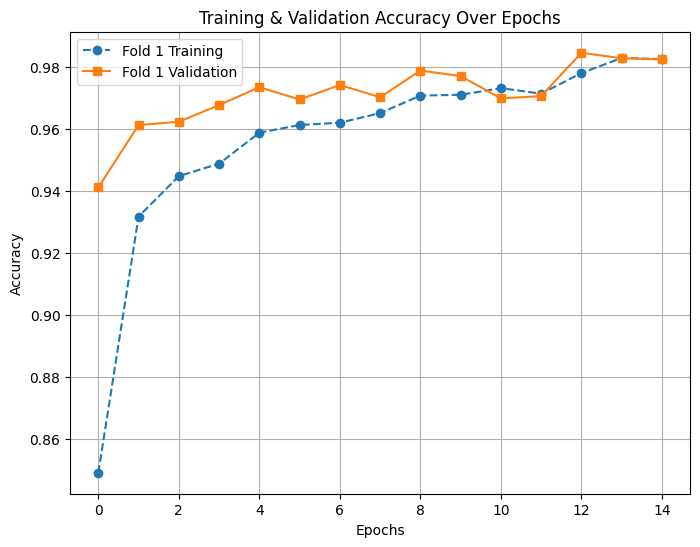

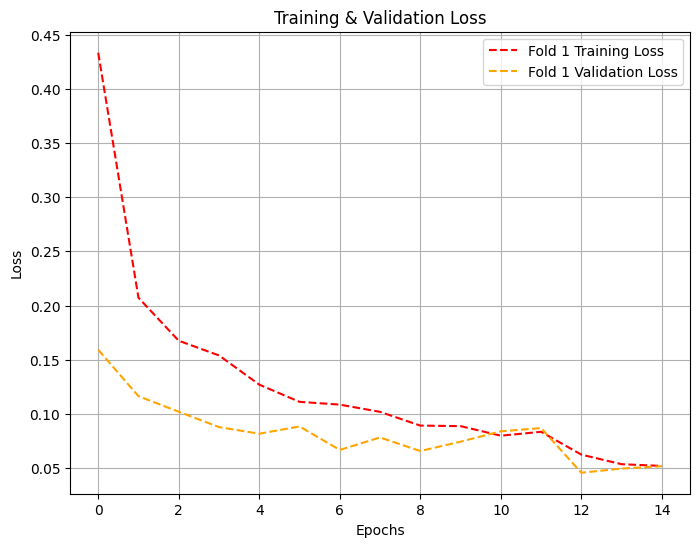

Classification Report - Fold 2:
               precision    recall  f1-score   support

       Ilish       0.96      1.00      0.98       700
    Chandana       1.00      0.94      0.97       400
      Sardin       1.00      0.99      0.99       600
  Sardinella       0.90      1.00      0.95       200
   Punctatus       1.00      0.94      0.97       300

    accuracy                           0.98      2200
   macro avg       0.97      0.97      0.97      2200
weighted avg       0.98      0.98      0.98      2200


Evaluating Fold 3:
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step


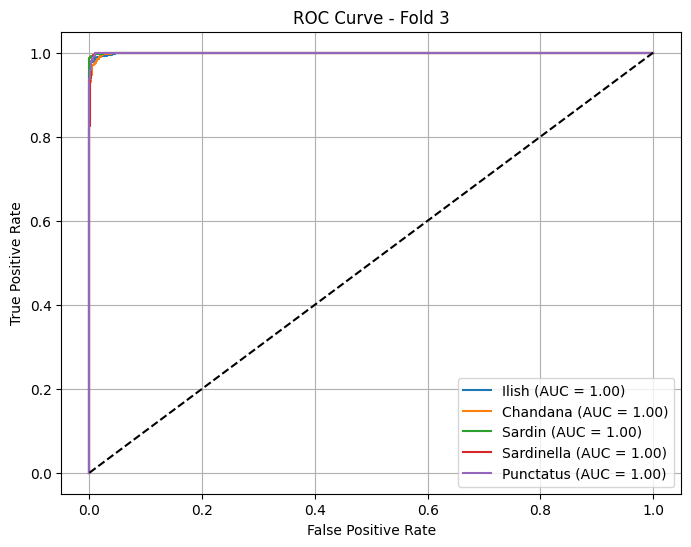

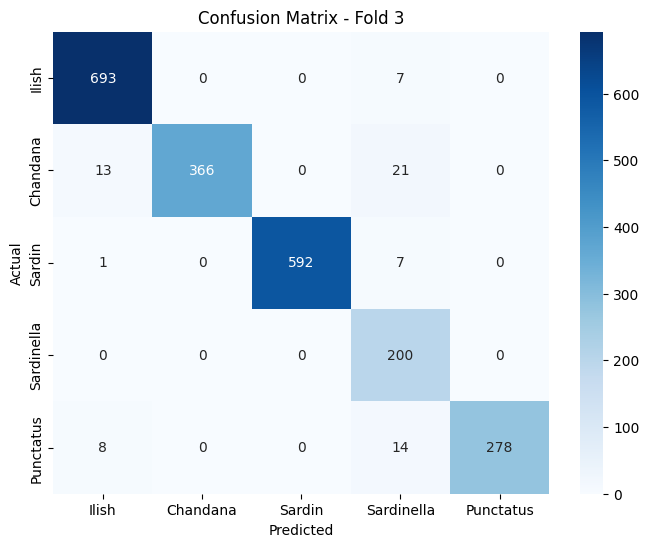

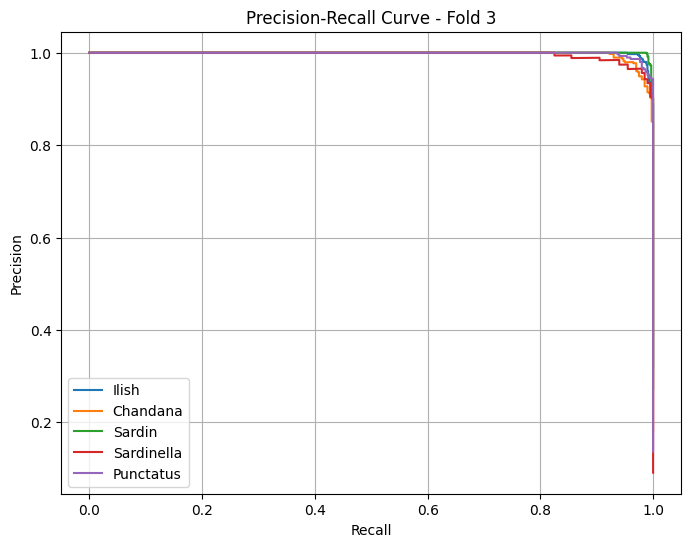

<Figure size 1000x600 with 0 Axes>

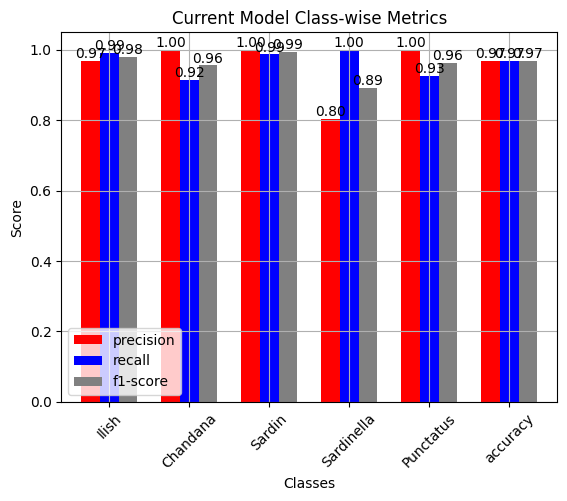

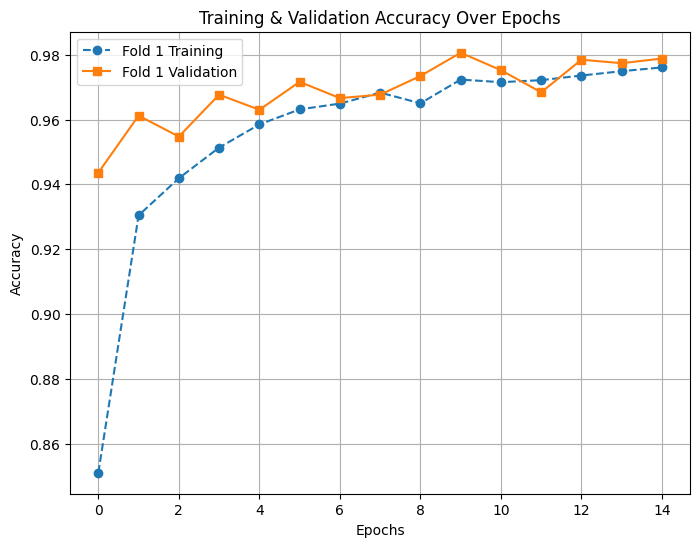

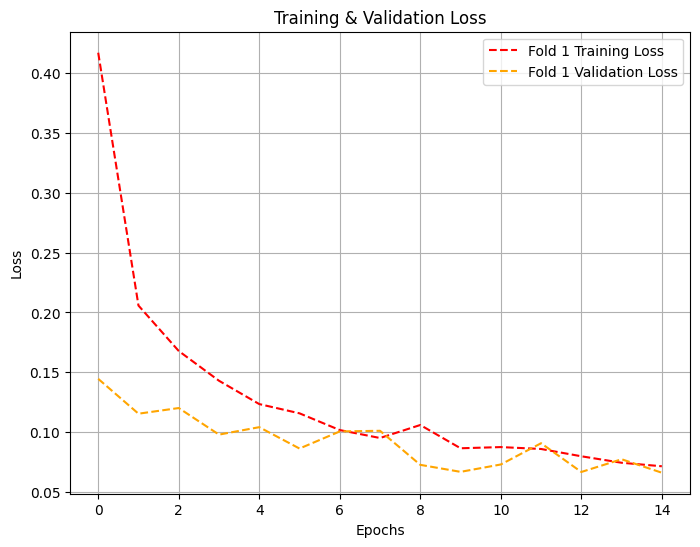

Classification Report - Fold 3:
               precision    recall  f1-score   support

       Ilish       0.97      0.99      0.98       700
    Chandana       1.00      0.92      0.96       400
      Sardin       1.00      0.99      0.99       600
  Sardinella       0.80      1.00      0.89       200
   Punctatus       1.00      0.93      0.96       300

    accuracy                           0.97      2200
   macro avg       0.95      0.96      0.96      2200
weighted avg       0.97      0.97      0.97      2200


Evaluating Fold 4:
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step


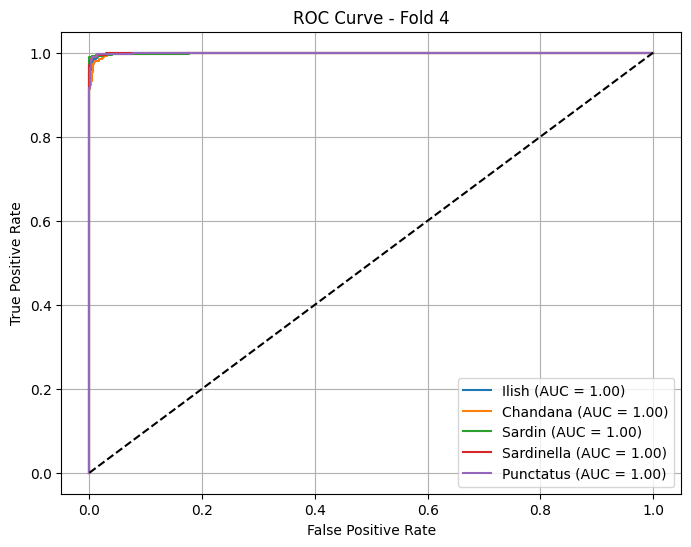

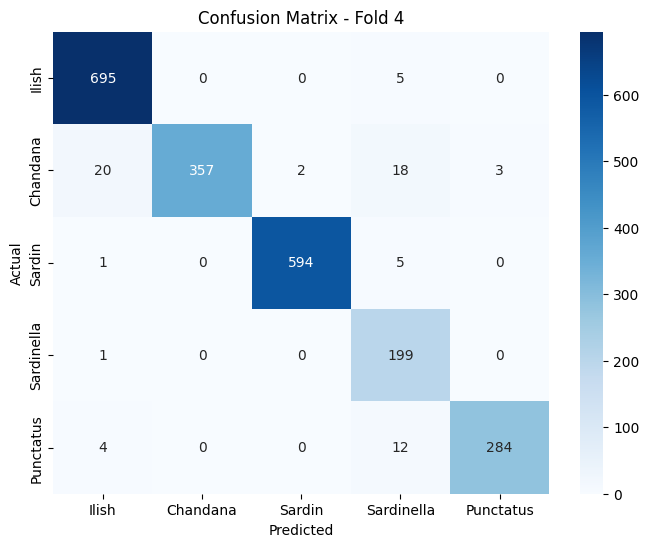

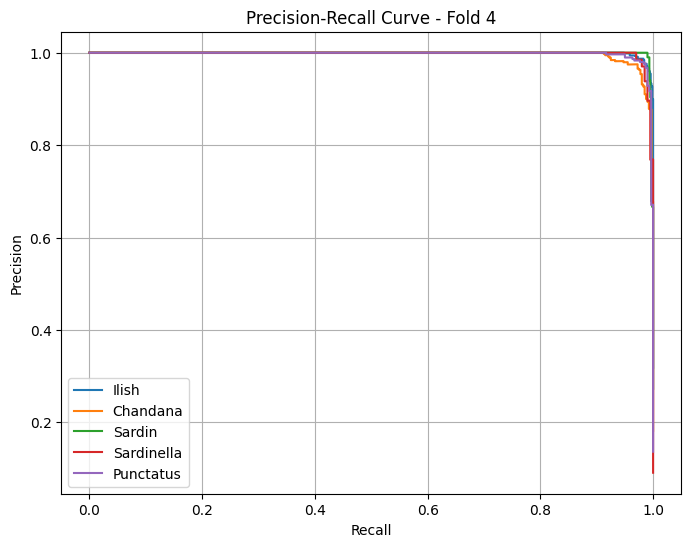

<Figure size 1000x600 with 0 Axes>

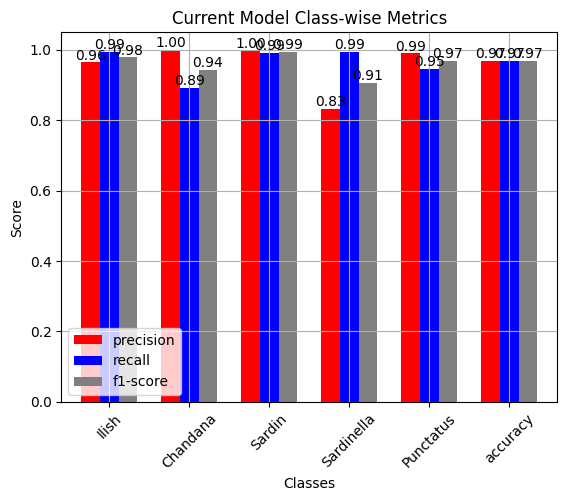

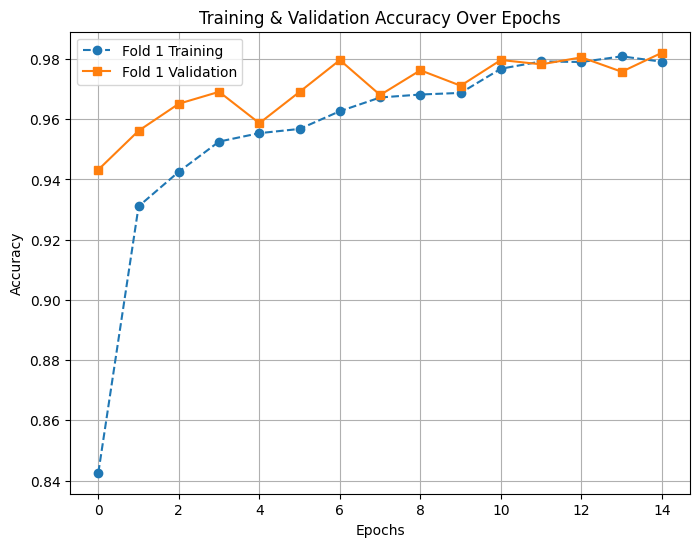

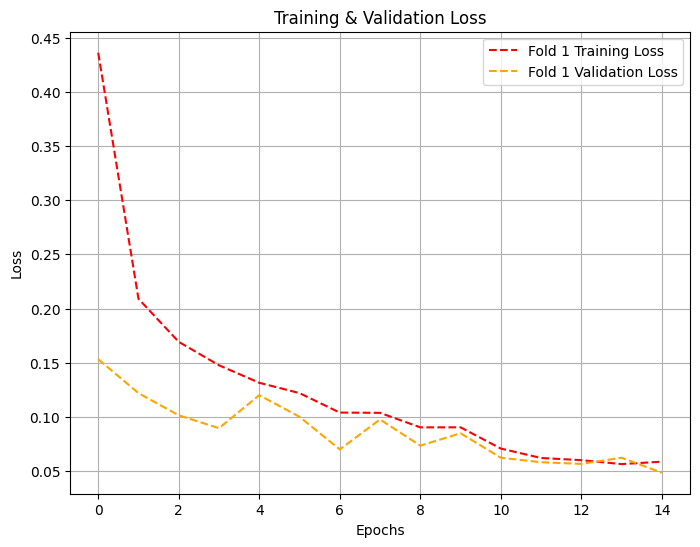

Classification Report - Fold 4:
               precision    recall  f1-score   support

       Ilish       0.96      0.99      0.98       700
    Chandana       1.00      0.89      0.94       400
      Sardin       1.00      0.99      0.99       600
  Sardinella       0.83      0.99      0.91       200
   Punctatus       0.99      0.95      0.97       300

    accuracy                           0.97      2200
   macro avg       0.96      0.96      0.96      2200
weighted avg       0.97      0.97      0.97      2200


Evaluating Fold 5:
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step


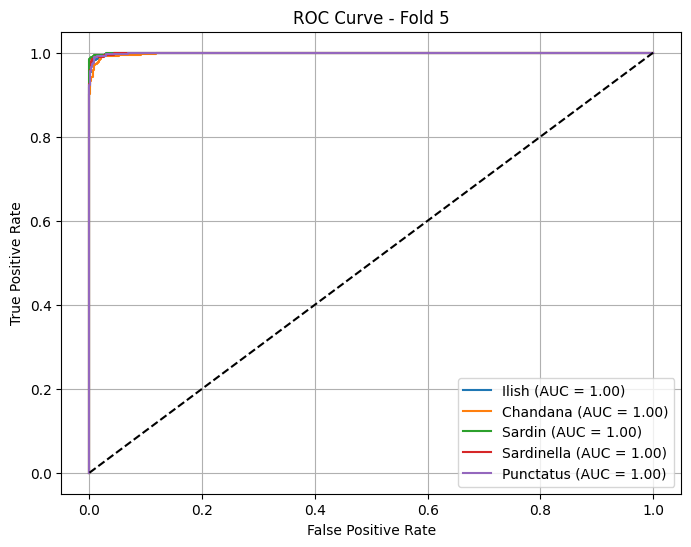

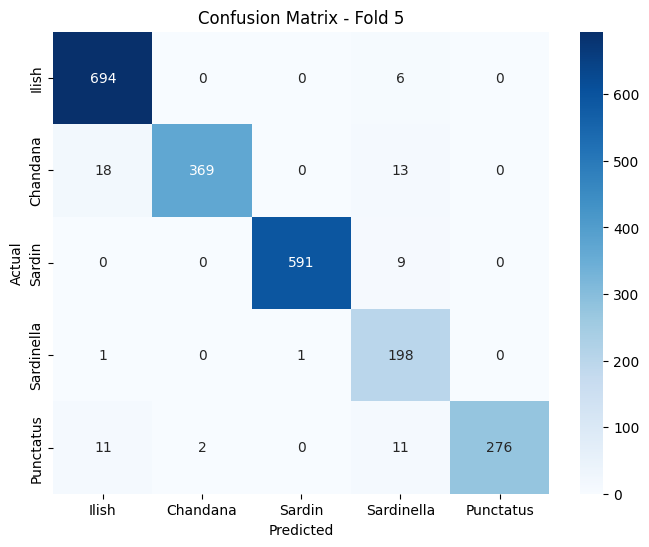

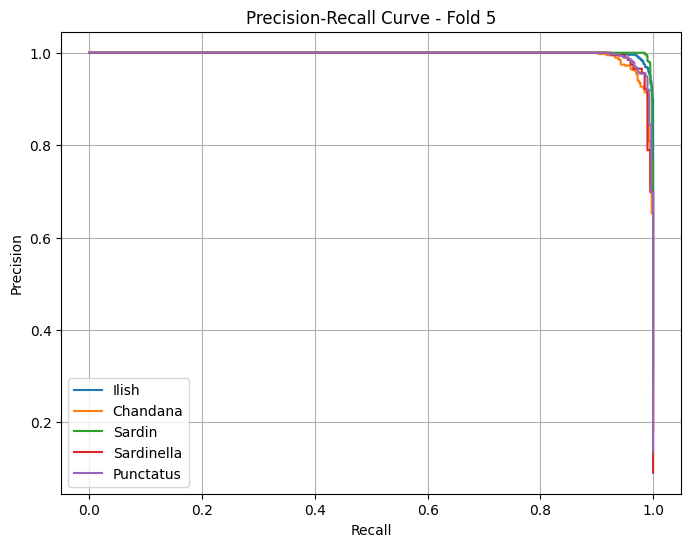

<Figure size 1000x600 with 0 Axes>

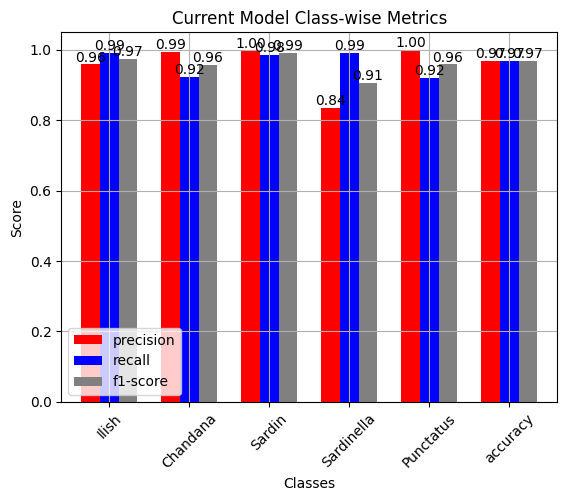

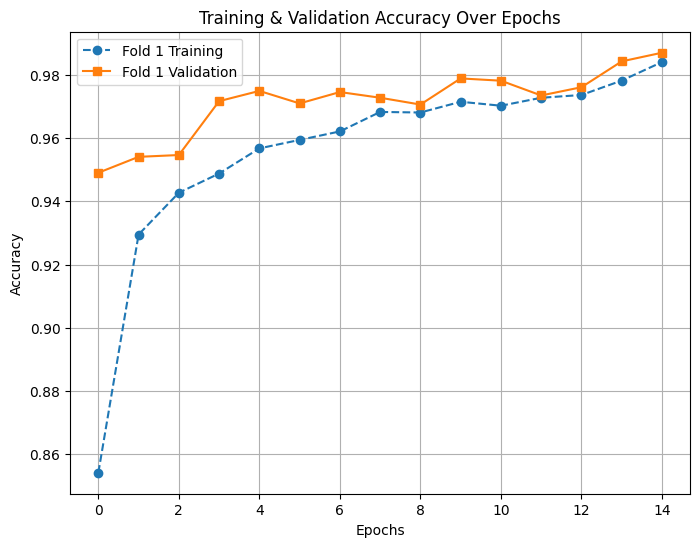

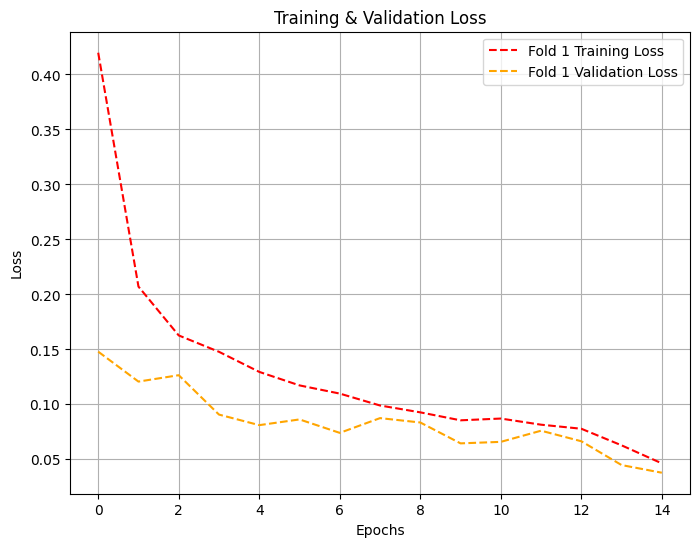

Classification Report - Fold 5:
               precision    recall  f1-score   support

       Ilish       0.96      0.99      0.97       700
    Chandana       0.99      0.92      0.96       400
      Sardin       1.00      0.98      0.99       600
  Sardinella       0.84      0.99      0.91       200
   Punctatus       1.00      0.92      0.96       300

    accuracy                           0.97      2200
   macro avg       0.96      0.96      0.96      2200
weighted avg       0.97      0.97      0.97      2200

Results in a Single Plot....

Processing Fold 1:
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step

Processing Fold 2:
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step

Processing Fold 3:
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step

Processing Fold 4:
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step

Processing Fold 5:
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step


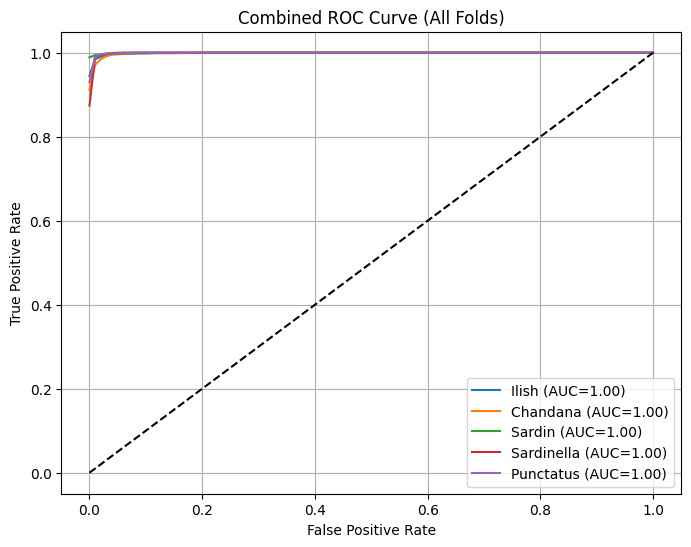

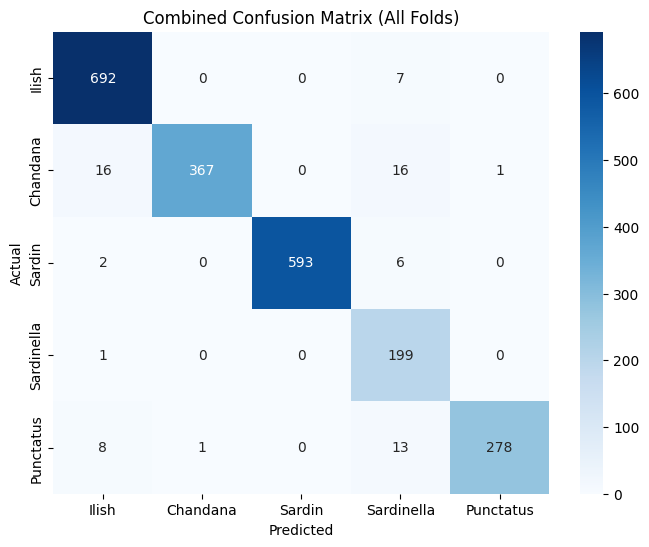

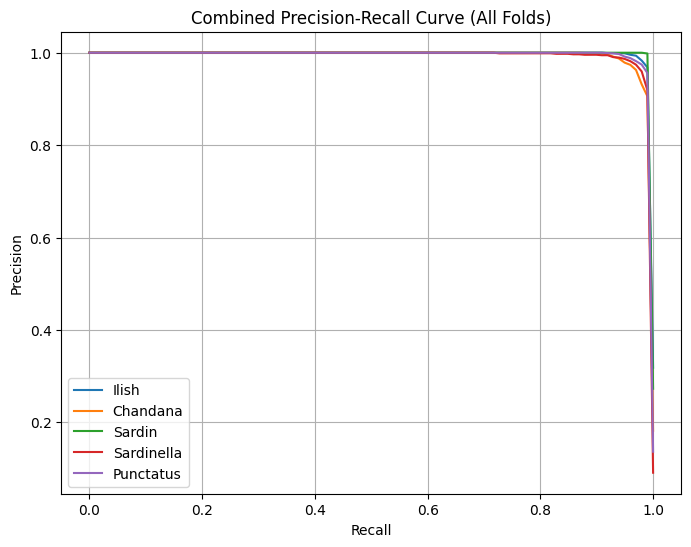

69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 31ms/step
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 30ms/step


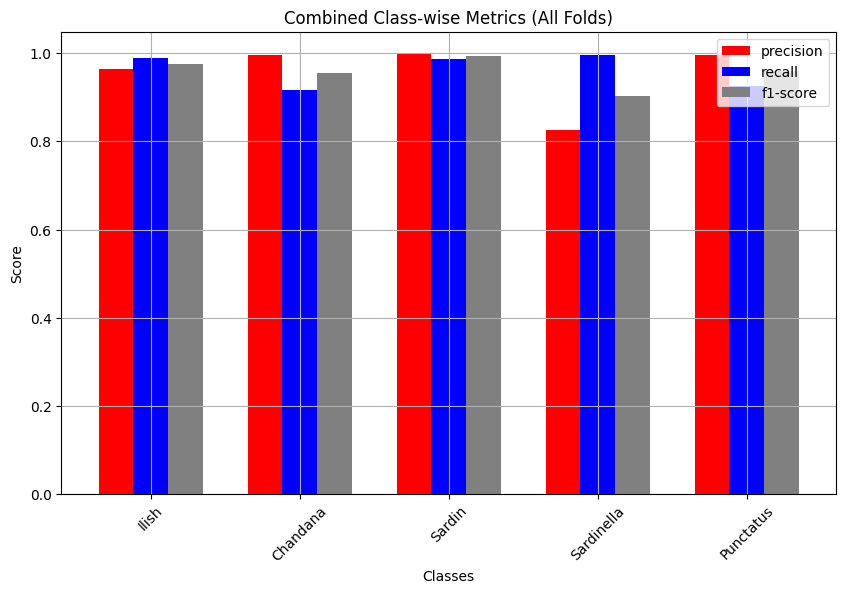

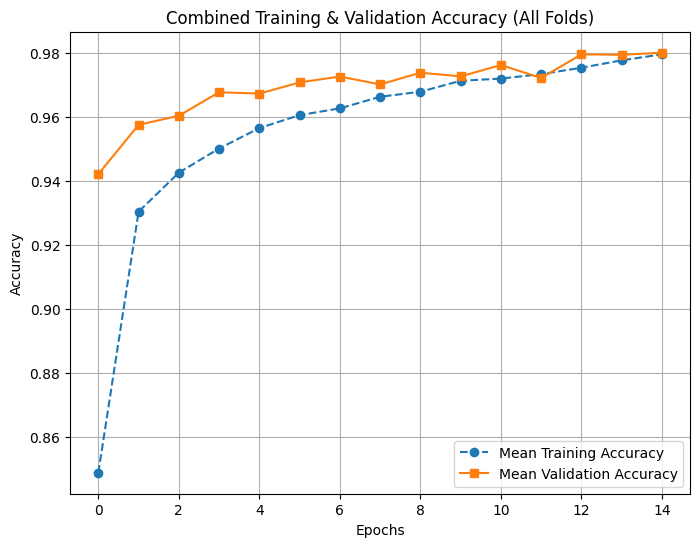

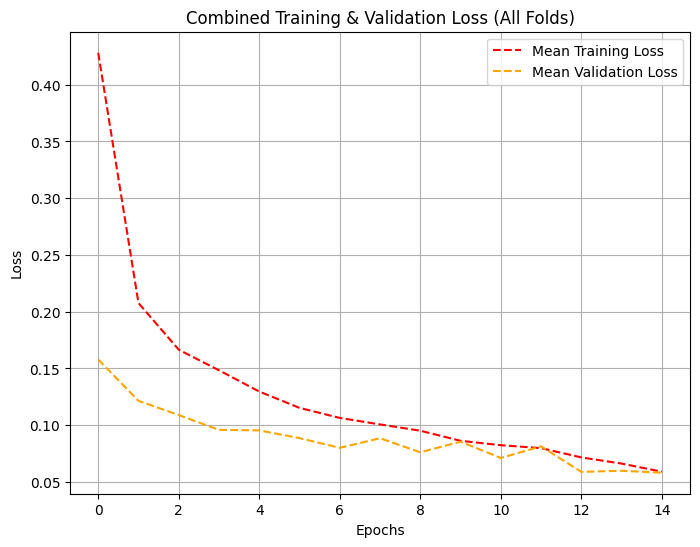


Final Combined Classification Report Across All Folds:
               precision    recall  f1-score   support

       Ilish       0.96      0.99      0.98      3500
    Chandana       1.00      0.92      0.96      2000
      Sardin       1.00      0.99      0.99      3000
  Sardinella       0.82      1.00      0.90      1000
   Punctatus       1.00      0.93      0.96      1500

    accuracy                           0.97     11000
   macro avg       0.96      0.96      0.96     11000
weighted avg       0.97      0.97      0.97     11000


Final Model Performance (Averaged across all folds):
Final Test Accuracy: 0.9678
Final F1 Score: 0.9576


In [ ]:
import numpy as np
import pandas as pd
import tensorflow as tf
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter

from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, LeakyReLU, BatchNormalization
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.metrics import accuracy_score, roc_curve, auc, precision_recall_curve, confusion_matrix, f1_score, classification_report
from imblearn.over_sampling import SMOTE

# Assuming X and Y are already loaded and preprocessed
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=42)

# !pip install imbalanced-learn
# #SMOTE (Synthetic Minority Over-sampling Technique)
# Synthetic Sample=Original Sample+λ×(Neighbor Sample−Original Sample)
# 1.Original Sample is the current sample from the minority class.
# 2.Neighbor Sample is a randomly chosen sample from the k-nearest neighbors.
# 3.λ is a random value between 0 and 1, which controls the degree of interpolation.


# # Apply SMOTE
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_train_resampled, Y_train_resampled = smote.fit_resample(X_train.reshape(X_train.shape[0], -1), Y_train)
X_train_resampled = X_train_resampled.reshape(-1, 224, 224, 3)

import matplotlib.pyplot as plt
import numpy as np

# Display some sample images from the resampled dataset
num_samples_to_show = 5  # Number of sample images to display
fig, axes = plt.subplots(1, num_samples_to_show, figsize=(15, 5))

# Plot the images
for i in range(num_samples_to_show):
    axes[i].imshow(X_train_resampled[i])  # Display the image
    axes[i].set_title(f"Class: {Y_train_resampled[i]}")  # Set the class as the title
    axes[i].axis('off')  # Hide the axis

plt.show()
print(f"Original class distribution: {Counter(Y_train)}")
print(f"Resampled class distribution: {Counter(Y_train_resampled)}")


# Parameters
input_shape = (224, 224, 3)
num_classes = 5
batch_size = 32
epochs = 15
k_folds = 5

datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode="nearest"
)


def batch_generator(X, Y, batch_size=32):
    size = X.shape[0]
    used_indices = set()  # Track used samples per fold
    while True:
        indices = np.random.permutation(size)
        for start in range(0, size, batch_size):
            end = min(start + batch_size, size)
            batch_idx = indices[start:end]

            # Ensure no overlap across folds
            unique_batch_idx = [idx for idx in batch_idx if idx not in used_indices]
            used_indices.update(unique_batch_idx)

            if not unique_batch_idx:  # If all data is used, reset for next epoch
                used_indices.clear()
                continue

            X_batch, Y_batch = X[unique_batch_idx], Y[unique_batch_idx]
            augmented_images = next(datagen.flow(X_batch, shuffle=False, batch_size=len(unique_batch_idx)))
            yield augmented_images, to_categorical(Y_batch, num_classes)


# from tensorflow.keras.applications import
# [
# ResNet50, ResNet101, ResNet152,
# EfficientNetB0, EfficientNetB1, EfficientNetB2, EfficientNetB3, EfficientNetB4, EfficientNetB5, EfficientNetB6, EfficientNetB7,
# VGG16, VGG19,
# Xception,
# InceptionV3, InceptionResNetV2,
# DenseNet121, DenseNet169, DenseNet201,
# MobileNet, MobileNetV2, MobileNetV3Small, MobileNetV3Large,
# NASNetLarge, NASNetMobile
# ]


def create_resnet_model(input_shape=(224, 224, 3)):
    base_model = EfficientNetB0(weights='imagenet', include_top=False, input_shape=input_shape)

    for layer in base_model.layers[:-10]:
        layer.trainable = False
    for layer in base_model.layers[-10:]:
        layer.trainable = True

    x = GlobalAveragePooling2D()(base_model.output)
    x = Dense(256)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.1)(x)
    x = Dropout(0.5)(x)

    x = Dense(128)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.1)(x)
    x = Dropout(0.5)(x)

    output = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=base_model.input, outputs=output)
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    return model

def train_with_kfold(X_train, Y_train, X_test, Y_test, k=5, batch_size=32, epochs=15):
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
    histories = []
    ensemble_predictions = np.zeros((X_test.shape[0], num_classes))

    for fold_no, (train_idx, val_idx) in enumerate(skf.split(X_train, Y_train), 1):
    # for fold_no, (train_idx, val_idx) in enumerate(skf.split(X_train, np.argmax(Y_train, axis=1)), 1):

        print(f"Training Fold {fold_no}/{k}")

        X_train_fold, X_val_fold = X_train[train_idx], X_train[val_idx]
        Y_train_fold, Y_val_fold = Y_train[train_idx], Y_train[val_idx]

        resnet_model = create_resnet_model()
        train_generator = batch_generator(X_train_fold, Y_train_fold, batch_size)
        val_generator = batch_generator(X_val_fold, Y_val_fold, batch_size)

        callbacks = [
            ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, verbose=1),
            ModelCheckpoint(f'best_model_resnet_fold_{fold_no}.keras', save_best_only=True, monitor='val_loss', mode='min'),
            EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
        ]

        history = resnet_model.fit(train_generator, validation_data=val_generator, epochs=epochs, verbose=1,
                                   callbacks=callbacks, steps_per_epoch=len(X_train_fold)//batch_size,
                                   validation_steps=len(X_val_fold)//batch_size)
        histories.append(history)

        resnet_preds = resnet_model.predict(X_test)
        ensemble_predictions += resnet_preds

    ensemble_predictions /= k
    final_classes = np.argmax(ensemble_predictions, axis=1)
    accuracy = np.mean(final_classes == Y_test)
    print(f"Final Model Accuracy: {accuracy * 100:.2f}%")
    return final_classes, histories

final_predictions, history_dict = train_with_kfold(X_train_resampled, Y_train_resampled, X_test, Y_test, k=k_folds)
print("Training Complete. ResNet Model is ready!")






import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from sklearn.metrics import roc_curve, auc, confusion_matrix, precision_recall_curve, classification_report, accuracy_score, f1_score

# Define class labels
class_labels = ['Ilish', 'Chandana', 'Sardin', 'Sardinella', 'Punctatus']

# Function to plot ROC curve
def plot_roc_curve(Y_test, Y_test_pred_prob, class_labels, fold_no):
    plt.figure(figsize=(8, 6))
    for i in range(len(class_labels)):
        y_true_binary = (Y_test == i).astype(int)
        y_score = Y_test_pred_prob[:, i]
        fpr, tpr, _ = roc_curve(y_true_binary, y_score)
        roc_auc = auc(fpr, tpr)
        plt.plot(fpr, tpr, label=f'{class_labels[i]} (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], 'k--')
    plt.title(f'ROC Curve - Fold {fold_no}')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend()
    plt.grid()
    plt.show()

# Function to plot Confusion Matrix
def plot_confusion_matrix(Y_test, Y_test_pred, class_labels, fold_no):
    conf_matrix = confusion_matrix(Y_test, Y_test_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
    plt.title(f'Confusion Matrix - Fold {fold_no}')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show()

# Function to plot Precision-Recall curve
def plot_precision_recall_curve(Y_test, Y_test_pred_prob, class_labels, fold_no):
    plt.figure(figsize=(8, 6))
    for i in range(len(class_labels)):
        precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), Y_test_pred_prob[:, i])
        plt.plot(recall, precision, label=f'{class_labels[i]}')
    plt.title(f'Precision-Recall Curve - Fold {fold_no}')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.legend()
    plt.grid()
    plt.show()

# Function to plot Training & Validation Accuracy over epochs
def plot_accuracy(history_list):
    plt.figure(figsize=(8, 6))
    for i, history in enumerate(history_list):
        plt.plot(history.history['accuracy'], label=f'Fold {i+1} Training', linestyle='dashed', marker='o')
        plt.plot(history.history['val_accuracy'], label=f'Fold {i+1} Validation', marker='s')
    plt.title('Training & Validation Accuracy Over Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid()
    plt.show()

# Function to plot Training & Validation Loss over epochs
def plot_loss(history_list):
    plt.figure(figsize=(8, 6))
    for i, history in enumerate(history_list):
        plt.plot(history.history['loss'], label=f'Fold {i+1} Training Loss', linestyle='dashed', color='red')
        plt.plot(history.history['val_loss'], label=f'Fold {i+1} Validation Loss', linestyle='dashed', color='orange')
    plt.title('Training & Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid()
    plt.show()



# Function to compare class-wise metrics
def plot_classwise_metrics(Y_test, Y_test_pred, prev_Y_test_pred=None):
    report = classification_report(Y_test, Y_test_pred, target_names=class_labels, output_dict=True)
    df_report = pd.DataFrame(report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]
    colors = {'precision': 'red', 'recall': 'blue', 'f1-score': 'gray'}

    # Current model class-wise metrics
    plt.figure(figsize=(10, 6))
    df_report.plot(kind='bar', width=0.7, color=[colors[col] for col in df_report.columns])
    for p in plt.gca().patches:
        plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width() / 2, p.get_height()),
                           ha='center', va='bottom', fontsize=10, color='black')
    plt.title('Current Model Class-wise Metrics')
    plt.xlabel('Classes')
    plt.ylabel('Score')
    plt.xticks(rotation=45)
    plt.legend()
    plt.grid()
    plt.show()

    # Previous model class-wise metrics (if available)
    if prev_Y_test_pred is not None:
        prev_report = classification_report(Y_test, prev_Y_test_pred, target_names=class_labels, output_dict=True)
        prev_df_report = pd.DataFrame(prev_report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]

        plt.figure(figsize=(10, 6))
        prev_df_report.plot(kind='bar', width=0.7, color=['pink', 'lightblue', 'lightgray'])
        for p in plt.gca().patches:
            plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width() / 2, p.get_height()),
                               ha='center', va='bottom', fontsize=10, color='black')
        plt.title('Previous Model Class-wise Metrics')
        plt.xlabel('Classes')
        plt.ylabel('Score')
        plt.xticks(rotation=45)
        plt.legend()
        plt.grid()
        plt.show()

# Function to display classification report
def print_classification_report(Y_test, Y_test_pred, class_labels, fold_no):
    report = classification_report(Y_test, Y_test_pred, target_names=class_labels)
    print(f"Classification Report - Fold {fold_no}:\n", report)

# Generate all individual plots for each fold
for fold_no, history in enumerate(history_dict, 1):
    print(f"\nEvaluating Fold {fold_no}:")

    # Get predictions for the current fold (final_predictions for this fold)
    fold_predictions = history.model.predict(X_test)  # or use history if separate fold predictions are stored
    plot_roc_curve(Y_test, fold_predictions, class_labels, fold_no)
    plot_confusion_matrix(Y_test, np.argmax(fold_predictions, axis=1), class_labels, fold_no)
    plot_precision_recall_curve(Y_test, fold_predictions, class_labels, fold_no)
    plot_classwise_metrics(Y_test, np.argmax(fold_predictions, axis=1))  # Class-wise metrics for the current fold
    # Call accuracy and loss plot functions for the current fold
    plot_accuracy([history])  # Pass a list with a single fold's history
    plot_loss([history])  # Pass a list with a single fold's history
    #Classification Report
    print_classification_report(Y_test, np.argmax(fold_predictions, axis=1), class_labels, fold_no)










#For All the Results in a single plot
print("Results in a Single Plot....")

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from sklearn.metrics import roc_curve, auc, precision_recall_curve, confusion_matrix, classification_report

# Initialize lists to store results from all folds
all_fpr, all_tpr, all_roc_auc = [], [], []
all_precisions, all_recalls = [], []
all_conf_matrices = []
history_list = []
all_predictions = []
all_true_labels = []

num_classes = len(class_labels)

for fold_no, history in enumerate(history_dict, 1):
    print(f"\nProcessing Fold {fold_no}:")

    # Get predictions and true labels
    fold_predictions = history.model.predict(X_test)
    fold_pred_labels = np.argmax(fold_predictions, axis=1)

    all_predictions.append(fold_predictions)
    all_true_labels.append(Y_test)

    # Store training history
    history_list.append(history)

    # ROC Curve
    fold_fpr, fold_tpr, fold_auc = [], [], []
    for i in range(num_classes):
        y_true_binary = (Y_test == i).astype(int)
        y_score = fold_predictions[:, i]
        fpr, tpr, _ = roc_curve(y_true_binary, y_score)
        fold_fpr.append(fpr)
        fold_tpr.append(tpr)
        fold_auc.append(auc(fpr, tpr))

    all_fpr.append(fold_fpr)
    all_tpr.append(fold_tpr)
    all_roc_auc.append(fold_auc)

    # Precision-Recall Curve
    fold_precisions, fold_recalls = [], []
    for i in range(num_classes):
        precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), fold_predictions[:, i])
        fold_precisions.append(precision)
        fold_recalls.append(recall)

    all_precisions.append(fold_precisions)
    all_recalls.append(fold_recalls)

    # Confusion Matrix
    all_conf_matrices.append(confusion_matrix(Y_test, fold_pred_labels))

# Convert predictions and true labels to numpy arrays
all_predictions = np.vstack(all_predictions)
all_true_labels = np.hstack(all_true_labels)

# **1. Combined ROC Curve**
plt.figure(figsize=(8, 6))
mean_fpr = np.linspace(0, 1, 100)  # Standard length for interpolation

for i in range(num_classes):
    interpolated_tprs = [np.interp(mean_fpr, all_fpr[j][i], all_tpr[j][i]) for j in range(len(all_fpr))]
    mean_tpr = np.mean(interpolated_tprs, axis=0)
    mean_auc = np.mean([all_roc_auc[j][i] for j in range(len(all_roc_auc))])
    plt.plot(mean_fpr, mean_tpr, label=f'{class_labels[i]} (AUC={mean_auc:.2f})')

plt.plot([0, 1], [0, 1], 'k--')
plt.title('Combined ROC Curve (All Folds)')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.grid()
plt.show()

# **2. Combined Confusion Matrix**
mean_conf_matrix = np.mean(all_conf_matrices, axis=0)
plt.figure(figsize=(8, 6))
sns.heatmap(mean_conf_matrix, annot=True, fmt='.0f', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.title('Combined Confusion Matrix (All Folds)')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# **3. Combined Precision-Recall Curve**
plt.figure(figsize=(8, 6))
for i in range(num_classes):
    interpolated_precisions = [np.interp(mean_fpr, all_recalls[j][i][::-1], all_precisions[j][i][::-1]) for j in range(len(all_recalls))]
    mean_precision = np.mean(interpolated_precisions, axis=0)
    mean_recall = np.linspace(0, 1, 100)
    plt.plot(mean_recall, mean_precision, label=f'{class_labels[i]}')

plt.title('Combined Precision-Recall Curve (All Folds)')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.legend()
plt.grid()
plt.show()

# **4. Combined Class-wise Metrics**
all_reports = [classification_report(Y_test, np.argmax(history.model.predict(X_test), axis=1),
                                     target_names=class_labels, output_dict=True) for history in history_dict]
avg_report = {}
for label in class_labels:
    avg_report[label] = {
        'precision': np.mean([r[label]['precision'] for r in all_reports]),
        'recall': np.mean([r[label]['recall'] for r in all_reports]),
        'f1-score': np.mean([r[label]['f1-score'] for r in all_reports])
    }
df_avg_report = pd.DataFrame(avg_report).transpose()
df_avg_report.plot(kind='bar', width=0.7, figsize=(10, 6), color=['red', 'blue', 'gray'])
plt.title('Combined Class-wise Metrics (All Folds)')
plt.xlabel('Classes')
plt.ylabel('Score')
plt.xticks(rotation=45)
plt.legend()
plt.grid()
plt.show()

# **5. Combined Training & Validation Accuracy**
plt.figure(figsize=(8, 6))
mean_train_acc = np.mean([history.history['accuracy'] for history in history_list], axis=0)
mean_val_acc = np.mean([history.history['val_accuracy'] for history in history_list], axis=0)
plt.plot(mean_train_acc, label='Mean Training Accuracy', linestyle='dashed', marker='o')
plt.plot(mean_val_acc, label='Mean Validation Accuracy', marker='s')
plt.title('Combined Training & Validation Accuracy (All Folds)')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()
plt.show()

# **6. Combined Training & Validation Loss**
plt.figure(figsize=(8, 6))
mean_train_loss = np.mean([history.history['loss'] for history in history_list], axis=0)
mean_val_loss = np.mean([history.history['val_loss'] for history in history_list], axis=0)
plt.plot(mean_train_loss, label='Mean Training Loss', linestyle='dashed', color='red')
plt.plot(mean_val_loss, label='Mean Validation Loss', linestyle='dashed', color='orange')
plt.title('Combined Training & Validation Loss (All Folds)')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()

# **7. Print Combined Classification Report**
final_report = classification_report(all_true_labels, np.argmax(all_predictions, axis=1), target_names=class_labels)
print("\nFinal Combined Classification Report Across All Folds:\n", final_report)



from sklearn.metrics import accuracy_score, f1_score
# Compute final accuracy
final_accuracy = accuracy_score(all_true_labels, np.argmax(all_predictions, axis=1))
# Compute final F1 score (macro average across all classes)
final_f1_score = f1_score(all_true_labels, np.argmax(all_predictions, axis=1), average='macro')
# Print the final model performance
print("\nFinal Model Performance (Averaged across all folds):")
print(f"Final Test Accuracy: {final_accuracy:.4f}")
print(f"Final F1 Score: {final_f1_score:.4f}")


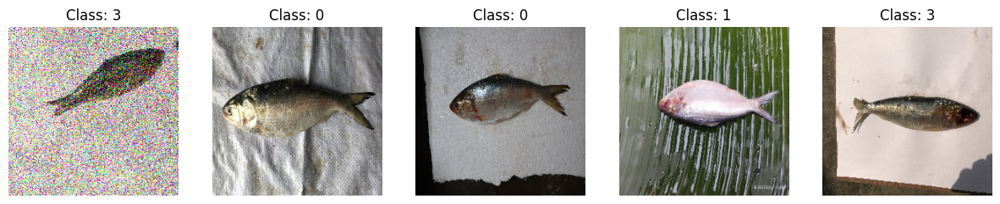

Original class distribution: Counter({np.int64(0): 2800, np.int64(2): 2400, np.int64(1): 1600, np.int64(4): 1200, np.int64(3): 800})
Resampled class distribution: Counter({np.int64(3): 2800, np.int64(0): 2800, np.int64(1): 2800, np.int64(4): 2800, np.int64(2): 2800})
Training Fold 1/5
9406464/9406464 ━━━━━━━━━━━━━━━━━━━━ 1s 0us/step


/usr/local/lib/python3.11/dist-packages/keras/src/layers/activations/leaky_relu.py:41: UserWarning: Argument `alpha` is deprecated. Use `negative_slope` instead.
  warnings.warn(


Epoch 1/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 152s 391ms/step - accuracy: 0.5965 - loss: 1.1029 - val_accuracy: 0.2367 - val_loss: 8.4031 - learning_rate: 0.0010
Epoch 2/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 132s 378ms/step - accuracy: 0.7525 - loss: 0.6786 - val_accuracy: 0.2033 - val_loss: 14.2224 - learning_rate: 0.0010
Epoch 3/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 134s 384ms/step - accuracy: 0.7907 - loss: 0.5851 - val_accuracy: 0.1968 - val_loss: 13.7753 - learning_rate: 0.0010
Epoch 4/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 0s 309ms/step - accuracy: 0.8028 - loss: 0.5237
Epoch 4: ReduceLROnPlateau reducing learning rate to 0.0005000000237487257.
350/350 ━━━━━━━━━━━━━━━━━━━━ 135s 386ms/step - accuracy: 0.8028 - loss: 0.5237 - val_accuracy: 0.2349 - val_loss: 9.5117 - learning_rate: 0.0010
Epoch 5/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 129s 369ms/step - accuracy: 0.8271 - loss: 0.4732 - val_accuracy: 0.3003 - val_loss: 4.6721 - learning_rate: 5.0000e-04
Epoch 6/15
350/350 ━━━━━━━━━━━━━━━━━━━━ 124s 356ms/step - acc

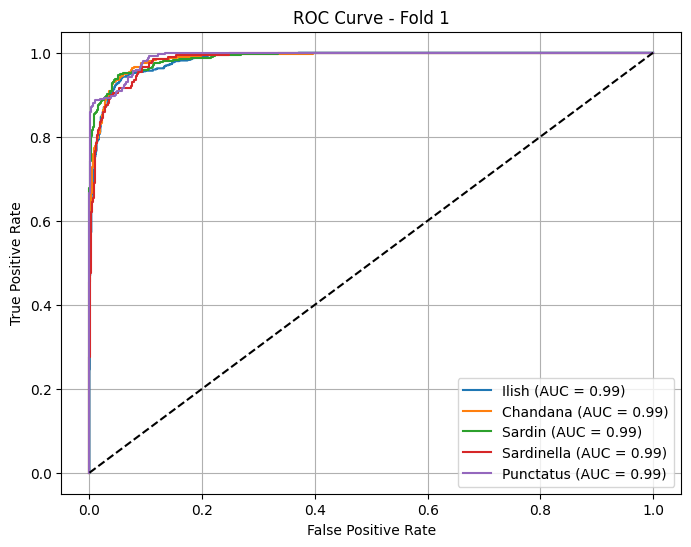

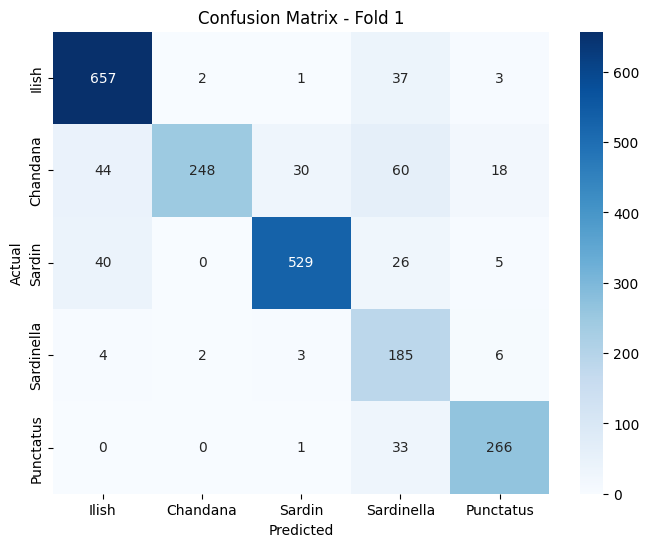

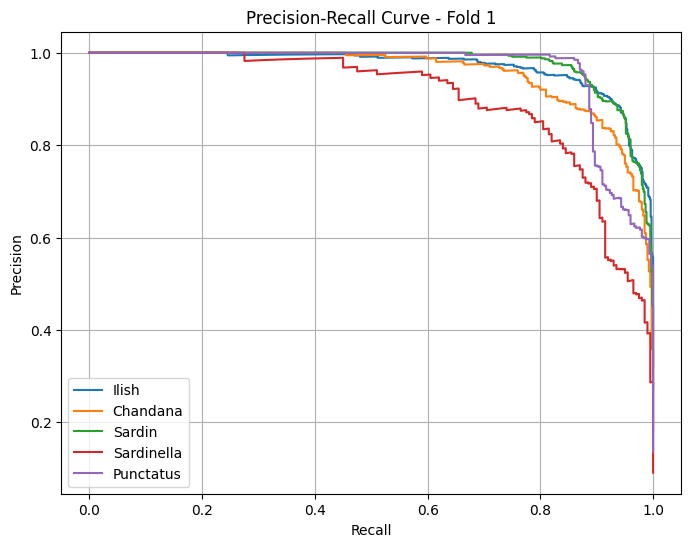

<Figure size 1000x600 with 0 Axes>

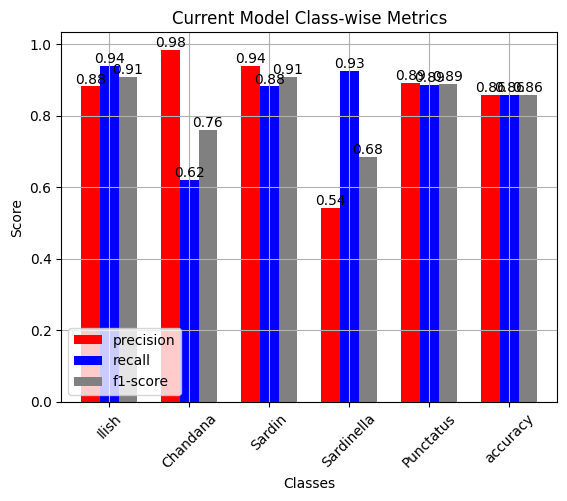

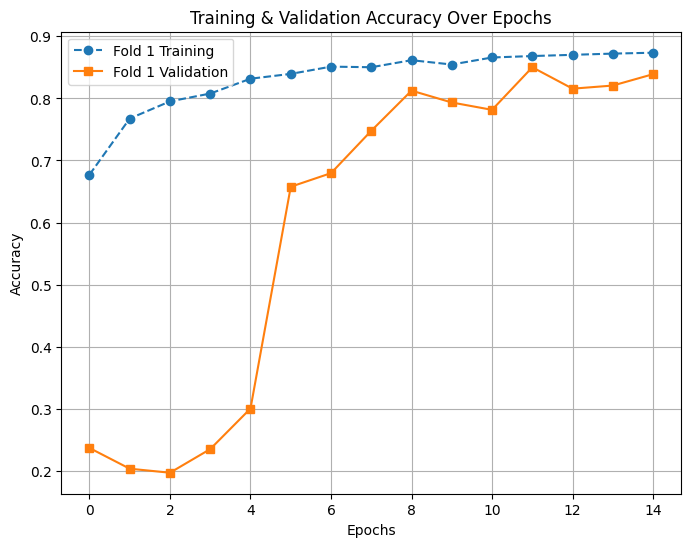

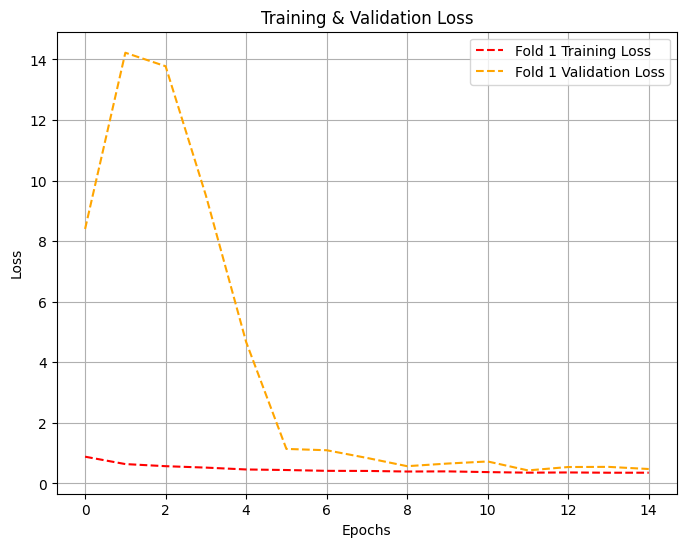

Classification Report - Fold 1:
               precision    recall  f1-score   support

       Ilish       0.88      0.94      0.91       700
    Chandana       0.98      0.62      0.76       400
      Sardin       0.94      0.88      0.91       600
  Sardinella       0.54      0.93      0.68       200
   Punctatus       0.89      0.89      0.89       300

    accuracy                           0.86      2200
   macro avg       0.85      0.85      0.83      2200
weighted avg       0.89      0.86      0.86      2200


Evaluating Fold 2:
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 24ms/step


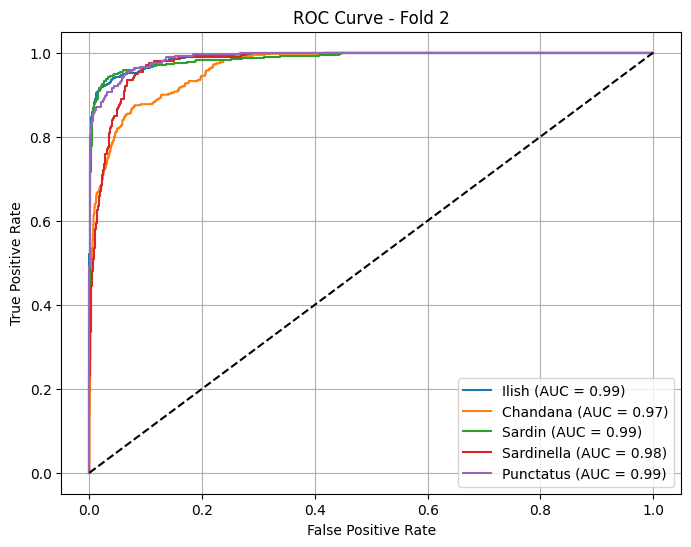

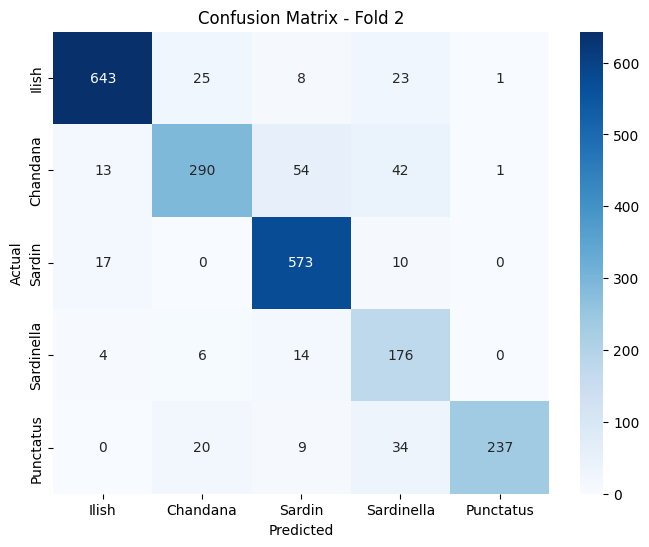

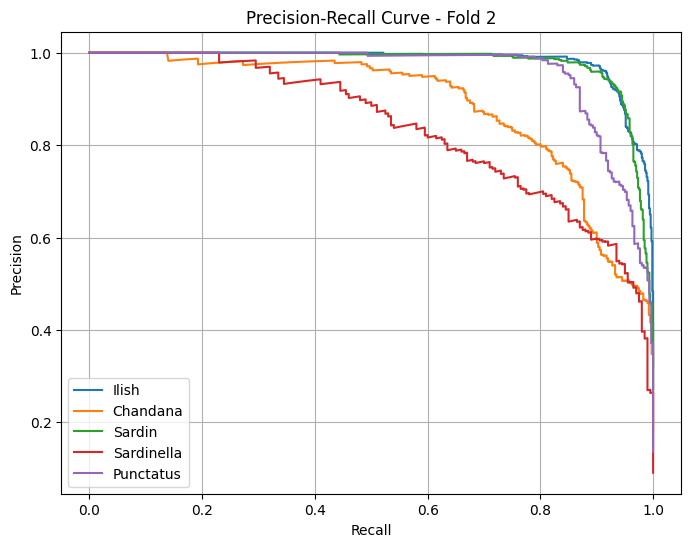

<Figure size 1000x600 with 0 Axes>

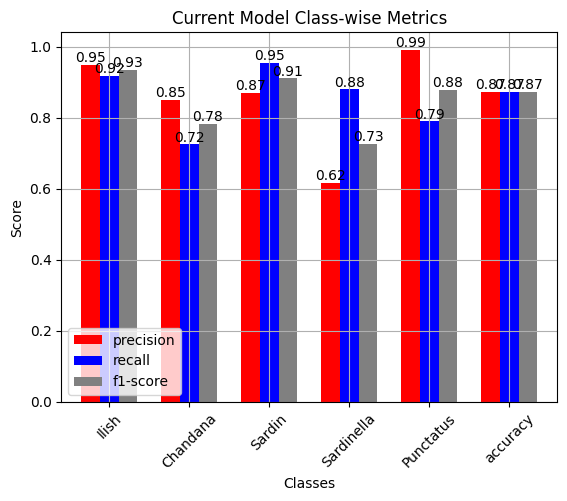

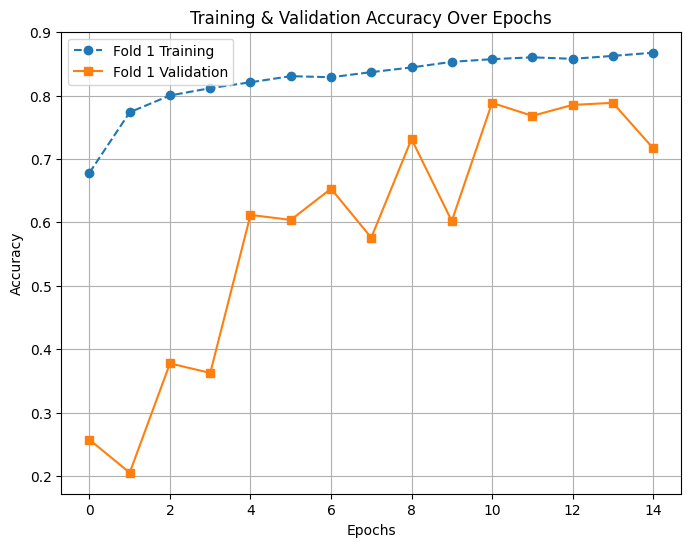

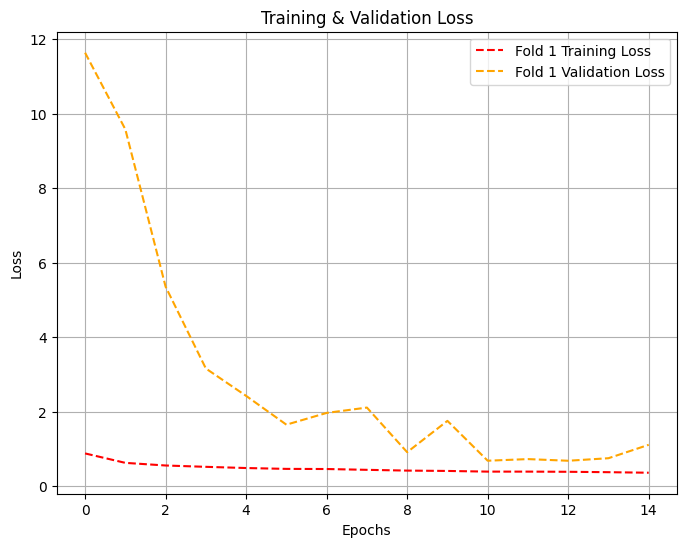

Classification Report - Fold 2:
               precision    recall  f1-score   support

       Ilish       0.95      0.92      0.93       700
    Chandana       0.85      0.72      0.78       400
      Sardin       0.87      0.95      0.91       600
  Sardinella       0.62      0.88      0.73       200
   Punctatus       0.99      0.79      0.88       300

    accuracy                           0.87      2200
   macro avg       0.86      0.85      0.85      2200
weighted avg       0.89      0.87      0.87      2200


Evaluating Fold 3:
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 24ms/step


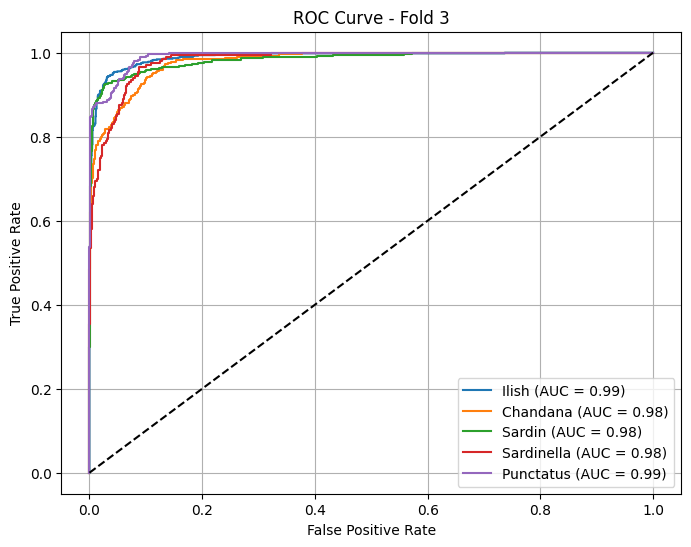

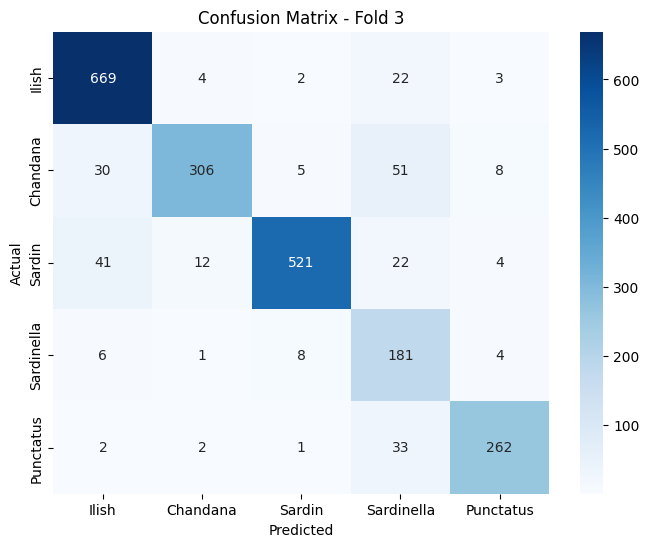

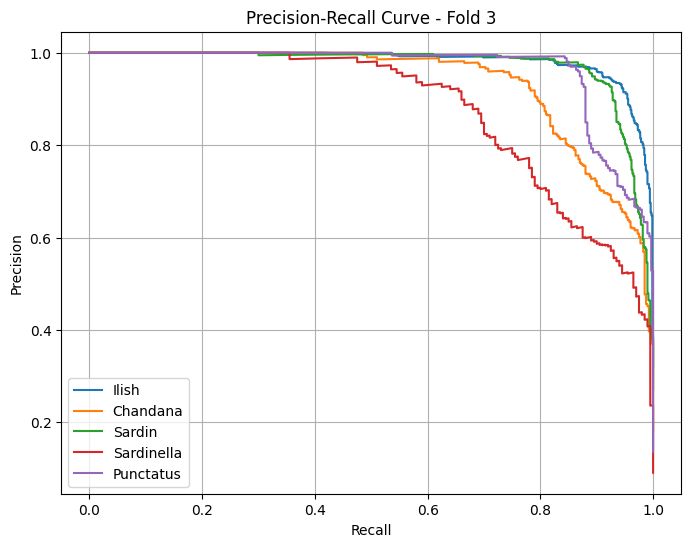

<Figure size 1000x600 with 0 Axes>

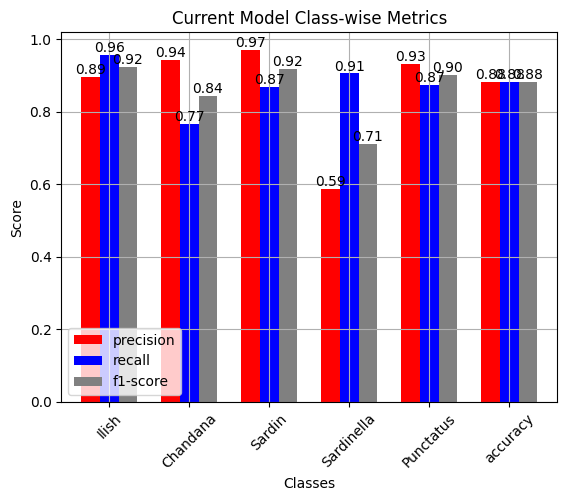

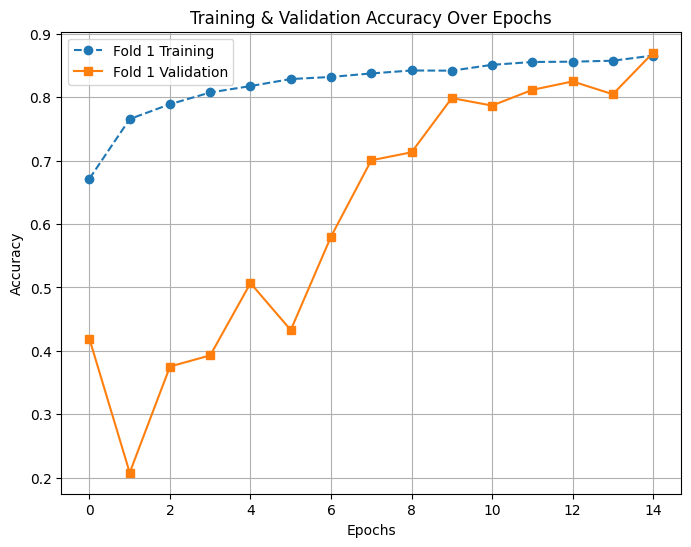

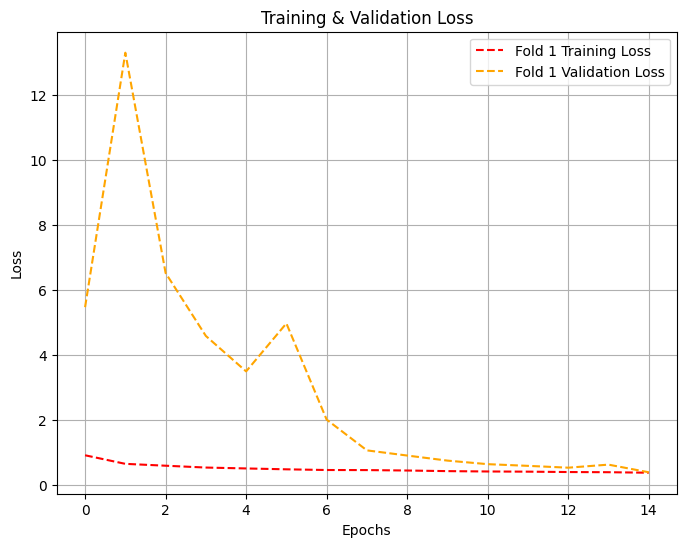

Classification Report - Fold 3:
               precision    recall  f1-score   support

       Ilish       0.89      0.96      0.92       700
    Chandana       0.94      0.77      0.84       400
      Sardin       0.97      0.87      0.92       600
  Sardinella       0.59      0.91      0.71       200
   Punctatus       0.93      0.87      0.90       300

    accuracy                           0.88      2200
   macro avg       0.86      0.87      0.86      2200
weighted avg       0.90      0.88      0.89      2200


Evaluating Fold 4:
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step


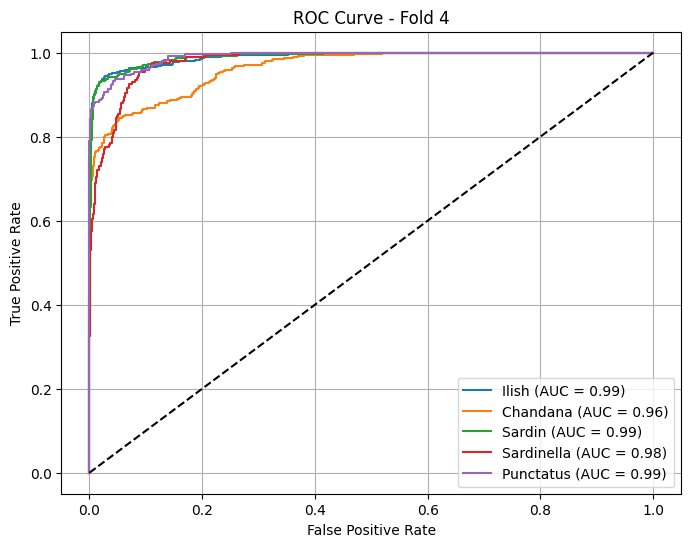

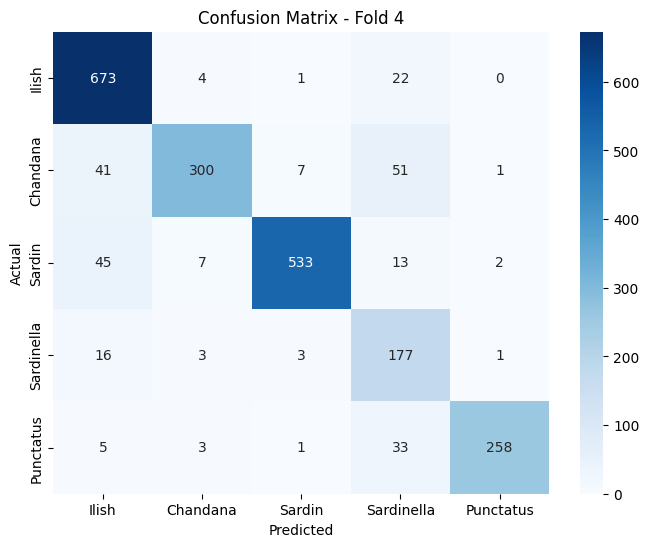

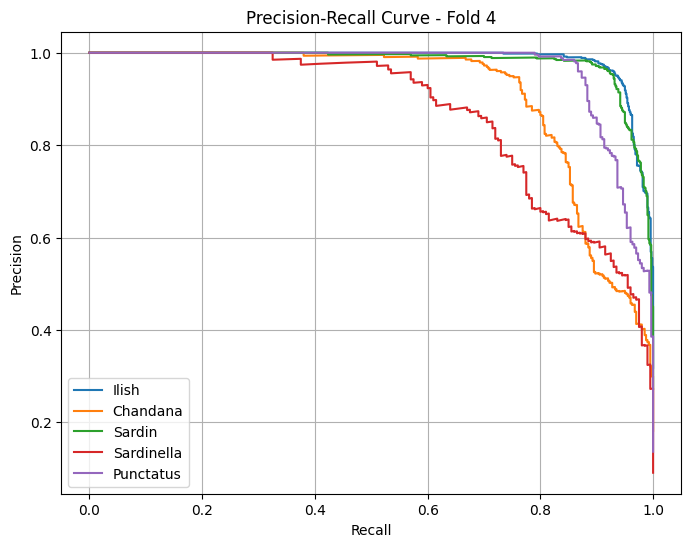

<Figure size 1000x600 with 0 Axes>

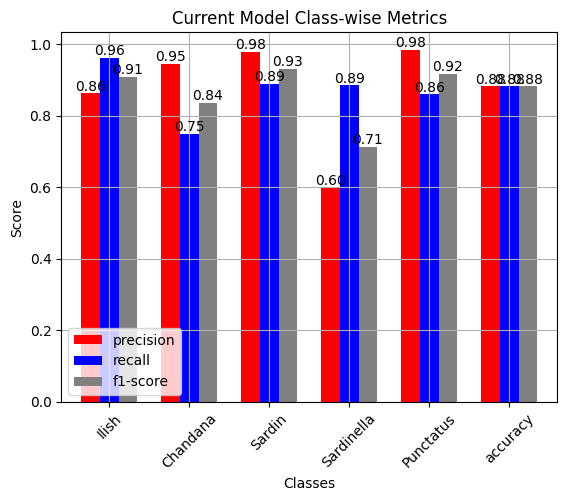

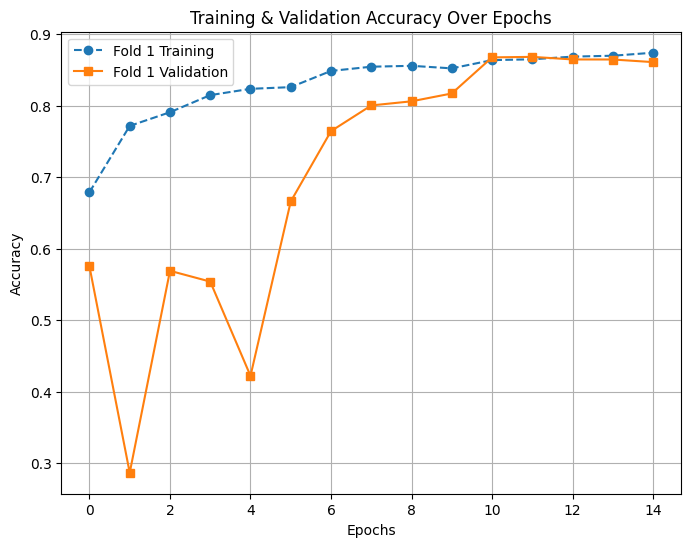

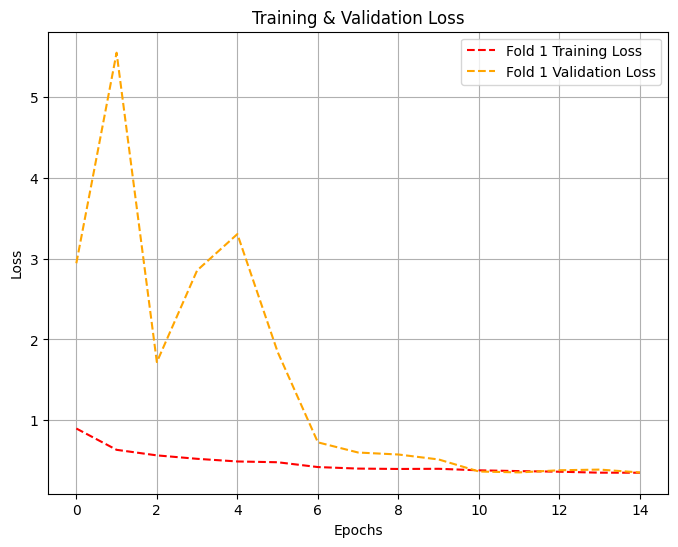

Classification Report - Fold 4:
               precision    recall  f1-score   support

       Ilish       0.86      0.96      0.91       700
    Chandana       0.95      0.75      0.84       400
      Sardin       0.98      0.89      0.93       600
  Sardinella       0.60      0.89      0.71       200
   Punctatus       0.98      0.86      0.92       300

    accuracy                           0.88      2200
   macro avg       0.87      0.87      0.86      2200
weighted avg       0.90      0.88      0.89      2200


Evaluating Fold 5:
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 24ms/step


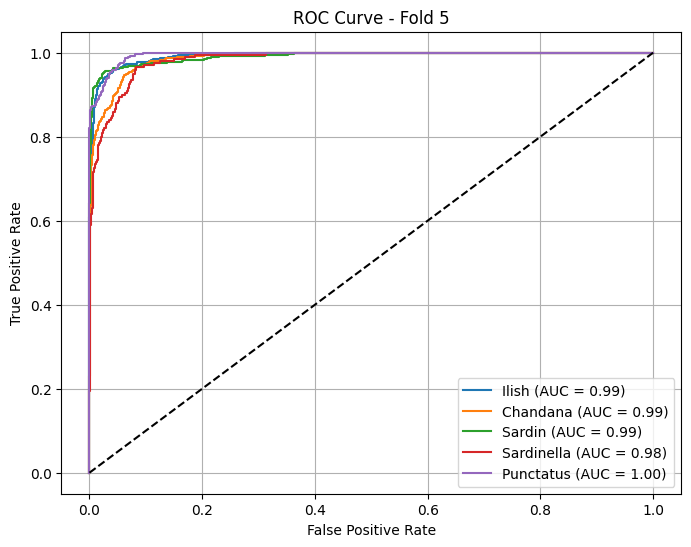

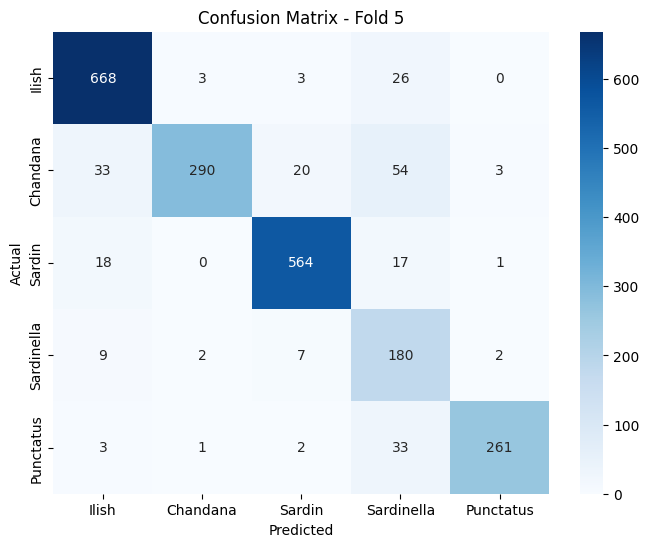

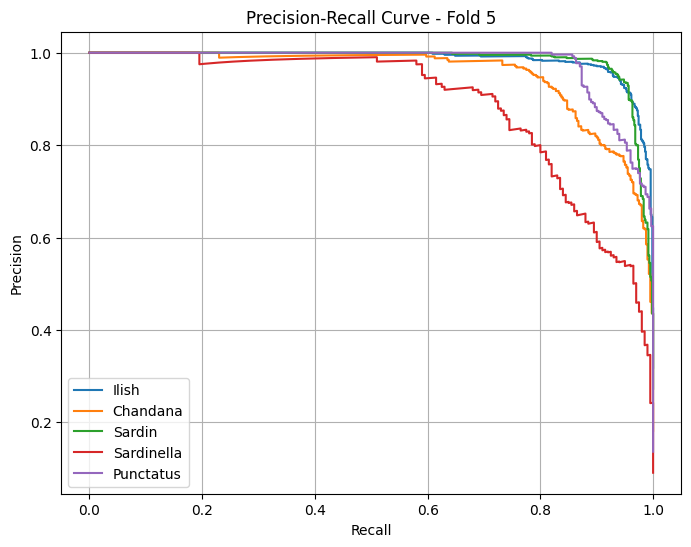

<Figure size 1000x600 with 0 Axes>

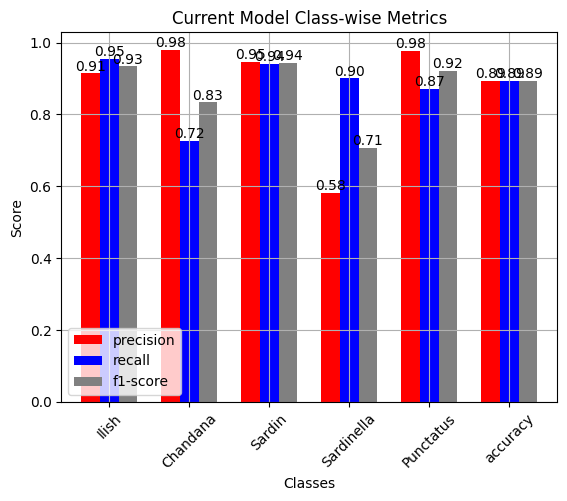

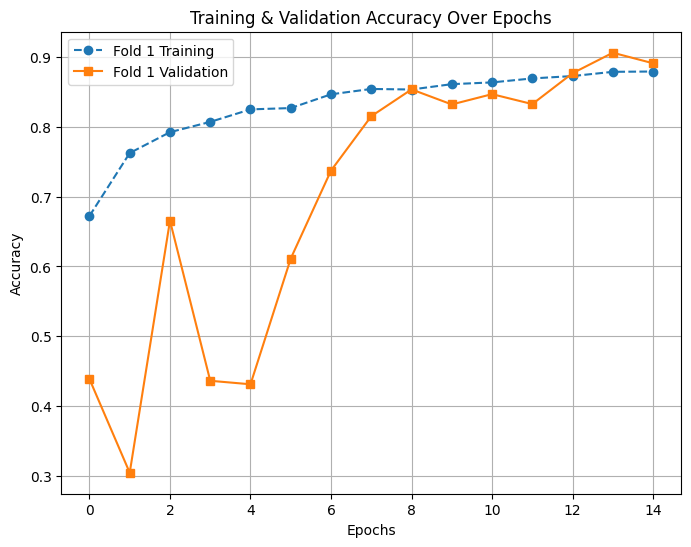

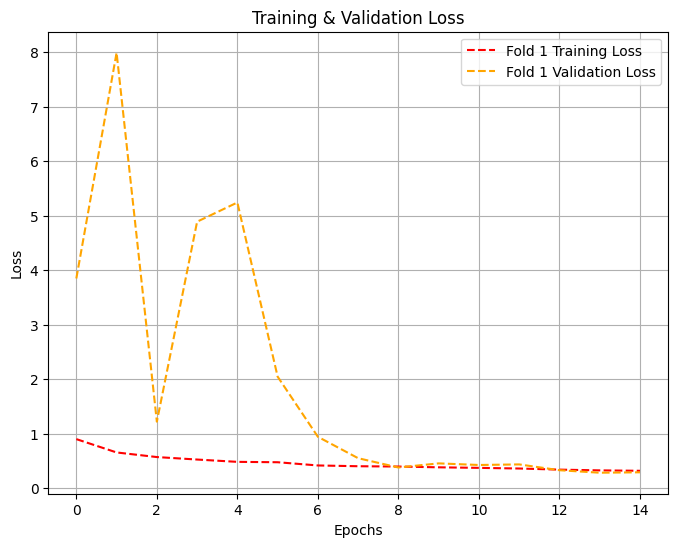

Classification Report - Fold 5:
               precision    recall  f1-score   support

       Ilish       0.91      0.95      0.93       700
    Chandana       0.98      0.72      0.83       400
      Sardin       0.95      0.94      0.94       600
  Sardinella       0.58      0.90      0.71       200
   Punctatus       0.98      0.87      0.92       300

    accuracy                           0.89      2200
   macro avg       0.88      0.88      0.87      2200
weighted avg       0.91      0.89      0.90      2200

Results in a Single Plot....

Processing Fold 1:
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step

Processing Fold 2:
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step

Processing Fold 3:
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step

Processing Fold 4:
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step

Processing Fold 5:
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step


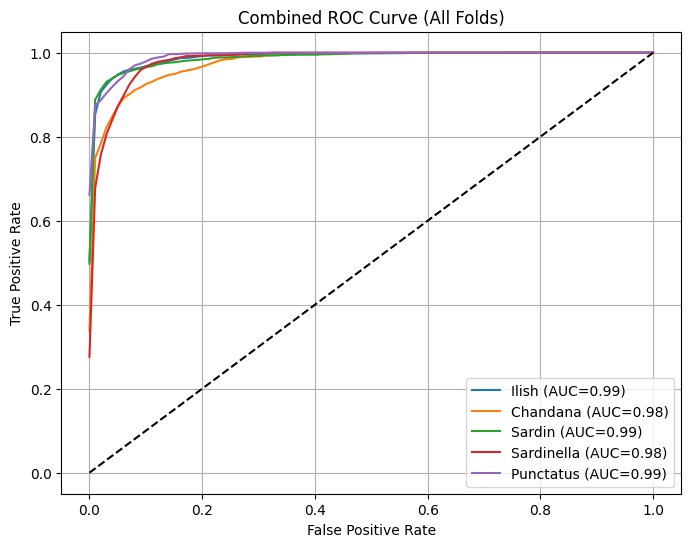

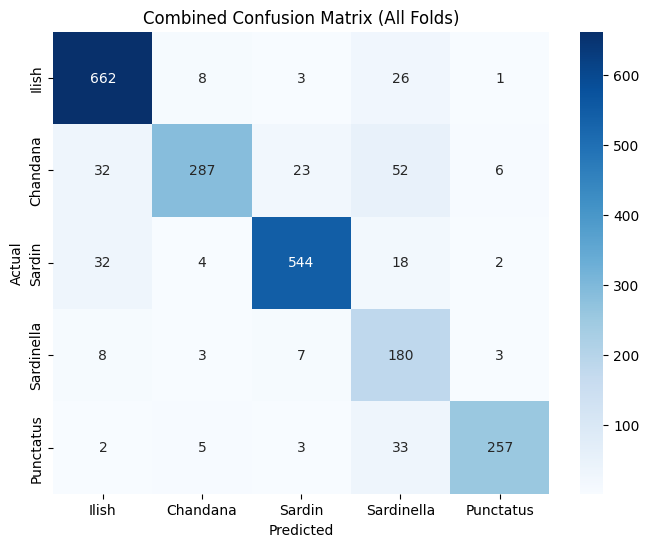

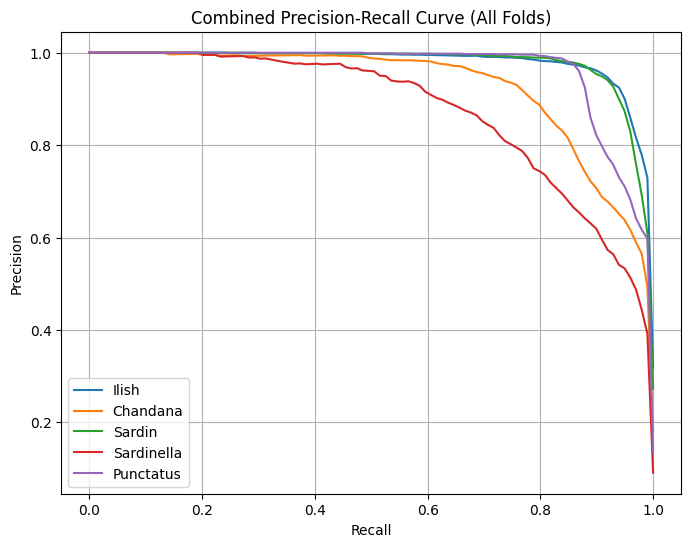

69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step
69/69 ━━━━━━━━━━━━━━━━━━━━ 2s 23ms/step


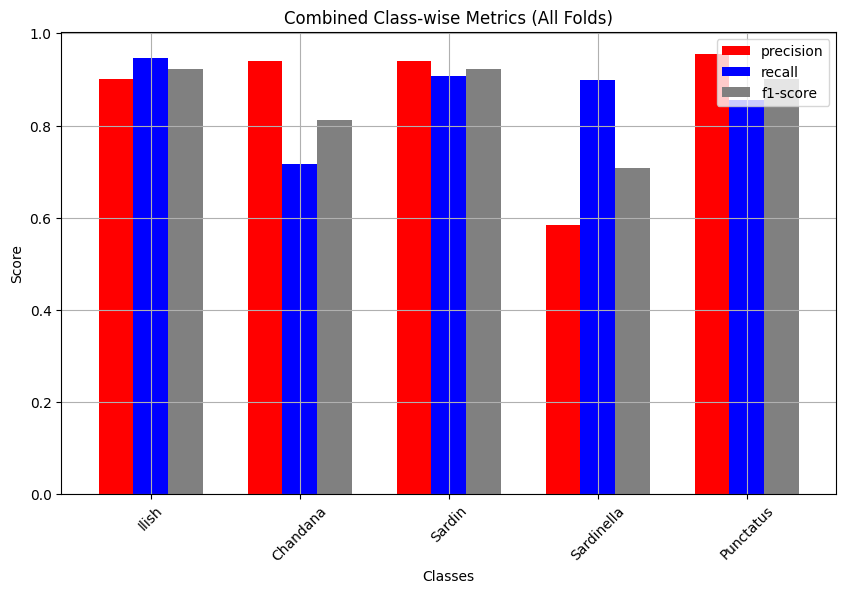

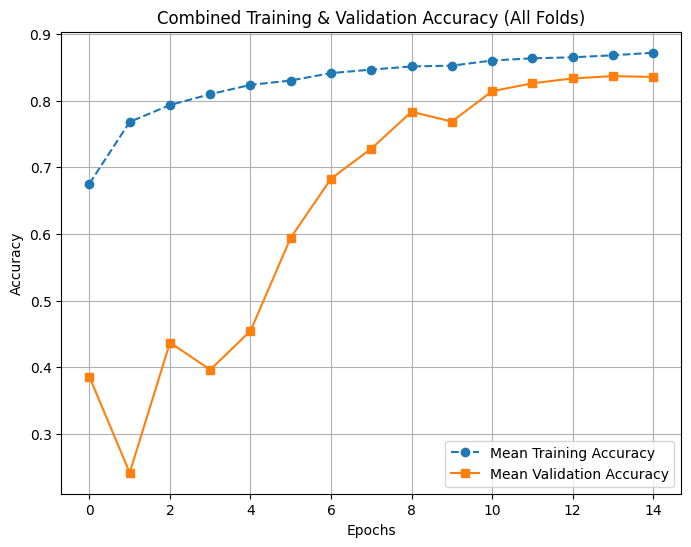

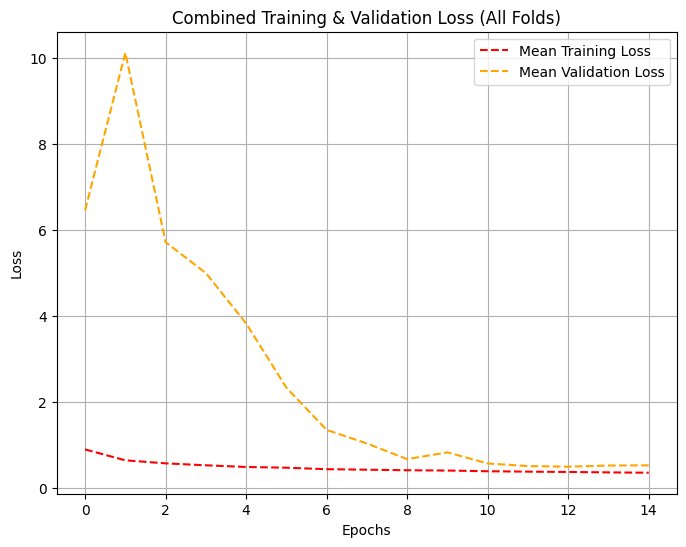


Final Combined Classification Report Across All Folds:
               precision    recall  f1-score   support

       Ilish       0.90      0.95      0.92      3500
    Chandana       0.94      0.72      0.81      2000
      Sardin       0.94      0.91      0.92      3000
  Sardinella       0.58      0.90      0.71      1000
   Punctatus       0.95      0.86      0.90      1500

    accuracy                           0.88     11000
   macro avg       0.86      0.86      0.85     11000
weighted avg       0.90      0.88      0.88     11000


Final Model Performance (Averaged across all folds):
Final Test Accuracy: 0.8770
Final F1 Score: 0.8531


In [ ]:
import numpy as np
import pandas as pd
import tensorflow as tf
import seaborn as sns
import matplotlib.pyplot as plt
from collections import Counter

from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.models import Model
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D, Dropout, LeakyReLU, BatchNormalization
from tensorflow.keras.callbacks import ReduceLROnPlateau, ModelCheckpoint, EarlyStopping
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.preprocessing.image import ImageDataGenerator

from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.metrics import accuracy_score, roc_curve, auc, precision_recall_curve, confusion_matrix, f1_score, classification_report
from imblearn.over_sampling import SMOTE

# Assuming X and Y are already loaded and preprocessed
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size=0.2, stratify=Y, random_state=42)

# !pip install imbalanced-learn
# #SMOTE (Synthetic Minority Over-sampling Technique)
# Synthetic Sample=Original Sample+λ×(Neighbor Sample−Original Sample)
# 1.Original Sample is the current sample from the minority class.
# 2.Neighbor Sample is a randomly chosen sample from the k-nearest neighbors.
# 3.λ is a random value between 0 and 1, which controls the degree of interpolation.


# # Apply SMOTE
smote = SMOTE(sampling_strategy='auto', random_state=42)
X_train_resampled, Y_train_resampled = smote.fit_resample(X_train.reshape(X_train.shape[0], -1), Y_train)
X_train_resampled = X_train_resampled.reshape(-1, 224, 224, 3)

import matplotlib.pyplot as plt
import numpy as np

# Display some sample images from the resampled dataset
num_samples_to_show = 5  # Number of sample images to display
fig, axes = plt.subplots(1, num_samples_to_show, figsize=(15, 5))

# Plot the images
for i in range(num_samples_to_show):
    axes[i].imshow(X_train_resampled[i])  # Display the image
    axes[i].set_title(f"Class: {Y_train_resampled[i]}")  # Set the class as the title
    axes[i].axis('off')  # Hide the axis

plt.show()
print(f"Original class distribution: {Counter(Y_train)}")
print(f"Resampled class distribution: {Counter(Y_train_resampled)}")


# Parameters
input_shape = (224, 224, 3)
num_classes = 5
batch_size = 32
epochs = 15
k_folds = 5

datagen = ImageDataGenerator(
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode="nearest"
)


def batch_generator(X, Y, batch_size=32):
    size = X.shape[0]
    used_indices = set()  # Track used samples per fold
    while True:
        indices = np.random.permutation(size)
        for start in range(0, size, batch_size):
            end = min(start + batch_size, size)
            batch_idx = indices[start:end]

            # Ensure no overlap across folds
            unique_batch_idx = [idx for idx in batch_idx if idx not in used_indices]
            used_indices.update(unique_batch_idx)

            if not unique_batch_idx:  # If all data is used, reset for next epoch
                used_indices.clear()
                continue

            X_batch, Y_batch = X[unique_batch_idx], Y[unique_batch_idx]
            augmented_images = next(datagen.flow(X_batch, shuffle=False, batch_size=len(unique_batch_idx)))
            yield augmented_images, to_categorical(Y_batch, num_classes)


# from tensorflow.keras.applications import
# [
# ResNet50, ResNet101, ResNet152,
# EfficientNetB0, EfficientNetB1, EfficientNetB2, EfficientNetB3, EfficientNetB4, EfficientNetB5, EfficientNetB6, EfficientNetB7,
# VGG16, VGG19,
# Xception,
# InceptionV3, InceptionResNetV2,
# DenseNet121, DenseNet169, DenseNet201,
# MobileNet, MobileNetV2, MobileNetV3Small, MobileNetV3Large,
# NASNetLarge, NASNetMobile
# ]


def create_resnet_model(input_shape=(224, 224, 3)):
    base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=input_shape)

    for layer in base_model.layers[:-10]:
        layer.trainable = False
    for layer in base_model.layers[-10:]:
        layer.trainable = True

    x = GlobalAveragePooling2D()(base_model.output)
    x = Dense(256)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.1)(x)
    x = Dropout(0.5)(x)

    x = Dense(128)(x)
    x = BatchNormalization()(x)
    x = LeakyReLU(alpha=0.1)(x)
    x = Dropout(0.5)(x)

    output = Dense(num_classes, activation='softmax')(x)

    model = Model(inputs=base_model.input, outputs=output)
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    return model

def train_with_kfold(X_train, Y_train, X_test, Y_test, k=5, batch_size=32, epochs=15):
    skf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
    histories = []
    ensemble_predictions = np.zeros((X_test.shape[0], num_classes))

    for fold_no, (train_idx, val_idx) in enumerate(skf.split(X_train, Y_train), 1):
    # for fold_no, (train_idx, val_idx) in enumerate(skf.split(X_train, np.argmax(Y_train, axis=1)), 1):

        print(f"Training Fold {fold_no}/{k}")

        X_train_fold, X_val_fold = X_train[train_idx], X_train[val_idx]
        Y_train_fold, Y_val_fold = Y_train[train_idx], Y_train[val_idx]

        resnet_model = create_resnet_model()
        train_generator = batch_generator(X_train_fold, Y_train_fold, batch_size)
        val_generator = batch_generator(X_val_fold, Y_val_fold, batch_size)

        callbacks = [
            ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, verbose=1),
            ModelCheckpoint(f'best_model_resnet_fold_{fold_no}.keras', save_best_only=True, monitor='val_loss', mode='min'),
            EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)
        ]

        history = resnet_model.fit(train_generator, validation_data=val_generator, epochs=epochs, verbose=1,
                                   callbacks=callbacks, steps_per_epoch=len(X_train_fold)//batch_size,
                                   validation_steps=len(X_val_fold)//batch_size)
        histories.append(history)

        resnet_preds = resnet_model.predict(X_test)
        ensemble_predictions += resnet_preds

    ensemble_predictions /= k
    final_classes = np.argmax(ensemble_predictions, axis=1)
    accuracy = np.mean(final_classes == Y_test)
    print(f"Final Model Accuracy: {accuracy * 100:.2f}%")
    return final_classes, histories

final_predictions, history_dict = train_with_kfold(X_train_resampled, Y_train_resampled, X_test, Y_test, k=k_folds)
print("Training Complete. ResNet Model is ready!")






import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from sklearn.metrics import roc_curve, auc, confusion_matrix, precision_recall_curve, classification_report, accuracy_score, f1_score

# Define class labels
class_labels = ['Ilish', 'Chandana', 'Sardin', 'Sardinella', 'Punctatus']

# Function to plot ROC curve
def plot_roc_curve(Y_test, Y_test_pred_prob, class_labels, fold_no):
    plt.figure(figsize=(8, 6))
    for i in range(len(class_labels)):
        y_true_binary = (Y_test == i).astype(int)
        y_score = Y_test_pred_prob[:, i]
        fpr, tpr, _ = roc_curve(y_true_binary, y_score)
        roc_auc = auc(fpr, tpr)
        plt.plot(fpr, tpr, label=f'{class_labels[i]} (AUC = {roc_auc:.2f})')
    plt.plot([0, 1], [0, 1], 'k--')
    plt.title(f'ROC Curve - Fold {fold_no}')
    plt.xlabel('False Positive Rate')
    plt.ylabel('True Positive Rate')
    plt.legend()
    plt.grid()
    plt.show()

# Function to plot Confusion Matrix
def plot_confusion_matrix(Y_test, Y_test_pred, class_labels, fold_no):
    conf_matrix = confusion_matrix(Y_test, Y_test_pred)
    plt.figure(figsize=(8, 6))
    sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
    plt.title(f'Confusion Matrix - Fold {fold_no}')
    plt.xlabel('Predicted')
    plt.ylabel('Actual')
    plt.show()

# Function to plot Precision-Recall curve
def plot_precision_recall_curve(Y_test, Y_test_pred_prob, class_labels, fold_no):
    plt.figure(figsize=(8, 6))
    for i in range(len(class_labels)):
        precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), Y_test_pred_prob[:, i])
        plt.plot(recall, precision, label=f'{class_labels[i]}')
    plt.title(f'Precision-Recall Curve - Fold {fold_no}')
    plt.xlabel('Recall')
    plt.ylabel('Precision')
    plt.legend()
    plt.grid()
    plt.show()

# Function to plot Training & Validation Accuracy over epochs
def plot_accuracy(history_list):
    plt.figure(figsize=(8, 6))
    for i, history in enumerate(history_list):
        plt.plot(history.history['accuracy'], label=f'Fold {i+1} Training', linestyle='dashed', marker='o')
        plt.plot(history.history['val_accuracy'], label=f'Fold {i+1} Validation', marker='s')
    plt.title('Training & Validation Accuracy Over Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.grid()
    plt.show()

# Function to plot Training & Validation Loss over epochs
def plot_loss(history_list):
    plt.figure(figsize=(8, 6))
    for i, history in enumerate(history_list):
        plt.plot(history.history['loss'], label=f'Fold {i+1} Training Loss', linestyle='dashed', color='red')
        plt.plot(history.history['val_loss'], label=f'Fold {i+1} Validation Loss', linestyle='dashed', color='orange')
    plt.title('Training & Validation Loss')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()
    plt.grid()
    plt.show()



# Function to compare class-wise metrics
def plot_classwise_metrics(Y_test, Y_test_pred, prev_Y_test_pred=None):
    report = classification_report(Y_test, Y_test_pred, target_names=class_labels, output_dict=True)
    df_report = pd.DataFrame(report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]
    colors = {'precision': 'red', 'recall': 'blue', 'f1-score': 'gray'}

    # Current model class-wise metrics
    plt.figure(figsize=(10, 6))
    df_report.plot(kind='bar', width=0.7, color=[colors[col] for col in df_report.columns])
    for p in plt.gca().patches:
        plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width() / 2, p.get_height()),
                           ha='center', va='bottom', fontsize=10, color='black')
    plt.title('Current Model Class-wise Metrics')
    plt.xlabel('Classes')
    plt.ylabel('Score')
    plt.xticks(rotation=45)
    plt.legend()
    plt.grid()
    plt.show()

    # Previous model class-wise metrics (if available)
    if prev_Y_test_pred is not None:
        prev_report = classification_report(Y_test, prev_Y_test_pred, target_names=class_labels, output_dict=True)
        prev_df_report = pd.DataFrame(prev_report).transpose().drop(['macro avg', 'weighted avg'])[['precision', 'recall', 'f1-score']]

        plt.figure(figsize=(10, 6))
        prev_df_report.plot(kind='bar', width=0.7, color=['pink', 'lightblue', 'lightgray'])
        for p in plt.gca().patches:
            plt.gca().annotate(f'{p.get_height():.2f}', (p.get_x() + p.get_width() / 2, p.get_height()),
                               ha='center', va='bottom', fontsize=10, color='black')
        plt.title('Previous Model Class-wise Metrics')
        plt.xlabel('Classes')
        plt.ylabel('Score')
        plt.xticks(rotation=45)
        plt.legend()
        plt.grid()
        plt.show()

# Function to display classification report
def print_classification_report(Y_test, Y_test_pred, class_labels, fold_no):
    report = classification_report(Y_test, Y_test_pred, target_names=class_labels)
    print(f"Classification Report - Fold {fold_no}:\n", report)

# Generate all individual plots for each fold
for fold_no, history in enumerate(history_dict, 1):
    print(f"\nEvaluating Fold {fold_no}:")

    # Get predictions for the current fold (final_predictions for this fold)
    fold_predictions = history.model.predict(X_test)  # or use history if separate fold predictions are stored
    plot_roc_curve(Y_test, fold_predictions, class_labels, fold_no)
    plot_confusion_matrix(Y_test, np.argmax(fold_predictions, axis=1), class_labels, fold_no)
    plot_precision_recall_curve(Y_test, fold_predictions, class_labels, fold_no)
    plot_classwise_metrics(Y_test, np.argmax(fold_predictions, axis=1))  # Class-wise metrics for the current fold
    # Call accuracy and loss plot functions for the current fold
    plot_accuracy([history])  # Pass a list with a single fold's history
    plot_loss([history])  # Pass a list with a single fold's history
    #Classification Report
    print_classification_report(Y_test, np.argmax(fold_predictions, axis=1), class_labels, fold_no)








#For All the Results in a single plot
print("Results in a Single Plot....")

import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd
from sklearn.metrics import roc_curve, auc, precision_recall_curve, confusion_matrix, classification_report

# Initialize lists to store results from all folds
all_fpr, all_tpr, all_roc_auc = [], [], []
all_precisions, all_recalls = [], []
all_conf_matrices = []
history_list = []
all_predictions = []
all_true_labels = []

num_classes = len(class_labels)

for fold_no, history in enumerate(history_dict, 1):
    print(f"\nProcessing Fold {fold_no}:")

    # Get predictions and true labels
    fold_predictions = history.model.predict(X_test)
    fold_pred_labels = np.argmax(fold_predictions, axis=1)

    all_predictions.append(fold_predictions)
    all_true_labels.append(Y_test)

    # Store training history
    history_list.append(history)

    # ROC Curve
    fold_fpr, fold_tpr, fold_auc = [], [], []
    for i in range(num_classes):
        y_true_binary = (Y_test == i).astype(int)
        y_score = fold_predictions[:, i]
        fpr, tpr, _ = roc_curve(y_true_binary, y_score)
        fold_fpr.append(fpr)
        fold_tpr.append(tpr)
        fold_auc.append(auc(fpr, tpr))

    all_fpr.append(fold_fpr)
    all_tpr.append(fold_tpr)
    all_roc_auc.append(fold_auc)

    # Precision-Recall Curve
    fold_precisions, fold_recalls = [], []
    for i in range(num_classes):
        precision, recall, _ = precision_recall_curve((Y_test == i).astype(int), fold_predictions[:, i])
        fold_precisions.append(precision)
        fold_recalls.append(recall)

    all_precisions.append(fold_precisions)
    all_recalls.append(fold_recalls)

    # Confusion Matrix
    all_conf_matrices.append(confusion_matrix(Y_test, fold_pred_labels))

# Convert predictions and true labels to numpy arrays
all_predictions = np.vstack(all_predictions)
all_true_labels = np.hstack(all_true_labels)

# **1. Combined ROC Curve**
plt.figure(figsize=(8, 6))
mean_fpr = np.linspace(0, 1, 100)  # Standard length for interpolation

for i in range(num_classes):
    interpolated_tprs = [np.interp(mean_fpr, all_fpr[j][i], all_tpr[j][i]) for j in range(len(all_fpr))]
    mean_tpr = np.mean(interpolated_tprs, axis=0)
    mean_auc = np.mean([all_roc_auc[j][i] for j in range(len(all_roc_auc))])
    plt.plot(mean_fpr, mean_tpr, label=f'{class_labels[i]} (AUC={mean_auc:.2f})')

plt.plot([0, 1], [0, 1], 'k--')
plt.title('Combined ROC Curve (All Folds)')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend()
plt.grid()
plt.show()

# **2. Combined Confusion Matrix**
mean_conf_matrix = np.mean(all_conf_matrices, axis=0)
plt.figure(figsize=(8, 6))
sns.heatmap(mean_conf_matrix, annot=True, fmt='.0f', cmap='Blues', xticklabels=class_labels, yticklabels=class_labels)
plt.title('Combined Confusion Matrix (All Folds)')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# **3. Combined Precision-Recall Curve**
plt.figure(figsize=(8, 6))
for i in range(num_classes):
    interpolated_precisions = [np.interp(mean_fpr, all_recalls[j][i][::-1], all_precisions[j][i][::-1]) for j in range(len(all_recalls))]
    mean_precision = np.mean(interpolated_precisions, axis=0)
    mean_recall = np.linspace(0, 1, 100)
    plt.plot(mean_recall, mean_precision, label=f'{class_labels[i]}')

plt.title('Combined Precision-Recall Curve (All Folds)')
plt.xlabel('Recall')
plt.ylabel('Precision')
plt.legend()
plt.grid()
plt.show()

# **4. Combined Class-wise Metrics**
all_reports = [classification_report(Y_test, np.argmax(history.model.predict(X_test), axis=1),
                                     target_names=class_labels, output_dict=True) for history in history_dict]
avg_report = {}
for label in class_labels:
    avg_report[label] = {
        'precision': np.mean([r[label]['precision'] for r in all_reports]),
        'recall': np.mean([r[label]['recall'] for r in all_reports]),
        'f1-score': np.mean([r[label]['f1-score'] for r in all_reports])
    }
df_avg_report = pd.DataFrame(avg_report).transpose()
df_avg_report.plot(kind='bar', width=0.7, figsize=(10, 6), color=['red', 'blue', 'gray'])
plt.title('Combined Class-wise Metrics (All Folds)')
plt.xlabel('Classes')
plt.ylabel('Score')
plt.xticks(rotation=45)
plt.legend()
plt.grid()
plt.show()

# **5. Combined Training & Validation Accuracy**
plt.figure(figsize=(8, 6))
mean_train_acc = np.mean([history.history['accuracy'] for history in history_list], axis=0)
mean_val_acc = np.mean([history.history['val_accuracy'] for history in history_list], axis=0)
plt.plot(mean_train_acc, label='Mean Training Accuracy', linestyle='dashed', marker='o')
plt.plot(mean_val_acc, label='Mean Validation Accuracy', marker='s')
plt.title('Combined Training & Validation Accuracy (All Folds)')
plt.xlabel('Epochs')
plt.ylabel('Accuracy')
plt.legend()
plt.grid()
plt.show()

# **6. Combined Training & Validation Loss**
plt.figure(figsize=(8, 6))
mean_train_loss = np.mean([history.history['loss'] for history in history_list], axis=0)
mean_val_loss = np.mean([history.history['val_loss'] for history in history_list], axis=0)
plt.plot(mean_train_loss, label='Mean Training Loss', linestyle='dashed', color='red')
plt.plot(mean_val_loss, label='Mean Validation Loss', linestyle='dashed', color='orange')
plt.title('Combined Training & Validation Loss (All Folds)')
plt.xlabel('Epochs')
plt.ylabel('Loss')
plt.legend()
plt.grid()
plt.show()

# **7. Print Combined Classification Report**
final_report = classification_report(all_true_labels, np.argmax(all_predictions, axis=1), target_names=class_labels)
print("\nFinal Combined Classification Report Across All Folds:\n", final_report)



from sklearn.metrics import accuracy_score, f1_score
# Compute final accuracy
final_accuracy = accuracy_score(all_true_labels, np.argmax(all_predictions, axis=1))
# Compute final F1 score (macro average across all classes)
final_f1_score = f1_score(all_true_labels, np.argmax(all_predictions, axis=1), average='macro')
# Print the final model performance
print("\nFinal Model Performance (Averaged across all folds):")
print(f"Final Test Accuracy: {final_accuracy:.4f}")
print(f"Final F1 Score: {final_f1_score:.4f}")

#End